Licensed under the Apache License, Version 2.0.

In [0]:
import tensorflow as tf
import numpy as np
import os
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style('white')
import itertools
gfile = tf.compat.v1.gfile

from experimental.attentive_uncertainty.toy_regression import datasets
  # local file importfrom experimental.attentive_uncertainty.toy_regression import utils as toy_utils
  # local file importfrom experimental.attentive_uncertainty import generalized_neural_process
  # local file importfrom experimental.attentive_uncertainty import utils
  # local file import
tf.enable_eager_execution()
tf.keras.backend.clear_session()

In [0]:
TRAINING_ITERATIONS = 100000 #@param {type:"number"}
MAX_CONTEXT_POINTS = 10 #@param {type:"number"}
PLOT_AFTER = 10000 #@param {type:"number"}
HIDDEN_SIZE = 128 #@param {type:"number"}
ATTENTION_TYPE = 'multihead' #@param ['uniform','laplace','dot_product','multihead']
random_kernel_parameters = True #@param {type:"boolean"}
rootdir = '/tmp/toy_1d'

In [0]:
# Train dataset
batch_size = 64
dataset_train = datasets.GPCurvesReader(
    batch_size=batch_size, max_num_context=MAX_CONTEXT_POINTS, random_kernel_parameters=random_kernel_parameters)
test_context_size = None
dataset_test = datasets.GPCurvesReader(
    batch_size=8, max_num_context=MAX_CONTEXT_POINTS, testing=True, random_kernel_parameters=random_kernel_parameters)

In [0]:
def display_plots(model,
                  data, 
                  prediction,
                  num_functions=3):
  for i in range(num_functions):
    print('Test function:', i+1)
    toy_utils.plot_functions(
        data.target_x[i:i+1:], data.target_y[i:i+1:],
        data.context_x[i:i+1:], data.context_y[i:i+1:], \
        prediction.distribution.mean()[i:i+1:1], prediction.distribution.stddev()[i:i+1:1])

@tf.function
def step(model, data, optimizer_config):
    with tf.GradientTape() as tape:
      prediction = model(
          data.context_x, 
          data.context_y, 
          data.target_x, 
          data.target_y)
      nll_term = utils.nll(data.target_y, prediction)
      mse_term = utils.mse(data.target_y, prediction)
      global_kl = tf.reduce_mean(tf.reduce_sum(model.losses[-2], axis=-1))
      local_kl = tf.reduce_mean(tf.reduce_sum(model.losses[-1], axis=[1, 2]))
      loss = nll_term + local_kl + global_kl
    gradients = tape.gradient(loss, model.trainable_variables)
    max_grad_norm = optimizer_config['max_grad_norm']
    optimizer = optimizer_config['optimizer']
    clipped_gradients, _ = tf.clip_by_global_norm(gradients, max_grad_norm)
    optimizer.apply_gradients(zip(clipped_gradients, model.trainable_variables)) 
    return nll_term, mse_term, local_kl, global_kl


def training_loop(model,
                  dataset_train,
                  optimizer=tf.keras.optimizers.Adam,
                  learning_rate=1e-3,
                  savepath=None):

  run_step = tf.function(step.python_function)
  # run_step = step
  optimizer_config = {'optimizer': optimizer(learning_rate),
                      'max_grad_norm': 1000.0}
  for it in range(TRAINING_ITERATIONS):
    data_train = dataset_train.generate_curves(num_context=test_context_size)
    train_nll, train_mse, train_local_kl, train_global_kl = run_step(
        model,
        data_train,
        optimizer_config)
    
    if it % PLOT_AFTER == 0:
      data_test = dataset_test.generate_curves(num_context=test_context_size)
      test_prediction = model(
          data_test.context_x, 
          data_test.context_y, 
          data_test.target_x, 
          data_test.target_y)
      display_plots(model, data_test, test_prediction)
      print('Iteration: {}, train nll: {}, mse: {}, local kl: {}, global kl {}'
      .format(it, train_nll, train_mse, train_local_kl, train_global_kl))
        
  if savepath is not None:
    print('Saving model...')
    model.save_weights(os.path.join(savepath, model.model_type + '_beta_' + str(model.beta) + '_temp_'+ str(model.temperature) + '_test.ckpt'))

In [0]:
x_encoder_net_sizes = None
x_y_encoder_net_sizes = [HIDDEN_SIZE]*4
heteroskedastic_net_sizes = None
data_uncertainty = False
savepath = os.path.join(rootdir, 'models')
att_type = 'multihead'
att_heads = 8
input_dim = 1
output_dim = 1

optimizer = tf.keras.optimizers.Adam
learning_rate = 1e-4

In [0]:
global_latent_net_sizes = [HIDDEN_SIZE]
local_latent_net_sizes = None
decoder_net_sizes = [HIDDEN_SIZE]*2 + [2]
model_type = 'anp'

In [0]:
betas = [0., 0.5, 1., 2., 5., 1000.]
temps = [1e-3, 0.5, 1., 2., 5., 1000.]

beta 0.0 temperature 0.001
Test function: 1


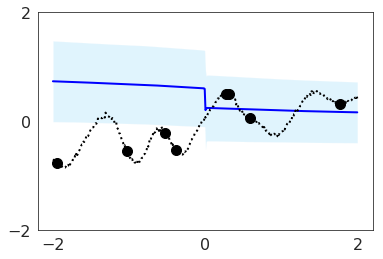

Test function: 2


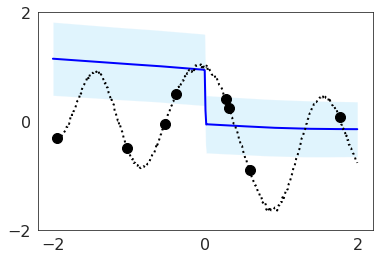

Test function: 3


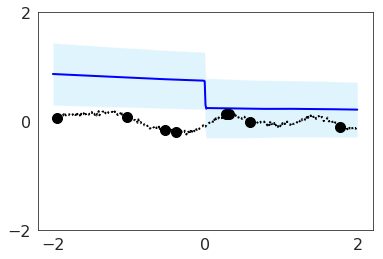

Iteration: 0, train nll: 1.5258694887161255, mse: 0.648481547832489, local kl: 0.0, global kl 0.0
Test function: 1


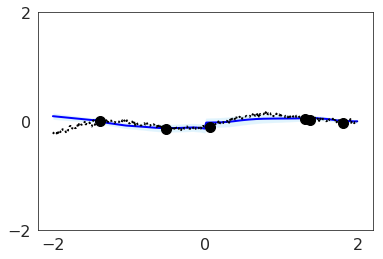

Test function: 2


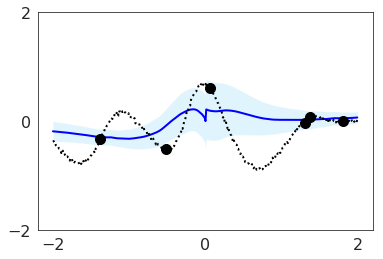

Test function: 3


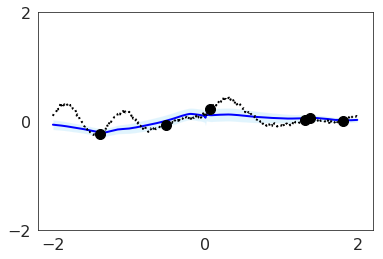

Iteration: 10000, train nll: -0.49082979559898376, mse: 0.0852891281247139, local kl: 0.0, global kl 0.0
Test function: 1


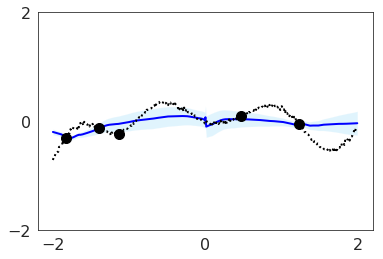

Test function: 2


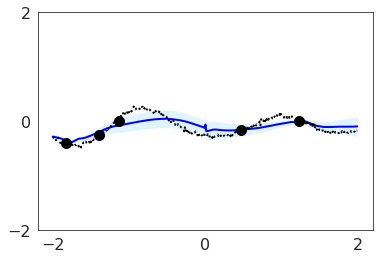

Test function: 3


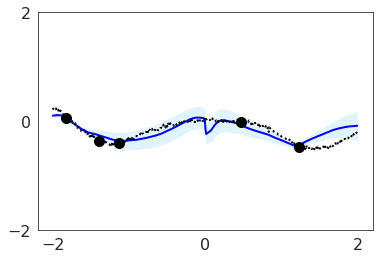

Iteration: 20000, train nll: -0.3323444426059723, mse: 0.09809157252311707, local kl: 0.0, global kl 0.0
Test function: 1


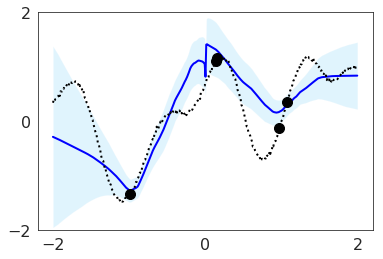

Test function: 2


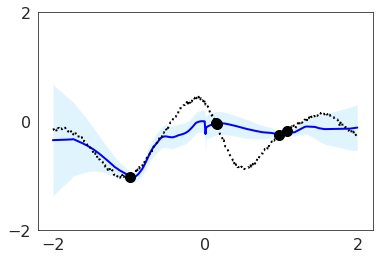

Test function: 3


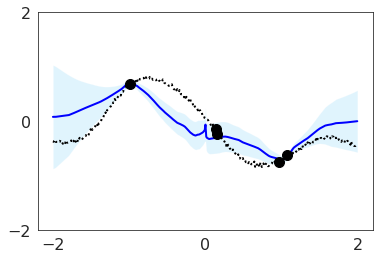

Iteration: 30000, train nll: -0.6916196346282959, mse: 0.054689668118953705, local kl: 0.0, global kl 0.0
Test function: 1


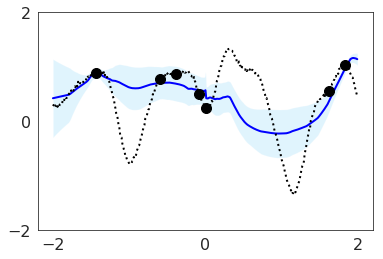

Test function: 2


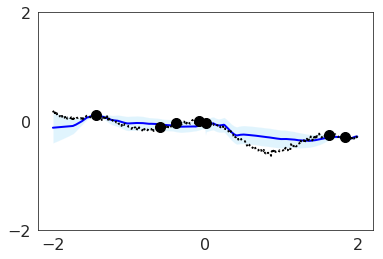

Test function: 3


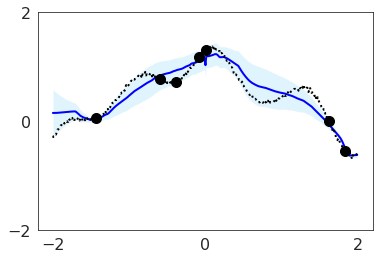

Iteration: 40000, train nll: -0.47020161151885986, mse: 0.07829156517982483, local kl: 0.0, global kl 0.0
Test function: 1


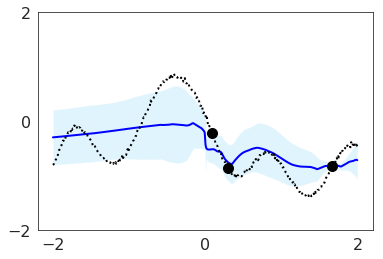

Test function: 2


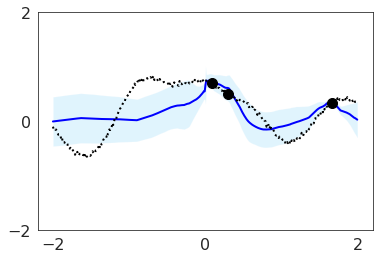

Test function: 3


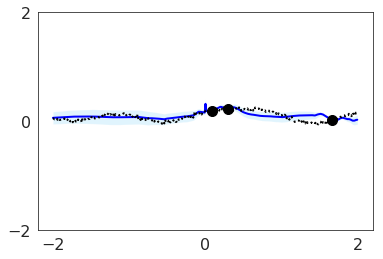

Iteration: 50000, train nll: -0.08910147100687027, mse: 0.08711913228034973, local kl: 0.0, global kl 0.0
Test function: 1


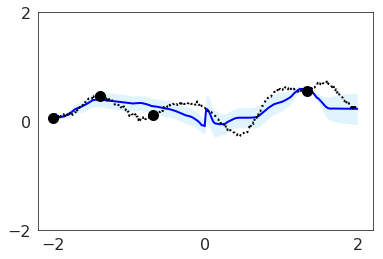

Test function: 2


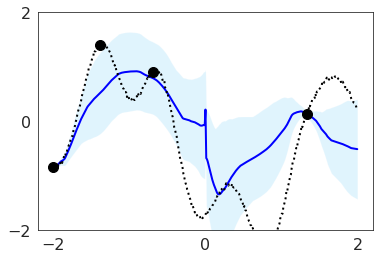

Test function: 3


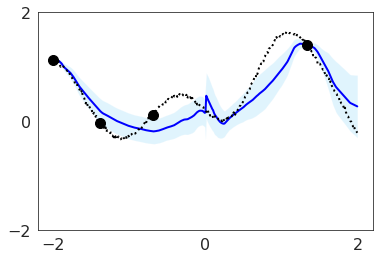

Iteration: 60000, train nll: -1.0057437419891357, mse: 0.041827164590358734, local kl: 0.0, global kl 0.0
Test function: 1


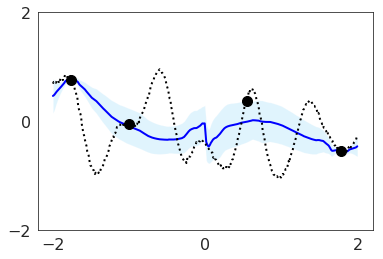

Test function: 2


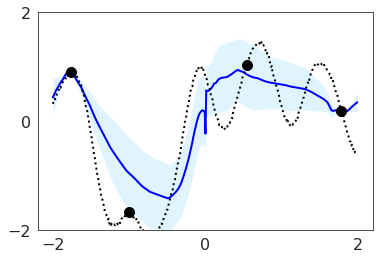

Test function: 3


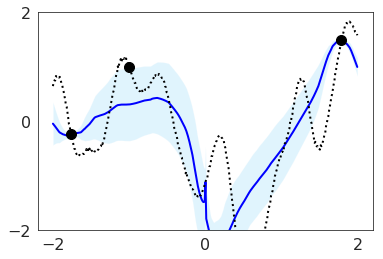

Iteration: 70000, train nll: -1.3301506042480469, mse: 0.054760612547397614, local kl: 0.0, global kl 0.0
Test function: 1


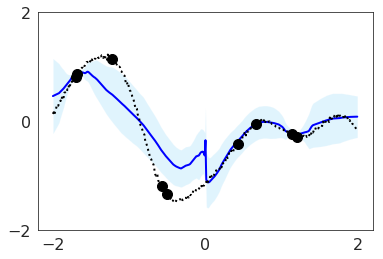

Test function: 2


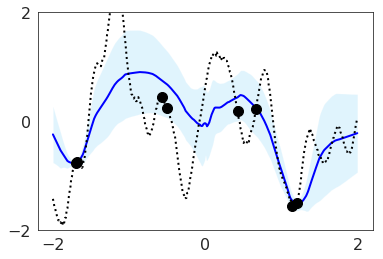

Test function: 3


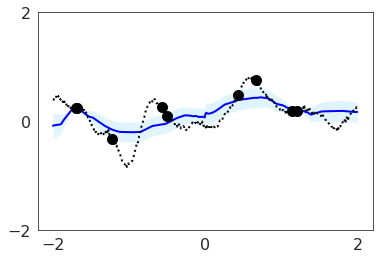

Iteration: 80000, train nll: -0.9263527989387512, mse: 0.04137956723570824, local kl: 0.0, global kl 0.0
Test function: 1


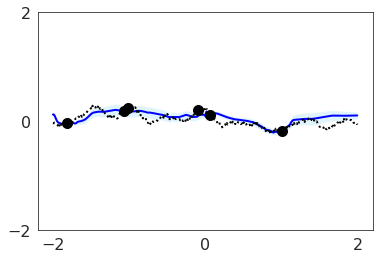

Test function: 2


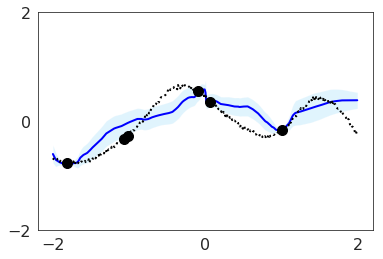

Test function: 3


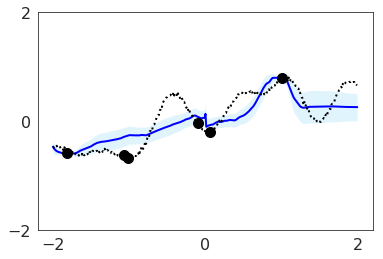

Iteration: 90000, train nll: -1.0812472105026245, mse: 0.044213879853487015, local kl: 0.0, global kl 0.0
Saving model...
beta 0.0 temperature 0.5
Test function: 1


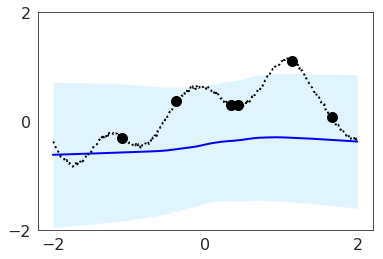

Test function: 2


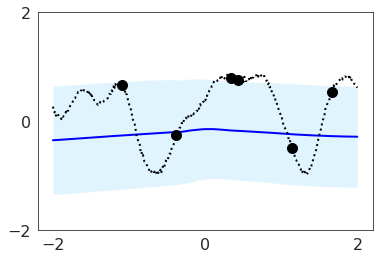

Test function: 3


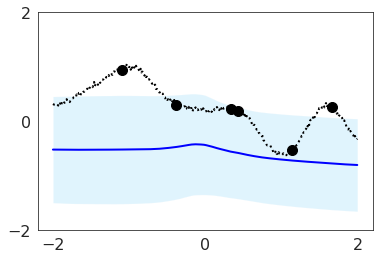

Iteration: 0, train nll: 1.364985704421997, mse: 0.7440786957740784, local kl: 0.0, global kl 0.0
Test function: 1


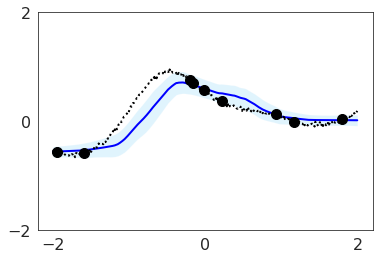

Test function: 2


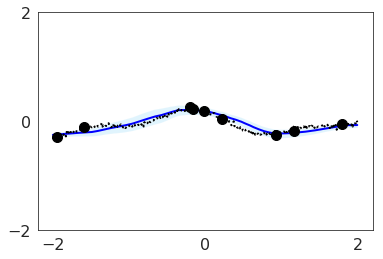

Test function: 3


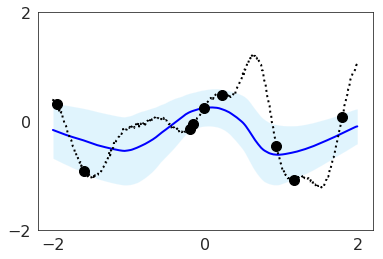

Iteration: 10000, train nll: -0.08175154775381088, mse: 0.09763987362384796, local kl: 0.0, global kl 0.0
Test function: 1


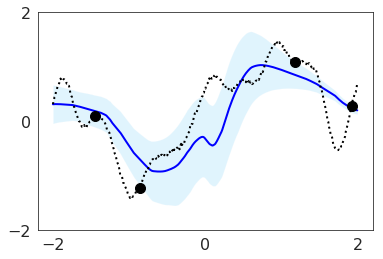

Test function: 2


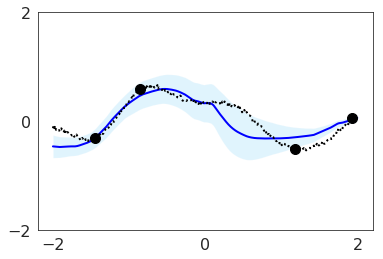

Test function: 3


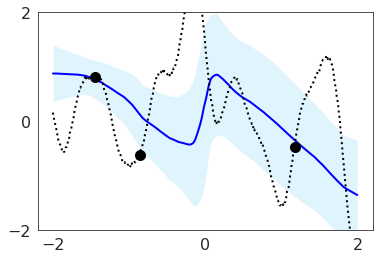

Iteration: 20000, train nll: -0.4517718553543091, mse: 0.05706291273236275, local kl: 0.0, global kl 0.0
Test function: 1


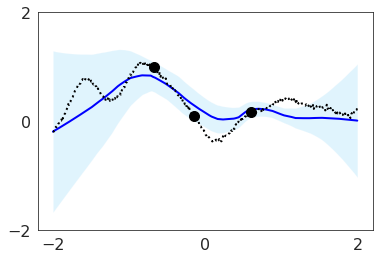

Test function: 2


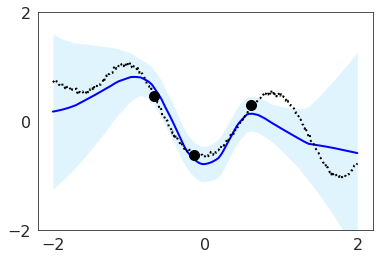

Test function: 3


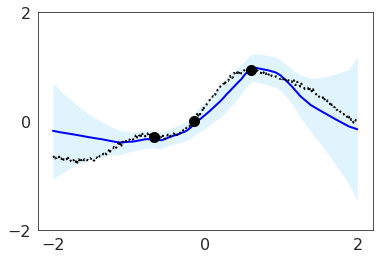

Iteration: 30000, train nll: -0.5717295408248901, mse: 0.044464532285928726, local kl: 0.0, global kl 0.0
Test function: 1


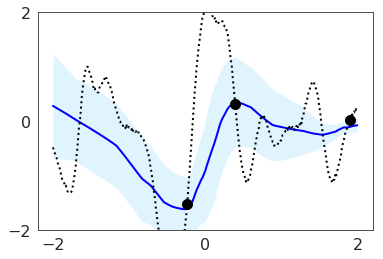

Test function: 2


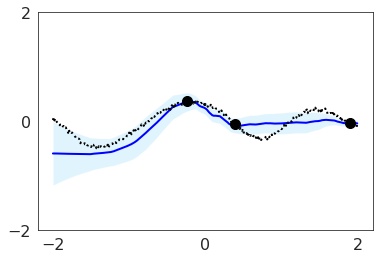

Test function: 3


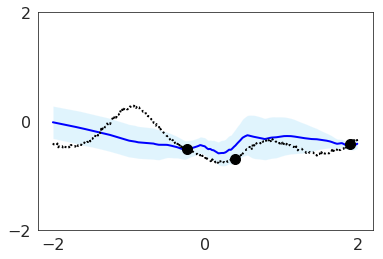

Iteration: 40000, train nll: -0.700690507888794, mse: 0.044929273426532745, local kl: 0.0, global kl 0.0
Test function: 1


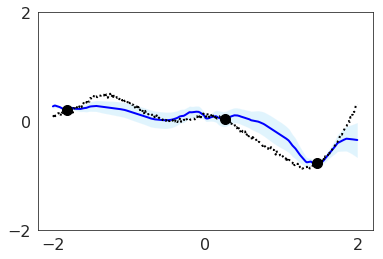

Test function: 2


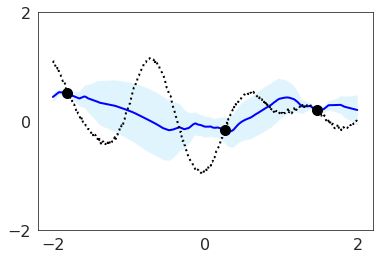

Test function: 3


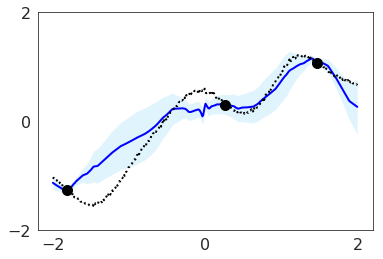

Iteration: 50000, train nll: -0.7431129813194275, mse: 0.05563954636454582, local kl: 0.0, global kl 0.0
Test function: 1


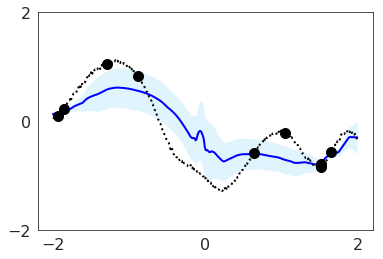

Test function: 2


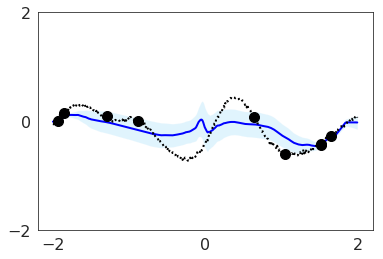

Test function: 3


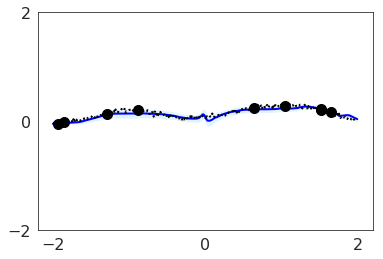

Iteration: 60000, train nll: -1.1766341924667358, mse: 0.04249400645494461, local kl: 0.0, global kl 0.0
Test function: 1


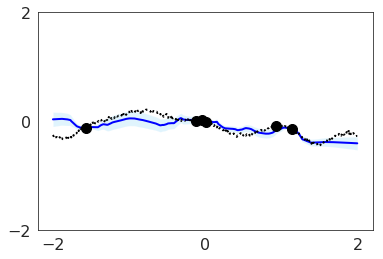

Test function: 2


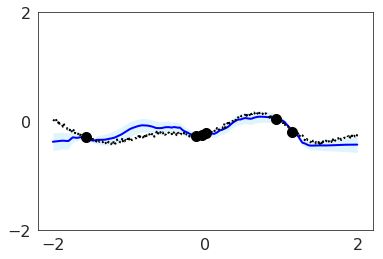

Test function: 3


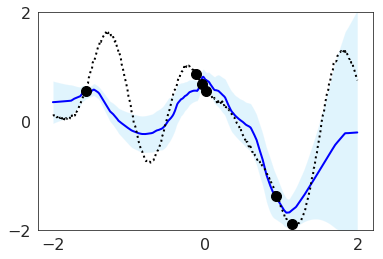

Iteration: 70000, train nll: -0.9178194403648376, mse: 0.04649815708398819, local kl: 0.0, global kl 0.0
Test function: 1


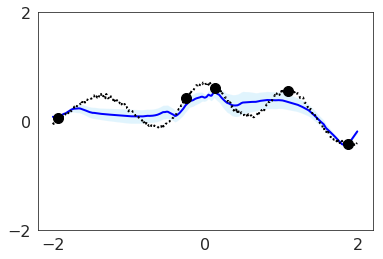

Test function: 2


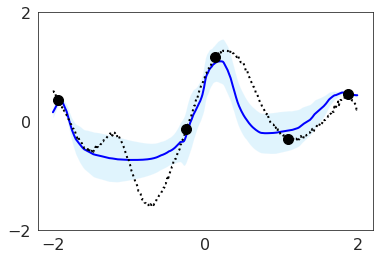

Test function: 3


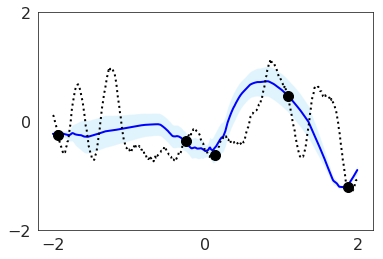

Iteration: 80000, train nll: -0.8703500628471375, mse: 0.04025040939450264, local kl: 0.0, global kl 0.0
Test function: 1


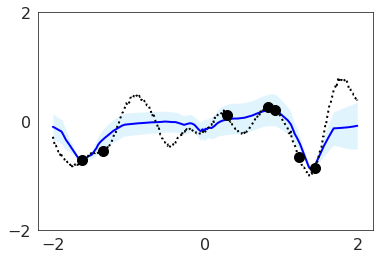

Test function: 2


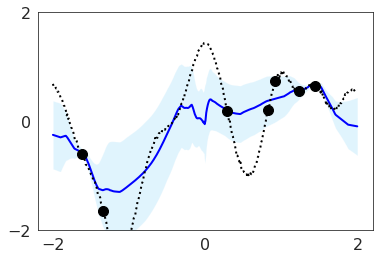

Test function: 3


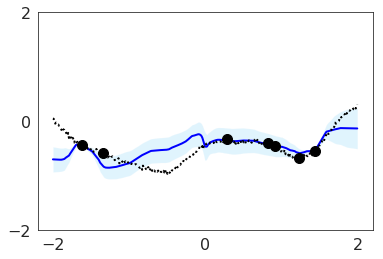

Iteration: 90000, train nll: -1.222976803779602, mse: 0.036796800792217255, local kl: 0.0, global kl 0.0
Saving model...
beta 0.0 temperature 1.0
Test function: 1


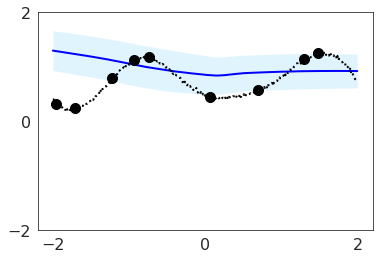

Test function: 2


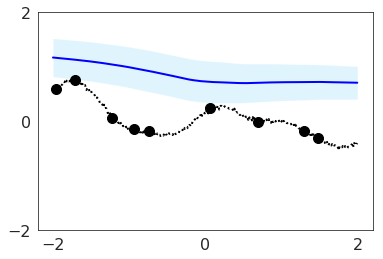

Test function: 3


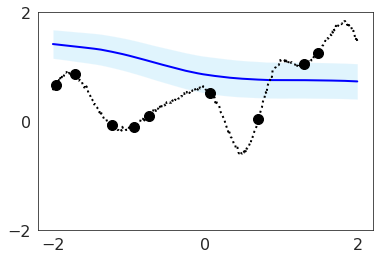

Iteration: 0, train nll: 9.558448791503906, mse: 1.9279649257659912, local kl: 0.0, global kl 0.0
Test function: 1


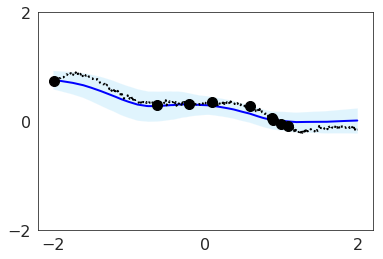

Test function: 2


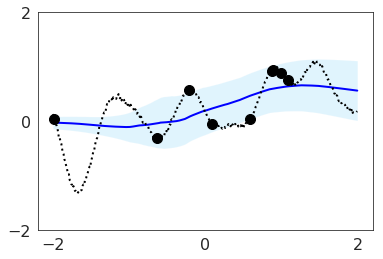

Test function: 3


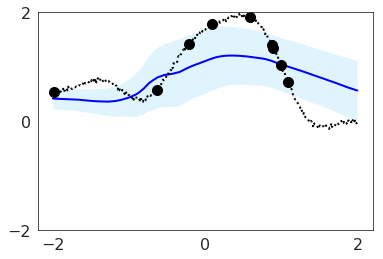

Iteration: 10000, train nll: -0.6368282437324524, mse: 0.052071478217840195, local kl: 0.0, global kl 0.0
Test function: 1


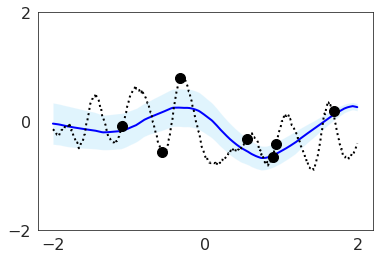

Test function: 2


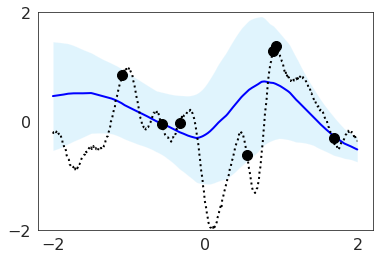

Test function: 3


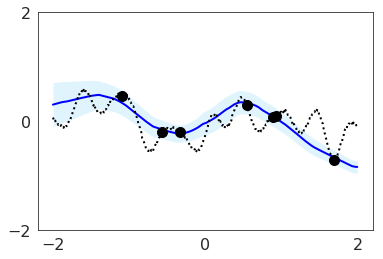

Iteration: 20000, train nll: -0.28013086318969727, mse: 0.0559084489941597, local kl: 0.0, global kl 0.0
Test function: 1


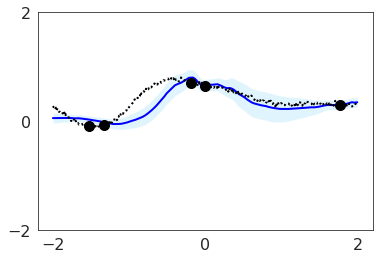

Test function: 2


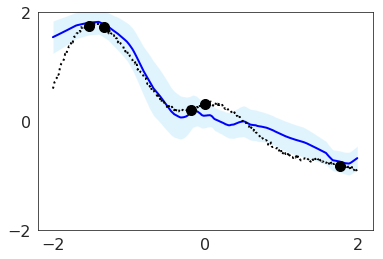

Test function: 3


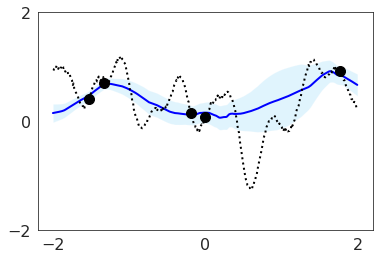

Iteration: 30000, train nll: -0.8007954359054565, mse: 0.046779900789260864, local kl: 0.0, global kl 0.0
Test function: 1


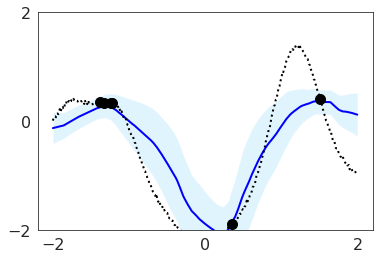

Test function: 2


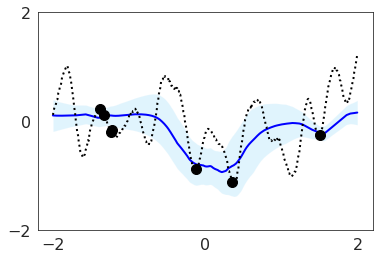

Test function: 3


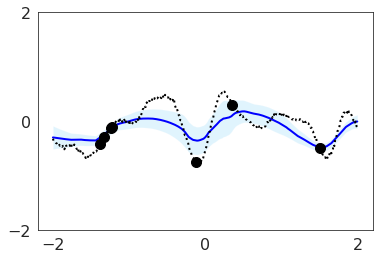

Iteration: 40000, train nll: -0.8514084815979004, mse: 0.05853870138525963, local kl: 0.0, global kl 0.0
Test function: 1


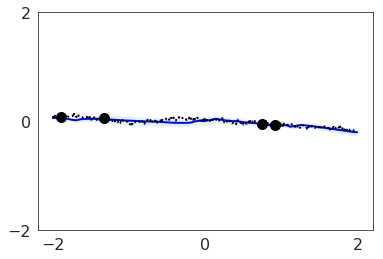

Test function: 2


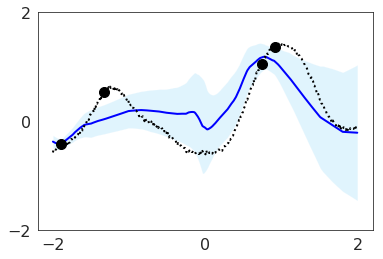

Test function: 3


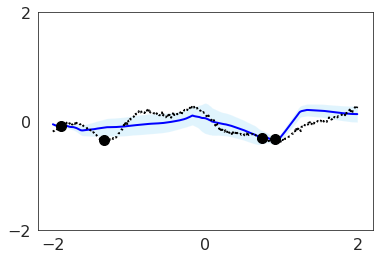

Iteration: 50000, train nll: -0.12839555740356445, mse: 0.09524622559547424, local kl: 0.0, global kl 0.0
Test function: 1


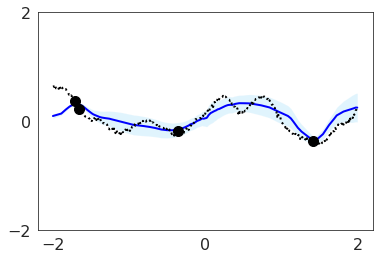

Test function: 2


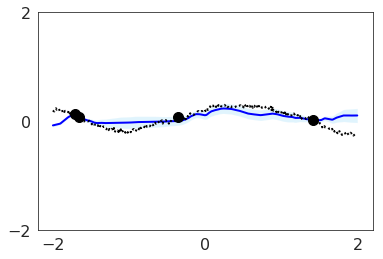

Test function: 3


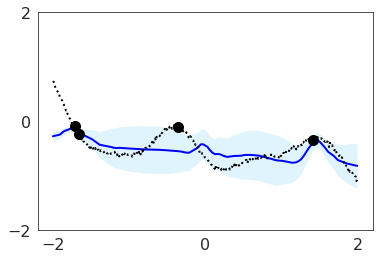

Iteration: 60000, train nll: -0.937586784362793, mse: 0.051926154643297195, local kl: 0.0, global kl 0.0
Test function: 1


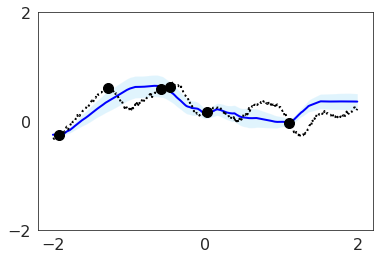

Test function: 2


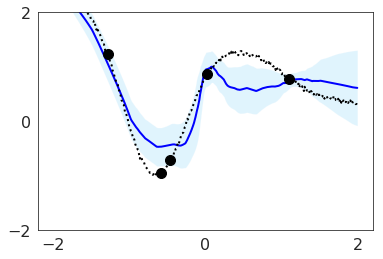

Test function: 3


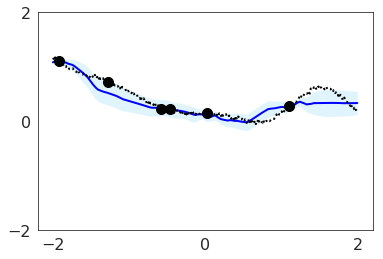

Iteration: 70000, train nll: -1.0190787315368652, mse: 0.0383208729326725, local kl: 0.0, global kl 0.0
Test function: 1


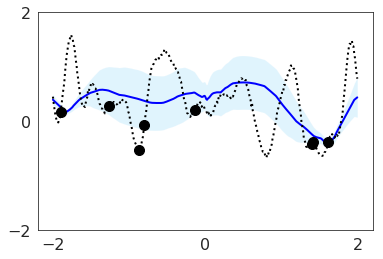

Test function: 2


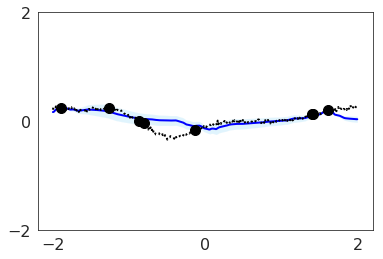

Test function: 3


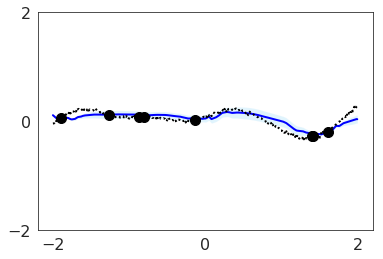

Iteration: 80000, train nll: -0.9808267951011658, mse: 0.031732380390167236, local kl: 0.0, global kl 0.0
Test function: 1


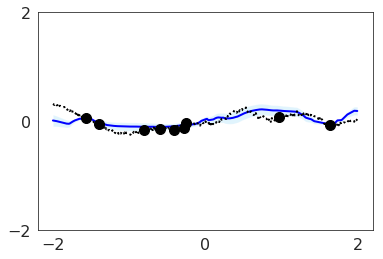

Test function: 2


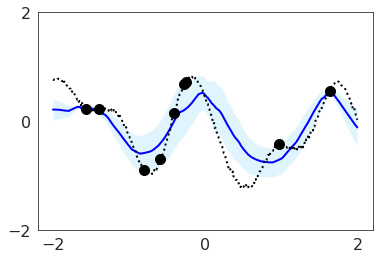

Test function: 3


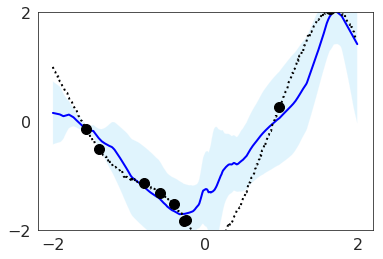

Iteration: 90000, train nll: -1.0164402723312378, mse: 0.030966468155384064, local kl: 0.0, global kl 0.0
Saving model...
beta 0.0 temperature 2.0
Test function: 1


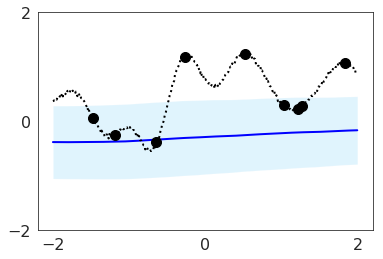

Test function: 2


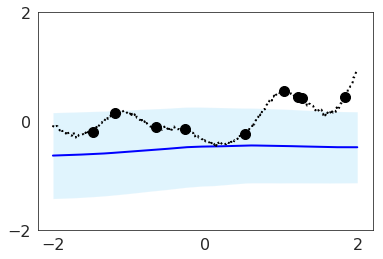

Test function: 3


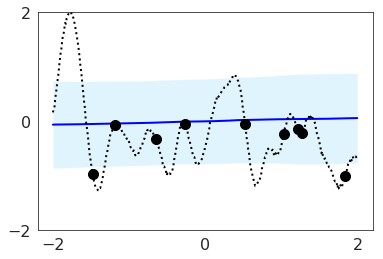

Iteration: 0, train nll: 1.3293993473052979, mse: 0.6104421019554138, local kl: 0.0, global kl 0.0
Test function: 1


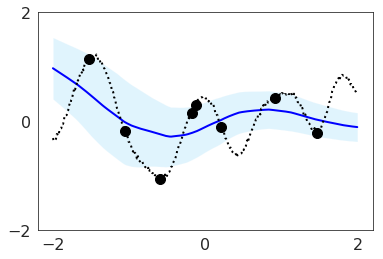

Test function: 2


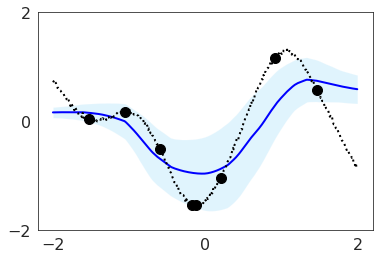

Test function: 3


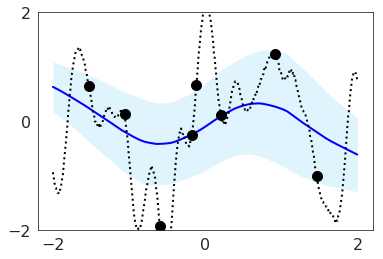

Iteration: 10000, train nll: 0.046866919845342636, mse: 0.12245198339223862, local kl: 0.0, global kl 0.0
Test function: 1


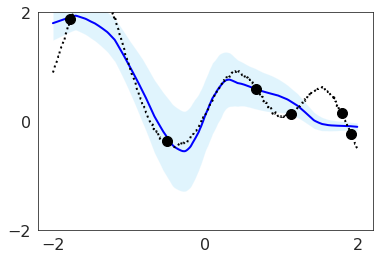

Test function: 2


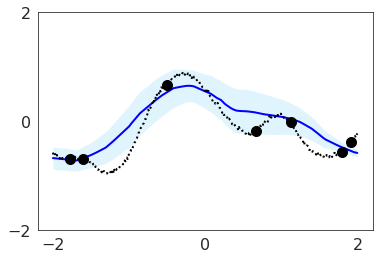

Test function: 3


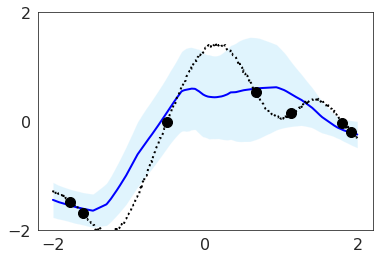

Iteration: 20000, train nll: -0.48666661977767944, mse: 0.09279677271842957, local kl: 0.0, global kl 0.0
Test function: 1


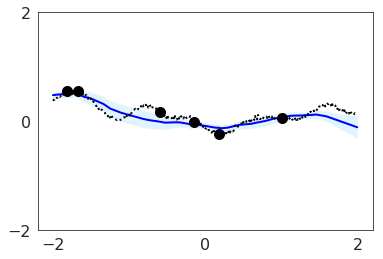

Test function: 2


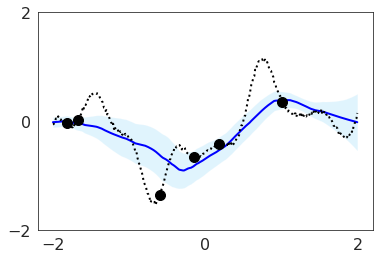

Test function: 3


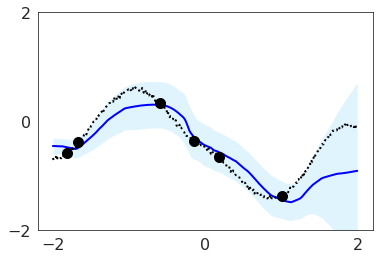

Iteration: 30000, train nll: -0.28187301754951477, mse: 0.06901783496141434, local kl: 0.0, global kl 0.0
Test function: 1


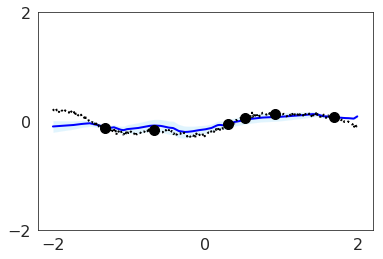

Test function: 2


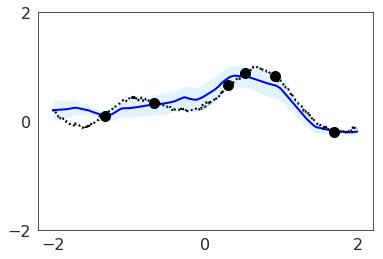

Test function: 3


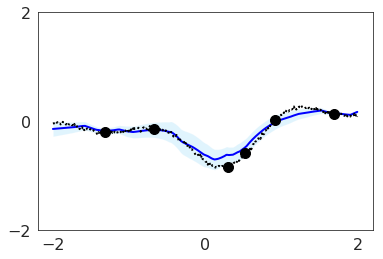

Iteration: 40000, train nll: -0.7451353669166565, mse: 0.04811429977416992, local kl: 0.0, global kl 0.0
Test function: 1


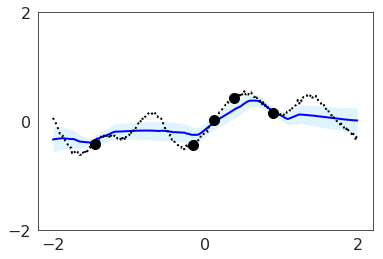

Test function: 2


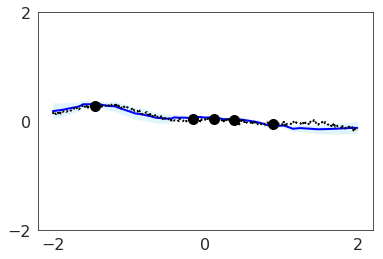

Test function: 3


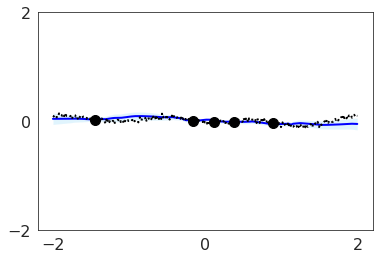

Iteration: 50000, train nll: -0.569286584854126, mse: 0.07329738140106201, local kl: 0.0, global kl 0.0
Test function: 1


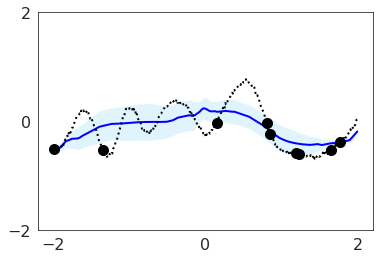

Test function: 2


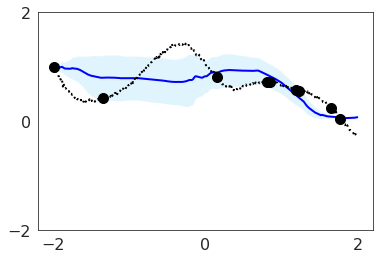

Test function: 3


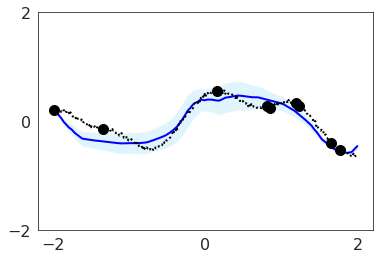

Iteration: 60000, train nll: -1.0633286237716675, mse: 0.030635708943009377, local kl: 0.0, global kl 0.0
Test function: 1


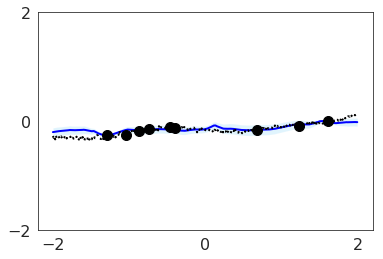

Test function: 2


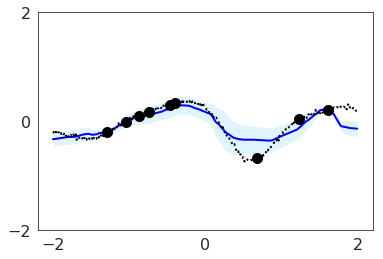

Test function: 3


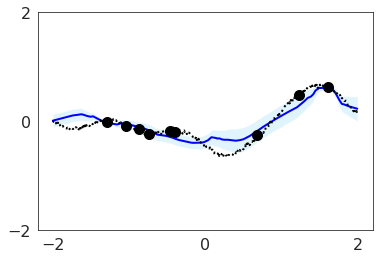

Iteration: 70000, train nll: -0.6883794069290161, mse: 0.08253669738769531, local kl: 0.0, global kl 0.0
Test function: 1


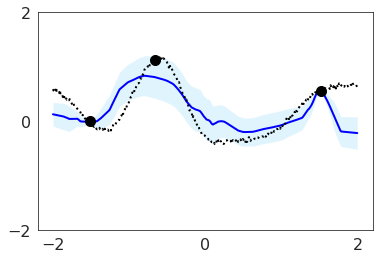

Test function: 2


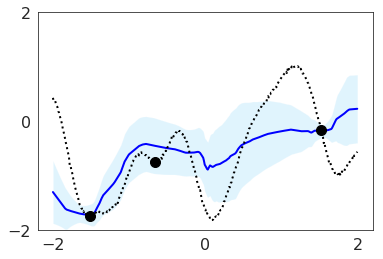

Test function: 3


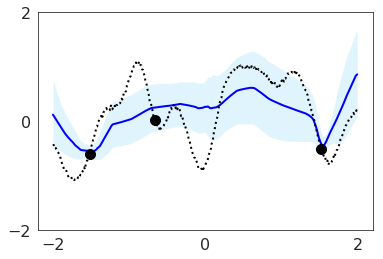

Iteration: 80000, train nll: -0.04534294456243515, mse: 0.11043751239776611, local kl: 0.0, global kl 0.0
Test function: 1


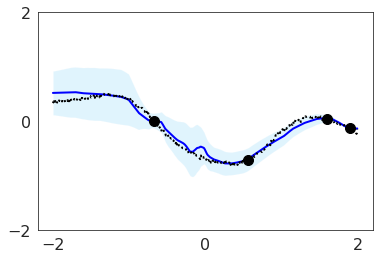

Test function: 2


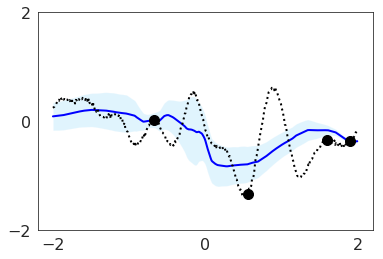

Test function: 3


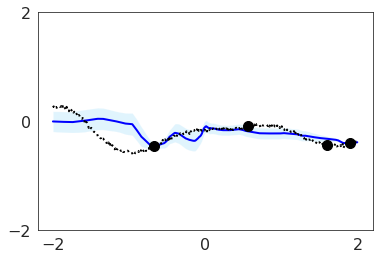

Iteration: 90000, train nll: -1.0212445259094238, mse: 0.025223933160305023, local kl: 0.0, global kl 0.0
Saving model...
beta 0.0 temperature 5.0
Test function: 1


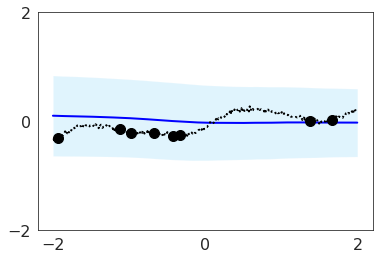

Test function: 2


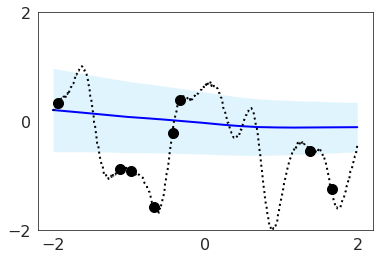

Test function: 3


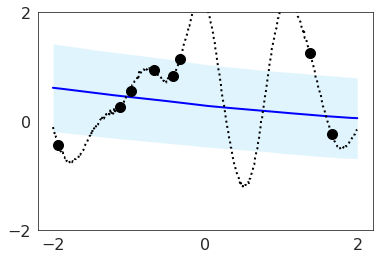

Iteration: 0, train nll: 1.0250355005264282, mse: 0.4531470835208893, local kl: 0.0, global kl 0.0
Test function: 1


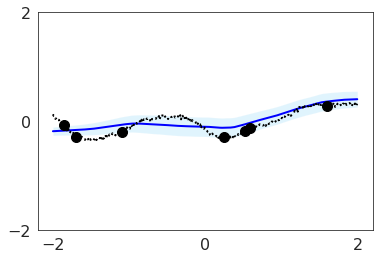

Test function: 2


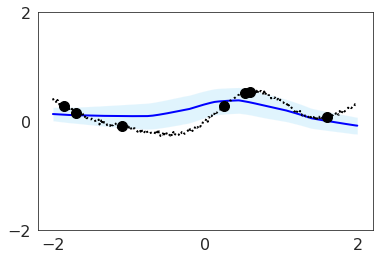

Test function: 3


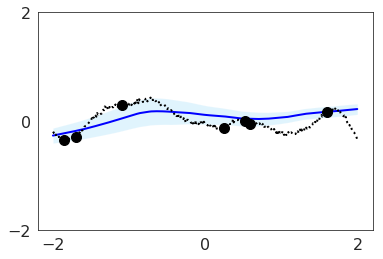

Iteration: 10000, train nll: 0.24124711751937866, mse: 0.22518698871135712, local kl: 0.0, global kl 0.0
Test function: 1


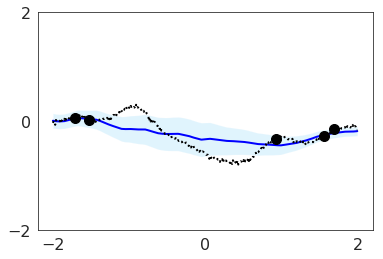

Test function: 2


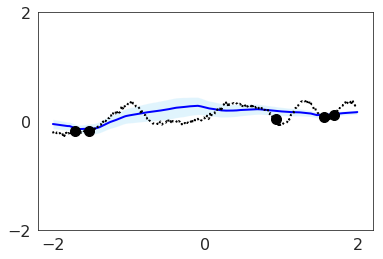

Test function: 3


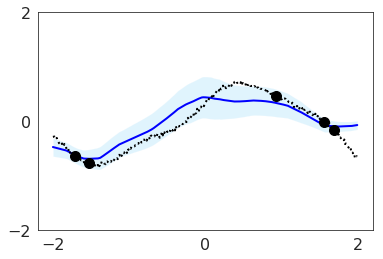

Iteration: 20000, train nll: -0.37119799852371216, mse: 0.08498769998550415, local kl: 0.0, global kl 0.0
Test function: 1


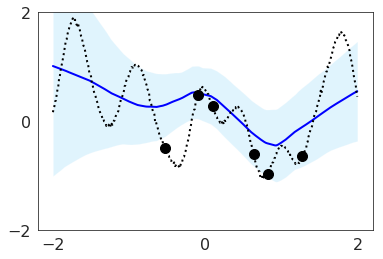

Test function: 2


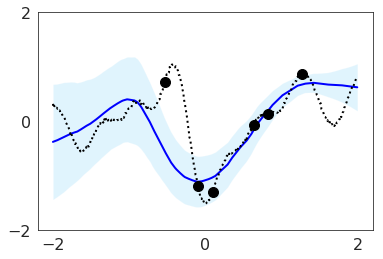

Test function: 3


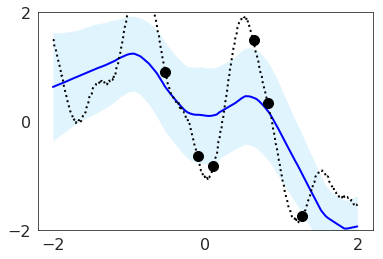

Iteration: 30000, train nll: -0.6585113406181335, mse: 0.0708635225892067, local kl: 0.0, global kl 0.0
Test function: 1


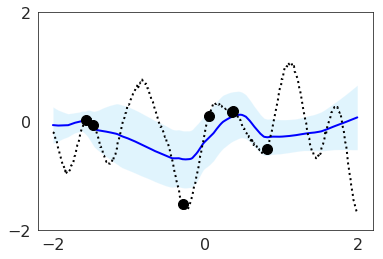

Test function: 2


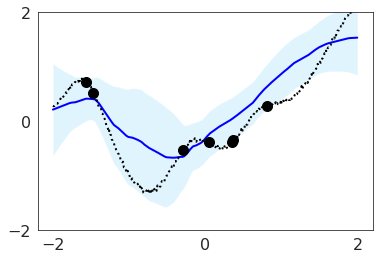

Test function: 3


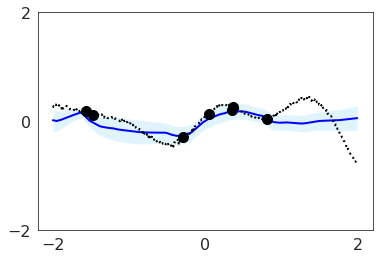

Iteration: 40000, train nll: -0.6544472575187683, mse: 0.045717887580394745, local kl: 0.0, global kl 0.0
Test function: 1


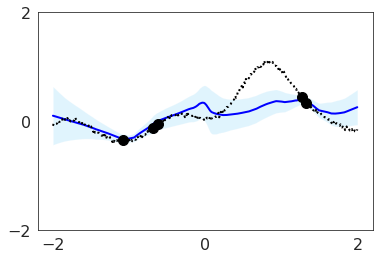

Test function: 2


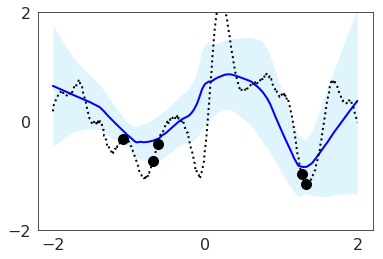

Test function: 3


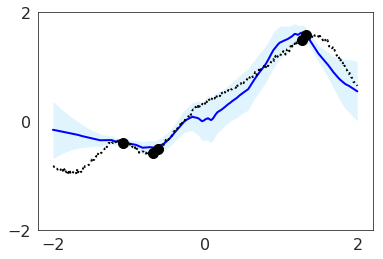

Iteration: 50000, train nll: -0.9742963910102844, mse: 0.022152235731482506, local kl: 0.0, global kl 0.0
Test function: 1


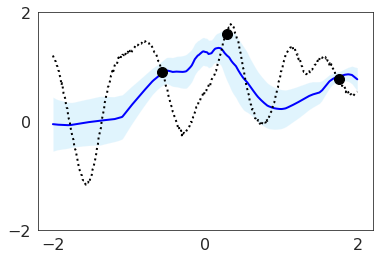

Test function: 2


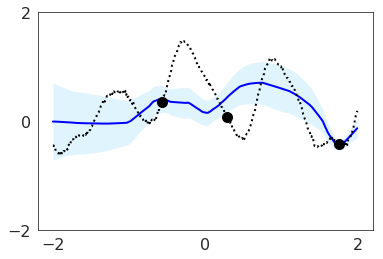

Test function: 3


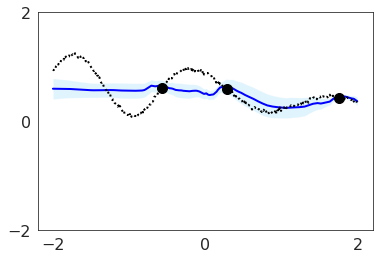

Iteration: 60000, train nll: -1.3794811964035034, mse: 0.03030851110816002, local kl: 0.0, global kl 0.0
Test function: 1


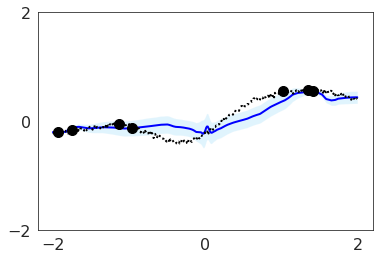

Test function: 2


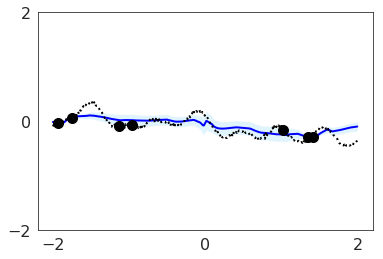

Test function: 3


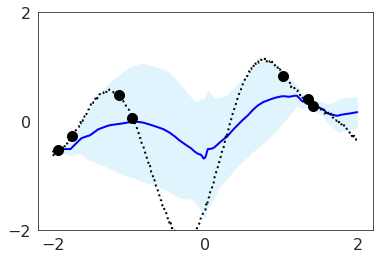

Iteration: 70000, train nll: -0.6904988288879395, mse: 0.053326062858104706, local kl: 0.0, global kl 0.0
Test function: 1


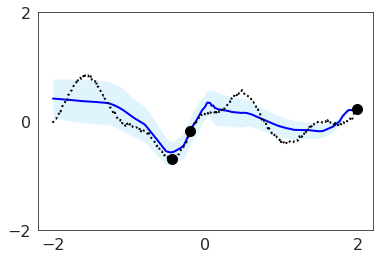

Test function: 2


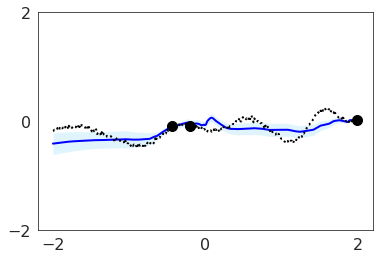

Test function: 3


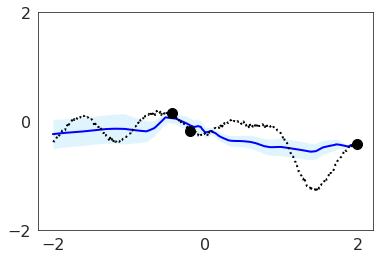

Iteration: 80000, train nll: -1.6974955797195435, mse: 0.011036934331059456, local kl: 0.0, global kl 0.0
Test function: 1


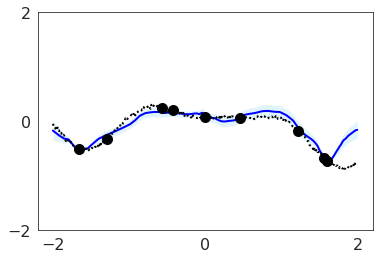

Test function: 2


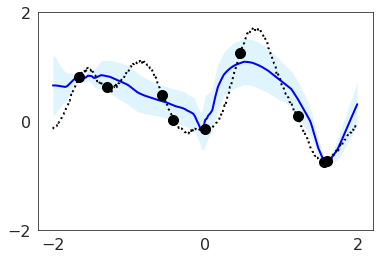

Test function: 3


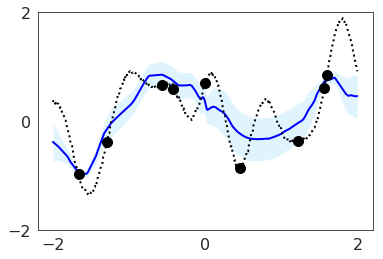

Iteration: 90000, train nll: -0.8854094743728638, mse: 0.03980061039328575, local kl: 0.0, global kl 0.0
Saving model...
beta 0.0 temperature 1000.0
Test function: 1


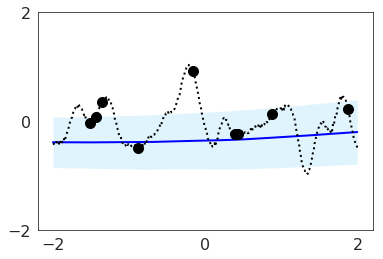

Test function: 2


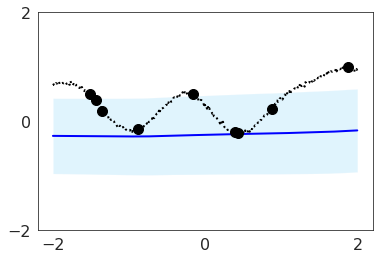

Test function: 3


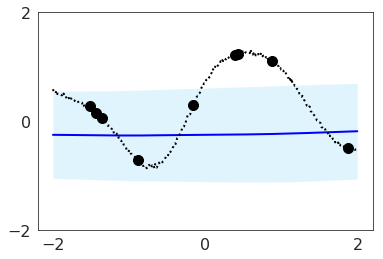

Iteration: 0, train nll: 1.5397629737854004, mse: 0.5581165552139282, local kl: 0.0, global kl 0.0
Test function: 1


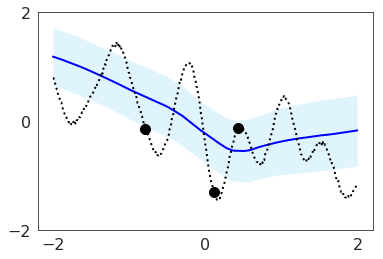

Test function: 2


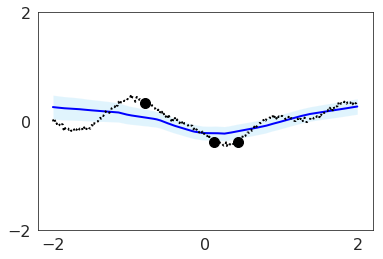

Test function: 3


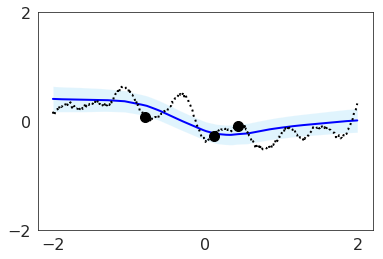

Iteration: 10000, train nll: -0.09696808457374573, mse: 0.14695413410663605, local kl: 0.0, global kl 0.0
Test function: 1


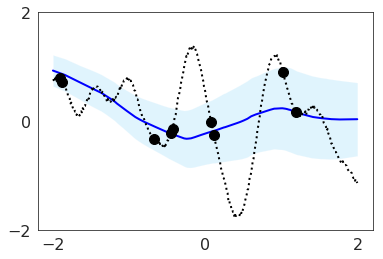

Test function: 2


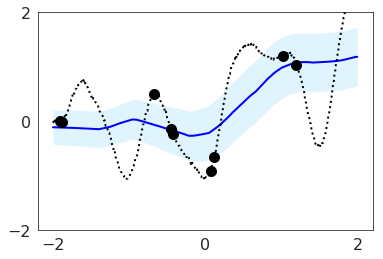

Test function: 3


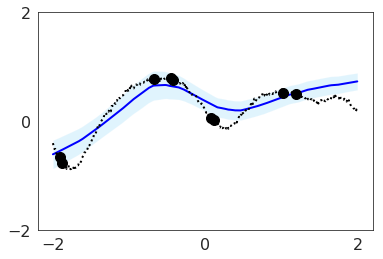

Iteration: 20000, train nll: -0.2730545997619629, mse: 0.07693929225206375, local kl: 0.0, global kl 0.0
Test function: 1


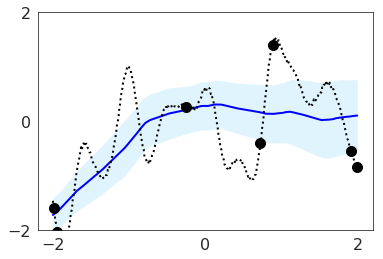

Test function: 2


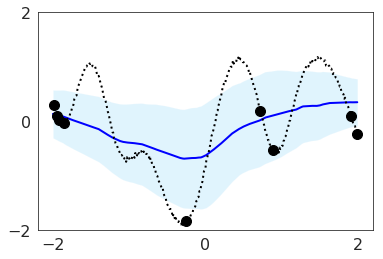

Test function: 3


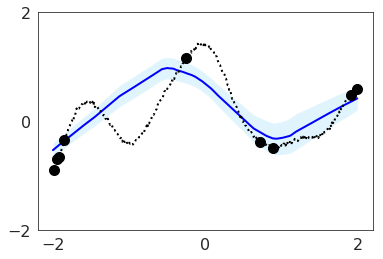

Iteration: 30000, train nll: -0.512192964553833, mse: 0.07719098031520844, local kl: 0.0, global kl 0.0
Test function: 1


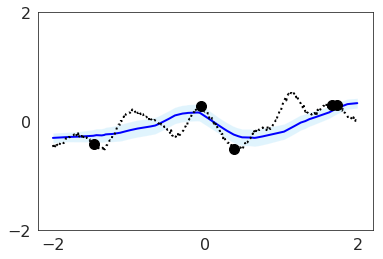

Test function: 2


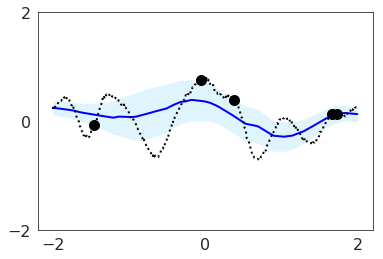

Test function: 3


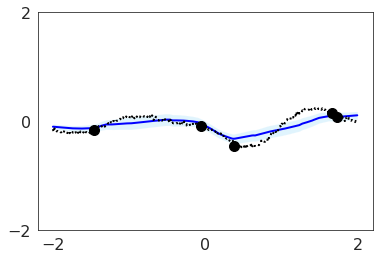

Iteration: 40000, train nll: -0.3918779790401459, mse: 0.06184297055006027, local kl: 0.0, global kl 0.0
Test function: 1


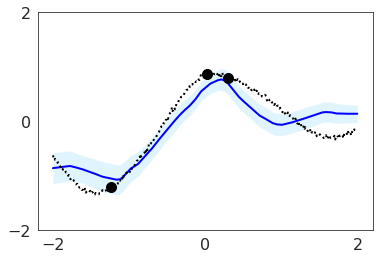

Test function: 2


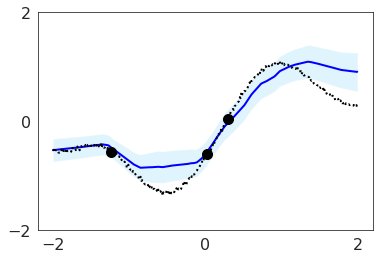

Test function: 3


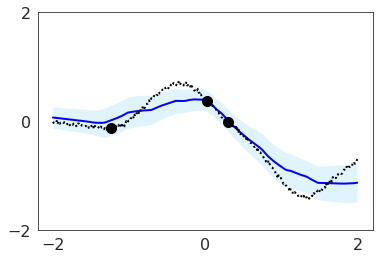

Iteration: 50000, train nll: -0.6928806900978088, mse: 0.03749558702111244, local kl: 0.0, global kl 0.0
Test function: 1


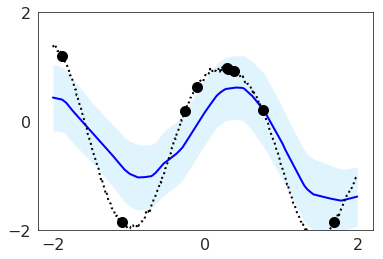

Test function: 2


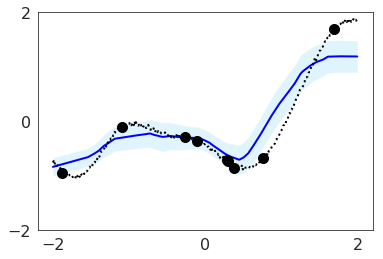

Test function: 3


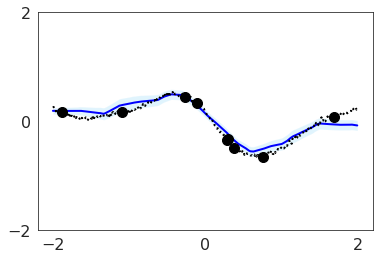

Iteration: 60000, train nll: -1.035768985748291, mse: 0.027883194386959076, local kl: 0.0, global kl 0.0
Test function: 1


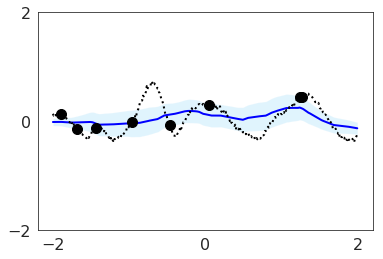

Test function: 2


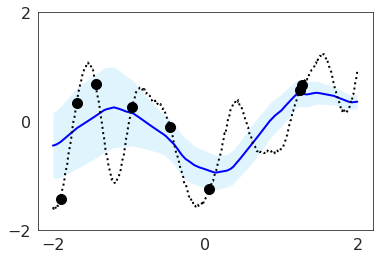

Test function: 3


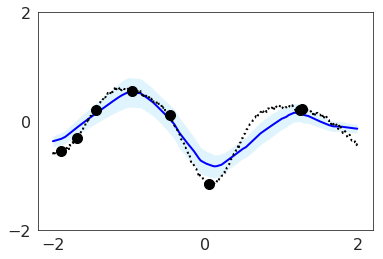

Iteration: 70000, train nll: -0.38025158643722534, mse: 0.06696772575378418, local kl: 0.0, global kl 0.0
Test function: 1


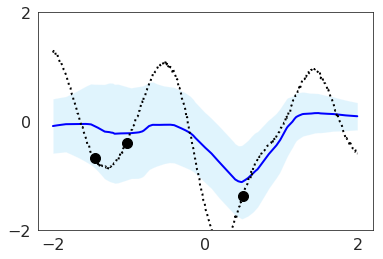

Test function: 2


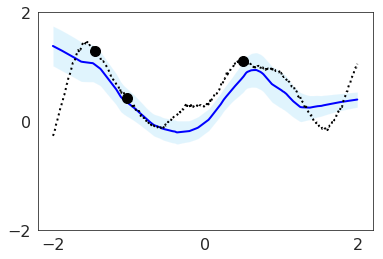

Test function: 3


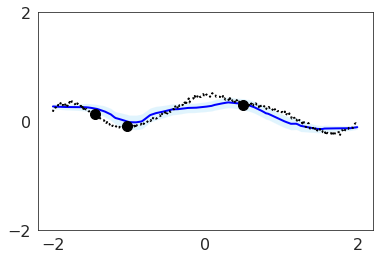

Iteration: 80000, train nll: -0.5332972407341003, mse: 0.06150862202048302, local kl: 0.0, global kl 0.0
Test function: 1


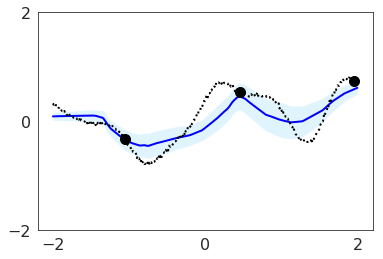

Test function: 2


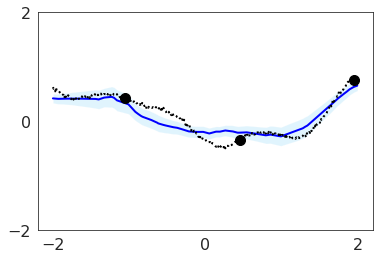

Test function: 3


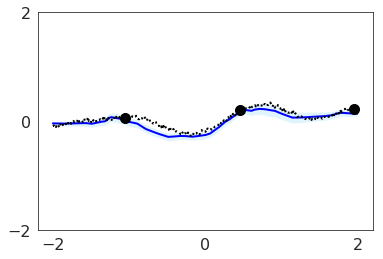

Iteration: 90000, train nll: -0.8956054449081421, mse: 0.0330793522298336, local kl: 0.0, global kl 0.0
Saving model...
beta 0.5 temperature 0.001
Test function: 1


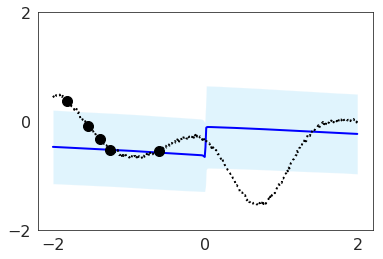

Test function: 2


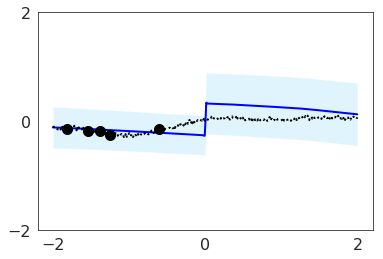

Test function: 3


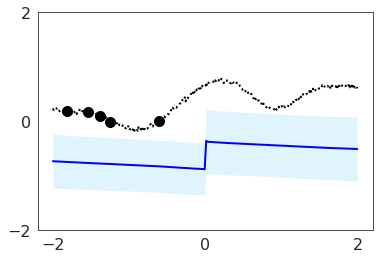

Iteration: 0, train nll: 1.551719069480896, mse: 0.5366508364677429, local kl: 0.0, global kl 0.008981232531368732
Test function: 1


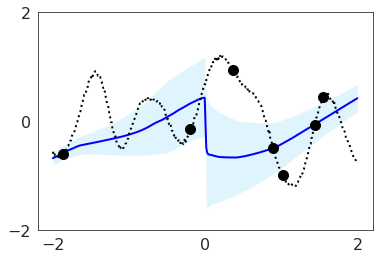

Test function: 2


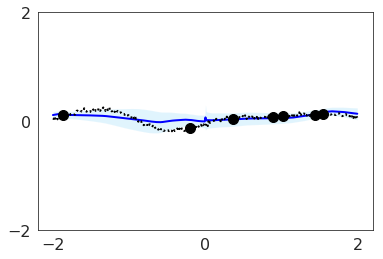

Test function: 3


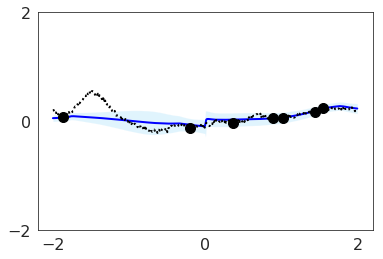

Iteration: 10000, train nll: -0.2836887538433075, mse: 0.09464054554700851, local kl: 0.0, global kl 0.0
Test function: 1


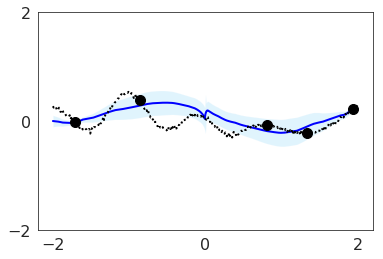

Test function: 2


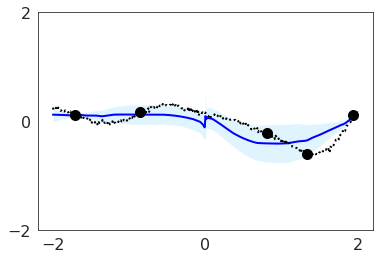

Test function: 3


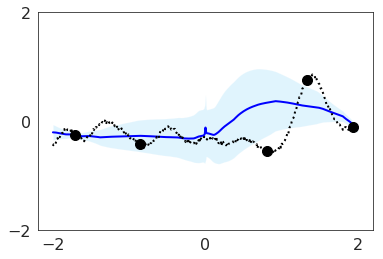

Iteration: 20000, train nll: -1.0914887189865112, mse: 0.010777615010738373, local kl: 0.0, global kl 0.0
Test function: 1


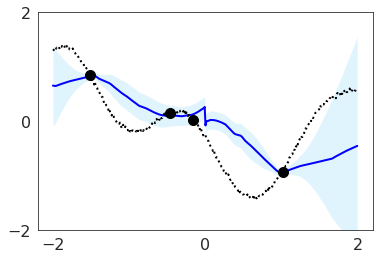

Test function: 2


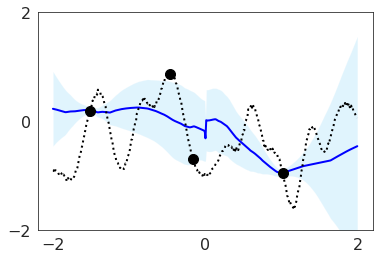

Test function: 3


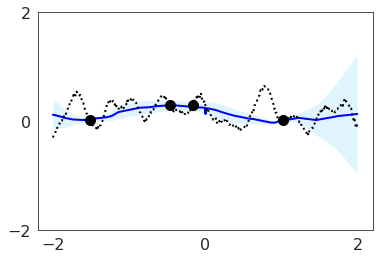

Iteration: 30000, train nll: -0.24487678706645966, mse: 0.11967074871063232, local kl: 0.0, global kl 0.003632377600297332
Test function: 1


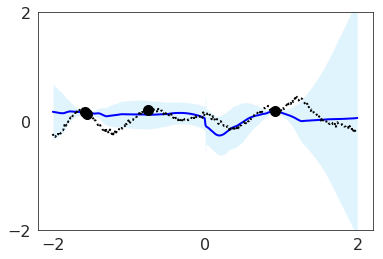

Test function: 2


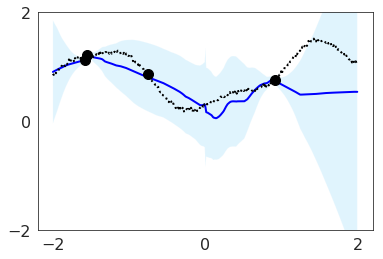

Test function: 3


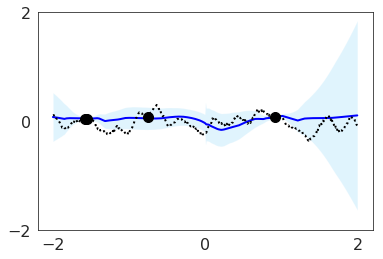

Iteration: 40000, train nll: -0.587182343006134, mse: 0.08200021088123322, local kl: 0.0, global kl 0.00149201275780797
Test function: 1


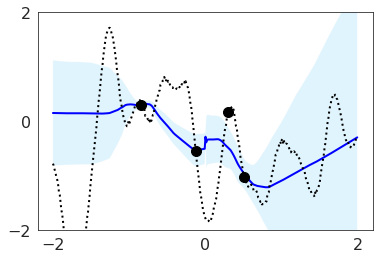

Test function: 2


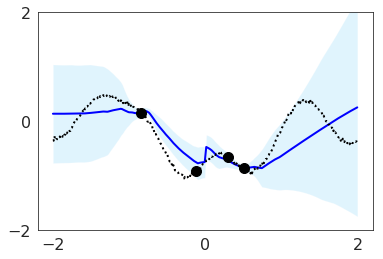

Test function: 3


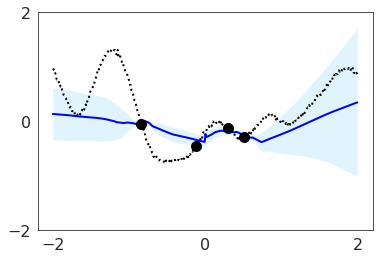

Iteration: 50000, train nll: -0.527286171913147, mse: 0.06262540817260742, local kl: 0.0, global kl 0.0005145409377291799
Test function: 1


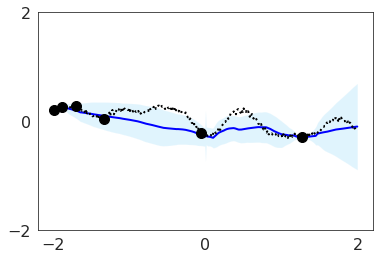

Test function: 2


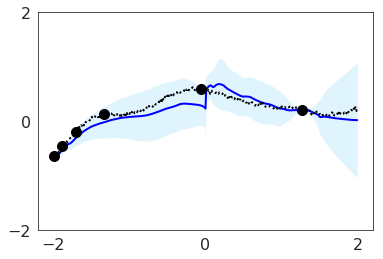

Test function: 3


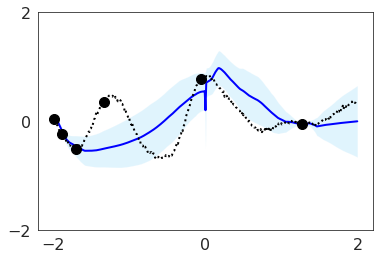

Iteration: 60000, train nll: -0.7543356418609619, mse: 0.062053877860307693, local kl: 0.0, global kl 0.00037946118391118944
Test function: 1


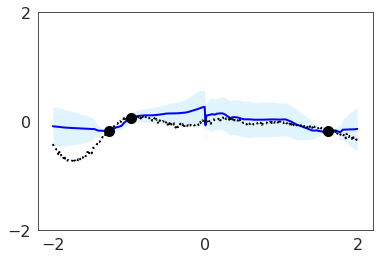

Test function: 2


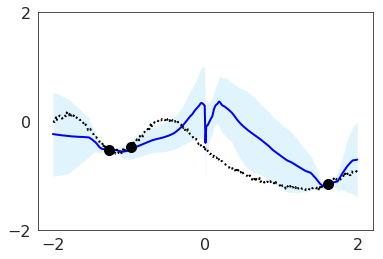

Test function: 3


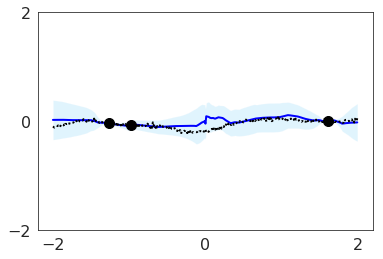

Iteration: 70000, train nll: -0.7944195866584778, mse: 0.06810535490512848, local kl: 0.0, global kl 0.0
Test function: 1


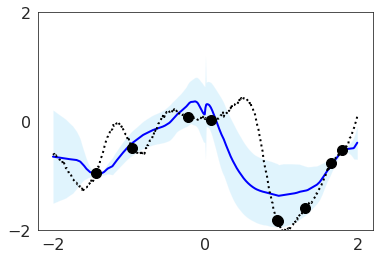

Test function: 2


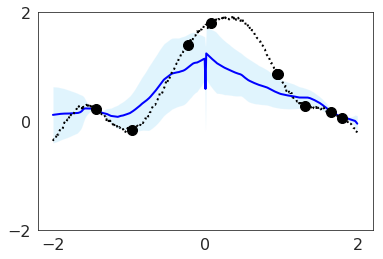

Test function: 3


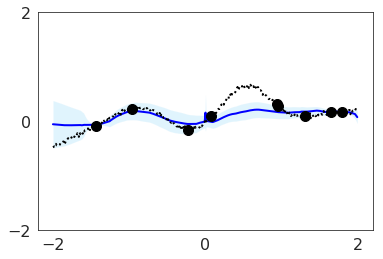

Iteration: 80000, train nll: -0.9733098745346069, mse: 0.056136250495910645, local kl: 0.0, global kl 0.0
Test function: 1


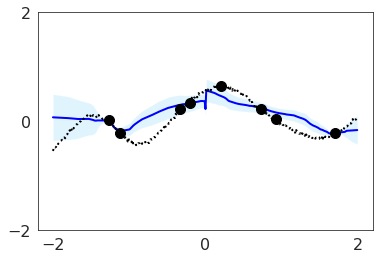

Test function: 2


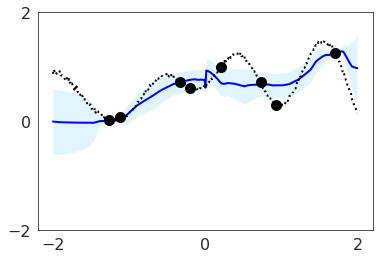

Test function: 3


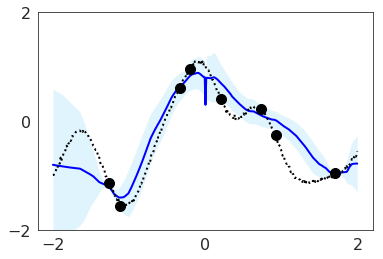

Iteration: 90000, train nll: -0.929841160774231, mse: 0.08917328715324402, local kl: 0.0, global kl 0.0
Saving model...
beta 0.5 temperature 0.5
Test function: 1


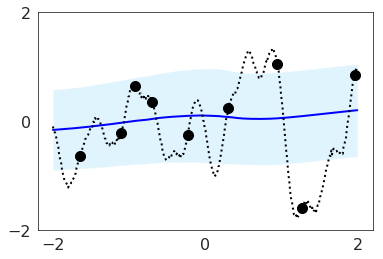

Test function: 2


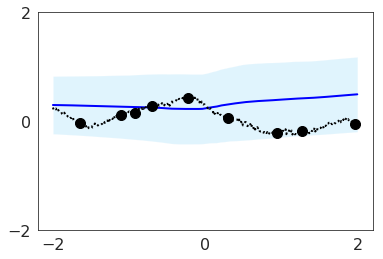

Test function: 3


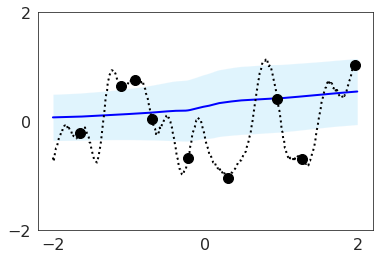

Iteration: 0, train nll: 1.0947771072387695, mse: 0.42466187477111816, local kl: 0.0, global kl 0.0
Test function: 1


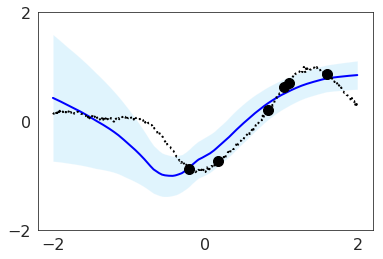

Test function: 2


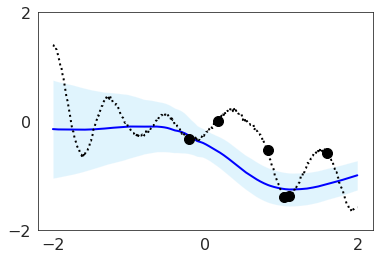

Test function: 3


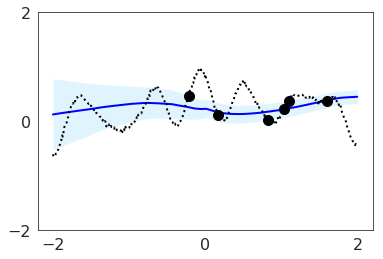

Iteration: 10000, train nll: -0.1502273976802826, mse: 0.11536404490470886, local kl: 0.0, global kl 0.0
Test function: 1


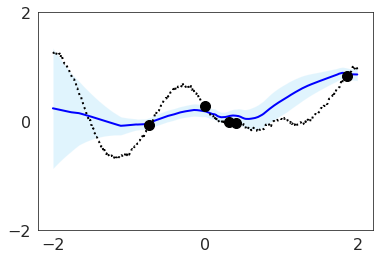

Test function: 2


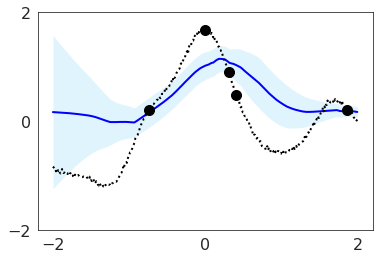

Test function: 3


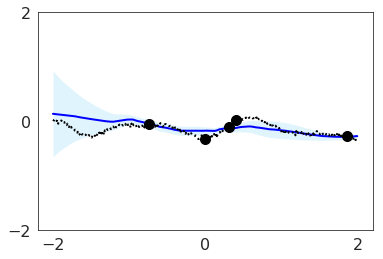

Iteration: 20000, train nll: -0.05851398780941963, mse: 0.1333925426006317, local kl: 0.0, global kl 0.004339682869613171
Test function: 1


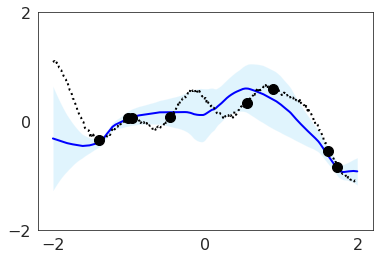

Test function: 2


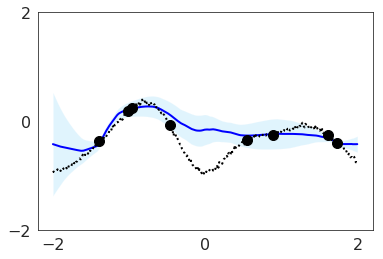

Test function: 3


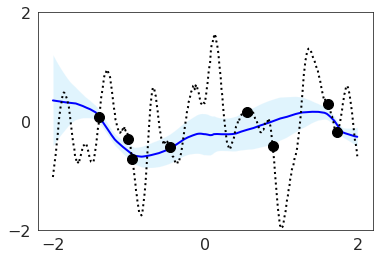

Iteration: 30000, train nll: -0.11449236422777176, mse: 0.11885368824005127, local kl: 0.0, global kl 0.004800188820809126
Test function: 1


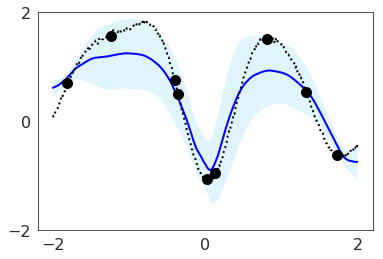

Test function: 2


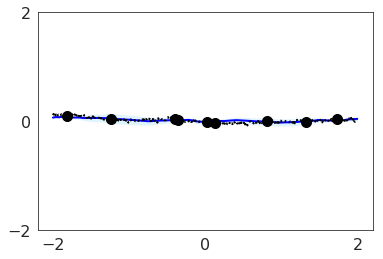

Test function: 3


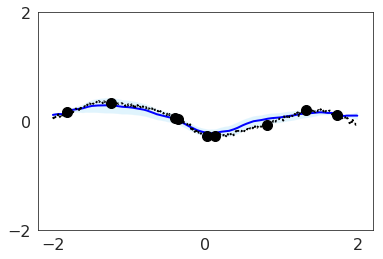

Iteration: 40000, train nll: -0.6329732537269592, mse: 0.06862089782953262, local kl: 0.0, global kl 0.0006783892749808729
Test function: 1


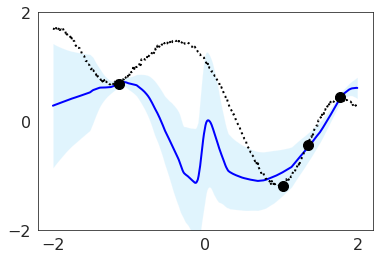

Test function: 2


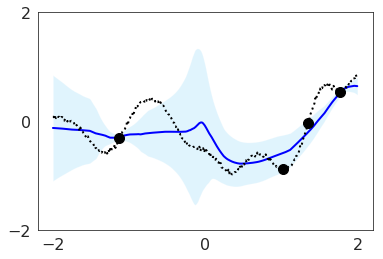

Test function: 3


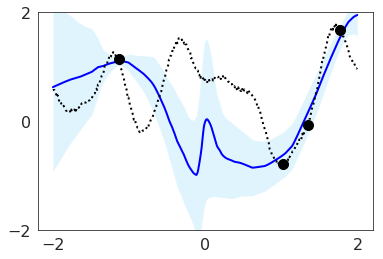

Iteration: 50000, train nll: -0.8277591466903687, mse: 0.0482490099966526, local kl: 0.0, global kl 0.0
Test function: 1


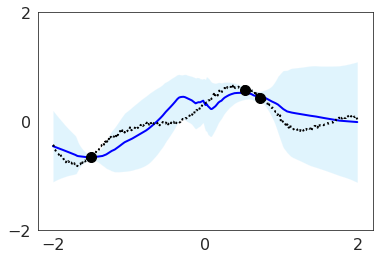

Test function: 2


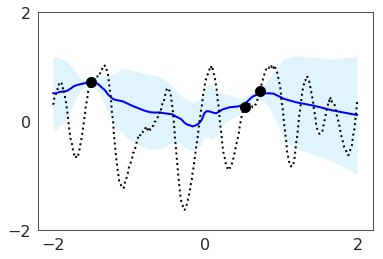

Test function: 3


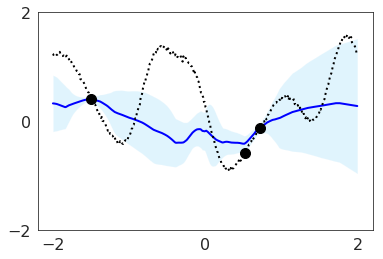

Iteration: 60000, train nll: 0.10539033263921738, mse: 0.08948349952697754, local kl: 0.0, global kl 0.0028406381607055664
Test function: 1


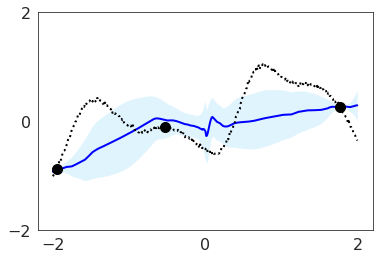

Test function: 2


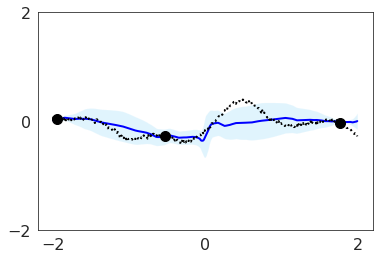

Test function: 3


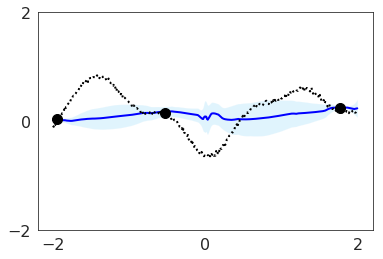

Iteration: 70000, train nll: -0.2643572688102722, mse: 0.12936104834079742, local kl: 0.0, global kl 0.00291982339695096
Test function: 1


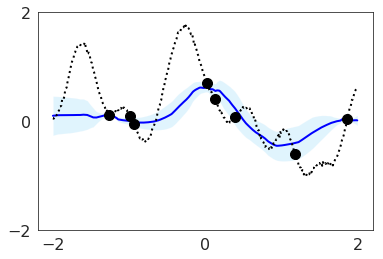

Test function: 2


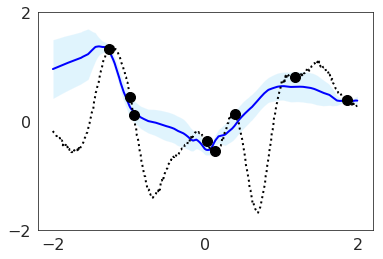

Test function: 3


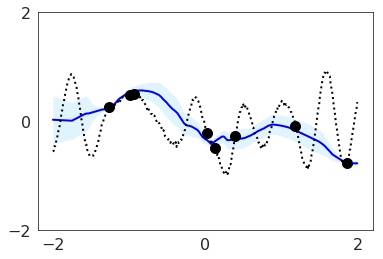

Iteration: 80000, train nll: -0.3617471158504486, mse: 0.10655149072408676, local kl: 0.0, global kl 0.0029532548505812883
Test function: 1


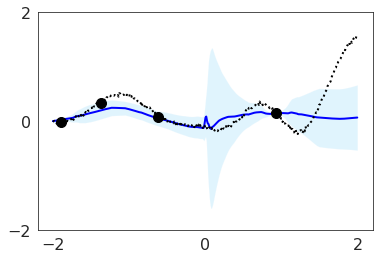

Test function: 2


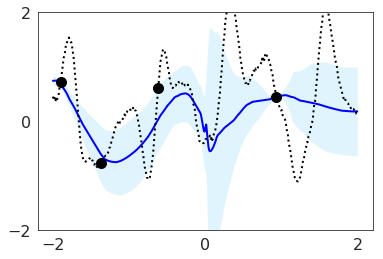

Test function: 3


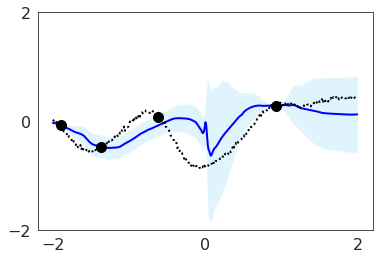

Iteration: 90000, train nll: -0.2227936089038849, mse: 0.08696498721837997, local kl: 0.0, global kl 0.001108420081436634
Saving model...
beta 0.5 temperature 1.0
Test function: 1


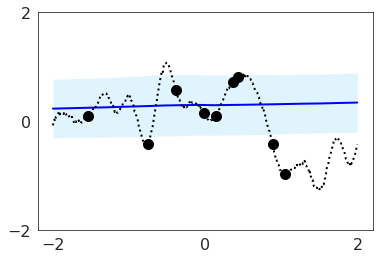

Test function: 2


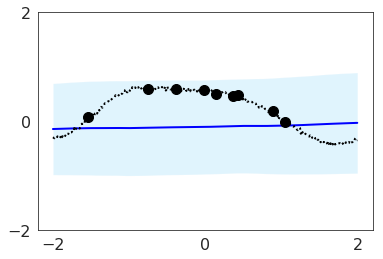

Test function: 3


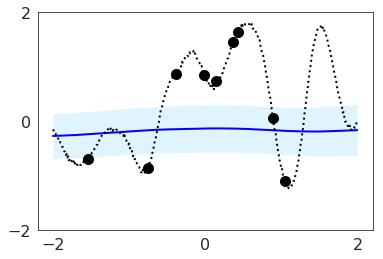

Iteration: 0, train nll: 1.073039174079895, mse: 0.384194552898407, local kl: 0.0, global kl 0.0
Test function: 1


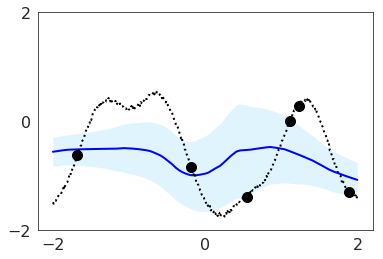

Test function: 2


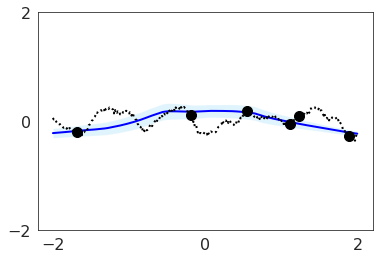

Test function: 3


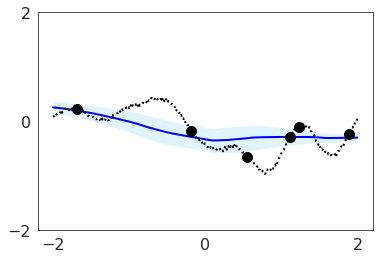

Iteration: 10000, train nll: -0.17136359214782715, mse: 0.10737152397632599, local kl: 0.0, global kl 0.0005467722075991333
Test function: 1


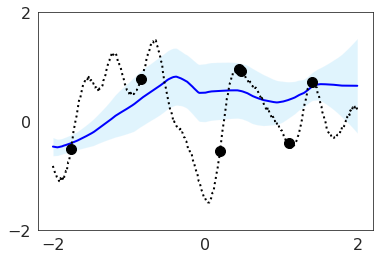

Test function: 2


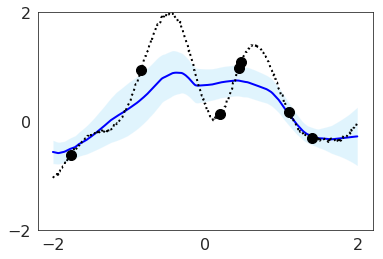

Test function: 3


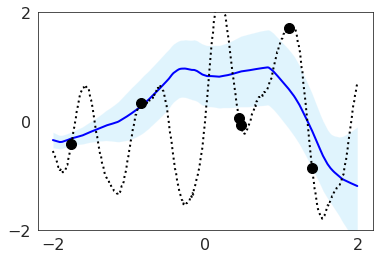

Iteration: 20000, train nll: 0.07492758333683014, mse: 0.16943636536598206, local kl: 0.0, global kl 0.004184826742857695
Test function: 1


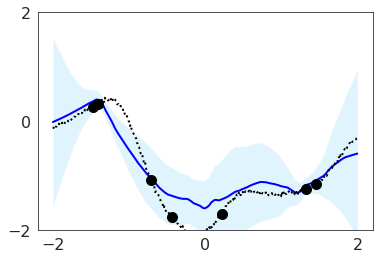

Test function: 2


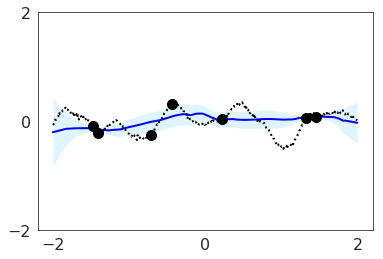

Test function: 3


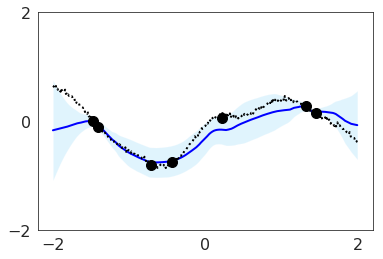

Iteration: 30000, train nll: 0.1712457686662674, mse: 0.19425052404403687, local kl: 0.0, global kl 0.00537269189953804
Test function: 1


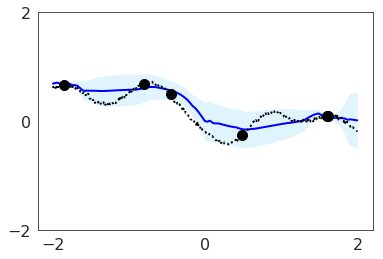

Test function: 2


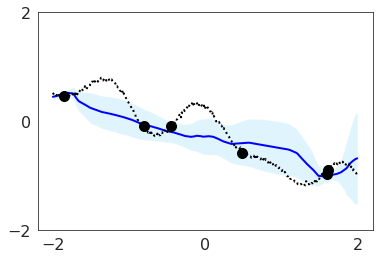

Test function: 3


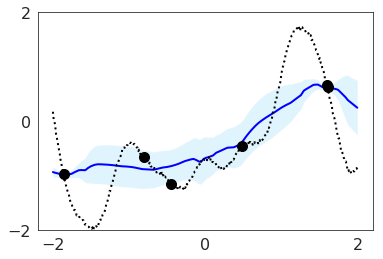

Iteration: 40000, train nll: -0.210770383477211, mse: 0.1087852492928505, local kl: 0.0, global kl 0.0027149119414389133
Test function: 1


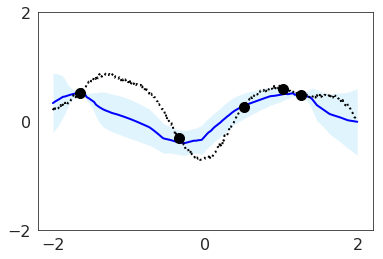

Test function: 2


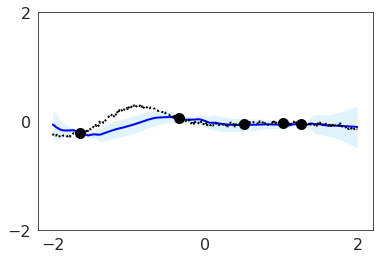

Test function: 3


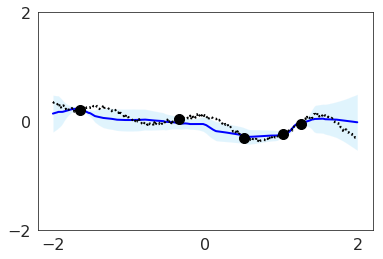

Iteration: 50000, train nll: -0.5512789487838745, mse: 0.053670208901166916, local kl: 0.0, global kl 0.0
Test function: 1


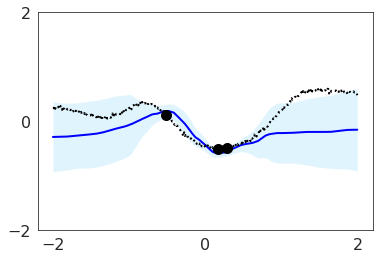

Test function: 2


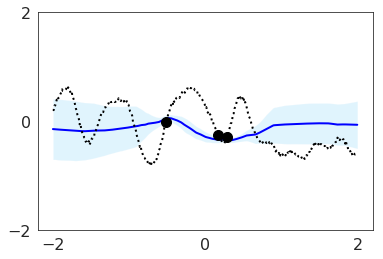

Test function: 3


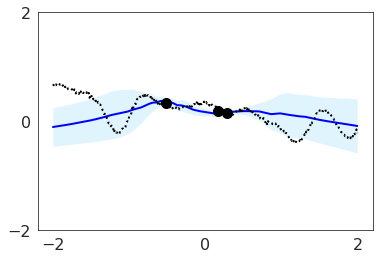

Iteration: 60000, train nll: -0.5819531679153442, mse: 0.07453389465808868, local kl: 0.0, global kl 0.001712737837806344
Test function: 1


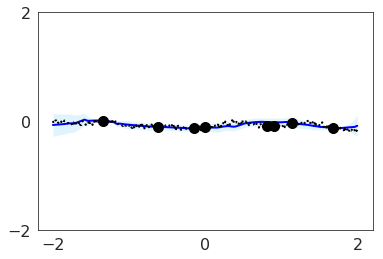

Test function: 2


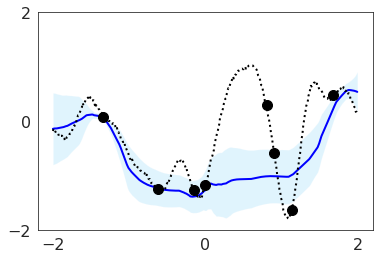

Test function: 3


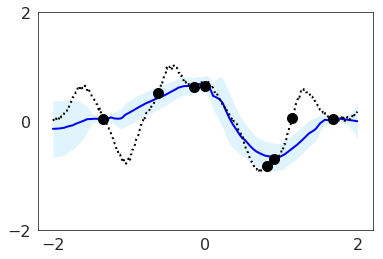

Iteration: 70000, train nll: -0.6818215250968933, mse: 0.08815305680036545, local kl: 0.0, global kl 0.0013605422573164105
Test function: 1


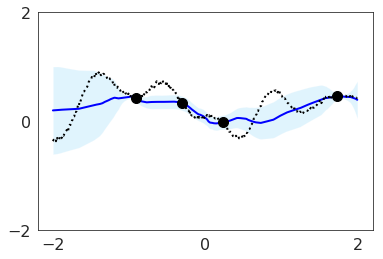

Test function: 2


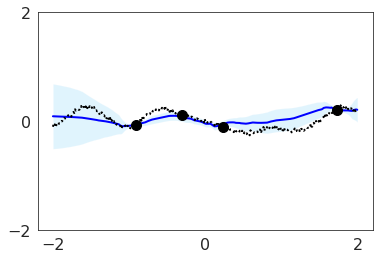

Test function: 3


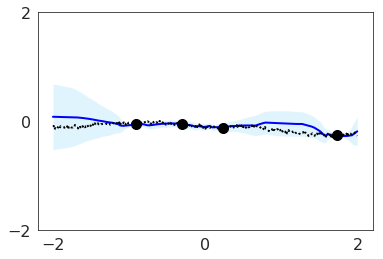

Iteration: 80000, train nll: -0.06377274543046951, mse: 0.20683647692203522, local kl: 0.0, global kl 0.005696606356650591
Test function: 1


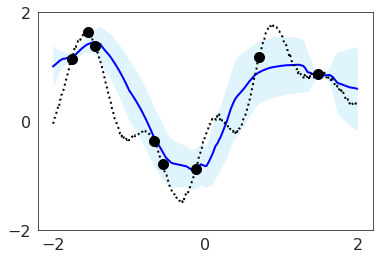

Test function: 2


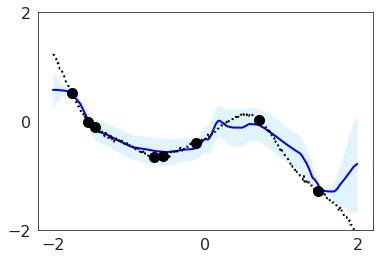

Test function: 3


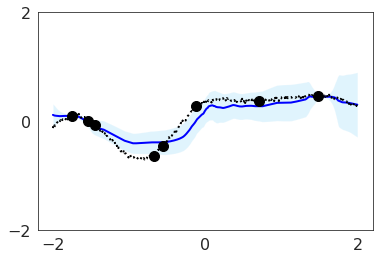

Iteration: 90000, train nll: -0.7298334836959839, mse: 0.048482730984687805, local kl: 0.0, global kl 0.0007349306251853704
Saving model...
beta 0.5 temperature 2.0
Test function: 1


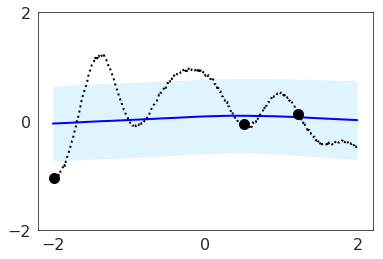

Test function: 2


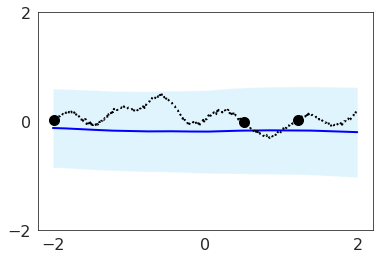

Test function: 3


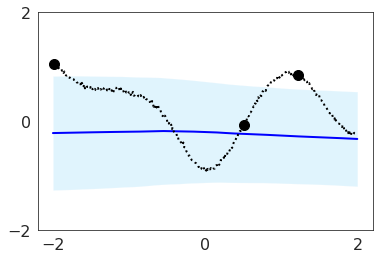

Iteration: 0, train nll: 1.0889513492584229, mse: 0.4731559753417969, local kl: 0.0, global kl 0.0
Test function: 1


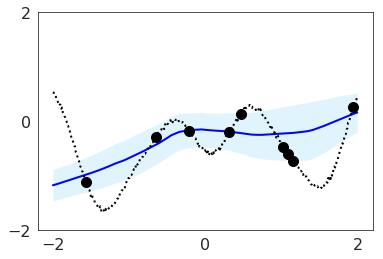

Test function: 2


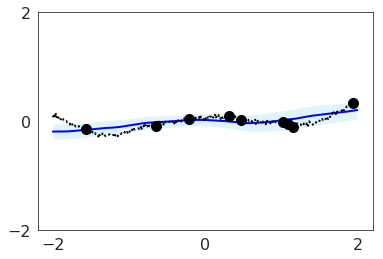

Test function: 3


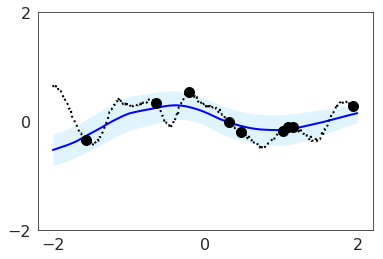

Iteration: 10000, train nll: 0.03079490177333355, mse: 0.1203480139374733, local kl: 0.0, global kl 0.0010085769463330507
Test function: 1


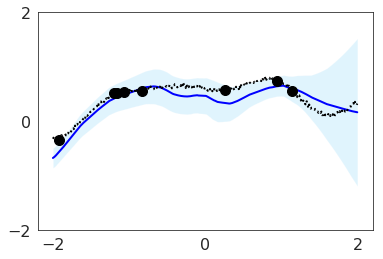

Test function: 2


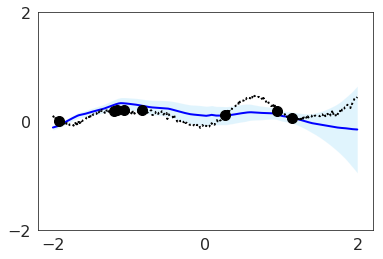

Test function: 3


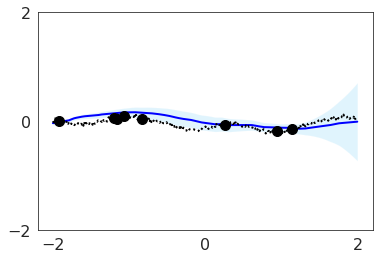

Iteration: 20000, train nll: -0.01483314111828804, mse: 0.12099737673997879, local kl: 0.0, global kl 0.00246923859231174
Test function: 1


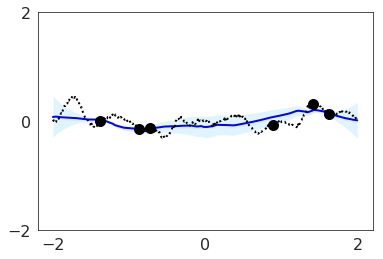

Test function: 2


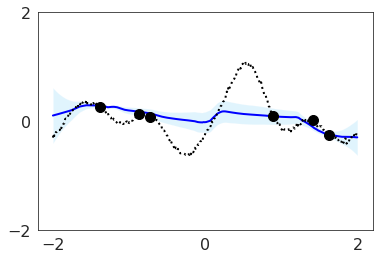

Test function: 3


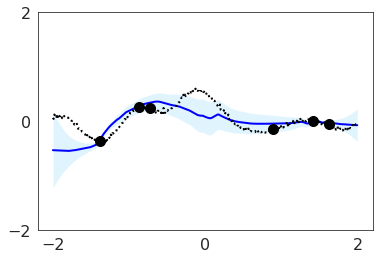

Iteration: 30000, train nll: -0.6581034064292908, mse: 0.07835527509450912, local kl: 0.0, global kl 0.0017545935697853565
Test function: 1


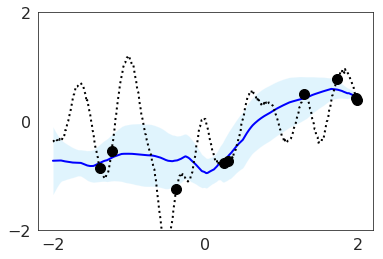

Test function: 2


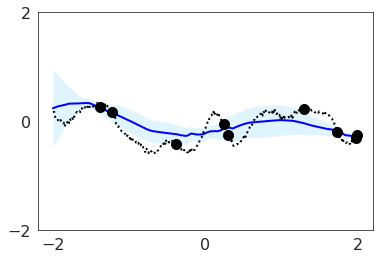

Test function: 3


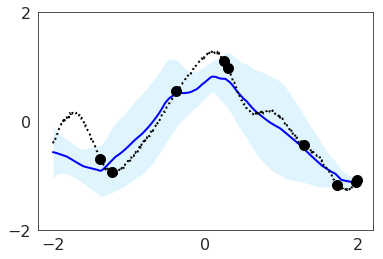

Iteration: 40000, train nll: -0.48013538122177124, mse: 0.05797754228115082, local kl: 0.0, global kl 0.0
Test function: 1


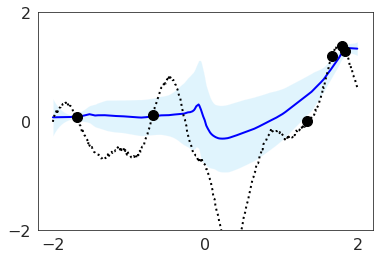

Test function: 2


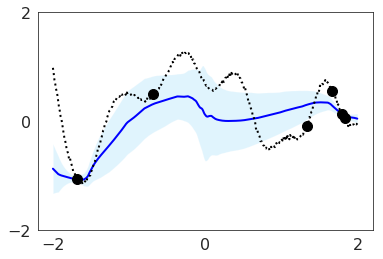

Test function: 3


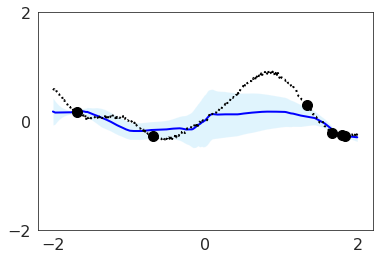

Iteration: 50000, train nll: -0.8152974843978882, mse: 0.07248450815677643, local kl: 0.0, global kl 0.00045574811520054936
Test function: 1


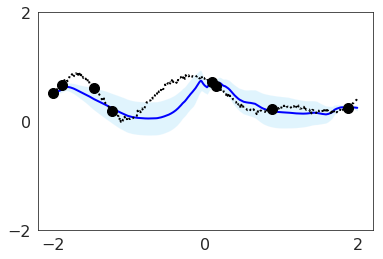

Test function: 2


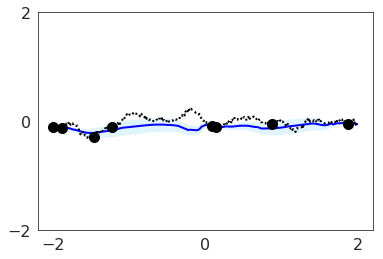

Test function: 3


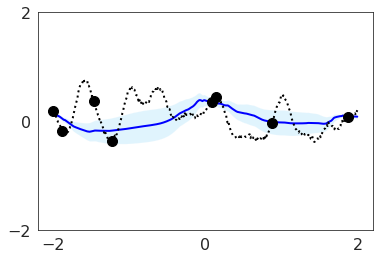

Iteration: 60000, train nll: -0.8139421343803406, mse: 0.04454338178038597, local kl: 0.0, global kl 0.0
Test function: 1


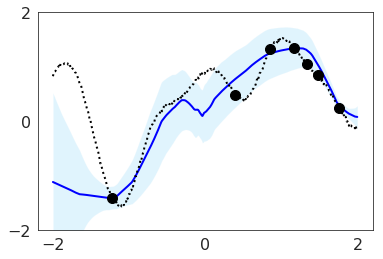

Test function: 2


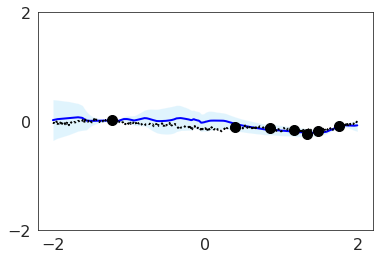

Test function: 3


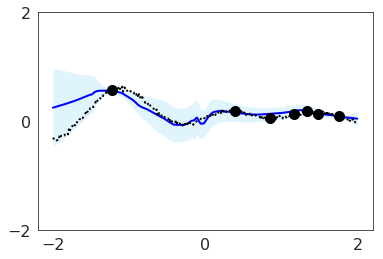

Iteration: 70000, train nll: -0.35201287269592285, mse: 0.15013453364372253, local kl: 0.0, global kl 0.0036330579314380884
Test function: 1


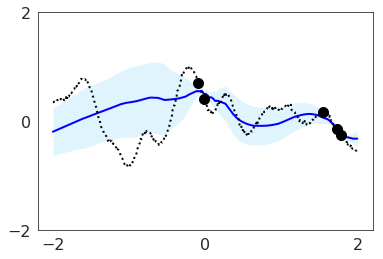

Test function: 2


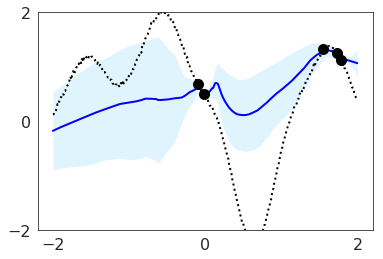

Test function: 3


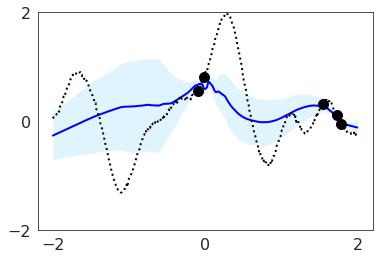

Iteration: 80000, train nll: 0.07620154321193695, mse: 0.1553362011909485, local kl: 0.0, global kl 0.007509200368076563
Test function: 1


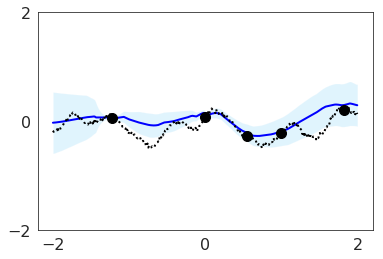

Test function: 2


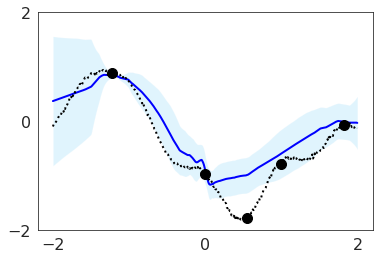

Test function: 3


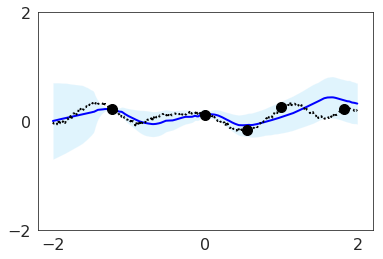

Iteration: 90000, train nll: -0.5896505117416382, mse: 0.03980560600757599, local kl: 0.0, global kl 0.007244712673127651
Saving model...
beta 0.5 temperature 5.0
Test function: 1


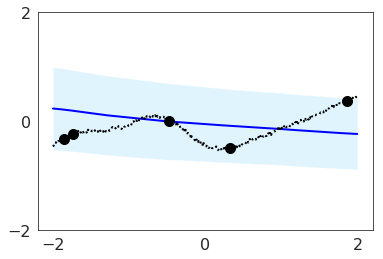

Test function: 2


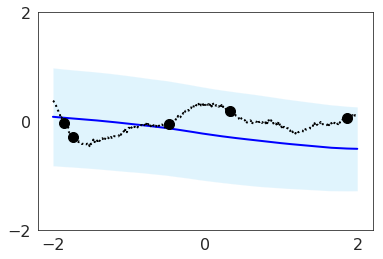

Test function: 3


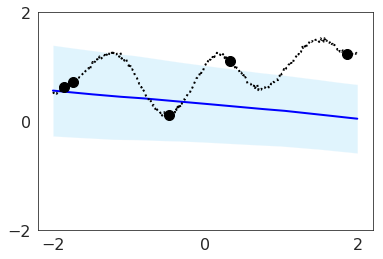

Iteration: 0, train nll: 1.0257885456085205, mse: 0.42910757660865784, local kl: 0.0, global kl 0.00924360379576683
Test function: 1


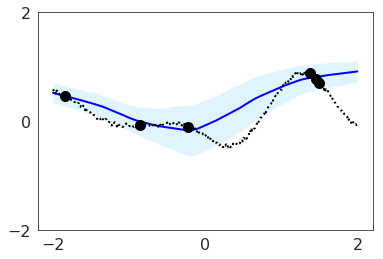

Test function: 2


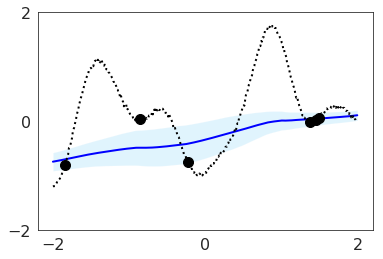

Test function: 3


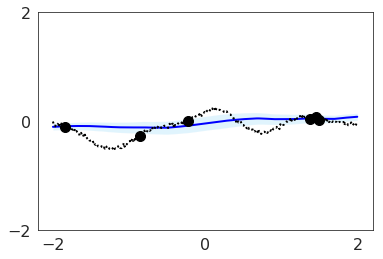

Iteration: 10000, train nll: -0.04705369845032692, mse: 0.12906600534915924, local kl: 0.0, global kl 0.0
Test function: 1


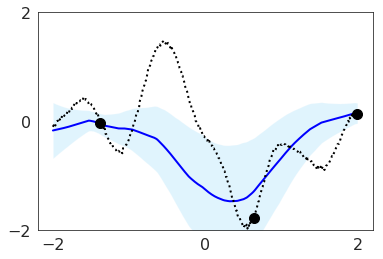

Test function: 2


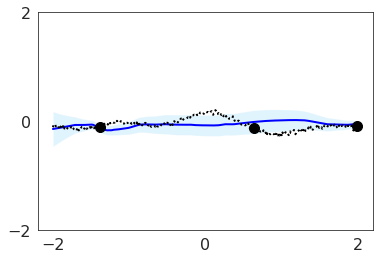

Test function: 3


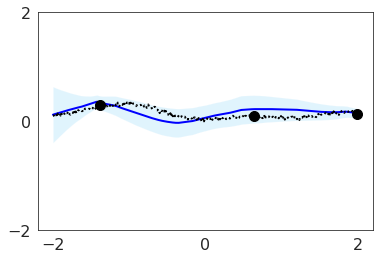

Iteration: 20000, train nll: -0.36196401715278625, mse: 0.07021741569042206, local kl: 0.0, global kl 0.0
Test function: 1


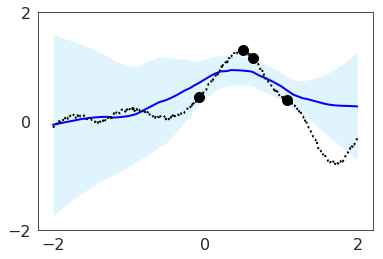

Test function: 2


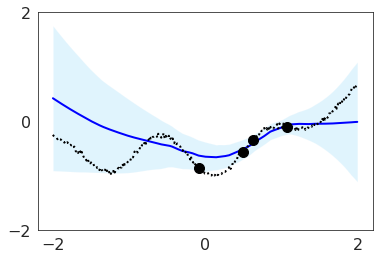

Test function: 3


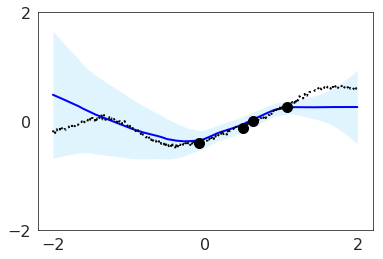

Iteration: 30000, train nll: 0.11692681163549423, mse: 0.1779744178056717, local kl: 0.0, global kl 0.00479114567860961
Test function: 1


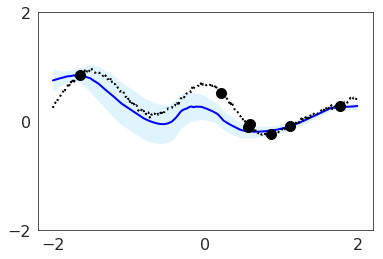

Test function: 2


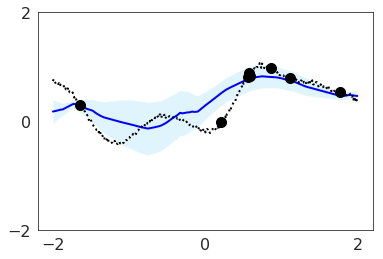

Test function: 3


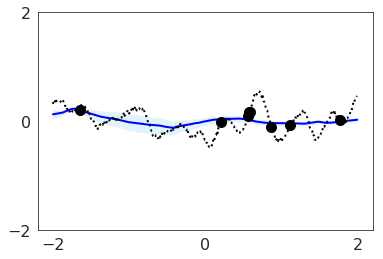

Iteration: 40000, train nll: -0.9528604745864868, mse: 0.016608159989118576, local kl: 0.0, global kl 0.0
Test function: 1


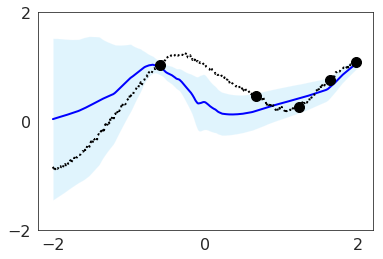

Test function: 2


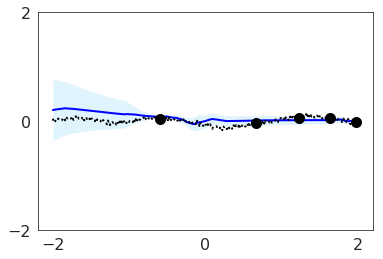

Test function: 3


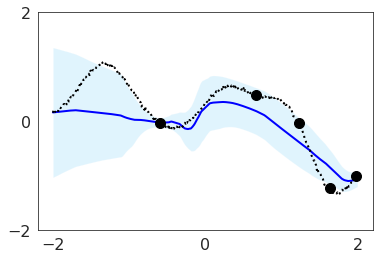

Iteration: 50000, train nll: 0.15530924499034882, mse: 0.1861516833305359, local kl: 0.0, global kl 0.004891126416623592
Test function: 1


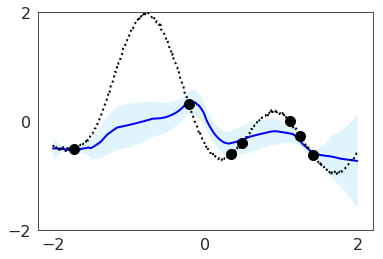

Test function: 2


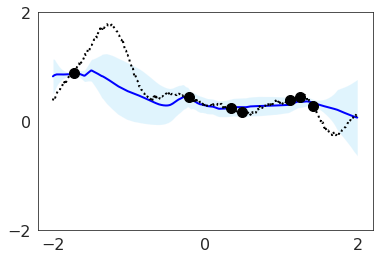

Test function: 3


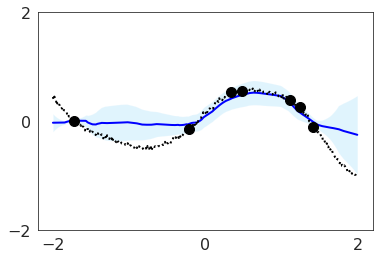

Iteration: 60000, train nll: -0.4688481092453003, mse: 0.09680887311697006, local kl: 0.0, global kl 0.003723186906427145
Test function: 1


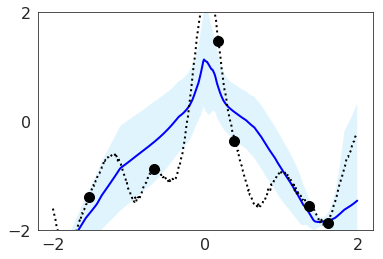

Test function: 2


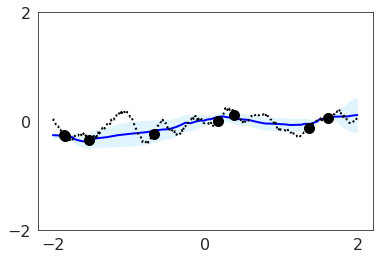

Test function: 3


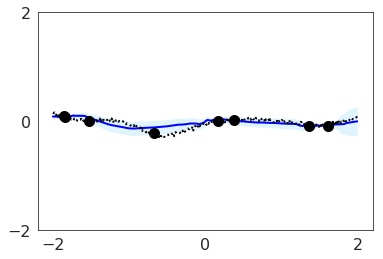

Iteration: 70000, train nll: -0.7918313145637512, mse: 0.058955032378435135, local kl: 0.0, global kl 0.0
Test function: 1


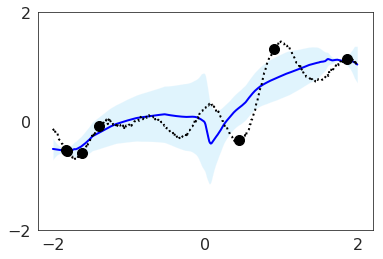

Test function: 2


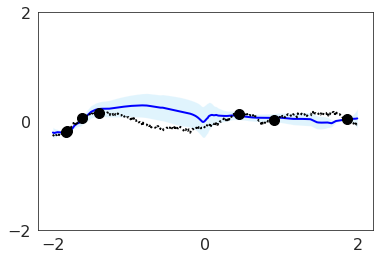

Test function: 3


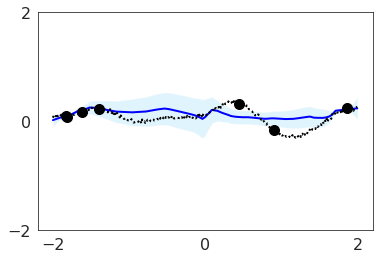

Iteration: 80000, train nll: -0.6791833639144897, mse: 0.06459230929613113, local kl: 0.0, global kl 0.00029683700995519757
Test function: 1


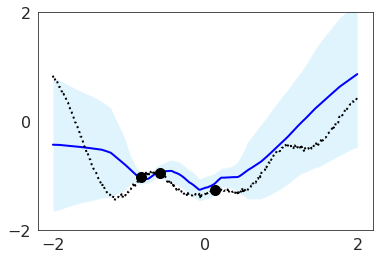

Test function: 2


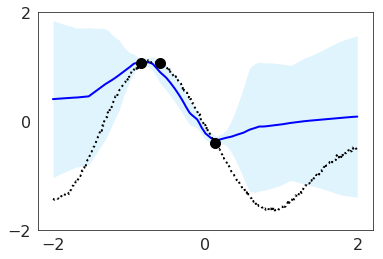

Test function: 3


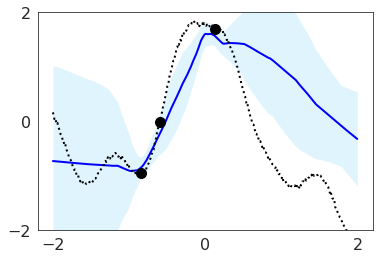

Iteration: 90000, train nll: -0.8595588207244873, mse: 0.06057753041386604, local kl: 0.0, global kl 0.0006936753634363413
Saving model...
beta 0.5 temperature 1000.0
Test function: 1


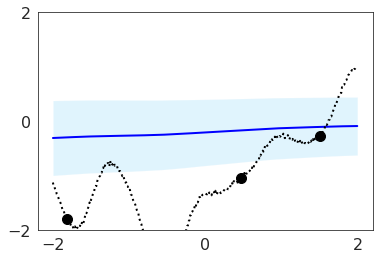

Test function: 2


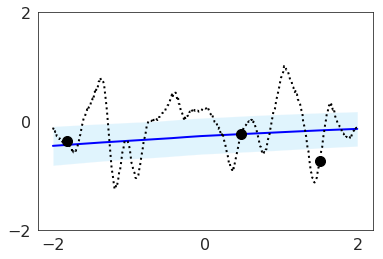

Test function: 3


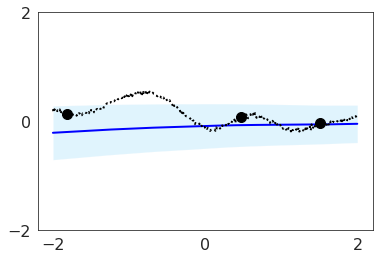

Iteration: 0, train nll: 1.2008912563323975, mse: 0.3966360092163086, local kl: 0.0, global kl 0.006637741345912218
Test function: 1


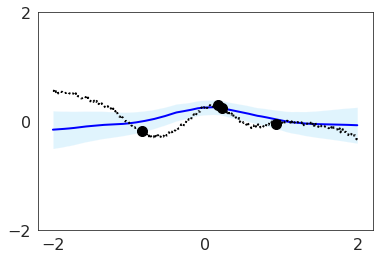

Test function: 2


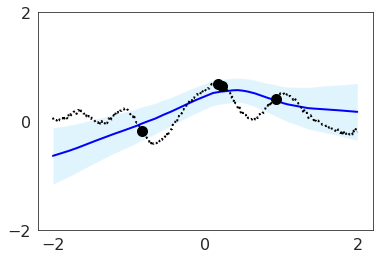

Test function: 3


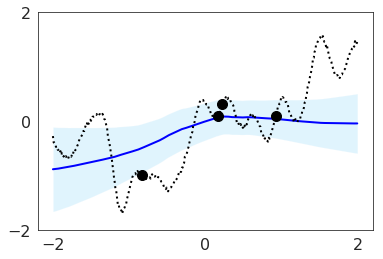

Iteration: 10000, train nll: 0.007558105047792196, mse: 0.1666863113641739, local kl: 0.0, global kl 0.0
Test function: 1


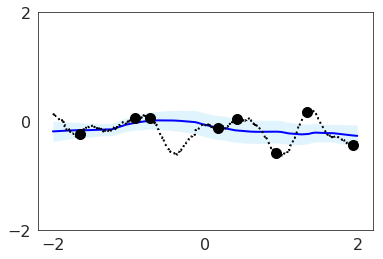

Test function: 2


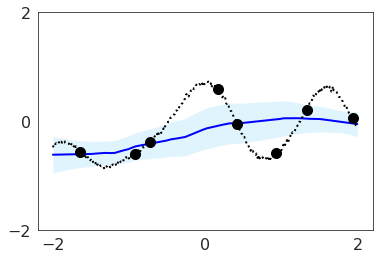

Test function: 3


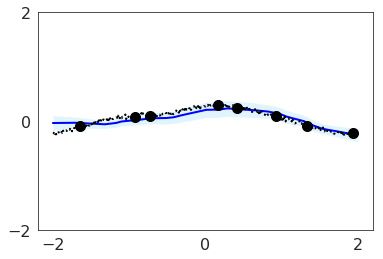

Iteration: 20000, train nll: -0.4034483730792999, mse: 0.04724818095564842, local kl: 0.0, global kl 0.0
Test function: 1


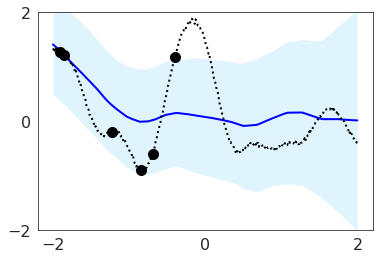

Test function: 2


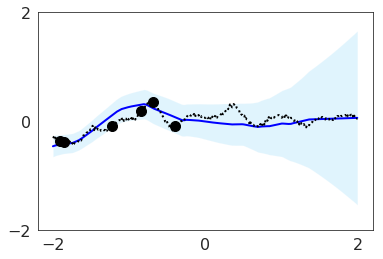

Test function: 3


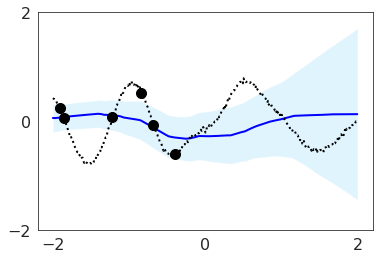

Iteration: 30000, train nll: -0.37709447741508484, mse: 0.05702929198741913, local kl: 0.0, global kl 0.0
Test function: 1


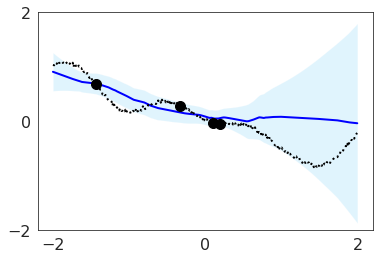

Test function: 2


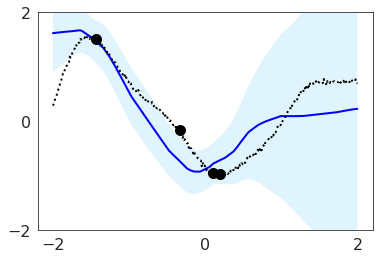

Test function: 3


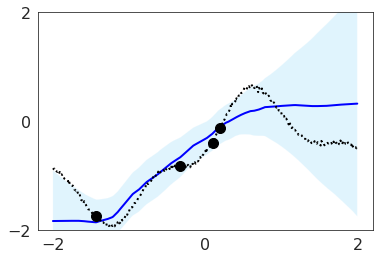

Iteration: 40000, train nll: -0.04412180930376053, mse: 0.08963809907436371, local kl: 0.0, global kl 0.0029377788305282593
Test function: 1


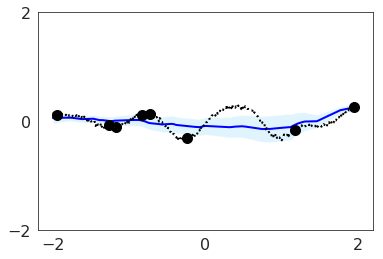

Test function: 2


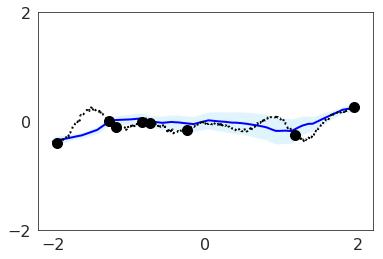

Test function: 3


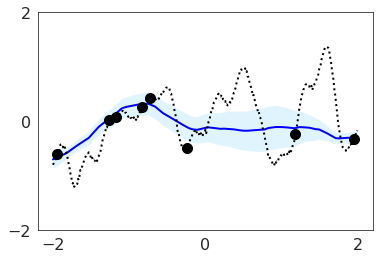

Iteration: 50000, train nll: -0.09740987420082092, mse: 0.10191897302865982, local kl: 0.0, global kl 0.0011093600187450647
Test function: 1


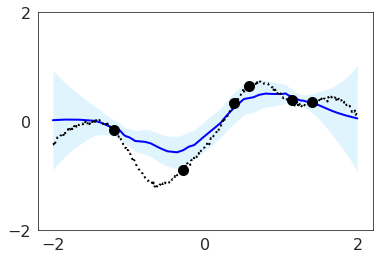

Test function: 2


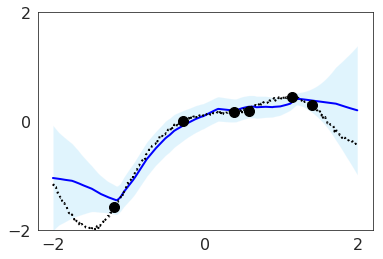

Test function: 3


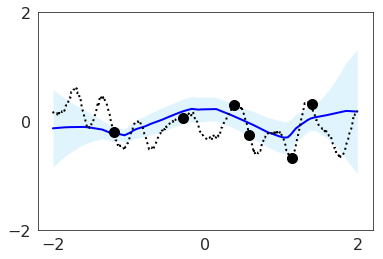

Iteration: 60000, train nll: -0.37260401248931885, mse: 0.057287368923425674, local kl: 0.0, global kl 0.000756756984628737
Test function: 1


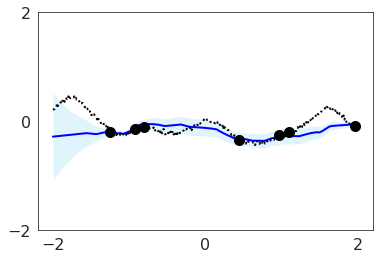

Test function: 2


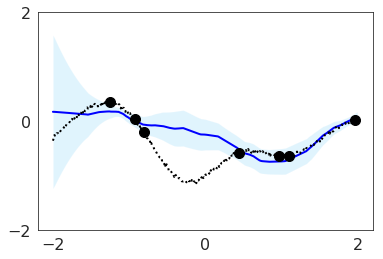

Test function: 3


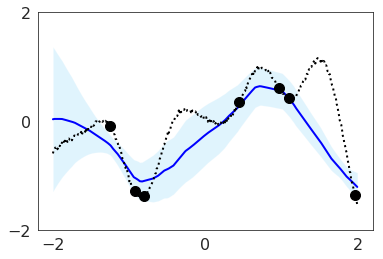

Iteration: 70000, train nll: 0.0654309019446373, mse: 0.134815514087677, local kl: 0.0, global kl 0.002471263287588954
Test function: 1


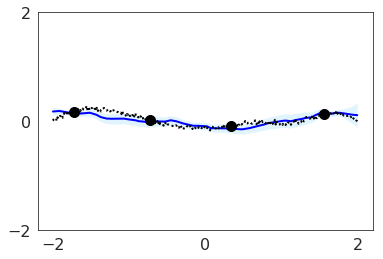

Test function: 2


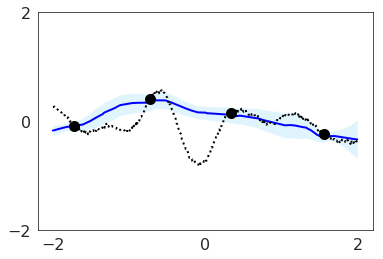

Test function: 3


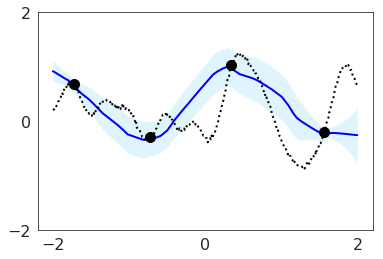

Iteration: 80000, train nll: -0.03232129290699959, mse: 0.1162225529551506, local kl: 0.0, global kl 0.0014191907830536366
Test function: 1


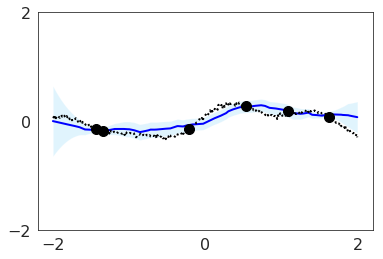

Test function: 2


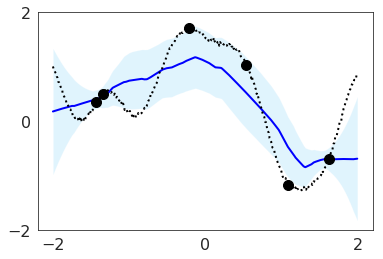

Test function: 3


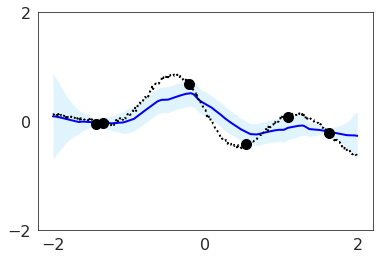

Iteration: 90000, train nll: -0.5341103672981262, mse: 0.04870105907320976, local kl: 0.0, global kl 0.00019428858649916947
Saving model...
beta 1.0 temperature 0.001
Test function: 1


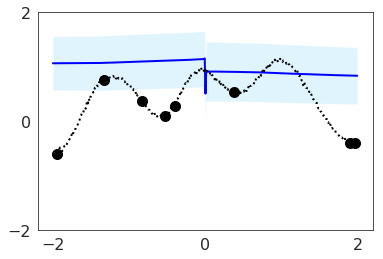

Test function: 2


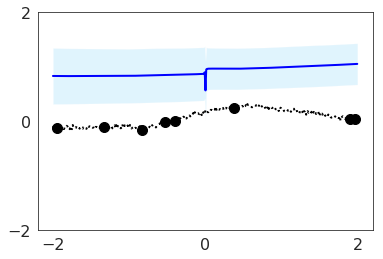

Test function: 3


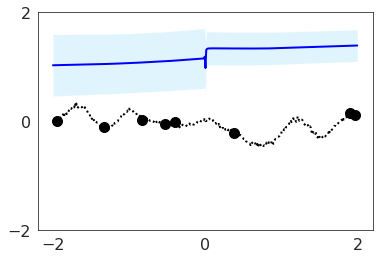

Iteration: 0, train nll: 3.914921760559082, mse: 1.402077078819275, local kl: 0.0, global kl 0.004785805940628052
Test function: 1


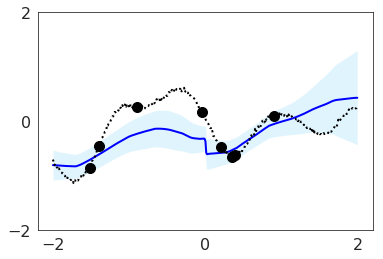

Test function: 2


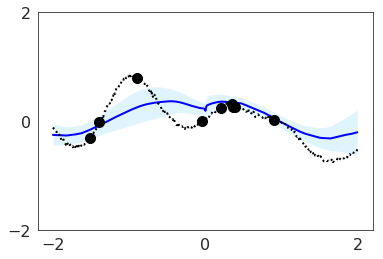

Test function: 3


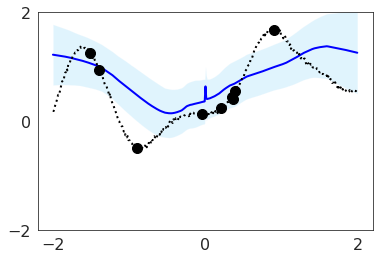

Iteration: 10000, train nll: -0.06685706228017807, mse: 0.1393366903066635, local kl: 0.0, global kl 0.000537613988853991
Test function: 1


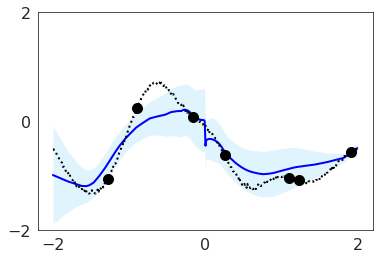

Test function: 2


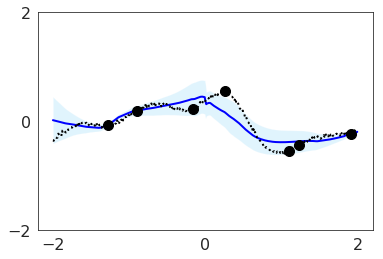

Test function: 3


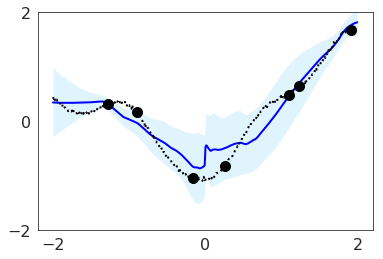

Iteration: 20000, train nll: -1.0562180280685425, mse: 0.02006380632519722, local kl: 0.0, global kl 0.0
Test function: 1


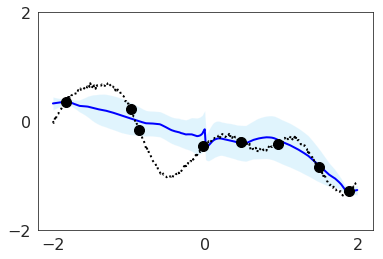

Test function: 2


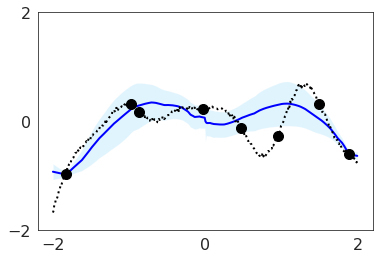

Test function: 3


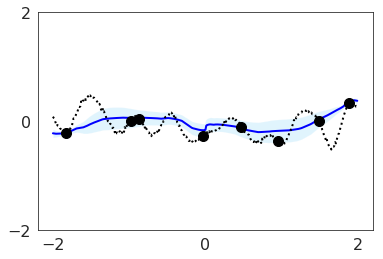

Iteration: 30000, train nll: 0.2673918604850769, mse: 0.16914430260658264, local kl: 0.0, global kl 0.009664124809205532
Test function: 1


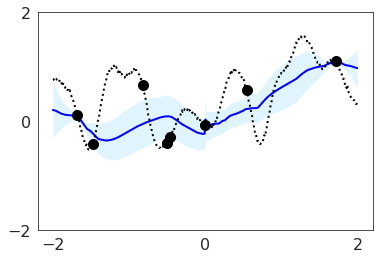

Test function: 2


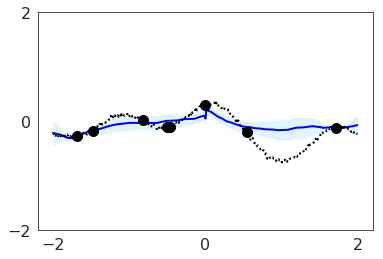

Test function: 3


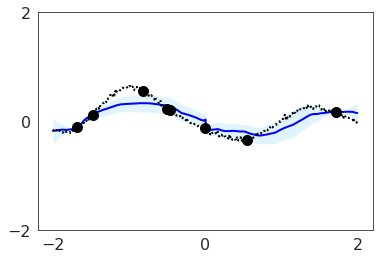

Iteration: 40000, train nll: -1.4419958591461182, mse: 0.019135916605591774, local kl: 0.0, global kl 0.0
Test function: 1


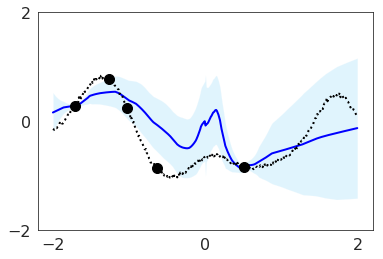

Test function: 2


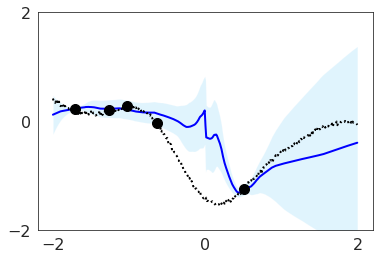

Test function: 3


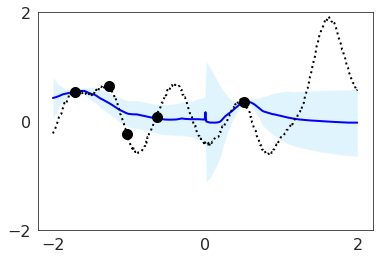

Iteration: 50000, train nll: -1.2236286401748657, mse: 0.026072489097714424, local kl: 0.0, global kl 0.0
Test function: 1


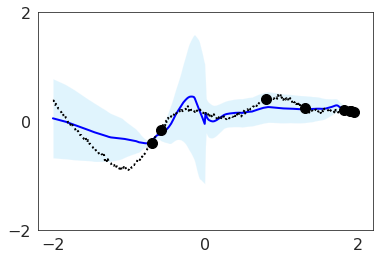

Test function: 2


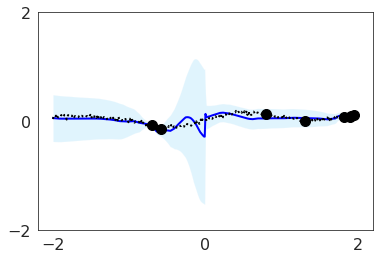

Test function: 3


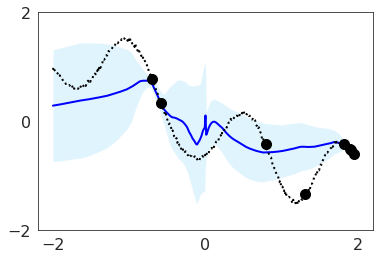

Iteration: 60000, train nll: -0.8836321830749512, mse: 0.0744064599275589, local kl: 0.0, global kl 0.0
Test function: 1


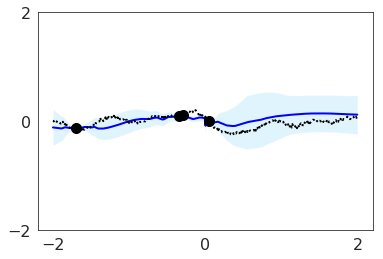

Test function: 2


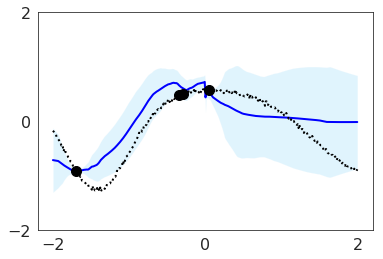

Test function: 3


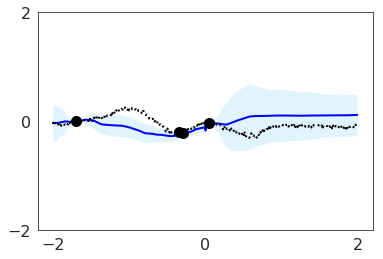

Iteration: 70000, train nll: -1.4030044078826904, mse: 0.02739081345498562, local kl: 0.0, global kl 0.0
Test function: 1


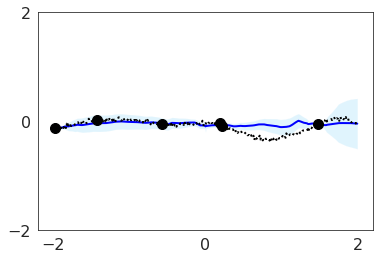

Test function: 2


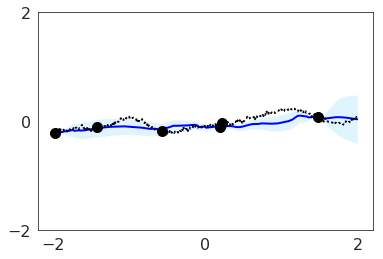

Test function: 3


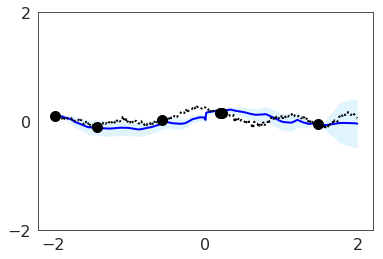

Iteration: 80000, train nll: -1.0093828439712524, mse: 0.06839675456285477, local kl: 0.0, global kl 0.001170525560155511
Test function: 1


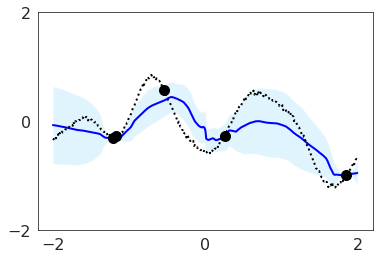

Test function: 2


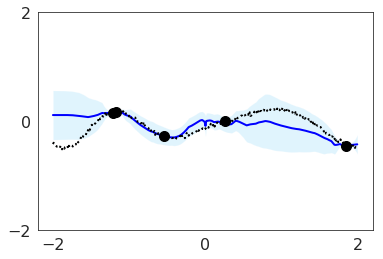

Test function: 3


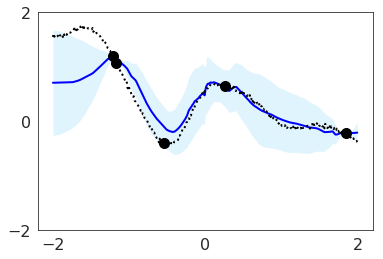

Iteration: 90000, train nll: -1.1216533184051514, mse: 0.05405145883560181, local kl: 0.0, global kl 0.0
Saving model...
beta 1.0 temperature 0.5
Test function: 1


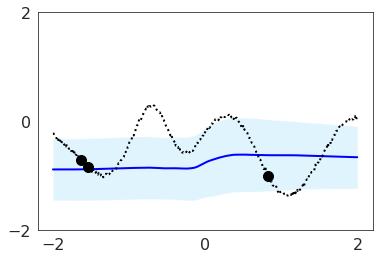

Test function: 2


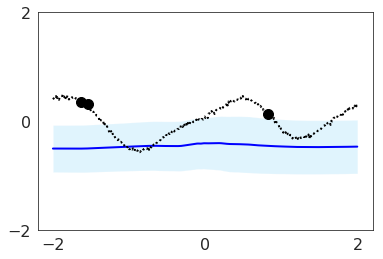

Test function: 3


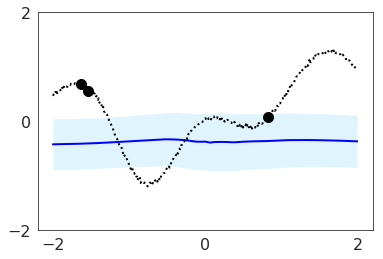

Iteration: 0, train nll: 1.7807317972183228, mse: 0.6904395222663879, local kl: 0.0, global kl 0.00497835036367178
Test function: 1


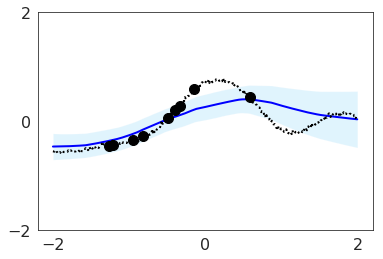

Test function: 2


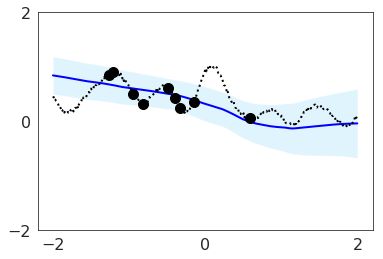

Test function: 3


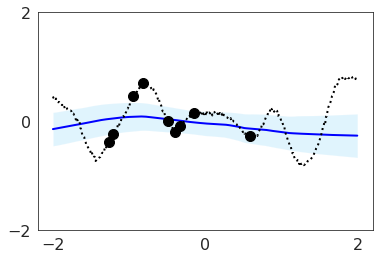

Iteration: 10000, train nll: 1.2207894325256348, mse: 0.20642605423927307, local kl: 0.0, global kl 0.00974666140973568
Test function: 1


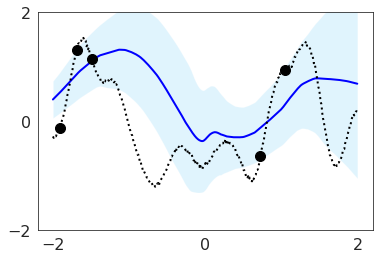

Test function: 2


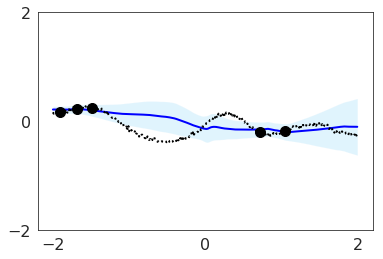

Test function: 3


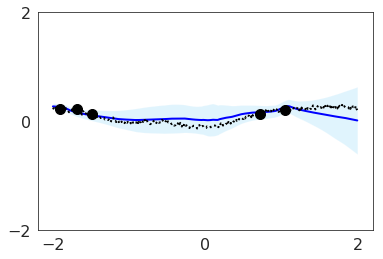

Iteration: 20000, train nll: -0.25690945982933044, mse: 0.09953369200229645, local kl: 0.0, global kl 0.0011910288594663143
Test function: 1


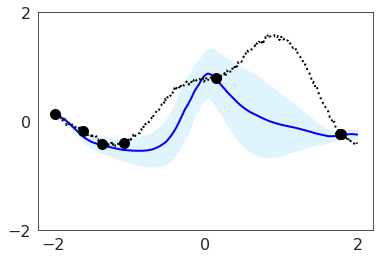

Test function: 2


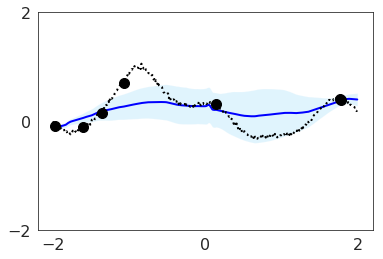

Test function: 3


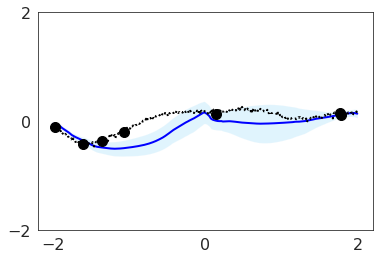

Iteration: 30000, train nll: -0.6144274473190308, mse: 0.06445024162530899, local kl: 0.0, global kl 0.0015723883407190442
Test function: 1


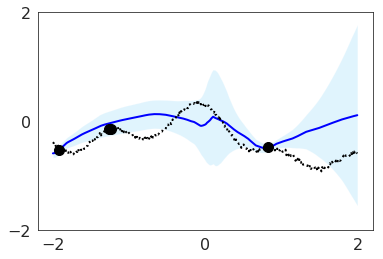

Test function: 2


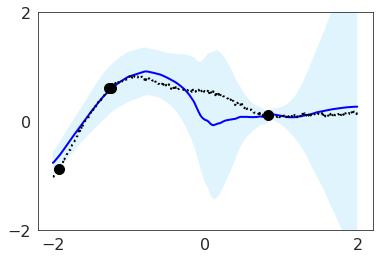

Test function: 3


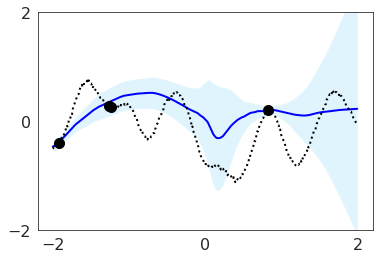

Iteration: 40000, train nll: -0.061962809413671494, mse: 0.11283045262098312, local kl: 0.0, global kl 0.002462076721712947
Test function: 1


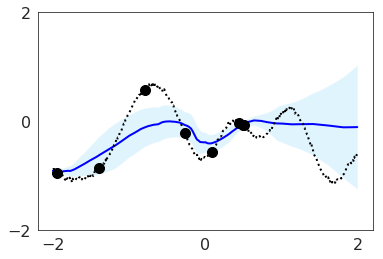

Test function: 2


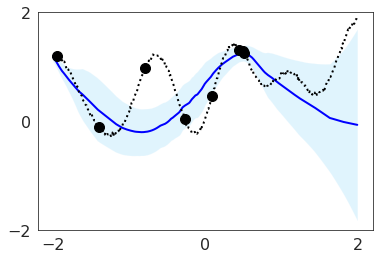

Test function: 3


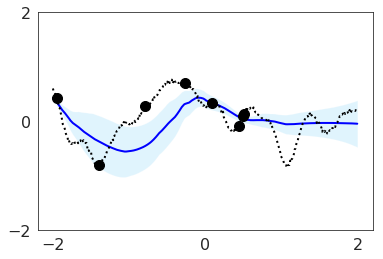

Iteration: 50000, train nll: -0.7166420817375183, mse: 0.08438471704721451, local kl: 0.0, global kl 0.0
Test function: 1


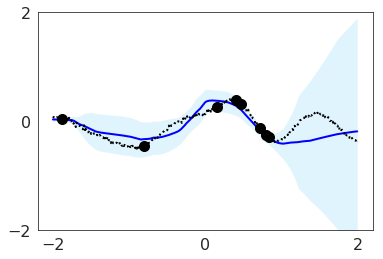

Test function: 2


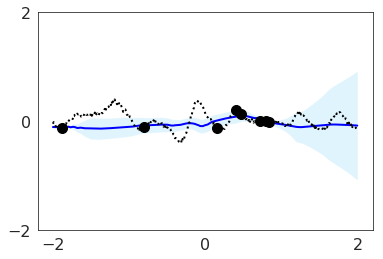

Test function: 3


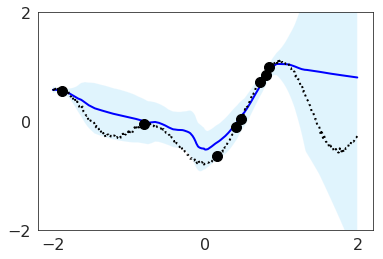

Iteration: 60000, train nll: -0.7958295941352844, mse: 0.04196591302752495, local kl: 0.0, global kl 0.0
Test function: 1


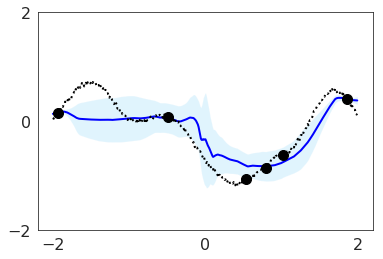

Test function: 2


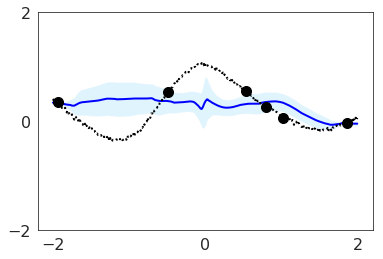

Test function: 3


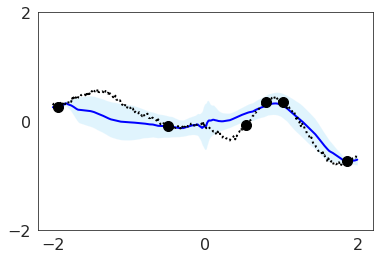

Iteration: 70000, train nll: -1.1752957105636597, mse: 0.04497971385717392, local kl: 0.0, global kl 0.0
Test function: 1


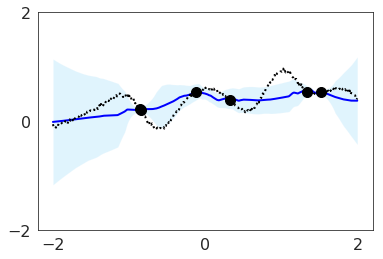

Test function: 2


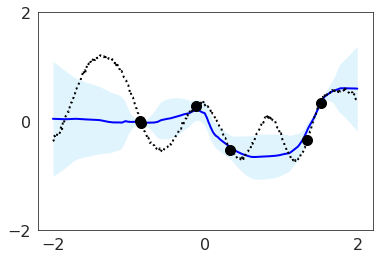

Test function: 3


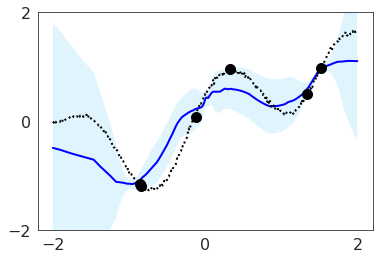

Iteration: 80000, train nll: -1.2142598628997803, mse: 0.03601618856191635, local kl: 0.0, global kl 0.0
Test function: 1


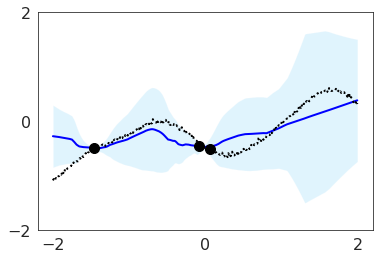

Test function: 2


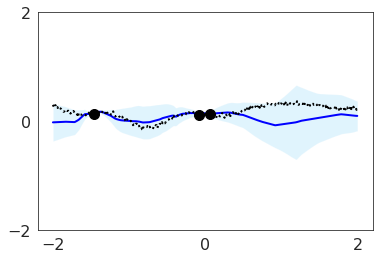

Test function: 3


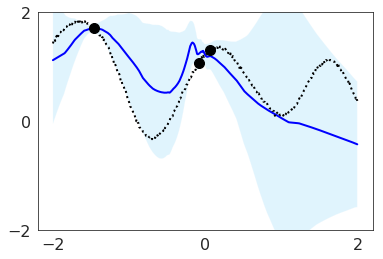

Iteration: 90000, train nll: 0.031343717128038406, mse: 0.20769788324832916, local kl: 0.0, global kl 0.004653485491871834
Saving model...
beta 1.0 temperature 1.0
Test function: 1


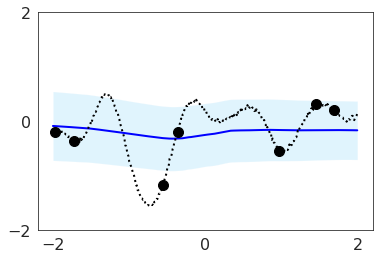

Test function: 2


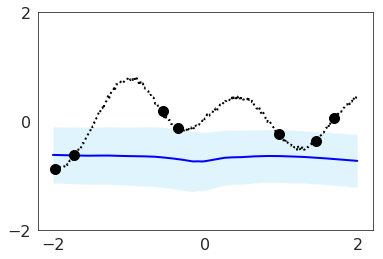

Test function: 3


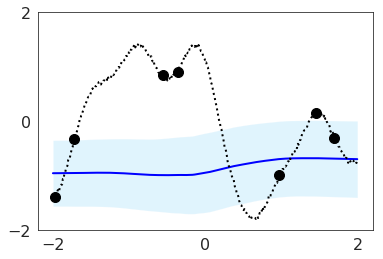

Iteration: 0, train nll: 1.2499961853027344, mse: 0.6279556751251221, local kl: 0.0, global kl 0.0
Test function: 1


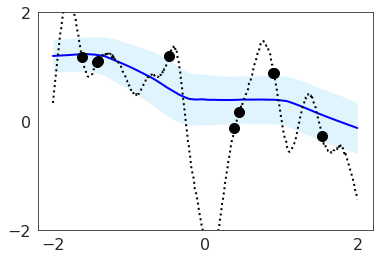

Test function: 2


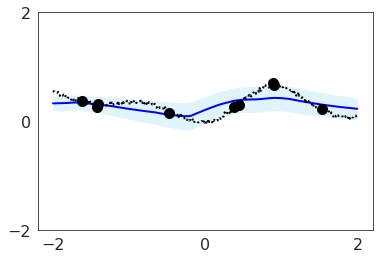

Test function: 3


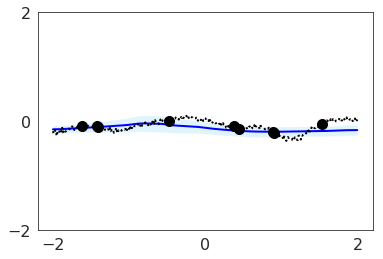

Iteration: 10000, train nll: 0.7693620920181274, mse: 0.281332790851593, local kl: 0.0, global kl 0.01692391000688076
Test function: 1


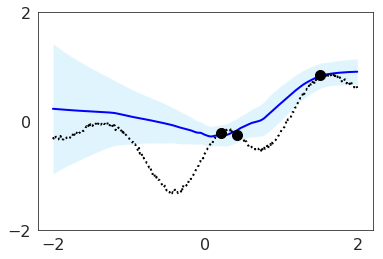

Test function: 2


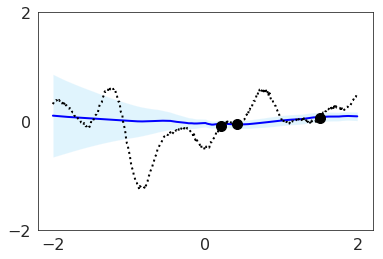

Test function: 3


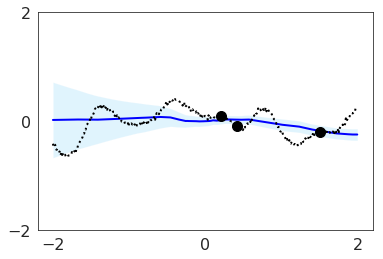

Iteration: 20000, train nll: -0.4988820552825928, mse: 0.06481584906578064, local kl: 0.0, global kl 0.0016970568103715777
Test function: 1


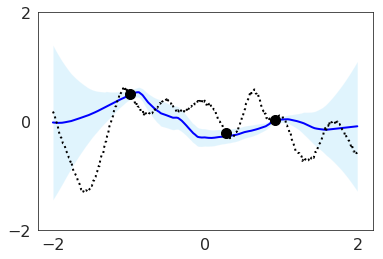

Test function: 2


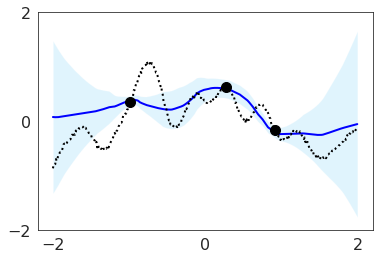

Test function: 3


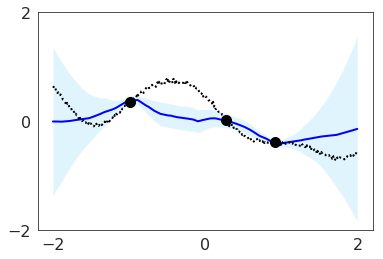

Iteration: 30000, train nll: -0.023958630859851837, mse: 0.11391150951385498, local kl: 0.0, global kl 0.0013369503431022167
Test function: 1


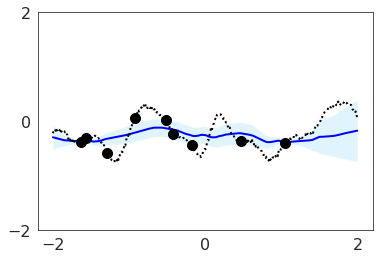

Test function: 2


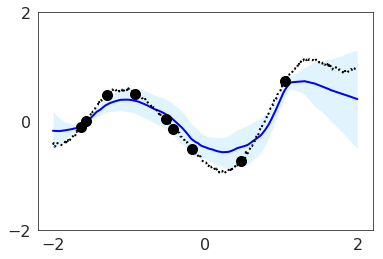

Test function: 3


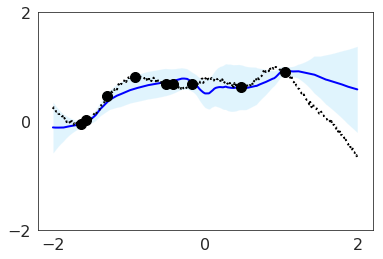

Iteration: 40000, train nll: -0.77120441198349, mse: 0.055315323173999786, local kl: 0.0, global kl 0.0
Test function: 1


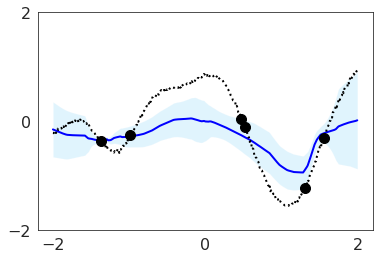

Test function: 2


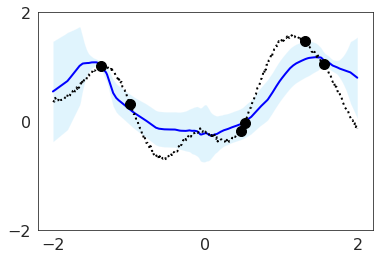

Test function: 3


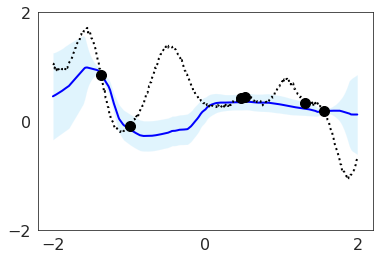

Iteration: 50000, train nll: -0.668364942073822, mse: 0.05785683915019035, local kl: 0.0, global kl 0.0019425200298428535
Test function: 1


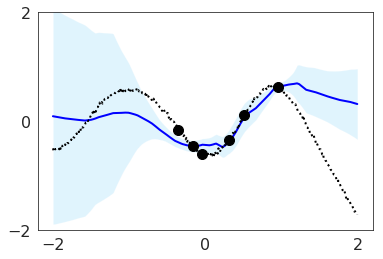

Test function: 2


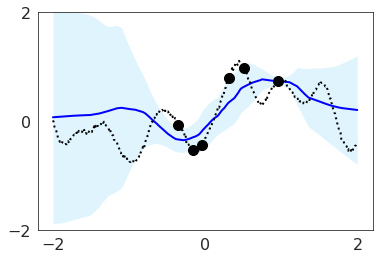

Test function: 3


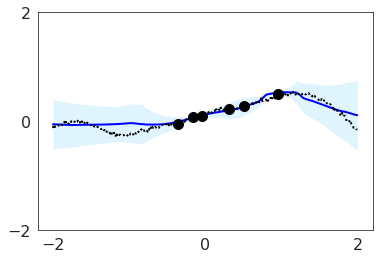

Iteration: 60000, train nll: -0.3934195637702942, mse: 0.11952565610408783, local kl: 0.0, global kl 0.0020512444898486137
Test function: 1


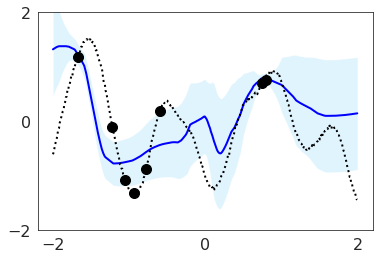

Test function: 2


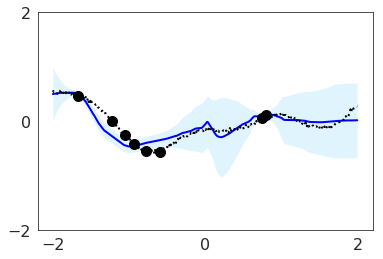

Test function: 3


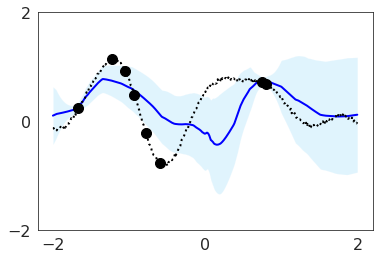

Iteration: 70000, train nll: -0.505354642868042, mse: 0.07681858539581299, local kl: 0.0, global kl 0.0005031058099120855
Test function: 1


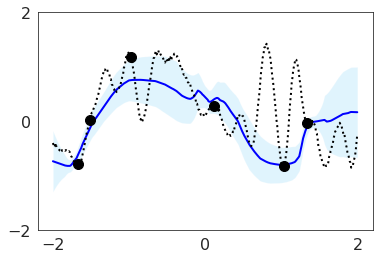

Test function: 2


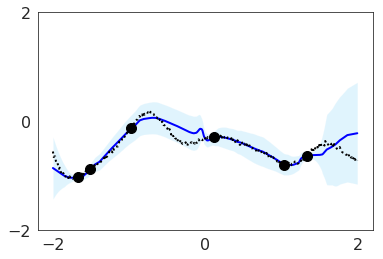

Test function: 3


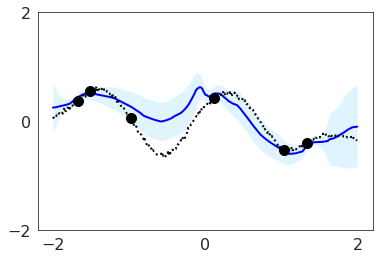

Iteration: 80000, train nll: -0.8616076111793518, mse: 0.048988234251737595, local kl: 0.0, global kl 0.0006643602391704917
Test function: 1


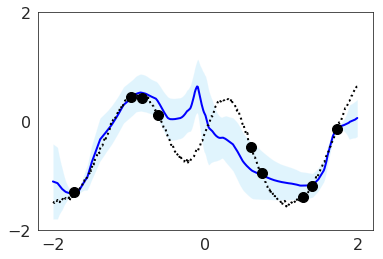

Test function: 2


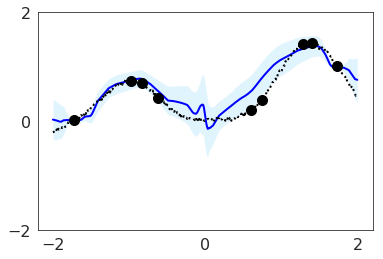

Test function: 3


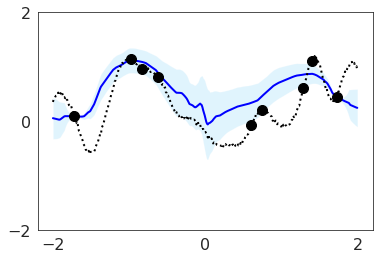

Iteration: 90000, train nll: -1.162125587463379, mse: 0.026940904557704926, local kl: 0.0, global kl 0.0
Saving model...
beta 1.0 temperature 2.0
Test function: 1


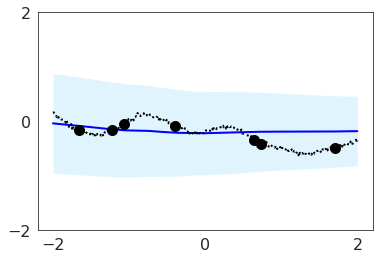

Test function: 2


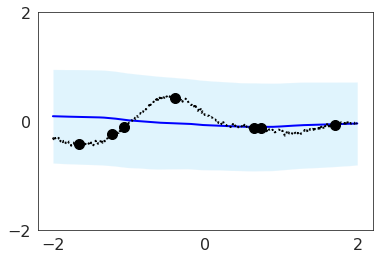

Test function: 3


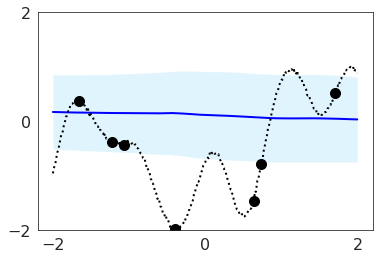

Iteration: 0, train nll: 1.3002450466156006, mse: 0.6214789152145386, local kl: 0.0, global kl 0.0
Test function: 1


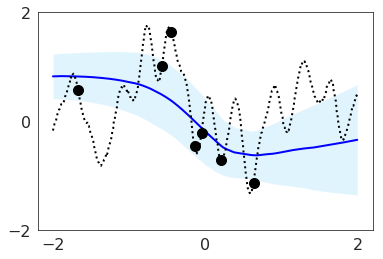

Test function: 2


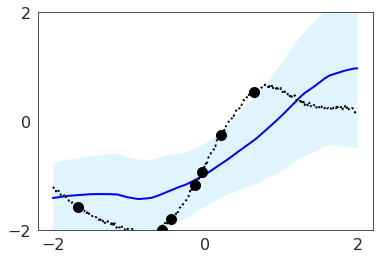

Test function: 3


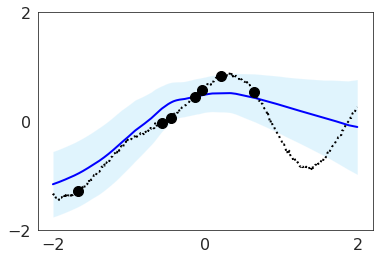

Iteration: 10000, train nll: -0.07523694634437561, mse: 0.09190761297941208, local kl: 0.0, global kl 0.000950894842389971
Test function: 1


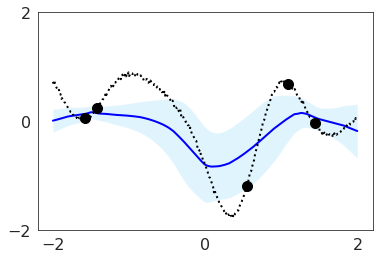

Test function: 2


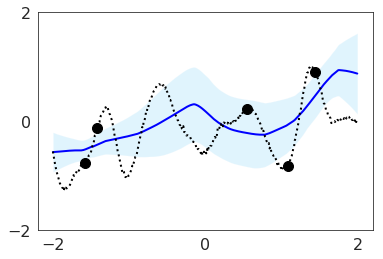

Test function: 3


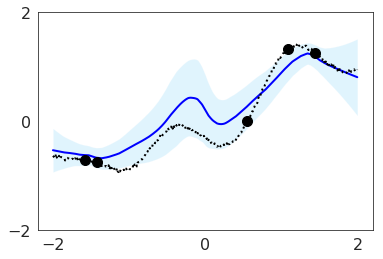

Iteration: 20000, train nll: -0.28867459297180176, mse: 0.0887925997376442, local kl: 0.0, global kl 0.0016719130799174309
Test function: 1


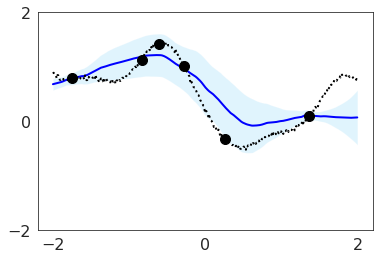

Test function: 2


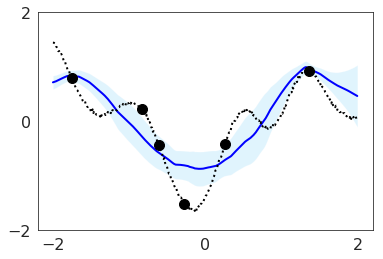

Test function: 3


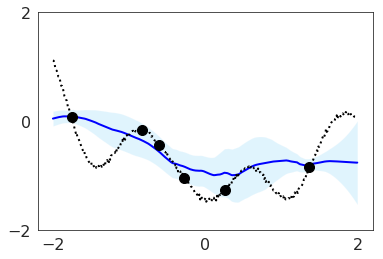

Iteration: 30000, train nll: -0.09416977316141129, mse: 0.11221715807914734, local kl: 0.0, global kl 0.0036196252331137657
Test function: 1


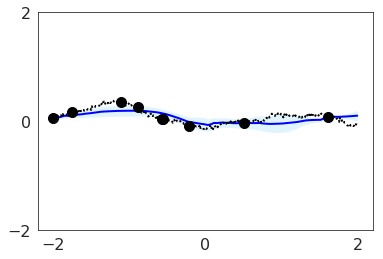

Test function: 2


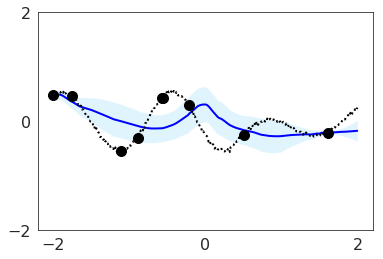

Test function: 3


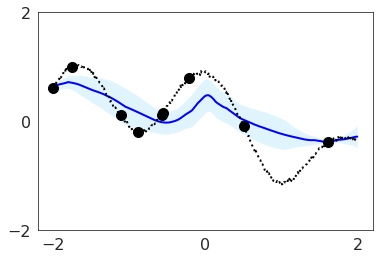

Iteration: 40000, train nll: -0.6880804300308228, mse: 0.06166982278227806, local kl: 0.0, global kl 0.0006539086461998522
Test function: 1


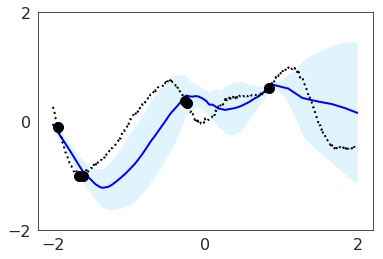

Test function: 2


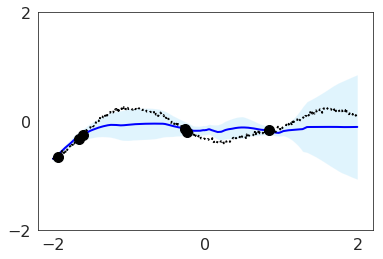

Test function: 3


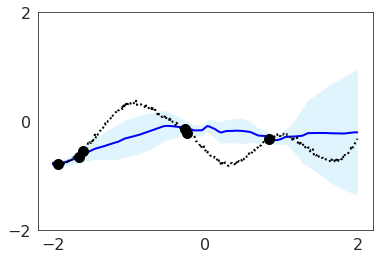

Iteration: 50000, train nll: -0.7562992572784424, mse: 0.05245504155755043, local kl: 0.0, global kl 0.0006169081898406148
Test function: 1


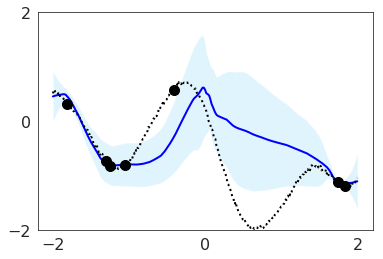

Test function: 2


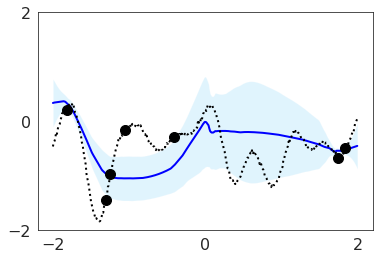

Test function: 3


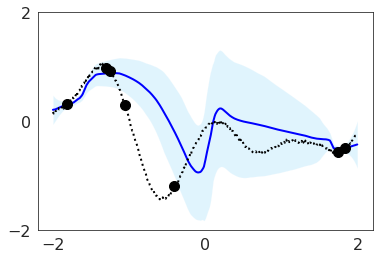

Iteration: 60000, train nll: -0.4534052014350891, mse: 0.15507814288139343, local kl: 0.0, global kl 0.002584243891760707
Test function: 1


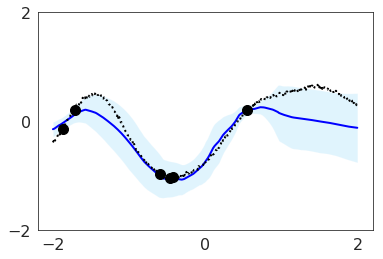

Test function: 2


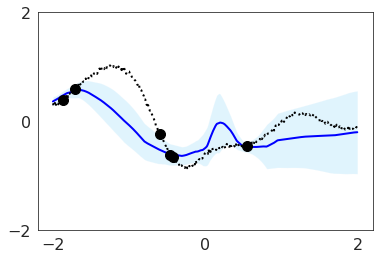

Test function: 3


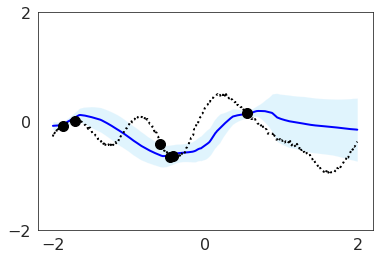

Iteration: 70000, train nll: -0.22095981240272522, mse: 0.13499101996421814, local kl: 0.0, global kl 0.005009406246244907
Test function: 1


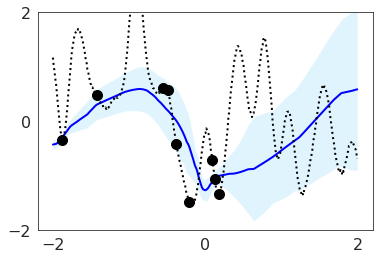

Test function: 2


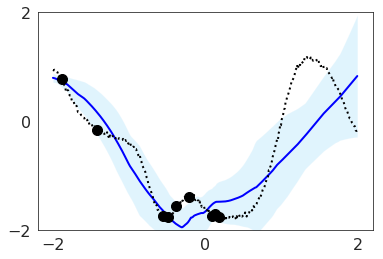

Test function: 3


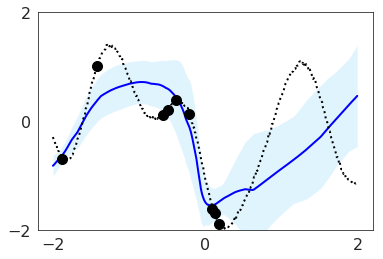

Iteration: 80000, train nll: -0.9450479745864868, mse: 0.12407879531383514, local kl: 0.0, global kl 0.0011175234103575349
Test function: 1


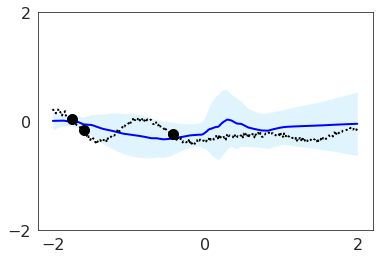

Test function: 2


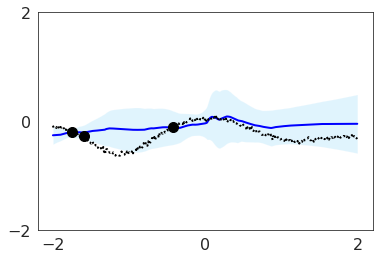

Test function: 3


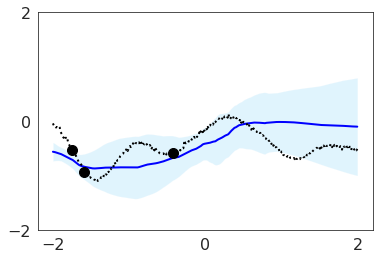

Iteration: 90000, train nll: -0.8060281276702881, mse: 0.054303910583257675, local kl: 0.0, global kl 0.0
Saving model...
beta 1.0 temperature 5.0
Test function: 1


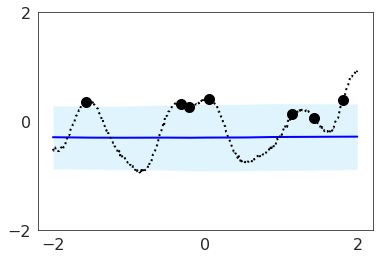

Test function: 2


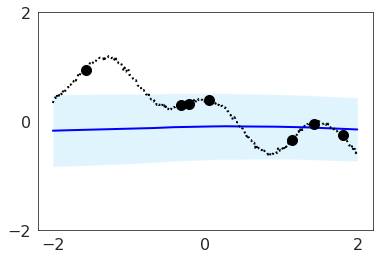

Test function: 3


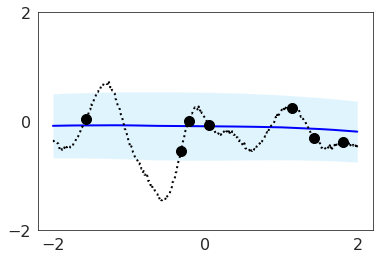

Iteration: 0, train nll: 2.1730971336364746, mse: 0.570353090763092, local kl: 0.0, global kl 0.006255509331822395
Test function: 1


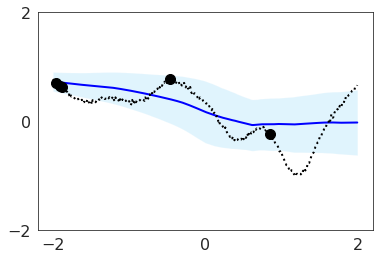

Test function: 2


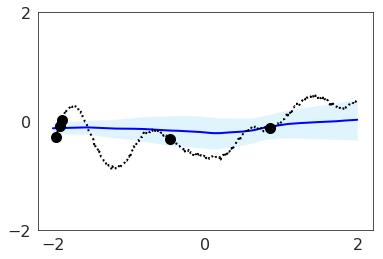

Test function: 3


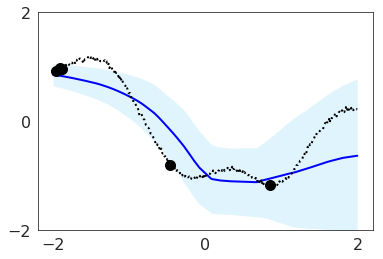

Iteration: 10000, train nll: -0.030651649460196495, mse: 0.11229772120714188, local kl: 0.0, global kl 0.0
Test function: 1


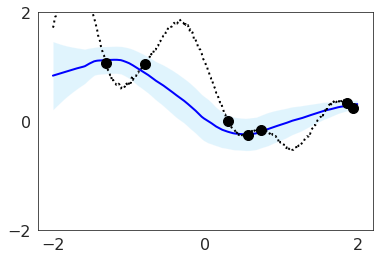

Test function: 2


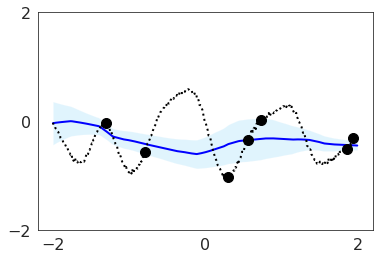

Test function: 3


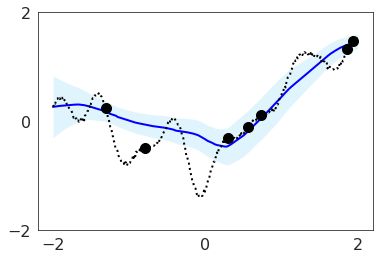

Iteration: 20000, train nll: -0.30799099802970886, mse: 0.10459789633750916, local kl: 0.0, global kl 0.0007471556309610605
Test function: 1


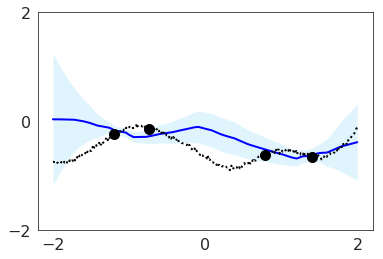

Test function: 2


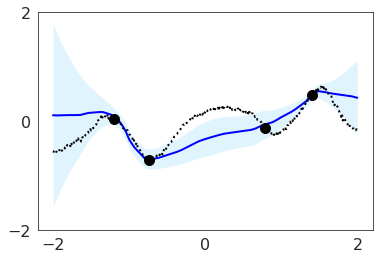

Test function: 3


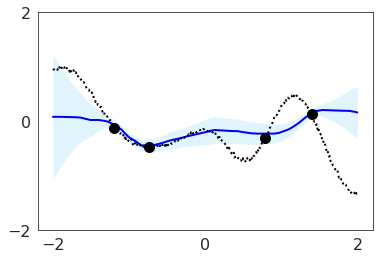

Iteration: 30000, train nll: -0.6727587580680847, mse: 0.03178901597857475, local kl: 0.0, global kl 0.0
Test function: 1


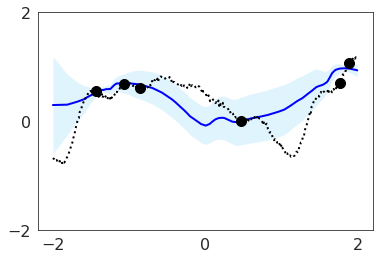

Test function: 2


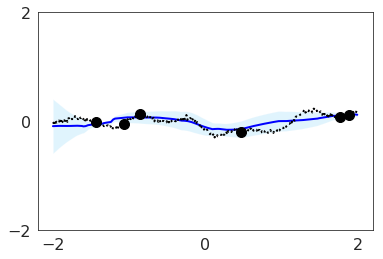

Test function: 3


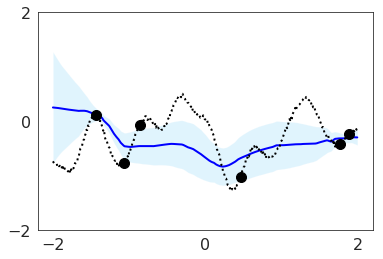

Iteration: 40000, train nll: -0.5061676502227783, mse: 0.059266310185194016, local kl: 0.0, global kl 0.0
Test function: 1


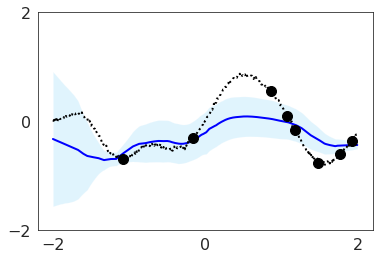

Test function: 2


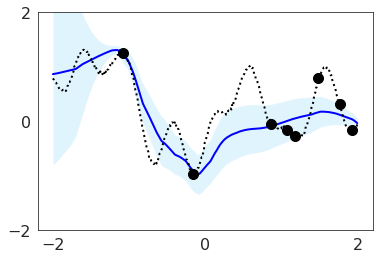

Test function: 3


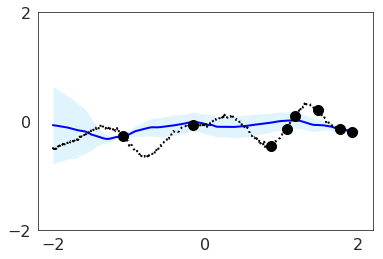

Iteration: 50000, train nll: -0.7735856175422668, mse: 0.04584707319736481, local kl: 0.0, global kl 0.0
Test function: 1


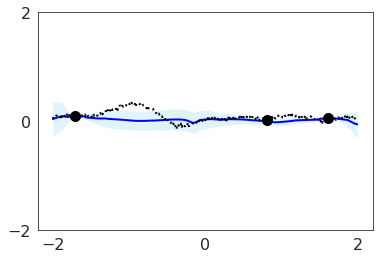

Test function: 2


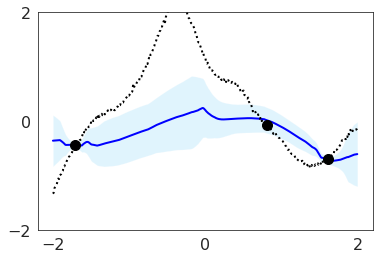

Test function: 3


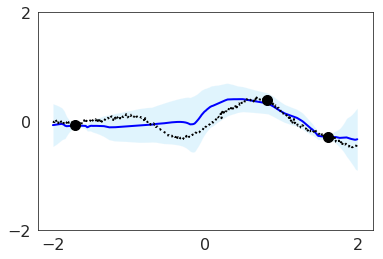

Iteration: 60000, train nll: -0.3306383192539215, mse: 0.09390906244516373, local kl: 0.0, global kl 0.0017713562119752169
Test function: 1


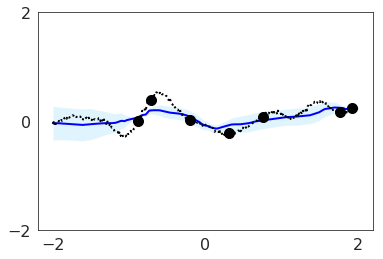

Test function: 2


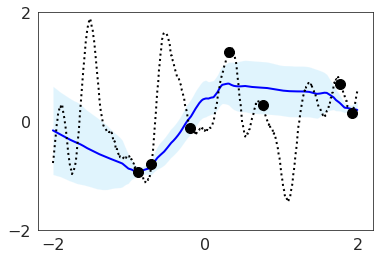

Test function: 3


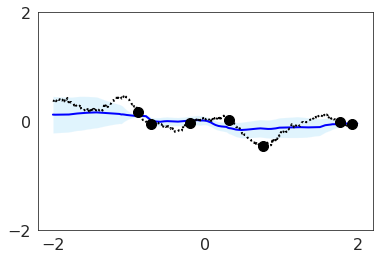

Iteration: 70000, train nll: -0.7819635272026062, mse: 0.040890615433454514, local kl: 0.0, global kl 0.0
Test function: 1


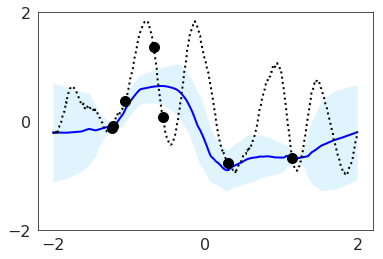

Test function: 2


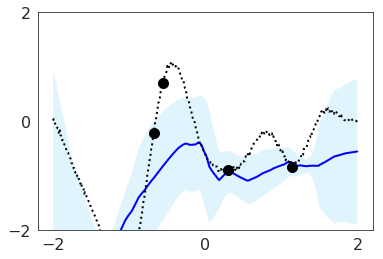

Test function: 3


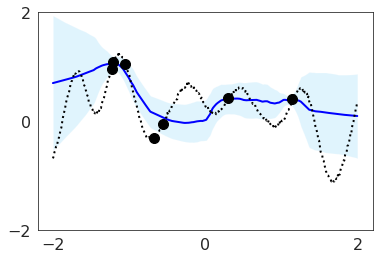

Iteration: 80000, train nll: -0.47011852264404297, mse: 0.07951808720827103, local kl: 0.0, global kl 0.0
Test function: 1


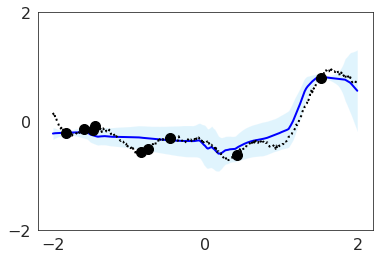

Test function: 2


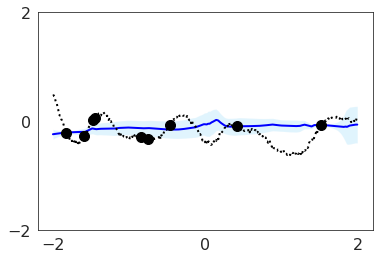

Test function: 3


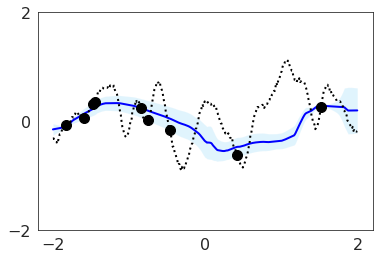

Iteration: 90000, train nll: -0.8496912121772766, mse: 0.045397140085697174, local kl: 0.0, global kl 0.0
Saving model...
beta 1.0 temperature 1000.0
Test function: 1


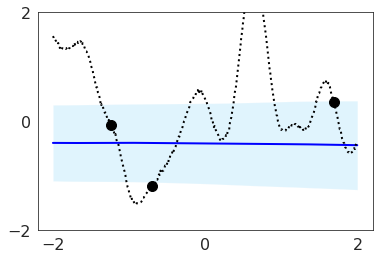

Test function: 2


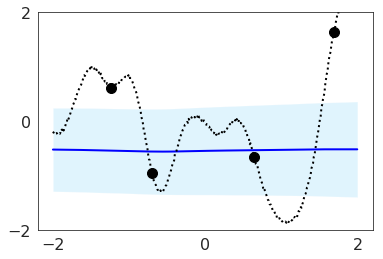

Test function: 3


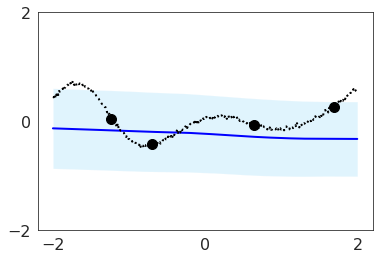

Iteration: 0, train nll: 1.394910454750061, mse: 0.6737651228904724, local kl: 0.0, global kl 0.0
Test function: 1


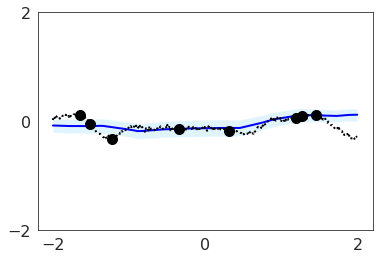

Test function: 2


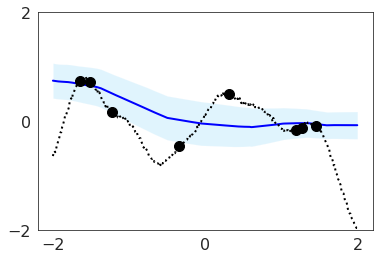

Test function: 3


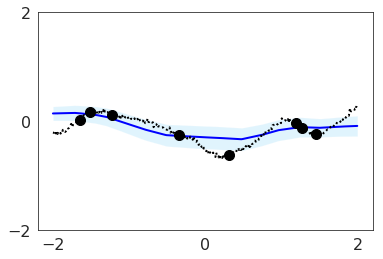

Iteration: 10000, train nll: 0.04737257584929466, mse: 0.11999984830617905, local kl: 0.0, global kl 0.0
Test function: 1


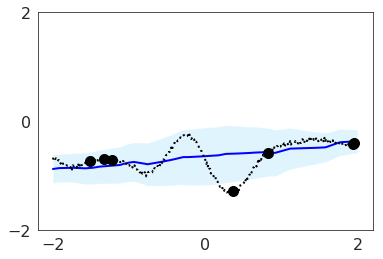

Test function: 2


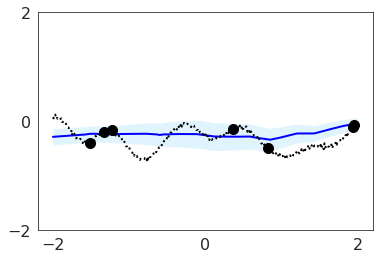

Test function: 3


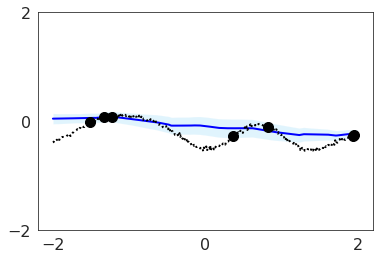

Iteration: 20000, train nll: 0.06046028807759285, mse: 0.1479698121547699, local kl: 0.0, global kl 0.001011399319395423
Test function: 1


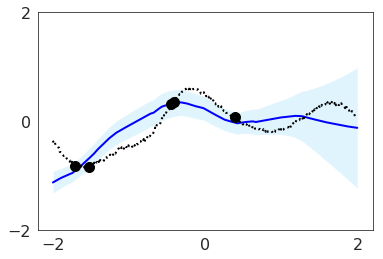

Test function: 2


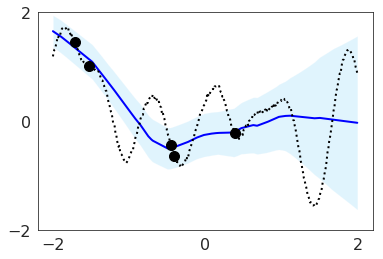

Test function: 3


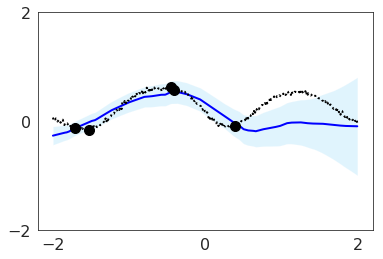

Iteration: 30000, train nll: 0.09468511492013931, mse: 0.11145348846912384, local kl: 0.0, global kl 0.004268785938620567
Test function: 1


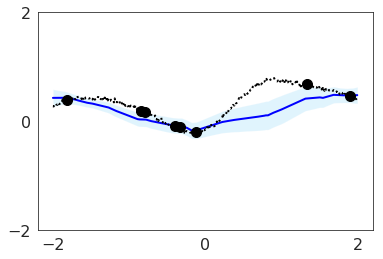

Test function: 2


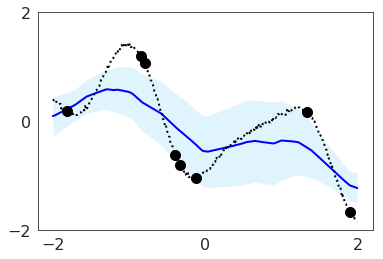

Test function: 3


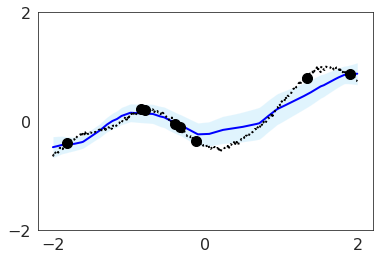

Iteration: 40000, train nll: -0.4705559313297272, mse: 0.04570295661687851, local kl: 0.0, global kl 0.0
Test function: 1


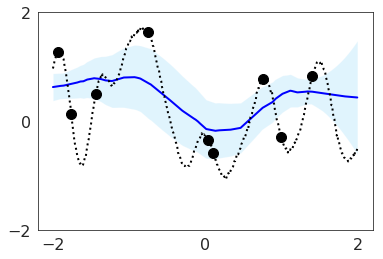

Test function: 2


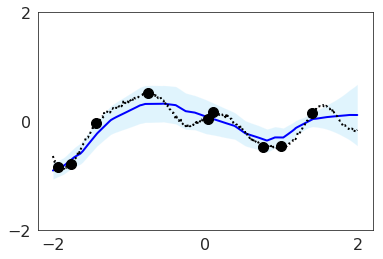

Test function: 3


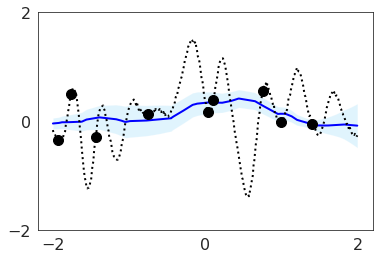

Iteration: 50000, train nll: -0.3926715850830078, mse: 0.06710147112607956, local kl: 0.0, global kl 0.0
Test function: 1


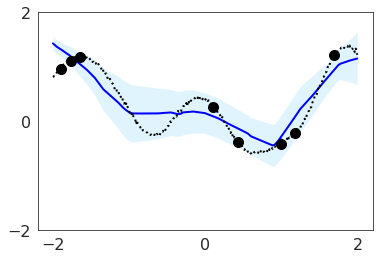

Test function: 2


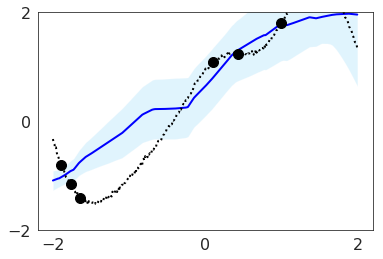

Test function: 3


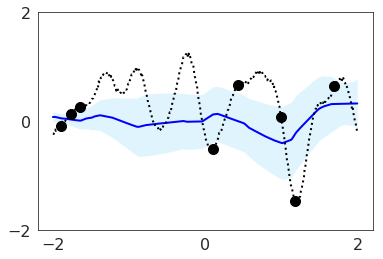

Iteration: 60000, train nll: -0.6521682143211365, mse: 0.026201313361525536, local kl: 0.0, global kl 0.0
Test function: 1


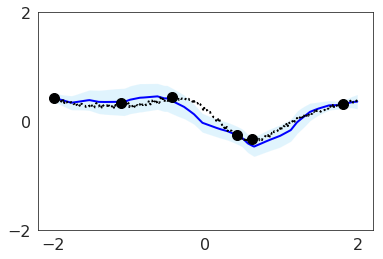

Test function: 2


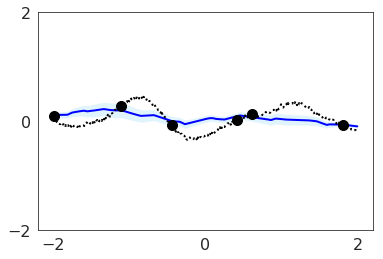

Test function: 3


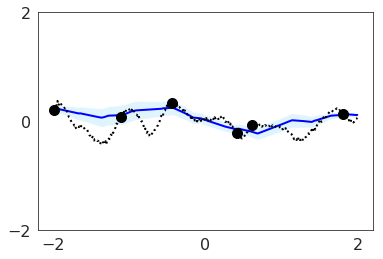

Iteration: 70000, train nll: -0.06652143597602844, mse: 0.1426897644996643, local kl: 0.0, global kl 0.001817194395698607
Test function: 1


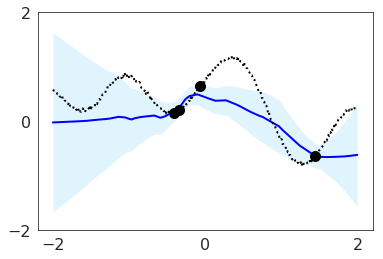

Test function: 2


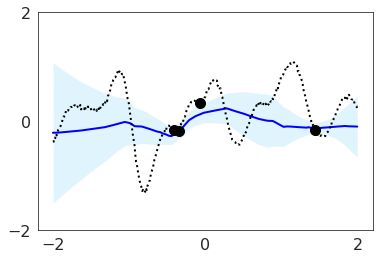

Test function: 3


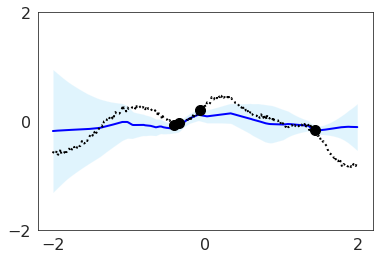

Iteration: 80000, train nll: -0.5005588531494141, mse: 0.0523226261138916, local kl: 0.0, global kl 0.0002557456027716398
Test function: 1


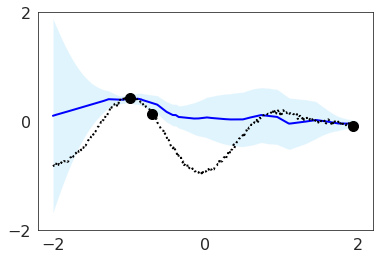

Test function: 2


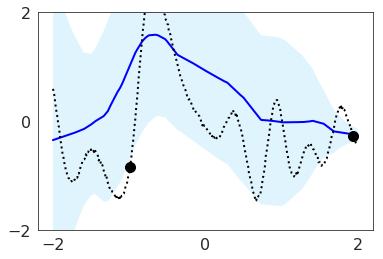

Test function: 3


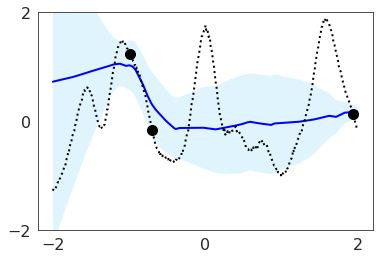

Iteration: 90000, train nll: -0.03190845996141434, mse: 0.13593481481075287, local kl: 0.0, global kl 0.0019961826037615538
Saving model...
beta 2.0 temperature 0.001
Test function: 1


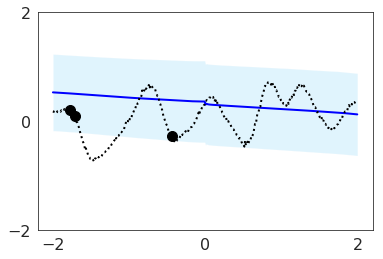

Test function: 2


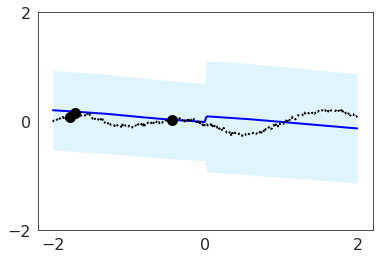

Test function: 3


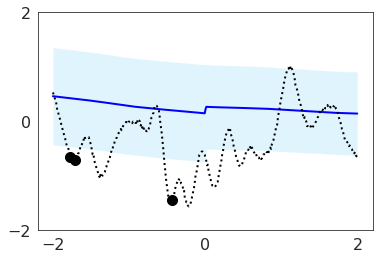

Iteration: 0, train nll: 1.2006969451904297, mse: 0.47469717264175415, local kl: 0.0, global kl 0.0
Test function: 1


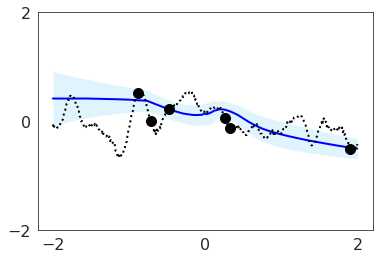

Test function: 2


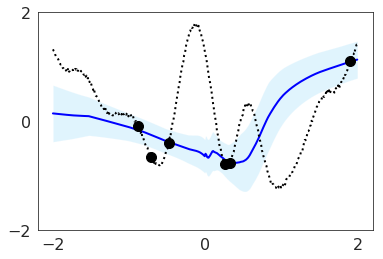

Test function: 3


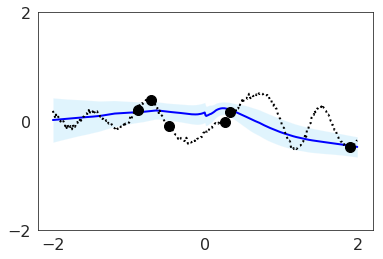

Iteration: 10000, train nll: 0.04590870812535286, mse: 0.132206529378891, local kl: 0.0, global kl 0.0015724217519164085
Test function: 1


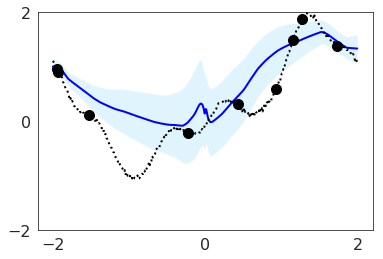

Test function: 2


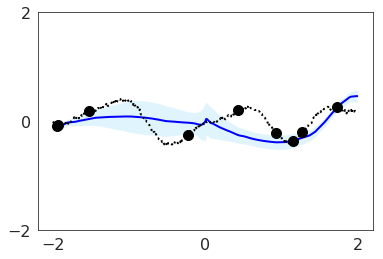

Test function: 3


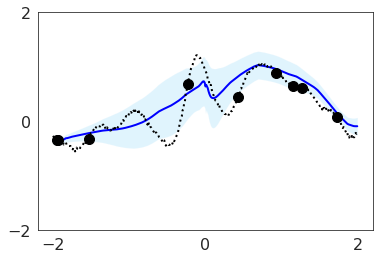

Iteration: 20000, train nll: -0.17316573858261108, mse: 0.11048433929681778, local kl: 0.0, global kl 0.0013584881089627743
Test function: 1


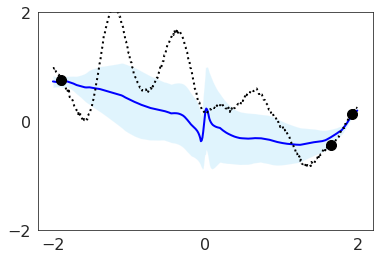

Test function: 2


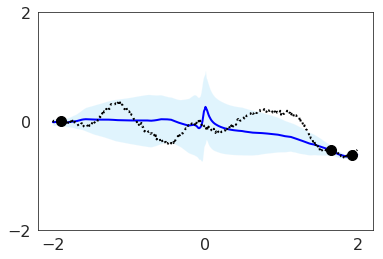

Test function: 3


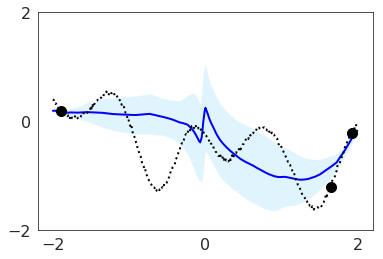

Iteration: 30000, train nll: -0.6188281774520874, mse: 0.08898191154003143, local kl: 0.0, global kl 0.0
Test function: 1


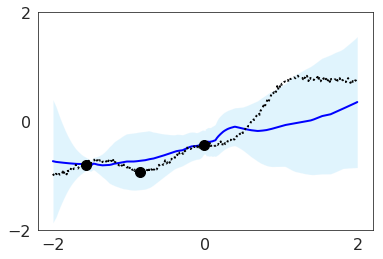

Test function: 2


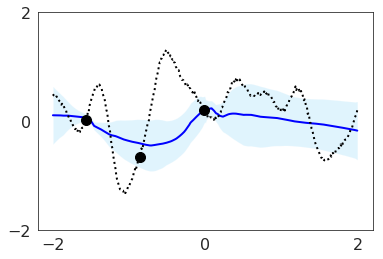

Test function: 3


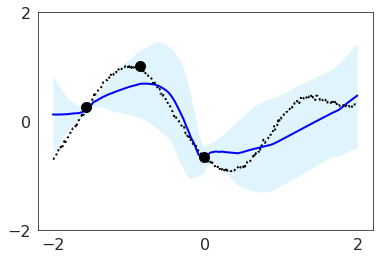

Iteration: 40000, train nll: -0.5103254914283752, mse: 0.10194036364555359, local kl: 0.0, global kl 0.0012081011664122343
Test function: 1


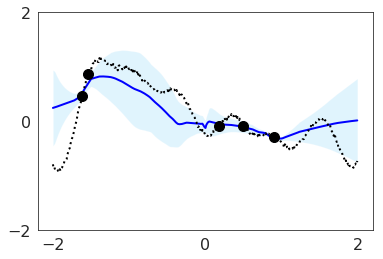

Test function: 2


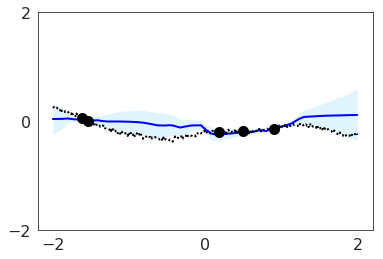

Test function: 3


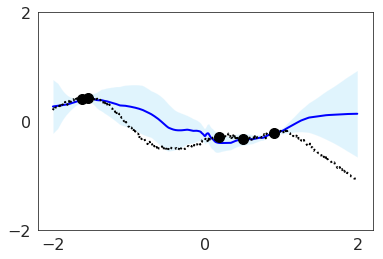

Iteration: 50000, train nll: -0.8617644906044006, mse: 0.06101926043629646, local kl: 0.0, global kl 0.0006081605097278953
Test function: 1


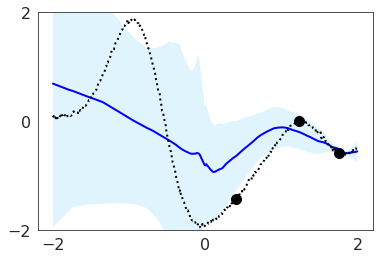

Test function: 2


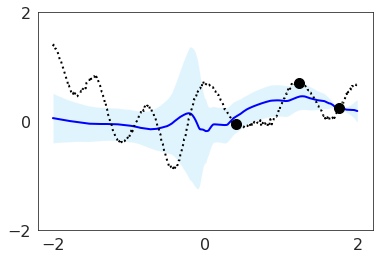

Test function: 3


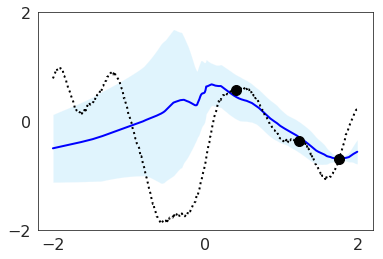

Iteration: 60000, train nll: -0.9530053734779358, mse: 0.04453389719128609, local kl: 0.0, global kl 0.0008775048772804439
Test function: 1


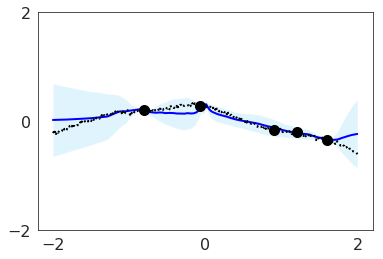

Test function: 2


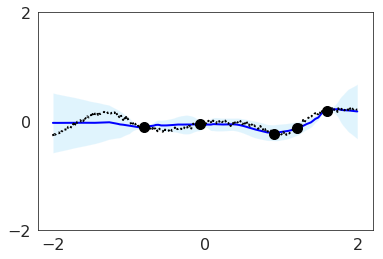

Test function: 3


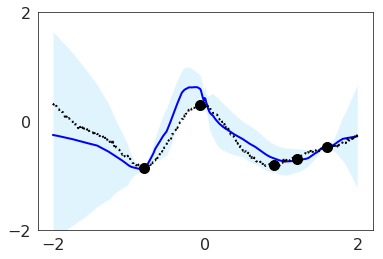

Iteration: 70000, train nll: -0.9153140783309937, mse: 0.05110785365104675, local kl: 0.0, global kl 0.0
Test function: 1


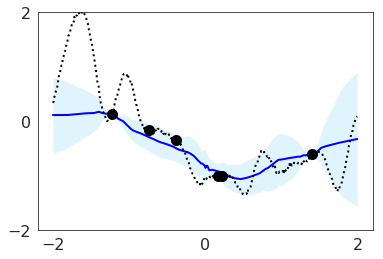

Test function: 2


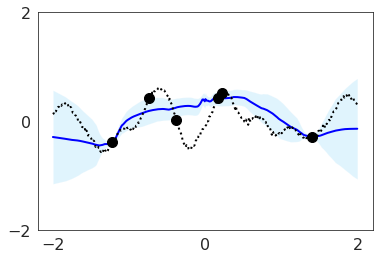

Test function: 3


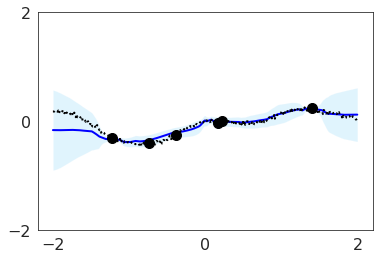

Iteration: 80000, train nll: -0.951633632183075, mse: 0.06356866657733917, local kl: 0.0, global kl 0.002124505816027522
Test function: 1


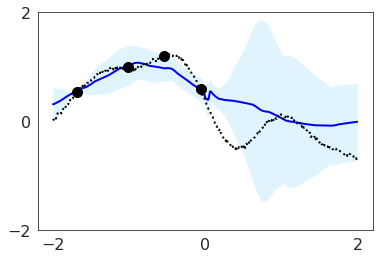

Test function: 2


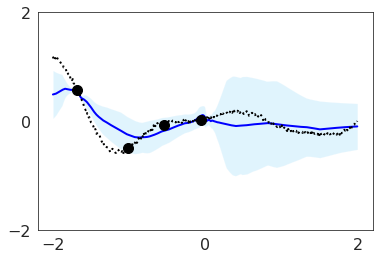

Test function: 3


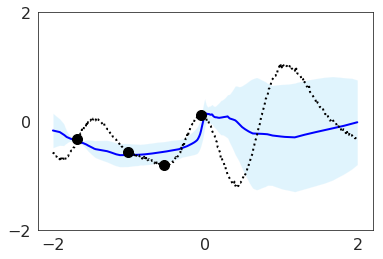

Iteration: 90000, train nll: -0.8290327191352844, mse: 0.054571375250816345, local kl: 0.0, global kl 0.00028294482035562396
Saving model...
beta 2.0 temperature 0.5
Test function: 1


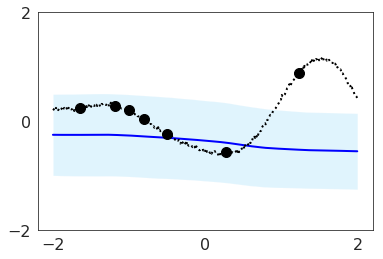

Test function: 2


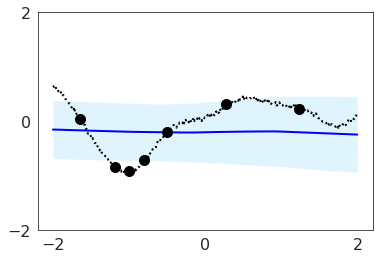

Test function: 3


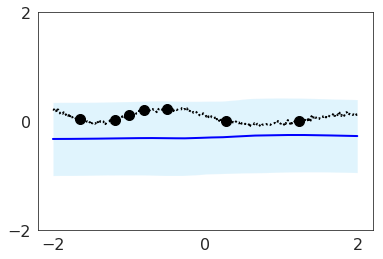

Iteration: 0, train nll: 1.7732144594192505, mse: 0.6342362761497498, local kl: 0.0, global kl 0.0
Test function: 1


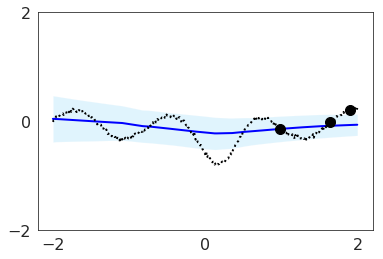

Test function: 2


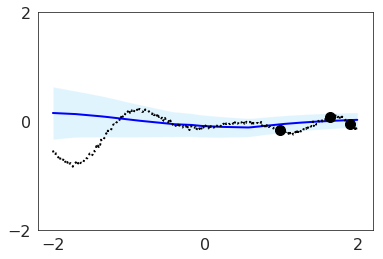

Test function: 3


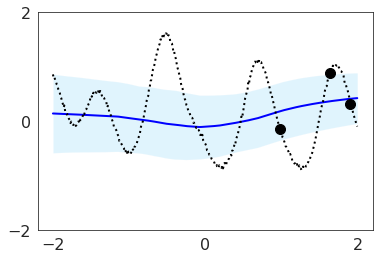

Iteration: 10000, train nll: -0.05300666019320488, mse: 0.12798164784908295, local kl: 0.0, global kl 0.002066535409539938
Test function: 1


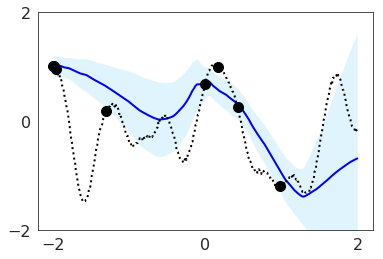

Test function: 2


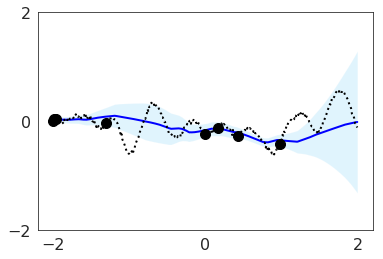

Test function: 3


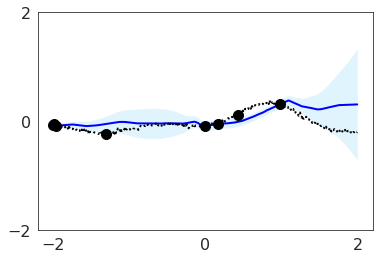

Iteration: 20000, train nll: -0.3553975522518158, mse: 0.10084258764982224, local kl: 0.0, global kl 0.0012431987561285496
Test function: 1


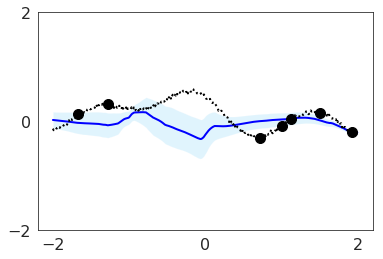

Test function: 2


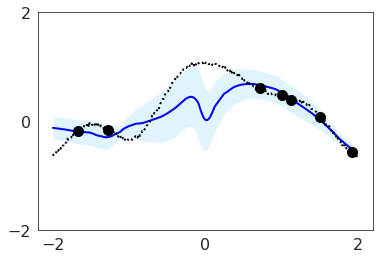

Test function: 3


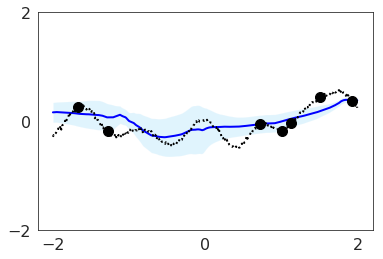

Iteration: 30000, train nll: 0.22842587530612946, mse: 0.18045291304588318, local kl: 0.0, global kl 0.005033476278185844
Test function: 1


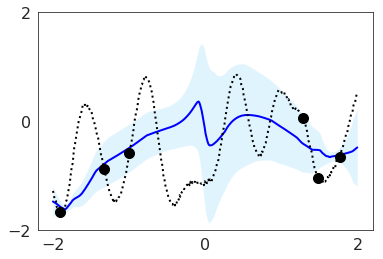

Test function: 2


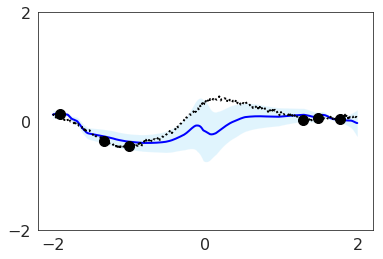

Test function: 3


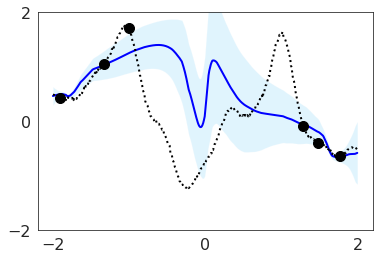

Iteration: 40000, train nll: 0.41287723183631897, mse: 0.07888093590736389, local kl: 0.0, global kl 0.0011407732963562012
Test function: 1


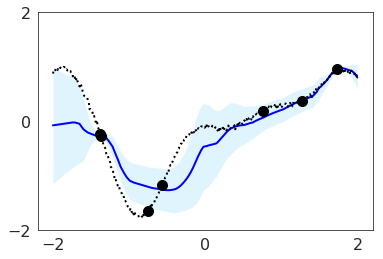

Test function: 2


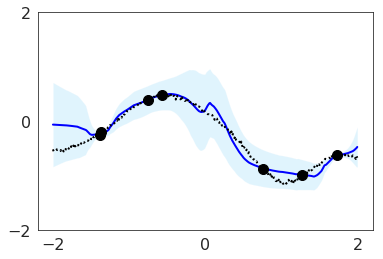

Test function: 3


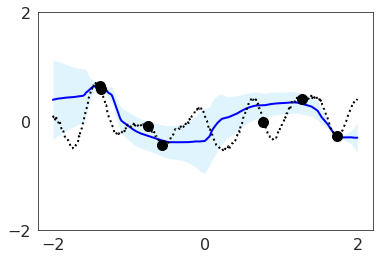

Iteration: 50000, train nll: -0.996105968952179, mse: 0.026127109304070473, local kl: 0.0, global kl 0.0
Test function: 1


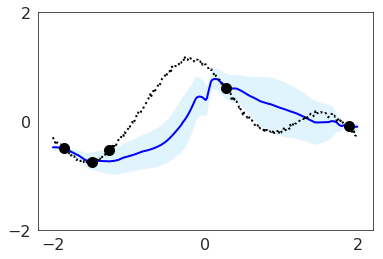

Test function: 2


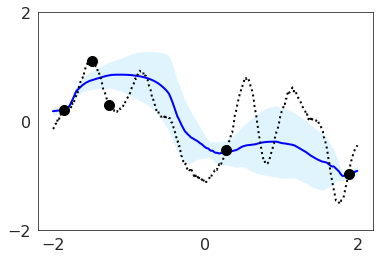

Test function: 3


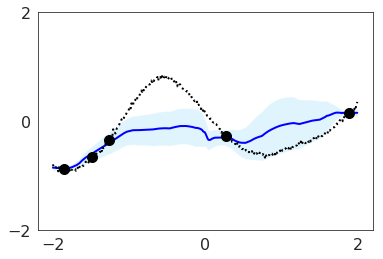

Iteration: 60000, train nll: -0.6358648538589478, mse: 0.07332257181406021, local kl: 0.0, global kl 0.0011144052259624004
Test function: 1


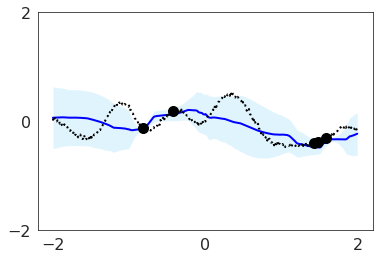

Test function: 2


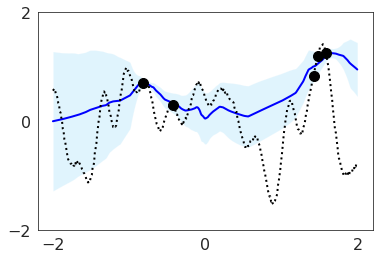

Test function: 3


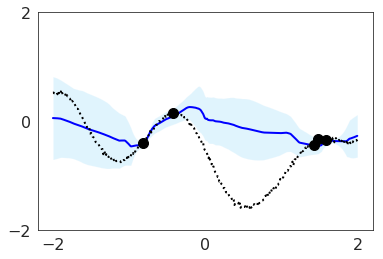

Iteration: 70000, train nll: -0.6533511877059937, mse: 0.06307670474052429, local kl: 0.0, global kl 0.0
Test function: 1


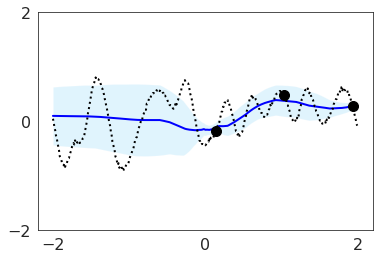

Test function: 2


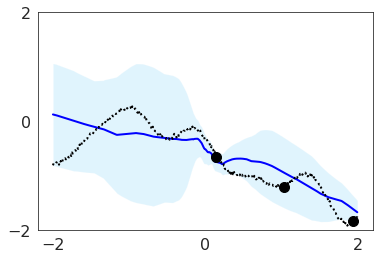

Test function: 3


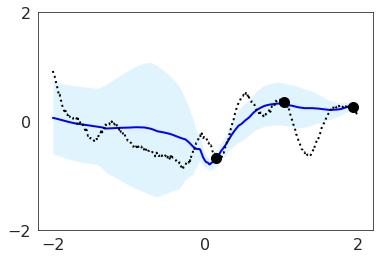

Iteration: 80000, train nll: -0.9309531450271606, mse: 0.04331633448600769, local kl: 0.0, global kl 0.0
Test function: 1


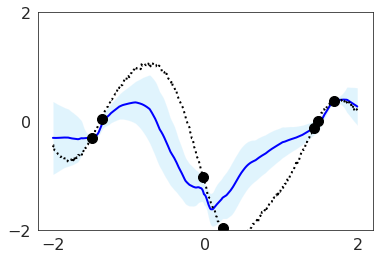

Test function: 2


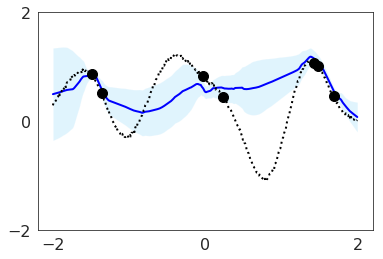

Test function: 3


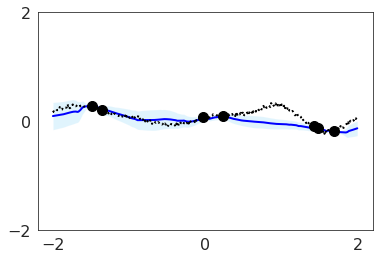

Iteration: 90000, train nll: -1.3001577854156494, mse: 0.014959275722503662, local kl: 0.0, global kl 0.0
Saving model...
beta 2.0 temperature 1.0
Test function: 1


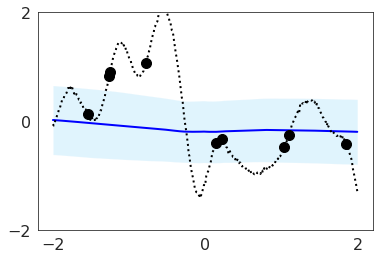

Test function: 2


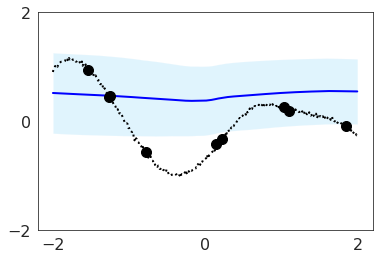

Test function: 3


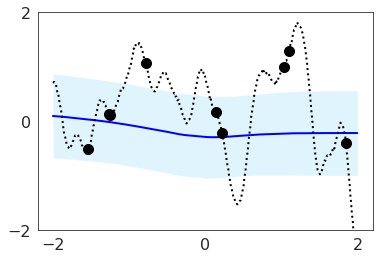

Iteration: 0, train nll: 1.2059516906738281, mse: 0.49488767981529236, local kl: 0.0, global kl 0.0
Test function: 1


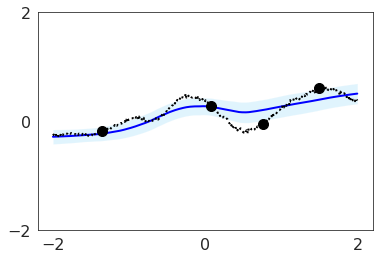

Test function: 2


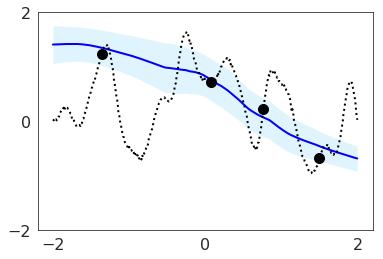

Test function: 3


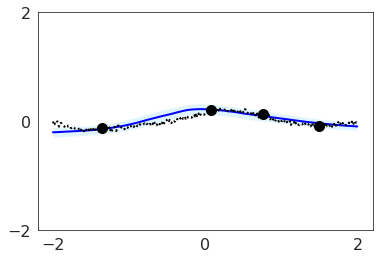

Iteration: 10000, train nll: 0.11150769144296646, mse: 0.12840713560581207, local kl: 0.0, global kl 0.0011887664441019297
Test function: 1


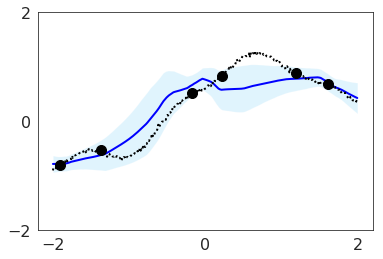

Test function: 2


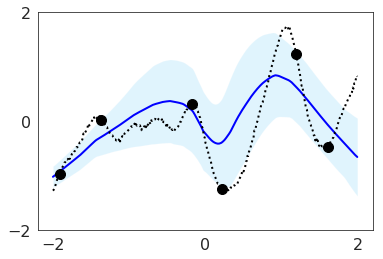

Test function: 3


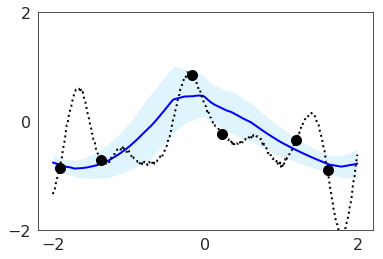

Iteration: 20000, train nll: -0.25906920433044434, mse: 0.08519948273897171, local kl: 0.0, global kl 0.0004715718678198755
Test function: 1


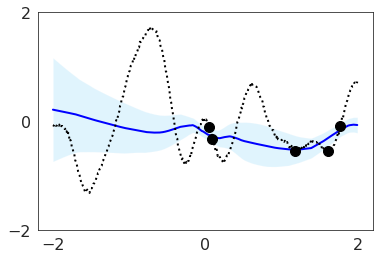

Test function: 2


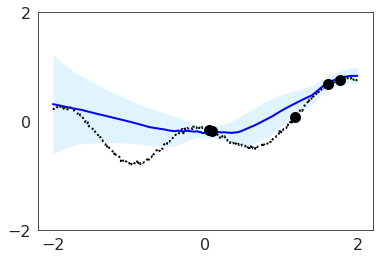

Test function: 3


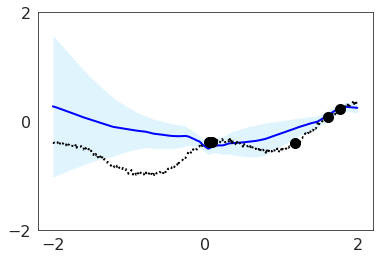

Iteration: 30000, train nll: -0.36977872252464294, mse: 0.09301390498876572, local kl: 0.0, global kl 0.0011601177975535393
Test function: 1


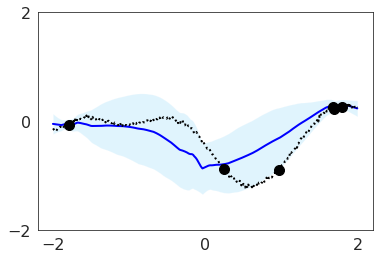

Test function: 2


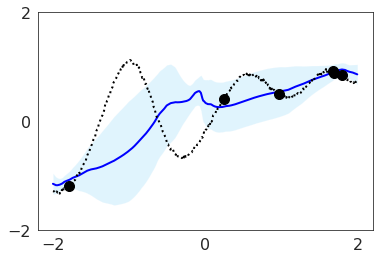

Test function: 3


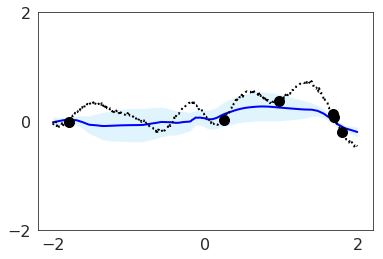

Iteration: 40000, train nll: -0.608240008354187, mse: 0.051887501031160355, local kl: 0.0, global kl 0.0
Test function: 1


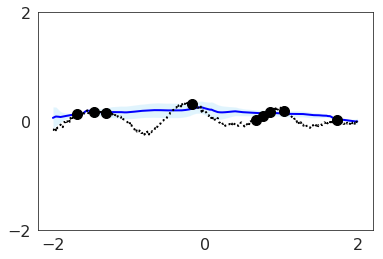

Test function: 2


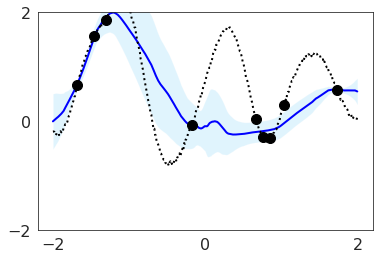

Test function: 3


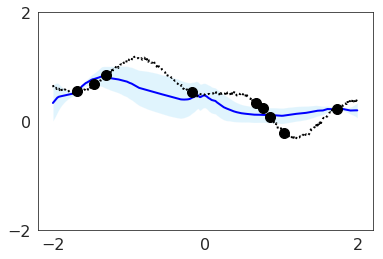

Iteration: 50000, train nll: -0.8244394063949585, mse: 0.04108946770429611, local kl: 0.0, global kl 0.0
Test function: 1


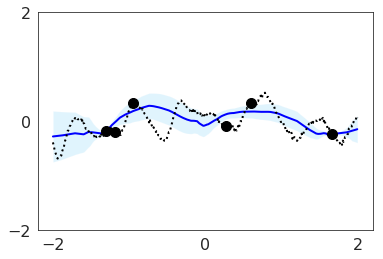

Test function: 2


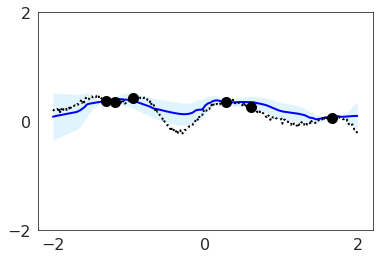

Test function: 3


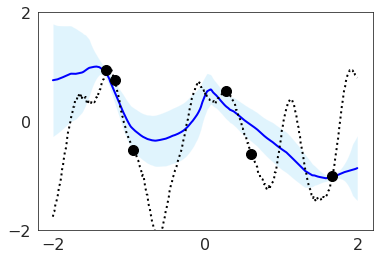

Iteration: 60000, train nll: -1.028147578239441, mse: 0.034497492015361786, local kl: 0.0, global kl 0.0
Test function: 1


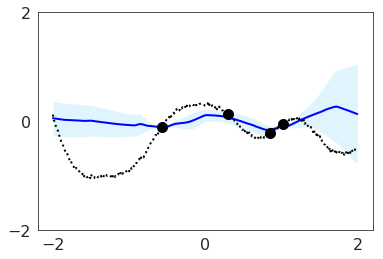

Test function: 2


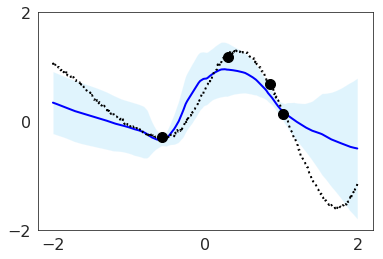

Test function: 3


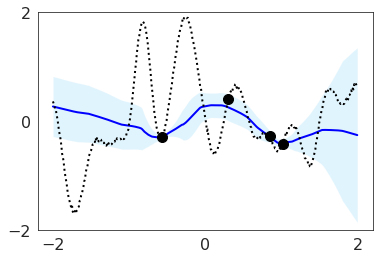

Iteration: 70000, train nll: -0.6951414346694946, mse: 0.07881629467010498, local kl: 0.0, global kl 0.0004889834672212601
Test function: 1


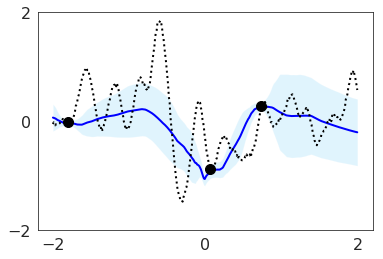

Test function: 2


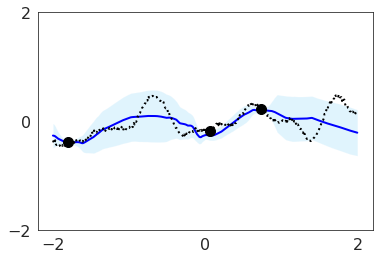

Test function: 3


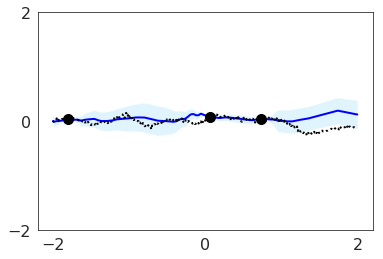

Iteration: 80000, train nll: -0.6987722516059875, mse: 0.04676567018032074, local kl: 0.0, global kl 0.00045684841461479664
Test function: 1


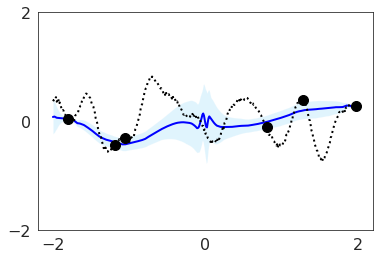

Test function: 2


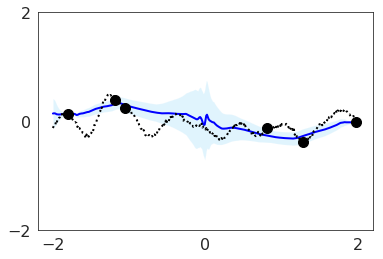

Test function: 3


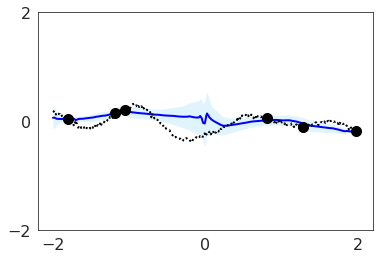

Iteration: 90000, train nll: -0.8219357132911682, mse: 0.07064506411552429, local kl: 0.0, global kl 0.001874157227575779
Saving model...
beta 2.0 temperature 2.0
Test function: 1


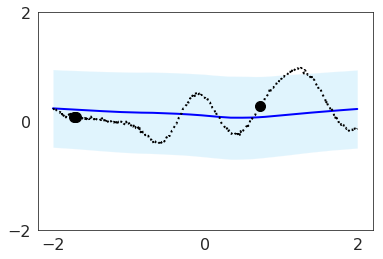

Test function: 2


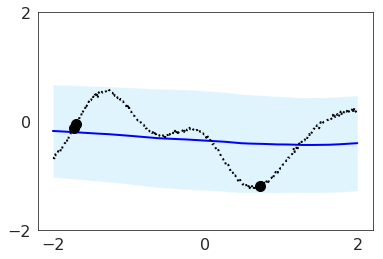

Test function: 3


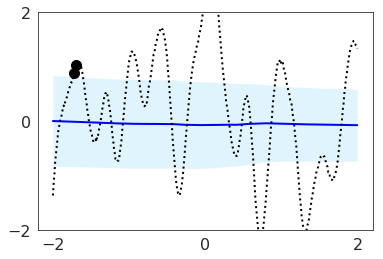

Iteration: 0, train nll: 1.0194737911224365, mse: 0.3828643262386322, local kl: 0.0, global kl 0.041249554604291916
Test function: 1


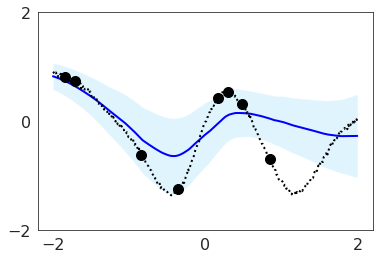

Test function: 2


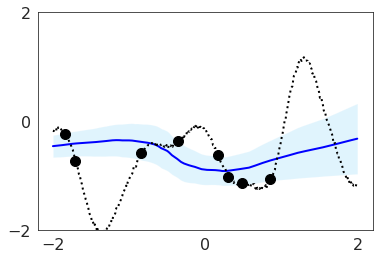

Test function: 3


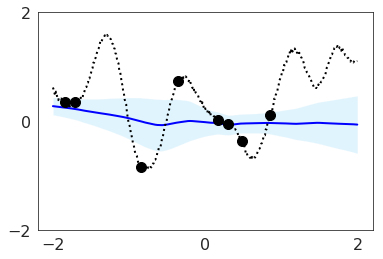

Iteration: 10000, train nll: -0.10217586904764175, mse: 0.09741579741239548, local kl: 0.0, global kl 0.0
Test function: 1


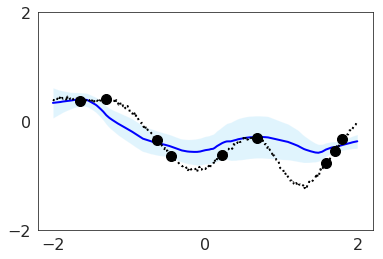

Test function: 2


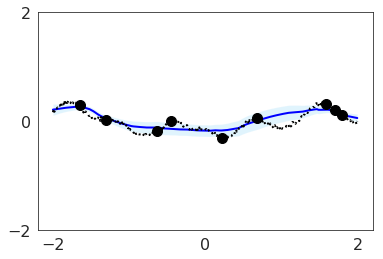

Test function: 3


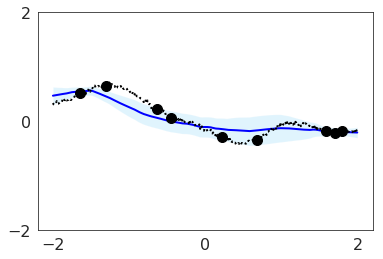

Iteration: 20000, train nll: -0.32252541184425354, mse: 0.08872997760772705, local kl: 0.0, global kl 0.0006075367564335465
Test function: 1


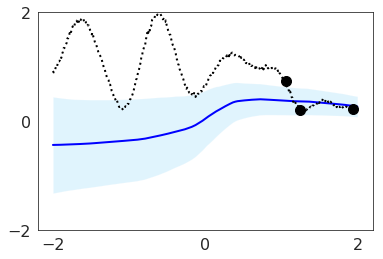

Test function: 2


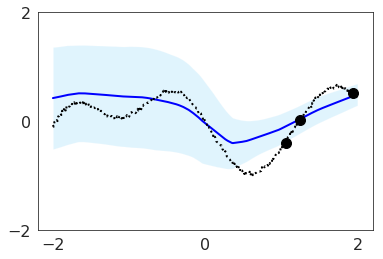

Test function: 3


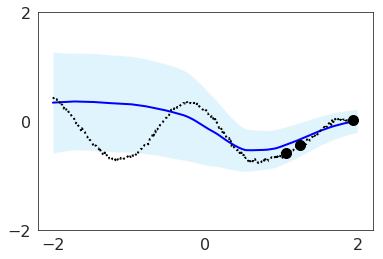

Iteration: 30000, train nll: -0.5213463306427002, mse: 0.05581820756196976, local kl: 0.0, global kl 0.0
Test function: 1


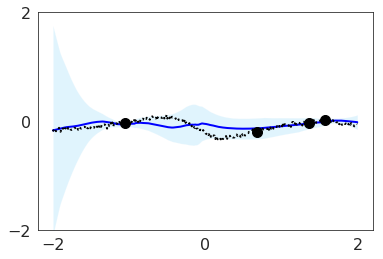

Test function: 2


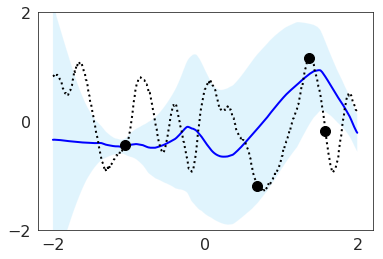

Test function: 3


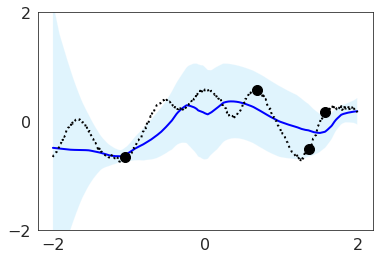

Iteration: 40000, train nll: -0.11127568036317825, mse: 0.11654341220855713, local kl: 0.0, global kl 0.003158219624310732
Test function: 1


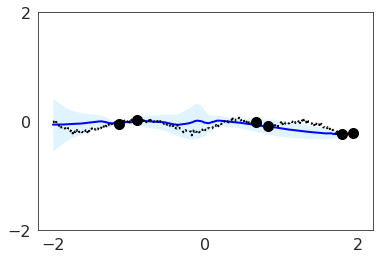

Test function: 2


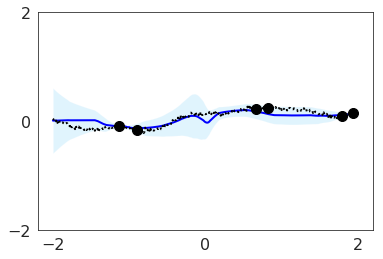

Test function: 3


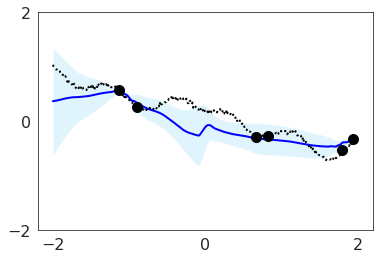

Iteration: 50000, train nll: -0.8305281400680542, mse: 0.05654009431600571, local kl: 0.0, global kl 0.0
Test function: 1


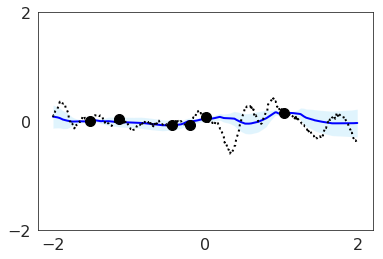

Test function: 2


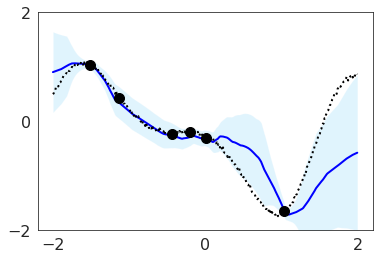

Test function: 3


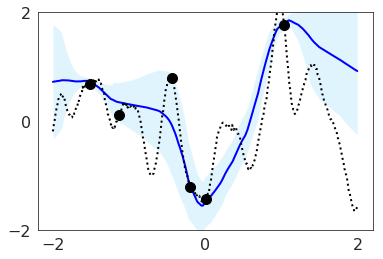

Iteration: 60000, train nll: -0.8326739072799683, mse: 0.03602554649114609, local kl: 0.0, global kl 0.0
Test function: 1


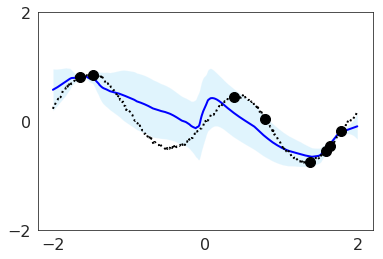

Test function: 2


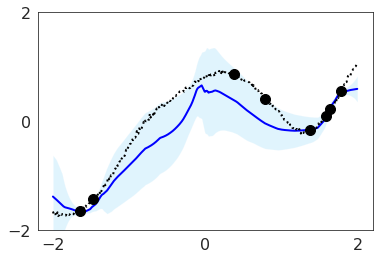

Test function: 3


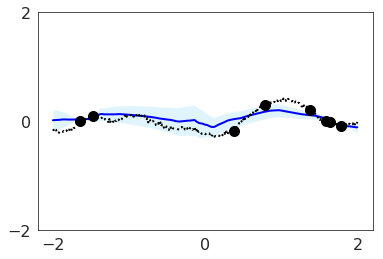

Iteration: 70000, train nll: -0.5350030064582825, mse: 0.15692627429962158, local kl: 0.0, global kl 0.004124374128878117
Test function: 1


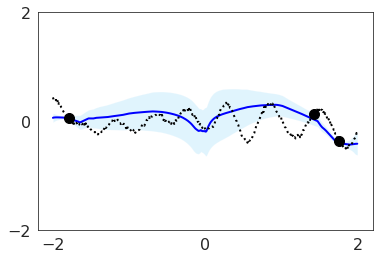

Test function: 2


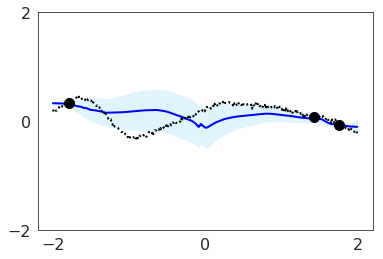

Test function: 3


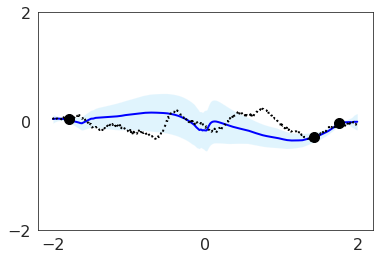

Iteration: 80000, train nll: -0.5979281663894653, mse: 0.06817558407783508, local kl: 0.0, global kl 0.0006775063811801374
Test function: 1


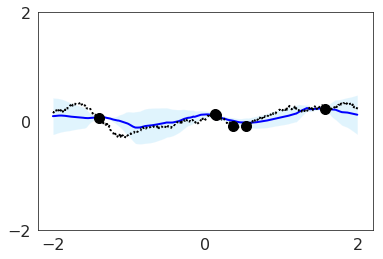

Test function: 2


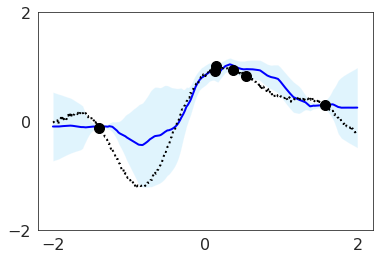

Test function: 3


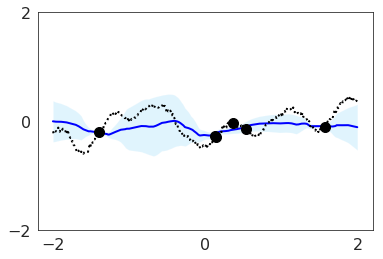

Iteration: 90000, train nll: -0.27219298481941223, mse: 0.16316594183444977, local kl: 0.0, global kl 0.003932788502424955
Saving model...
beta 2.0 temperature 5.0
Test function: 1


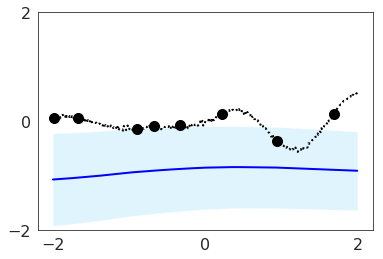

Test function: 2


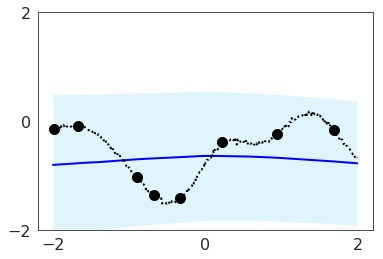

Test function: 3


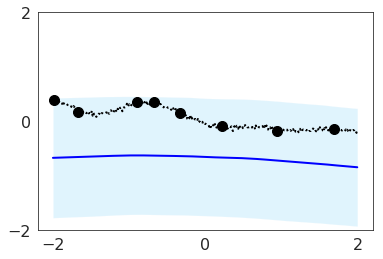

Iteration: 0, train nll: 1.4652961492538452, mse: 1.210710883140564, local kl: 0.0, global kl 0.0
Test function: 1


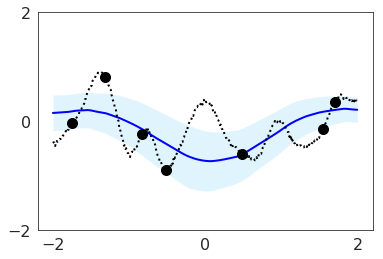

Test function: 2


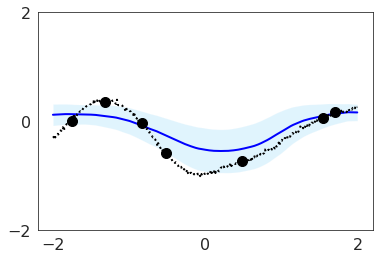

Test function: 3


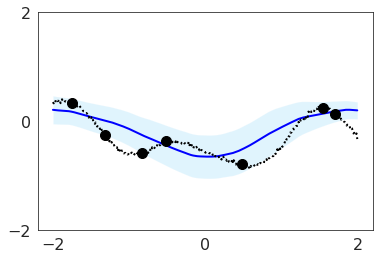

Iteration: 10000, train nll: 0.051568638533353806, mse: 0.12597057223320007, local kl: 0.0, global kl 0.0013165534473955631
Test function: 1


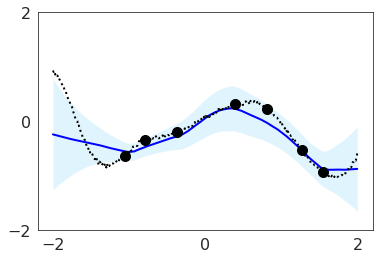

Test function: 2


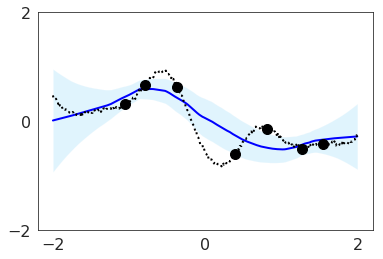

Test function: 3


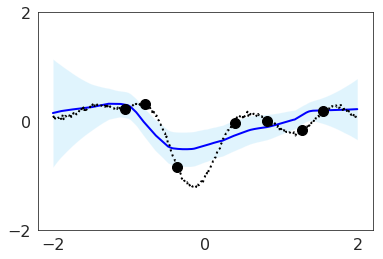

Iteration: 20000, train nll: -0.3035925626754761, mse: 0.058090560138225555, local kl: 0.0, global kl 0.0
Test function: 1


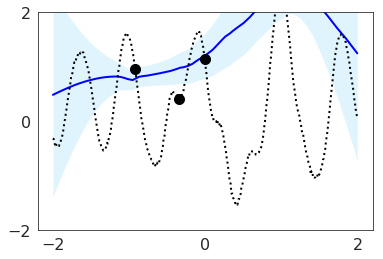

Test function: 2


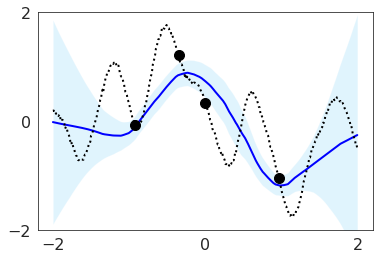

Test function: 3


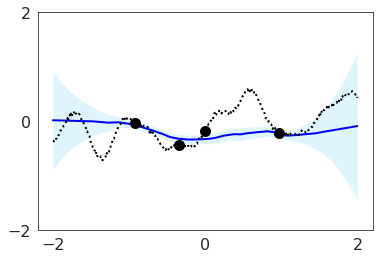

Iteration: 30000, train nll: -0.15005354583263397, mse: 0.08889732509851456, local kl: 0.0, global kl 0.004199662245810032
Test function: 1


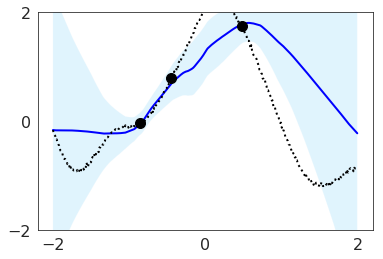

Test function: 2


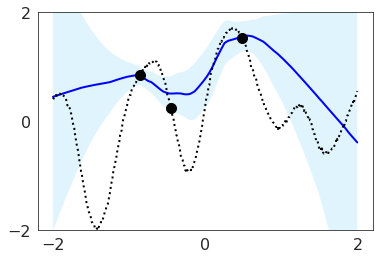

Test function: 3


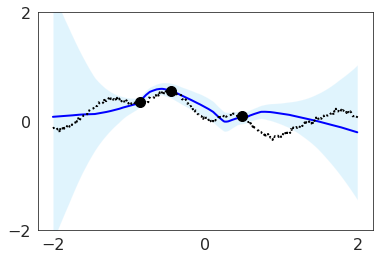

Iteration: 40000, train nll: -0.6969388127326965, mse: 0.051328714936971664, local kl: 0.0, global kl 0.0
Test function: 1


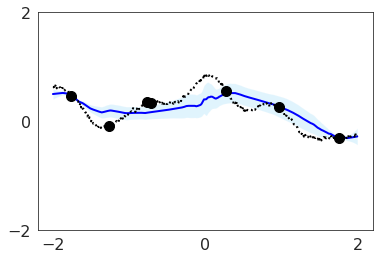

Test function: 2


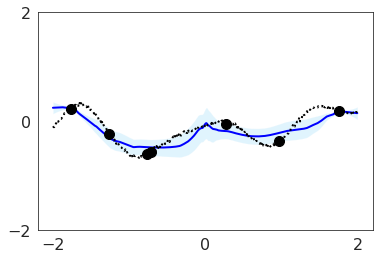

Test function: 3


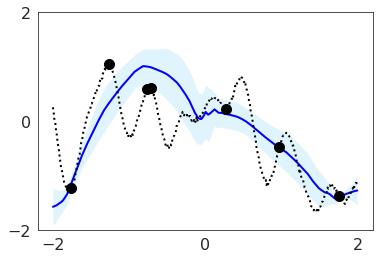

Iteration: 50000, train nll: -0.7076358199119568, mse: 0.06031426787376404, local kl: 0.0, global kl 0.0009033241658471525
Test function: 1


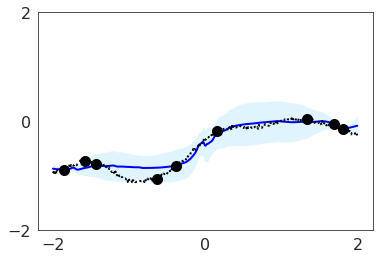

Test function: 2


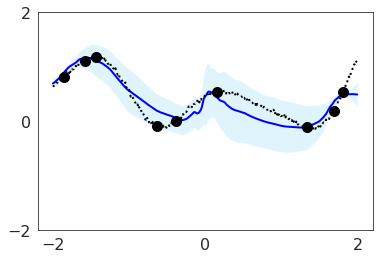

Test function: 3


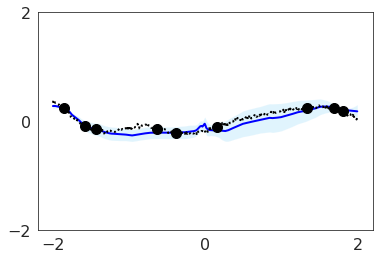

Iteration: 60000, train nll: -0.5933941006660461, mse: 0.07651098072528839, local kl: 0.0, global kl 0.001308348961174488
Test function: 1


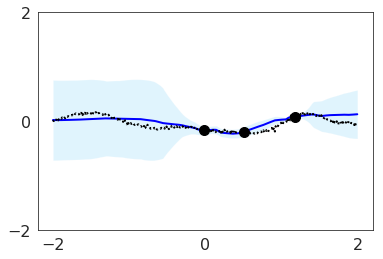

Test function: 2


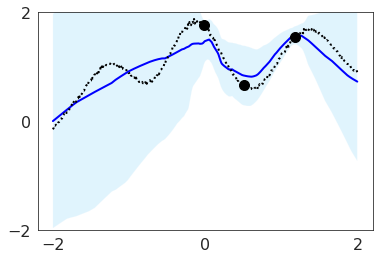

Test function: 3


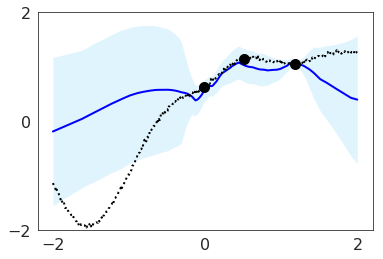

Iteration: 70000, train nll: -1.0407646894454956, mse: 0.020156826823949814, local kl: 0.0, global kl 0.0
Test function: 1


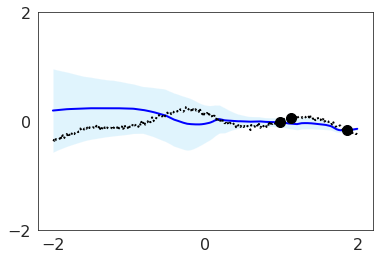

Test function: 2


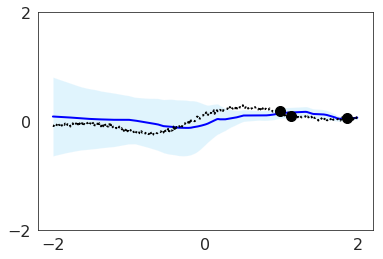

Test function: 3


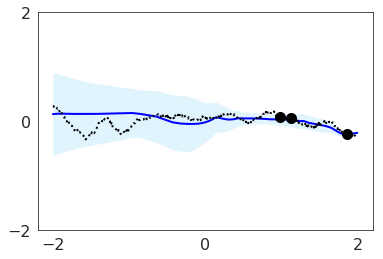

Iteration: 80000, train nll: -0.16563154757022858, mse: 0.0922793373465538, local kl: 0.0, global kl 0.0011641292367130518
Test function: 1


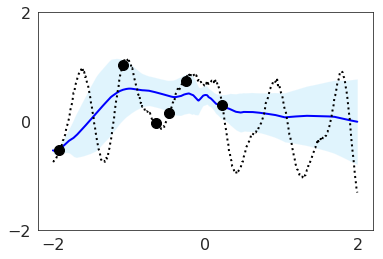

Test function: 2


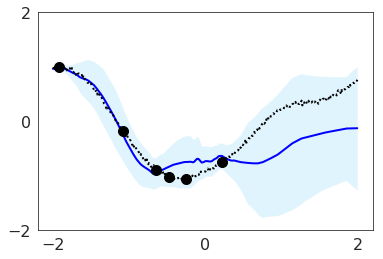

Test function: 3


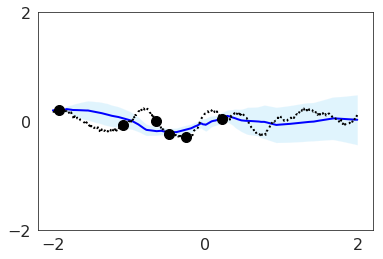

Iteration: 90000, train nll: -0.3292408883571625, mse: 0.15117408335208893, local kl: 0.0, global kl 0.0036322171799838543
Saving model...
beta 2.0 temperature 1000.0
Test function: 1


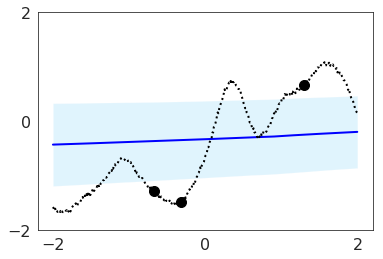

Test function: 2


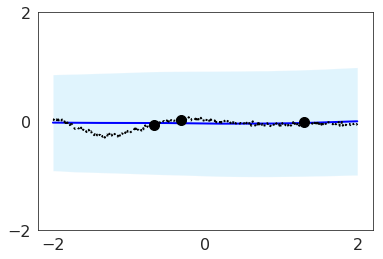

Test function: 3


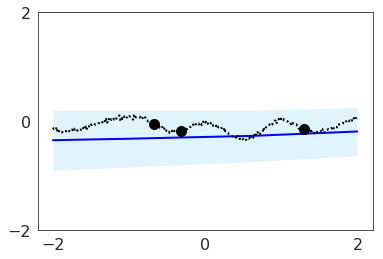

Iteration: 0, train nll: 1.0477746725082397, mse: 0.4295283257961273, local kl: 0.0, global kl 0.0
Test function: 1


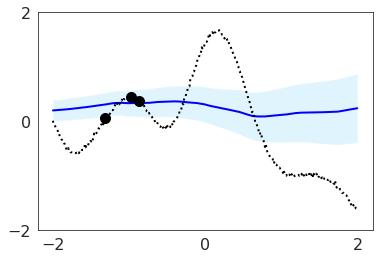

Test function: 2


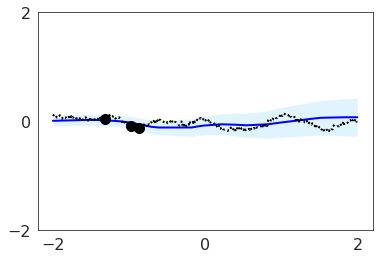

Test function: 3


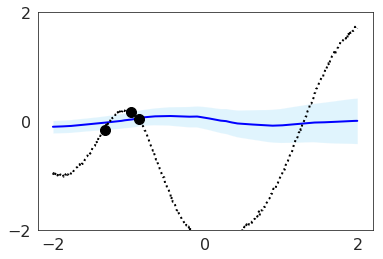

Iteration: 10000, train nll: 0.2431996911764145, mse: 0.148039311170578, local kl: 0.0, global kl 0.0015238607302308083
Test function: 1


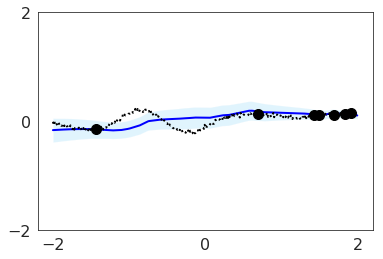

Test function: 2


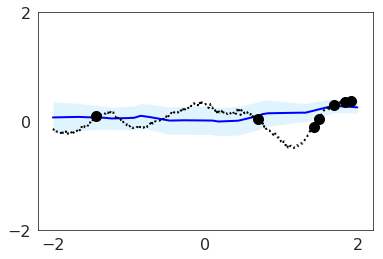

Test function: 3


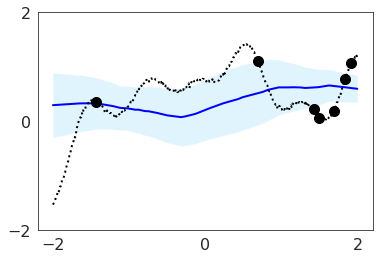

Iteration: 20000, train nll: -0.023154735565185547, mse: 0.13617931306362152, local kl: 0.0, global kl 0.0010467101819813251
Test function: 1


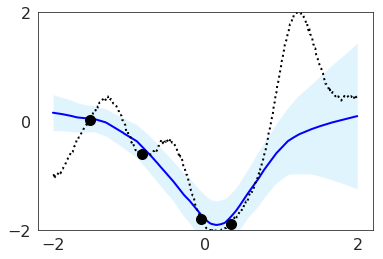

Test function: 2


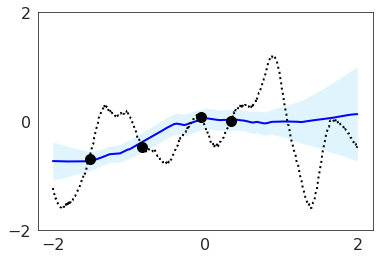

Test function: 3


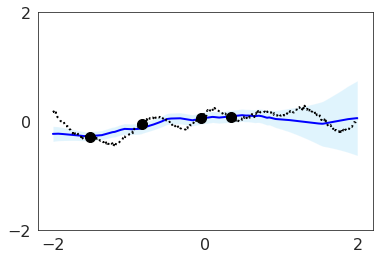

Iteration: 30000, train nll: 0.014984924346208572, mse: 0.11616110056638718, local kl: 0.0, global kl 0.002130434848368168
Test function: 1


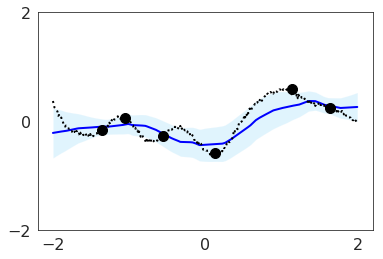

Test function: 2


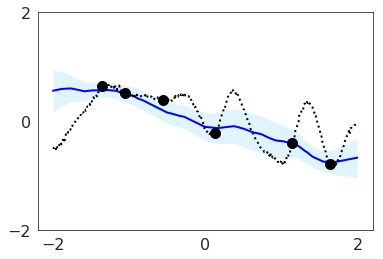

Test function: 3


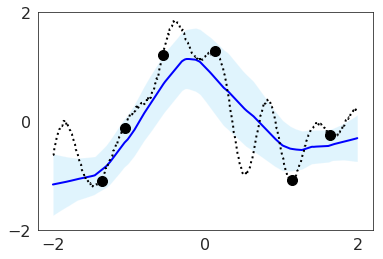

Iteration: 40000, train nll: -0.32528871297836304, mse: 0.06239315867424011, local kl: 0.0, global kl 0.0015785230789333582
Test function: 1


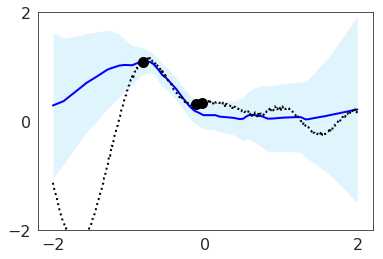

Test function: 2


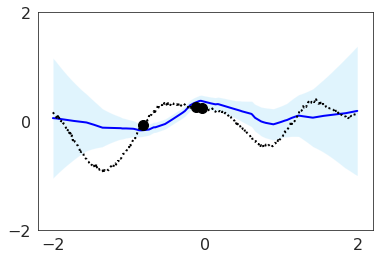

Test function: 3


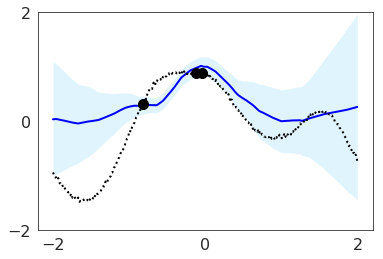

Iteration: 50000, train nll: -0.09991452097892761, mse: 0.14412957429885864, local kl: 0.0, global kl 0.0013725865865126252
Test function: 1


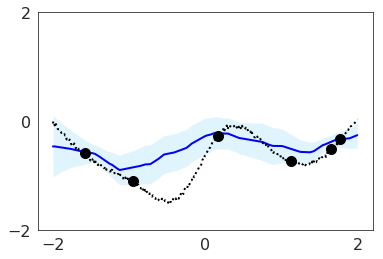

Test function: 2


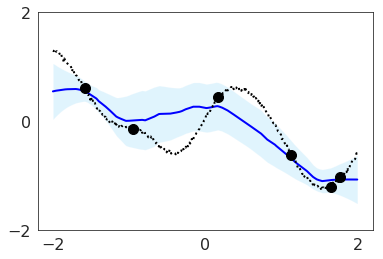

Test function: 3


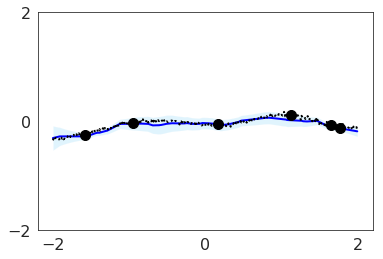

Iteration: 60000, train nll: -0.4244703948497772, mse: 0.0650087371468544, local kl: 0.0, global kl 0.0
Test function: 1


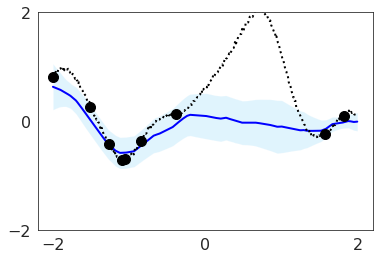

Test function: 2


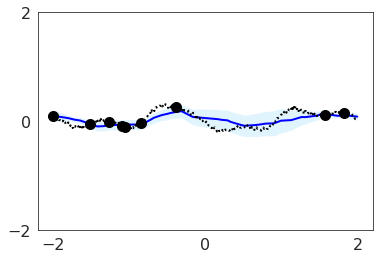

Test function: 3


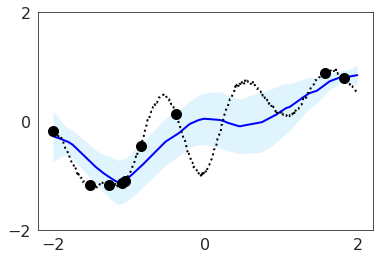

Iteration: 70000, train nll: -0.3719898462295532, mse: 0.07434344291687012, local kl: 0.0, global kl 0.0005171665688976645
Test function: 1


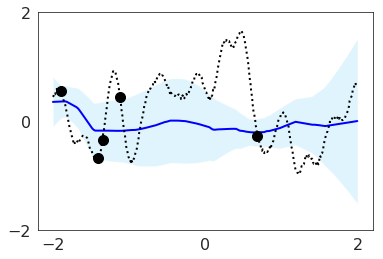

Test function: 2


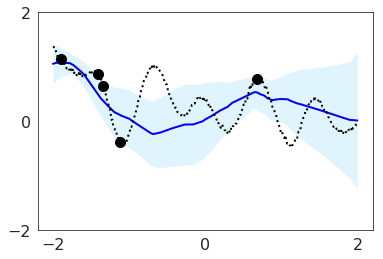

Test function: 3


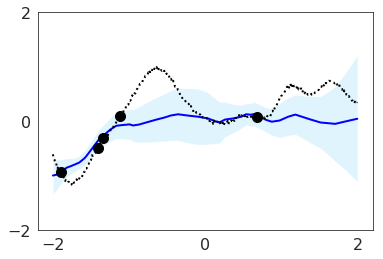

Iteration: 80000, train nll: 0.19444365799427032, mse: 0.17697444558143616, local kl: 0.0, global kl 0.00932308379560709
Test function: 1


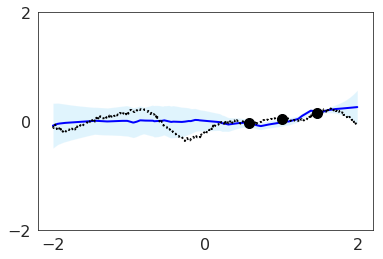

Test function: 2


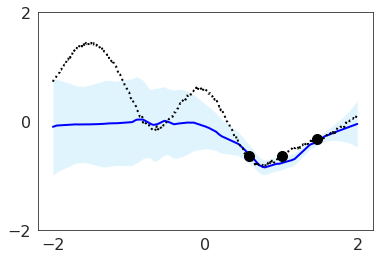

Test function: 3


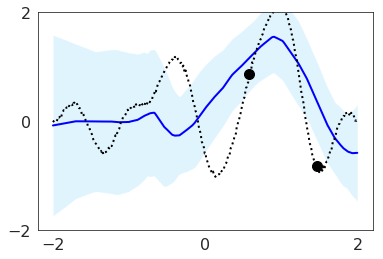

Iteration: 90000, train nll: -0.6296283602714539, mse: 0.0460071936249733, local kl: 0.0, global kl 0.0
Saving model...
beta 5.0 temperature 0.001
Test function: 1


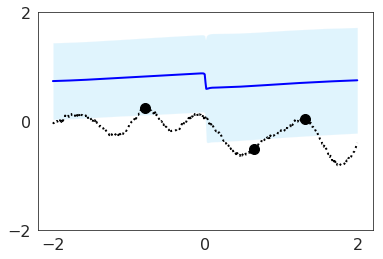

Test function: 2


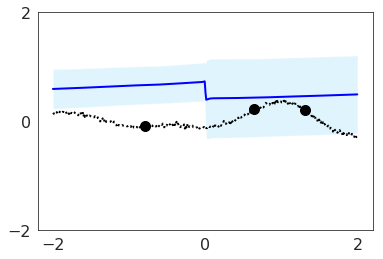

Test function: 3


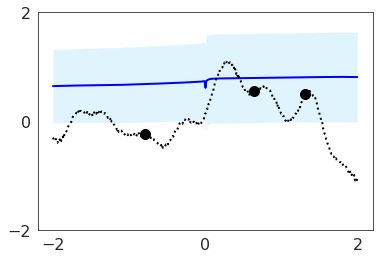

Iteration: 0, train nll: 1.4810197353363037, mse: 0.8651089072227478, local kl: 0.0, global kl 0.01656200736761093
Test function: 1


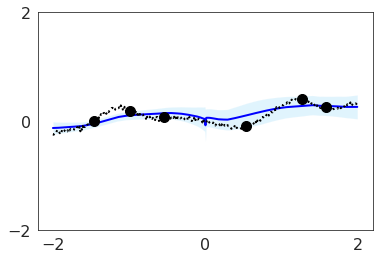

Test function: 2


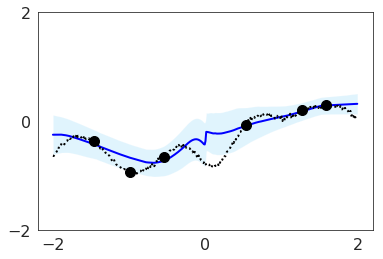

Test function: 3


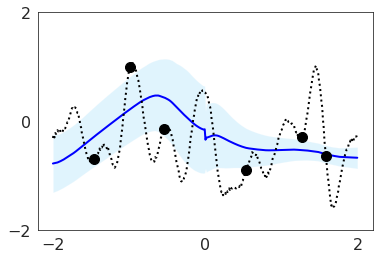

Iteration: 10000, train nll: -0.23002928495407104, mse: 0.08753365278244019, local kl: 0.0, global kl 0.0
Test function: 1


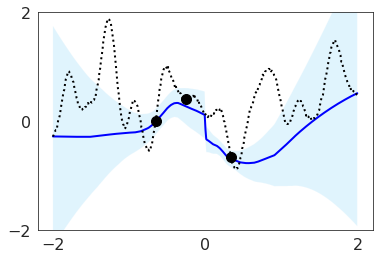

Test function: 2


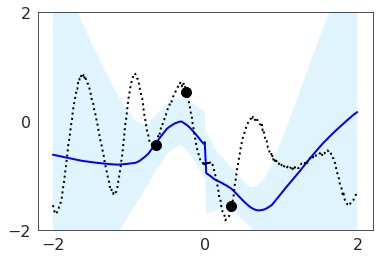

Test function: 3


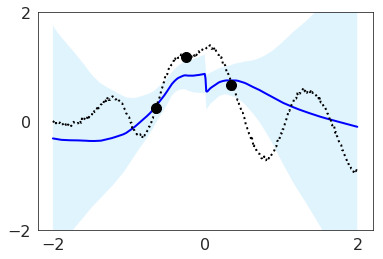

Iteration: 20000, train nll: -0.6059484481811523, mse: 0.04528077319264412, local kl: 0.0, global kl 0.0
Test function: 1


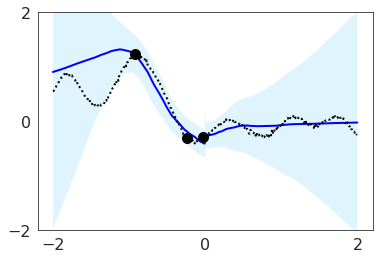

Test function: 2


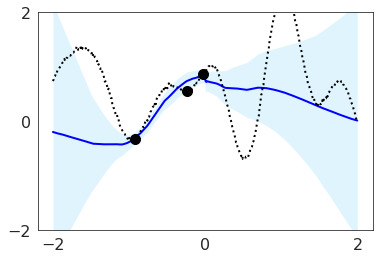

Test function: 3


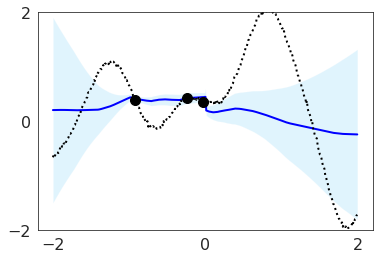

Iteration: 30000, train nll: -0.5473929047584534, mse: 0.08513834327459335, local kl: 0.0, global kl 0.0032395338639616966
Test function: 1


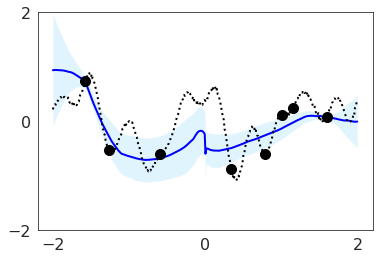

Test function: 2


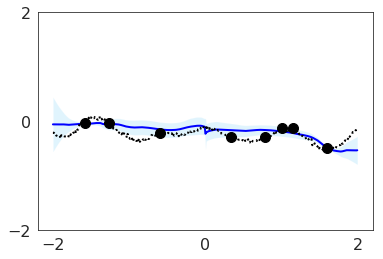

Test function: 3


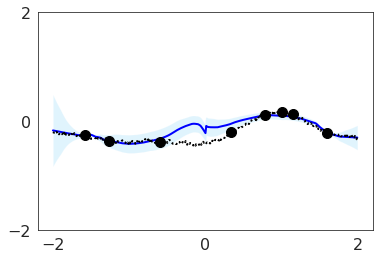

Iteration: 40000, train nll: -0.7344541549682617, mse: 0.04948931559920311, local kl: 0.0, global kl 0.0
Test function: 1


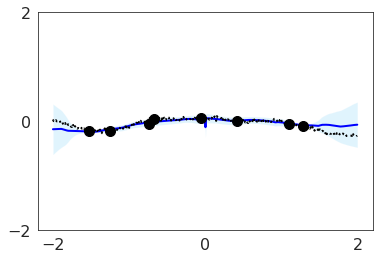

Test function: 2


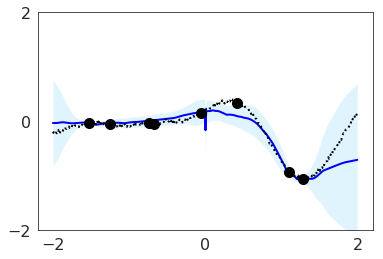

Test function: 3


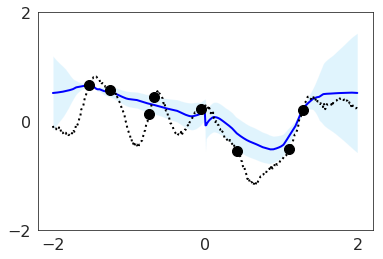

Iteration: 50000, train nll: -1.0663098096847534, mse: 0.028767792508006096, local kl: 0.0, global kl 0.0
Test function: 1


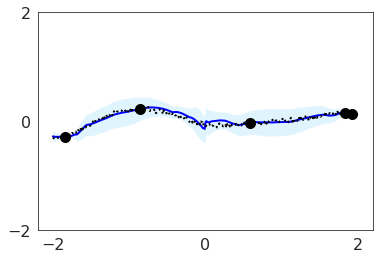

Test function: 2


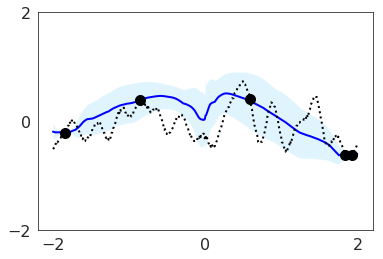

Test function: 3


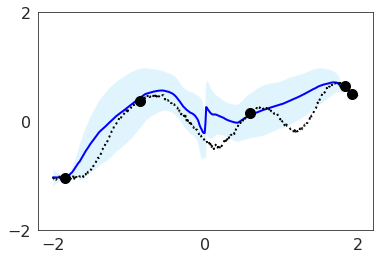

Iteration: 60000, train nll: -0.9381829500198364, mse: 0.07295595109462738, local kl: 0.0, global kl 0.000948808912653476
Test function: 1


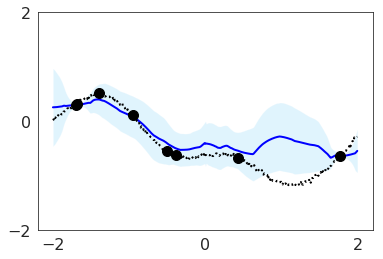

Test function: 2


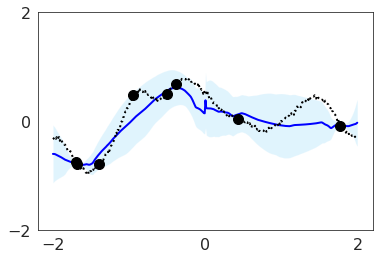

Test function: 3


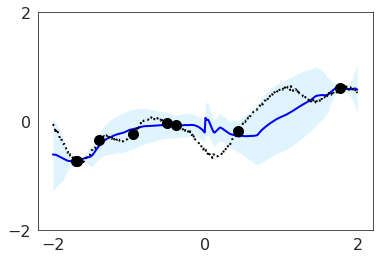

Iteration: 70000, train nll: -0.2289440631866455, mse: 0.18842853605747223, local kl: 0.0, global kl 0.006656674202531576
Test function: 1


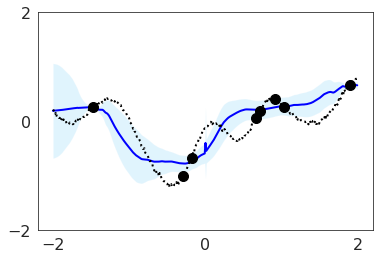

Test function: 2


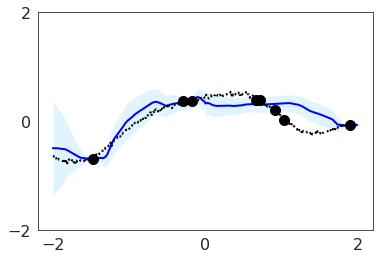

Test function: 3


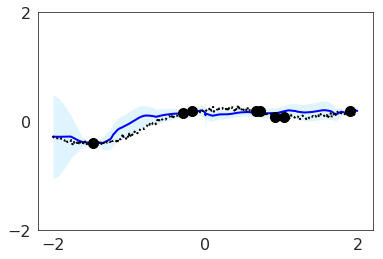

Iteration: 80000, train nll: -1.2336227893829346, mse: 0.06290413439273834, local kl: 0.0, global kl 0.0020171692594885826
Test function: 1


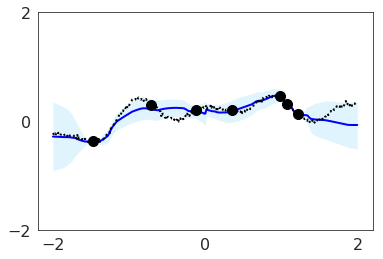

Test function: 2


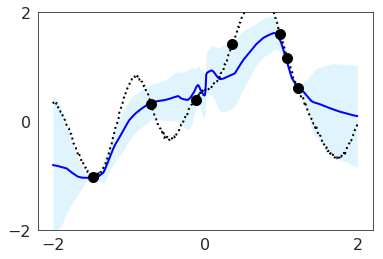

Test function: 3


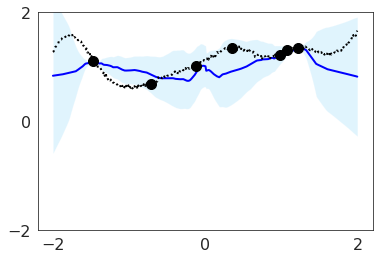

Iteration: 90000, train nll: -1.1645770072937012, mse: 0.03616638109087944, local kl: 0.0, global kl 0.0
Saving model...
beta 5.0 temperature 0.5
Test function: 1


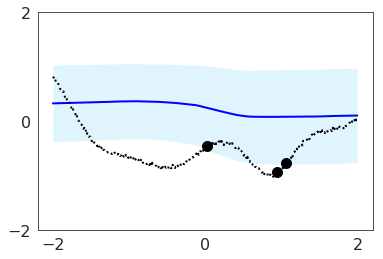

Test function: 2


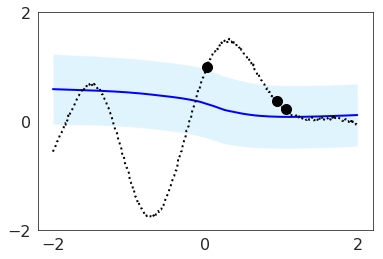

Test function: 3


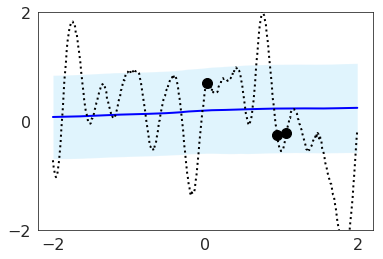

Iteration: 0, train nll: 1.201591968536377, mse: 0.5519334077835083, local kl: 0.0, global kl 0.0
Test function: 1


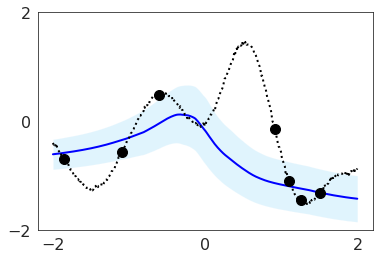

Test function: 2


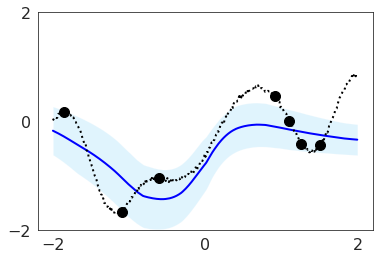

Test function: 3


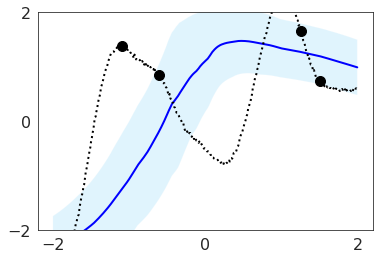

Iteration: 10000, train nll: -0.08309594541788101, mse: 0.10379477590322495, local kl: 0.0, global kl 0.0
Test function: 1


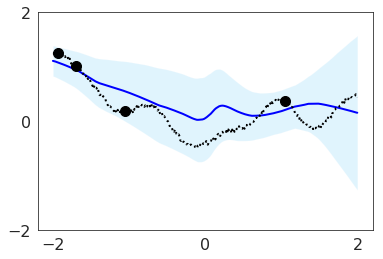

Test function: 2


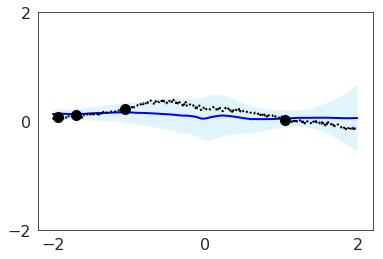

Test function: 3


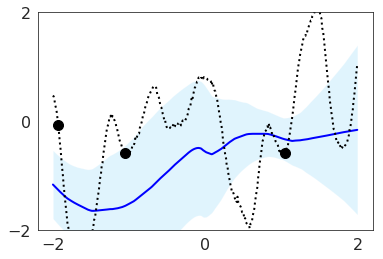

Iteration: 20000, train nll: -0.2642097473144531, mse: 0.08014602214097977, local kl: 0.0, global kl 0.0
Test function: 1


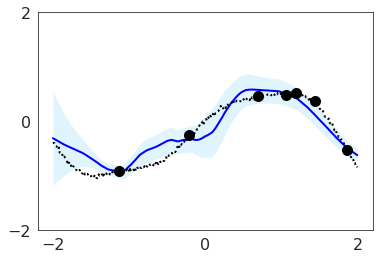

Test function: 2


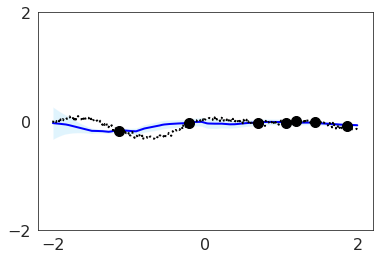

Test function: 3


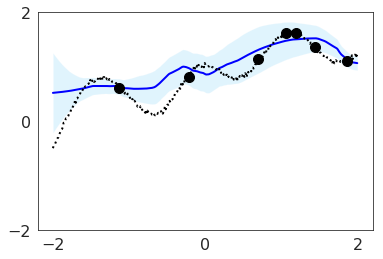

Iteration: 30000, train nll: -0.23786775767803192, mse: 0.08254610747098923, local kl: 0.0, global kl 0.005429690703749657
Test function: 1


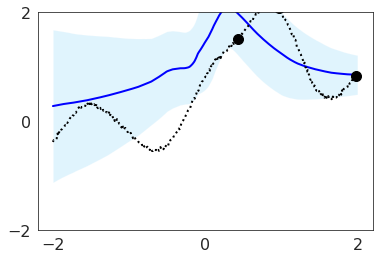

Test function: 2


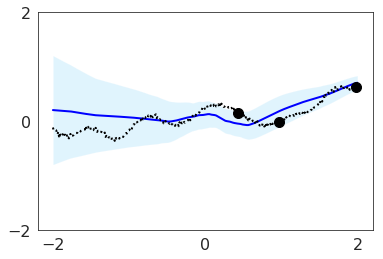

Test function: 3


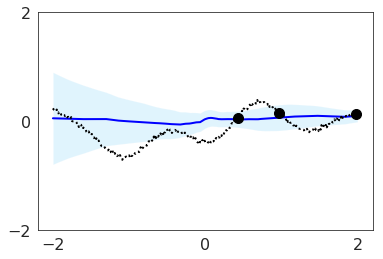

Iteration: 40000, train nll: -0.525275468826294, mse: 0.07431547343730927, local kl: 0.0, global kl 0.0006564276991412044
Test function: 1


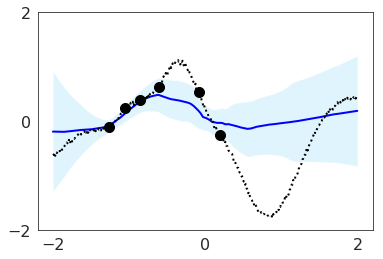

Test function: 2


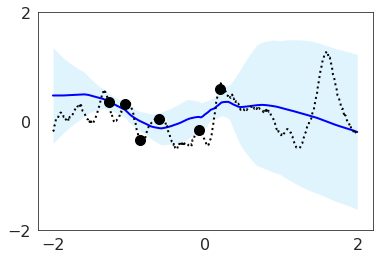

Test function: 3


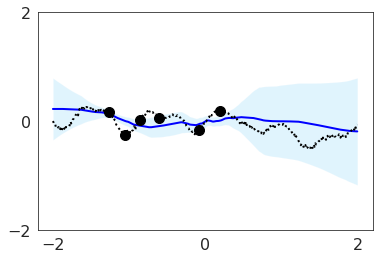

Iteration: 50000, train nll: -0.9405506253242493, mse: 0.024902625009417534, local kl: 0.0, global kl 0.0
Test function: 1


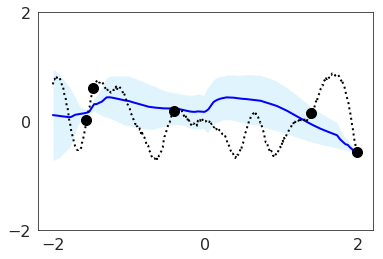

Test function: 2


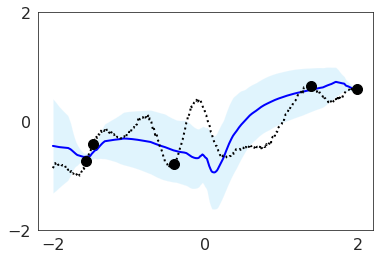

Test function: 3


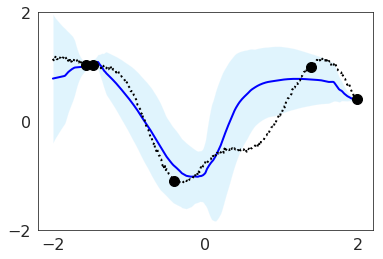

Iteration: 60000, train nll: -0.5152010917663574, mse: 0.07808390259742737, local kl: 0.0, global kl 0.002020378829911351
Test function: 1


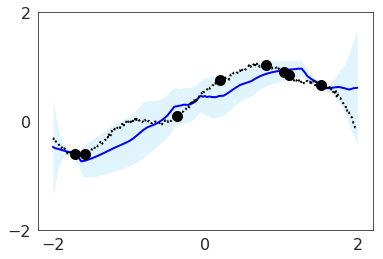

Test function: 2


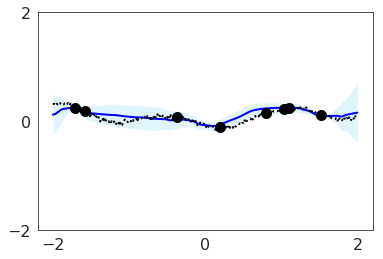

Test function: 3


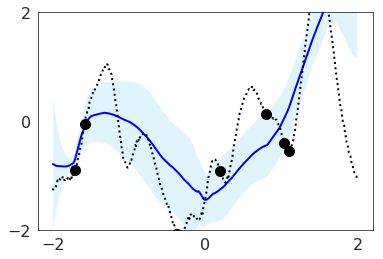

Iteration: 70000, train nll: -0.5545971989631653, mse: 0.06771692633628845, local kl: 0.0, global kl 0.00039691670099273324
Test function: 1


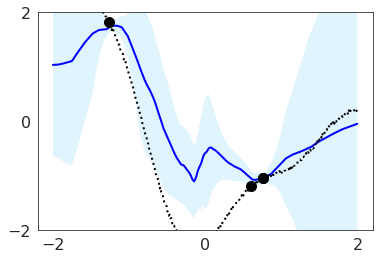

Test function: 2


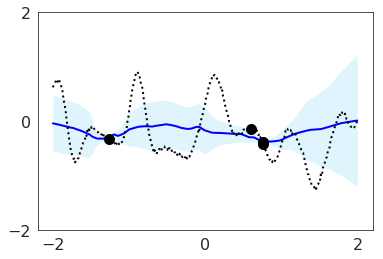

Test function: 3


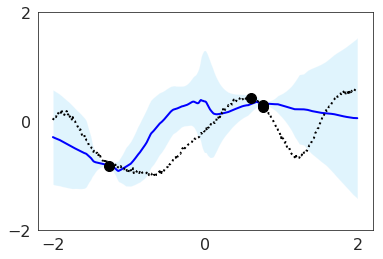

Iteration: 80000, train nll: -1.0498950481414795, mse: 0.02844800427556038, local kl: 0.0, global kl 0.0
Test function: 1


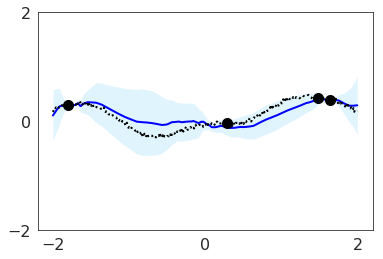

Test function: 2


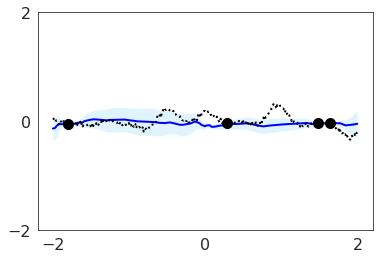

Test function: 3


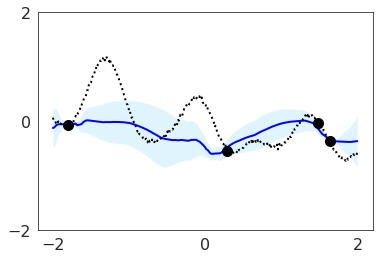

Iteration: 90000, train nll: -1.0515491962432861, mse: 0.060378145426511765, local kl: 0.0, global kl 0.001473427633754909
Saving model...
beta 5.0 temperature 1.0
Test function: 1


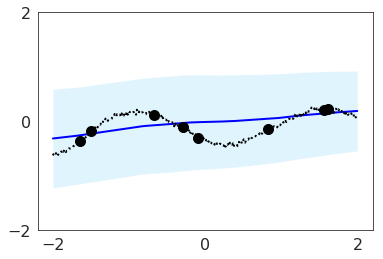

Test function: 2


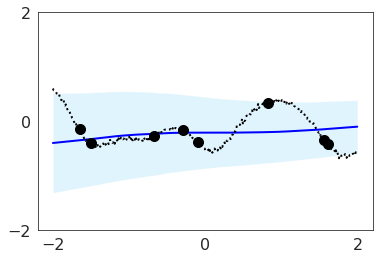

Test function: 3


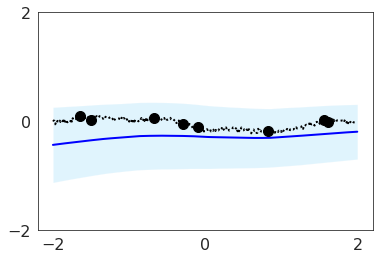

Iteration: 0, train nll: 1.261723518371582, mse: 0.5693005919456482, local kl: 0.0, global kl 0.0
Test function: 1


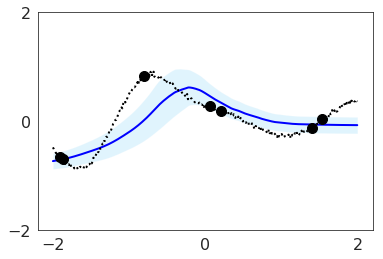

Test function: 2


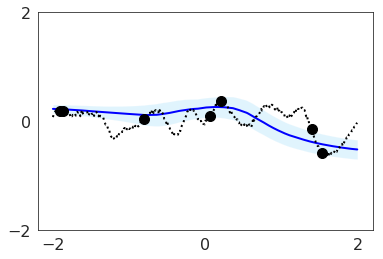

Test function: 3


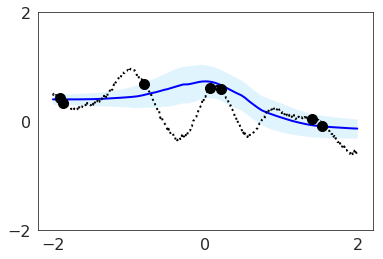

Iteration: 10000, train nll: 0.009368246421217918, mse: 0.1272684633731842, local kl: 0.0, global kl 0.0015217787586152554
Test function: 1


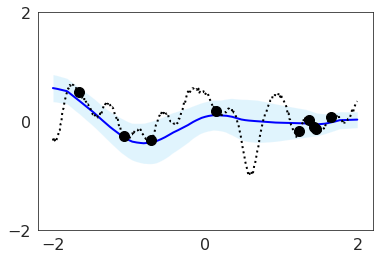

Test function: 2


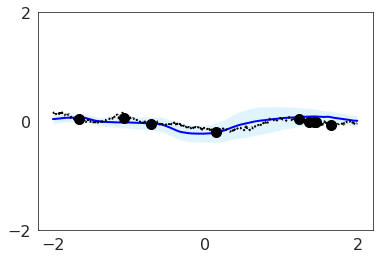

Test function: 3


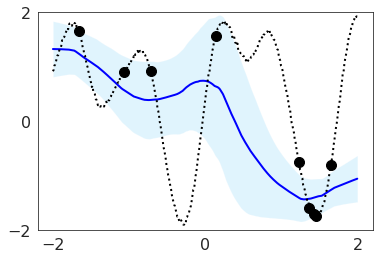

Iteration: 20000, train nll: -0.15661922097206116, mse: 0.08840081095695496, local kl: 0.0, global kl 0.003055949928238988
Test function: 1


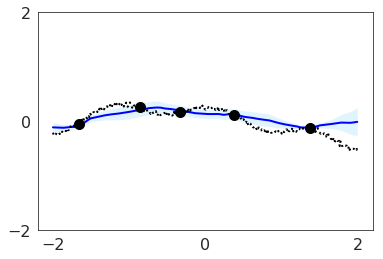

Test function: 2


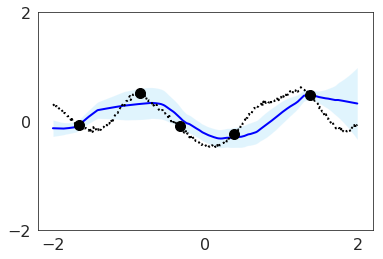

Test function: 3


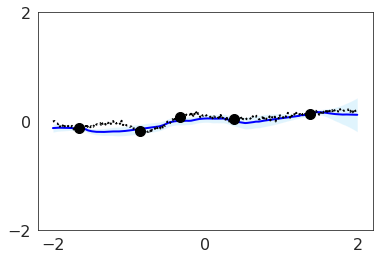

Iteration: 30000, train nll: -0.6384585499763489, mse: 0.044601261615753174, local kl: 0.0, global kl 0.0
Test function: 1


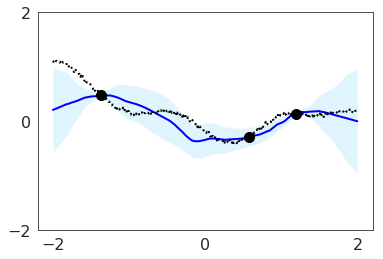

Test function: 2


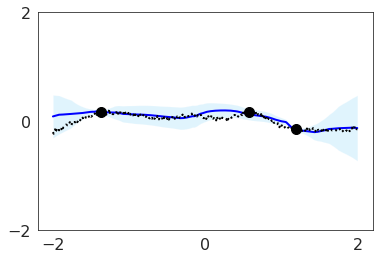

Test function: 3


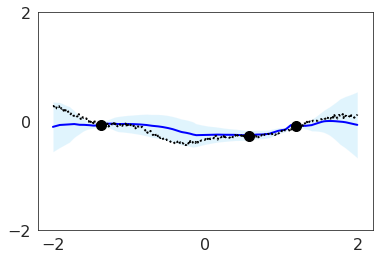

Iteration: 40000, train nll: -0.4463433623313904, mse: 0.050503481179475784, local kl: 0.0, global kl 0.0013019366888329387
Test function: 1


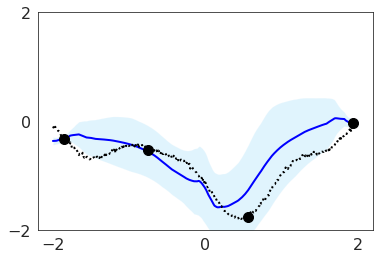

Test function: 2


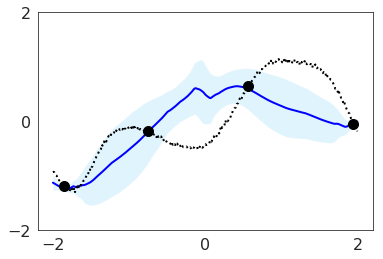

Test function: 3


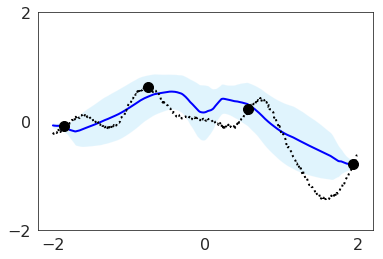

Iteration: 50000, train nll: -0.7292547225952148, mse: 0.05160198733210564, local kl: 0.0, global kl 0.0
Test function: 1


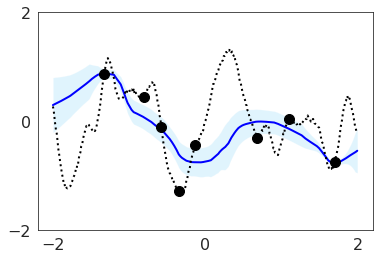

Test function: 2


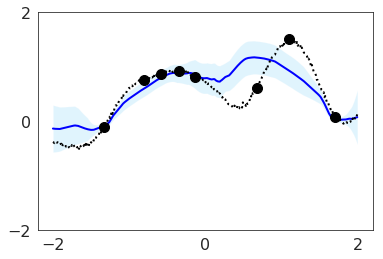

Test function: 3


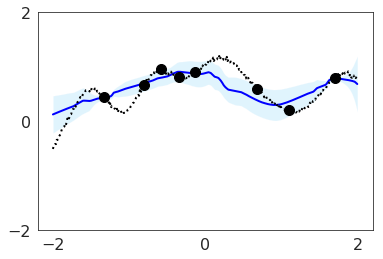

Iteration: 60000, train nll: -0.7857456803321838, mse: 0.049583613872528076, local kl: 0.0, global kl 0.0
Test function: 1


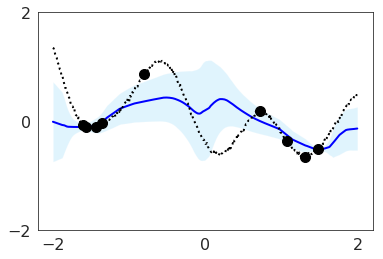

Test function: 2


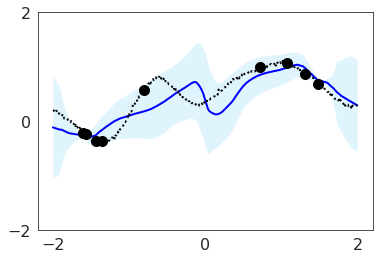

Test function: 3


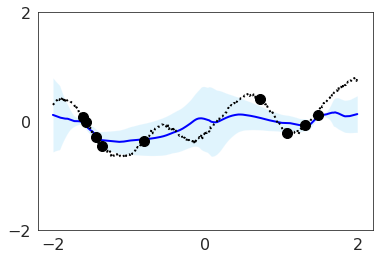

Iteration: 70000, train nll: -0.9794930815696716, mse: 0.015769723802804947, local kl: 0.0, global kl 0.0
Test function: 1


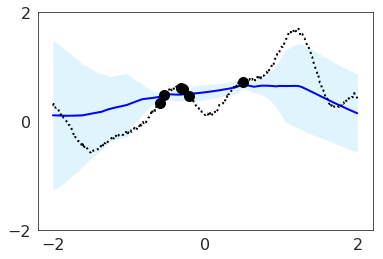

Test function: 2


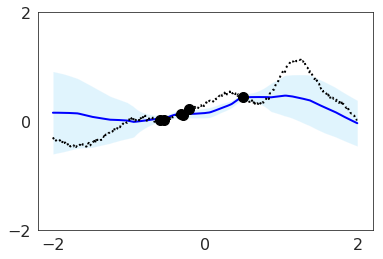

Test function: 3


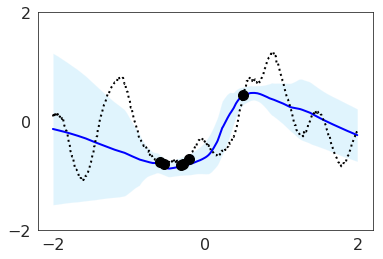

Iteration: 80000, train nll: 0.04208482429385185, mse: 0.21227110922336578, local kl: 0.0, global kl 0.004337049555033445
Test function: 1


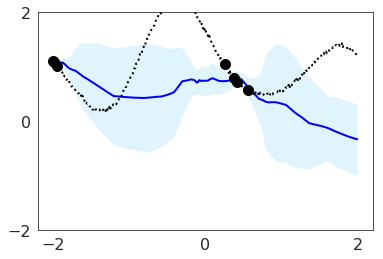

Test function: 2


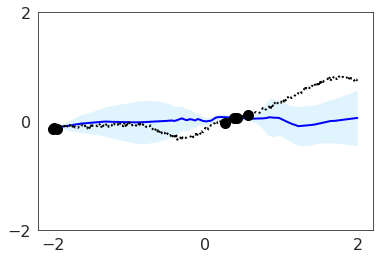

Test function: 3


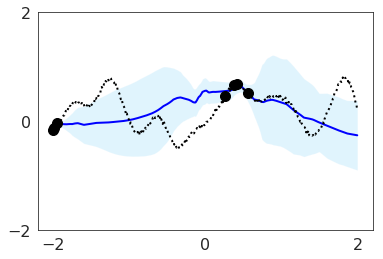

Iteration: 90000, train nll: -0.9043951034545898, mse: 0.043528538197278976, local kl: 0.0, global kl 0.0
Saving model...
beta 5.0 temperature 2.0
Test function: 1


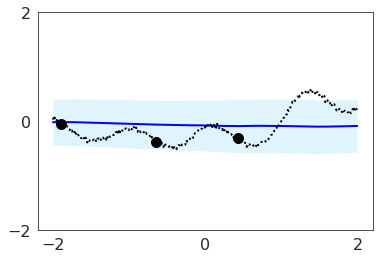

Test function: 2


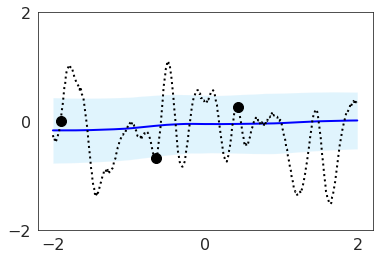

Test function: 3


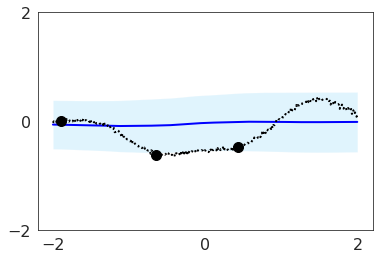

Iteration: 0, train nll: 1.29872727394104, mse: 0.42405936121940613, local kl: 0.0, global kl 0.019428789615631104
Test function: 1


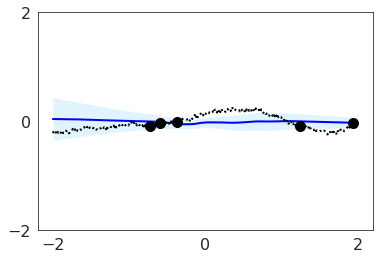

Test function: 2


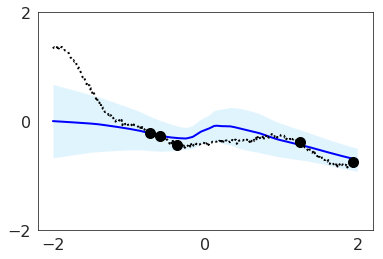

Test function: 3


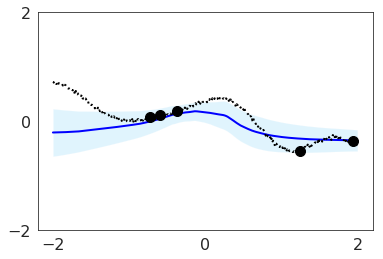

Iteration: 10000, train nll: 0.6980194449424744, mse: 0.23322702944278717, local kl: 0.0, global kl 0.006856520660221577
Test function: 1


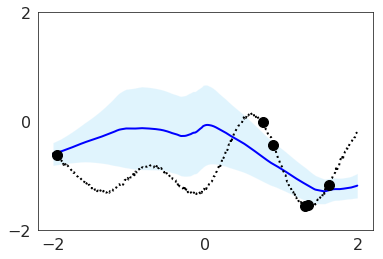

Test function: 2


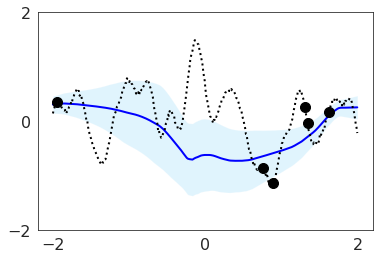

Test function: 3


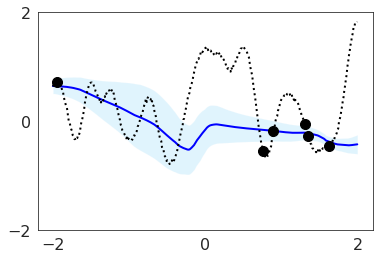

Iteration: 20000, train nll: -0.345893532037735, mse: 0.08224489539861679, local kl: 0.0, global kl 0.0007662763237021863
Test function: 1


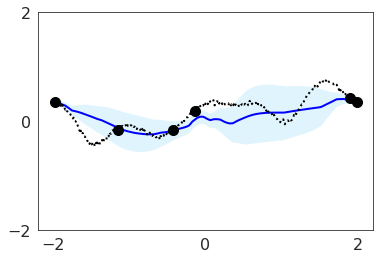

Test function: 2


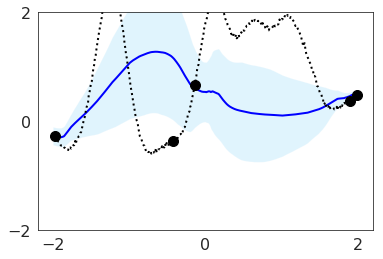

Test function: 3


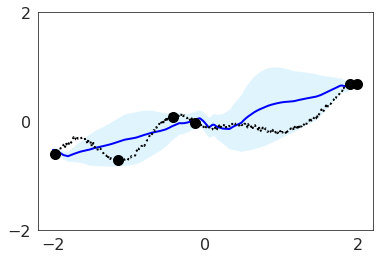

Iteration: 30000, train nll: -0.5852242708206177, mse: 0.06370893120765686, local kl: 0.0, global kl 0.0
Test function: 1


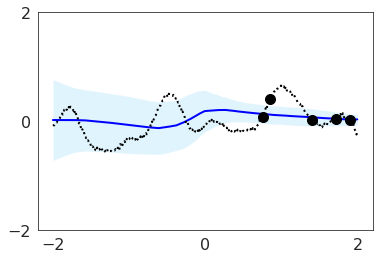

Test function: 2


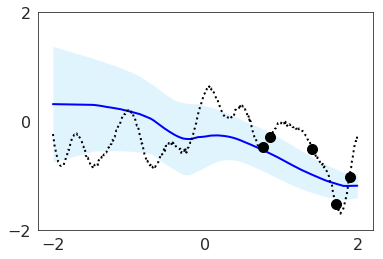

Test function: 3


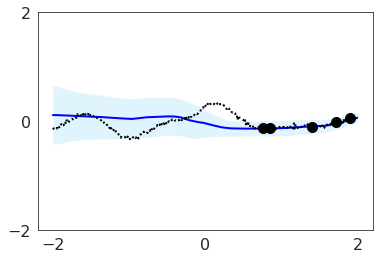

Iteration: 40000, train nll: -0.7567164897918701, mse: 0.05514296144247055, local kl: 0.0, global kl 0.0
Test function: 1


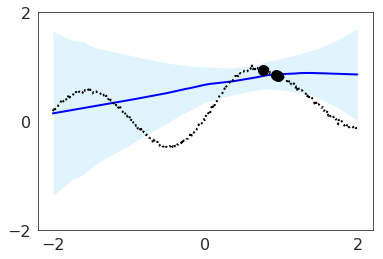

Test function: 2


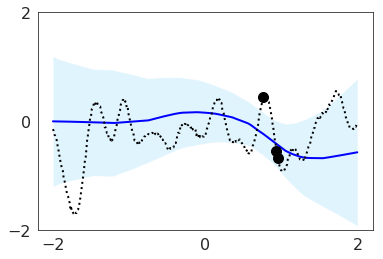

Test function: 3


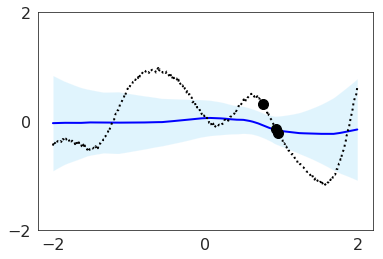

Iteration: 50000, train nll: -0.09450696408748627, mse: 0.10453831404447556, local kl: 0.0, global kl 0.004078316502273083
Test function: 1


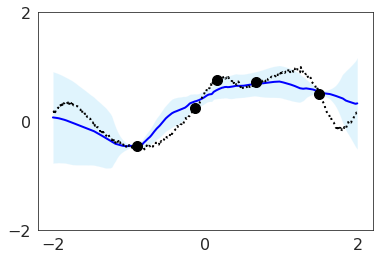

Test function: 2


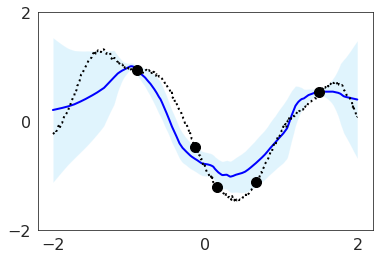

Test function: 3


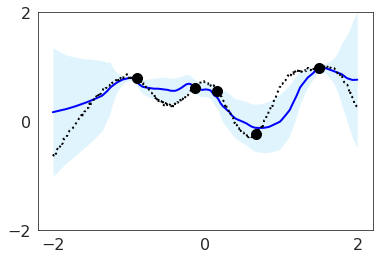

Iteration: 60000, train nll: -1.0238447189331055, mse: 0.025086745619773865, local kl: 0.0, global kl 0.0
Test function: 1


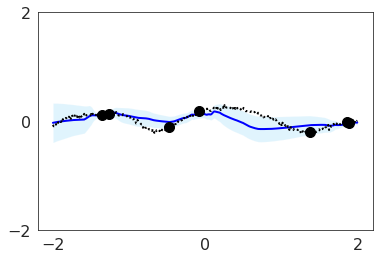

Test function: 2


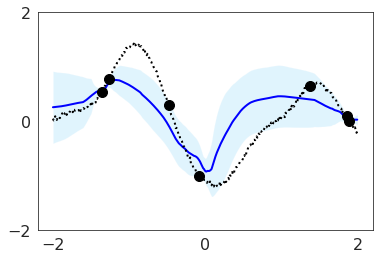

Test function: 3


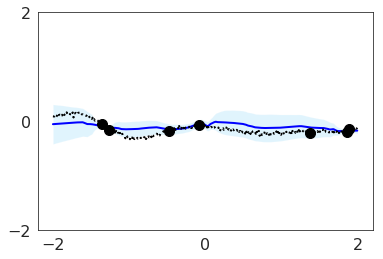

Iteration: 70000, train nll: 0.05447901785373688, mse: 0.1879999041557312, local kl: 0.0, global kl 0.006930535659193993
Test function: 1


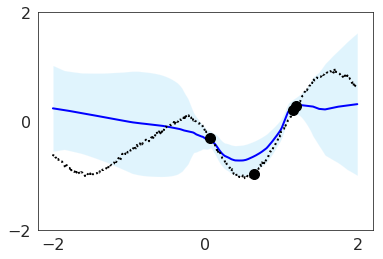

Test function: 2


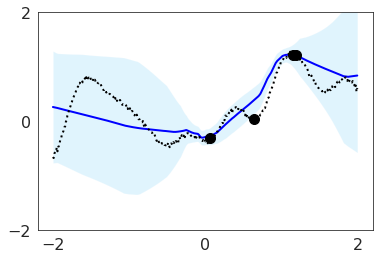

Test function: 3


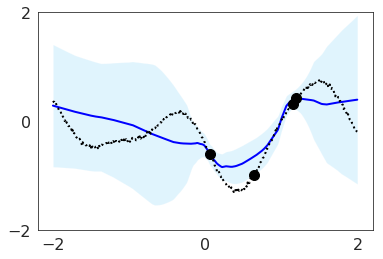

Iteration: 80000, train nll: -1.2390415668487549, mse: 0.016737084835767746, local kl: 0.0, global kl 0.0
Test function: 1


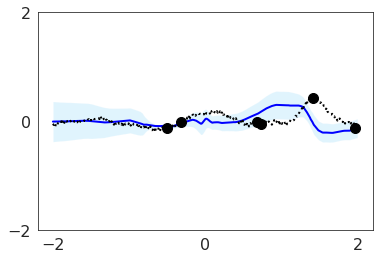

Test function: 2


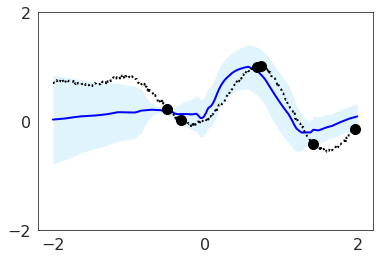

Test function: 3


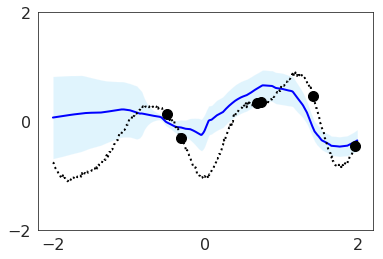

Iteration: 90000, train nll: -0.31297874450683594, mse: 0.07798810303211212, local kl: 0.0, global kl 0.0016949280397966504
Saving model...
beta 5.0 temperature 5.0
Test function: 1


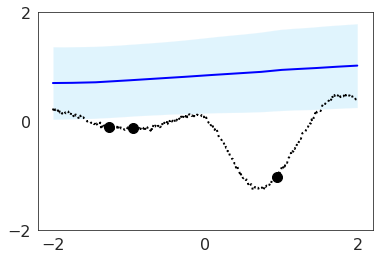

Test function: 2


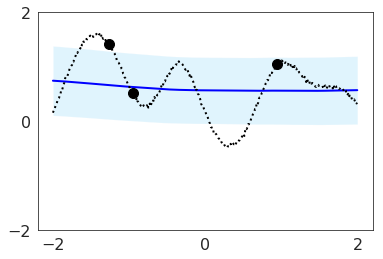

Test function: 3


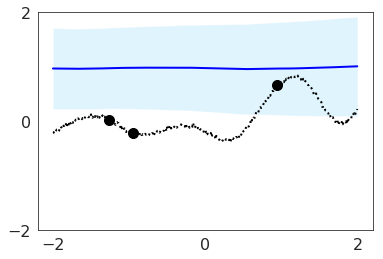

Iteration: 0, train nll: 2.2111597061157227, mse: 1.5843920707702637, local kl: 0.0, global kl 0.1731557548046112
Test function: 1


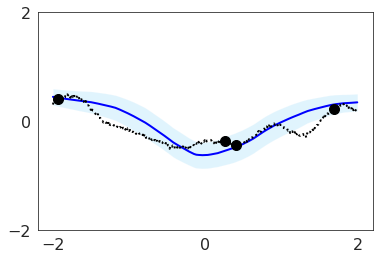

Test function: 2


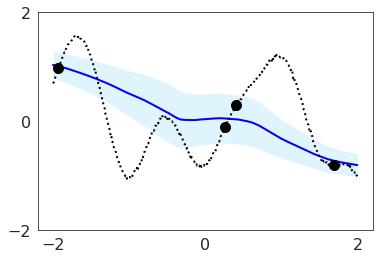

Test function: 3


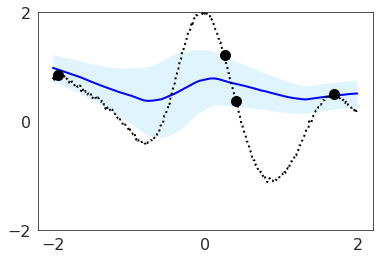

Iteration: 10000, train nll: 0.25432923436164856, mse: 0.1723184734582901, local kl: 0.0, global kl 0.0049302903935313225
Test function: 1


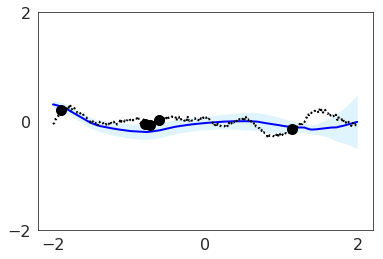

Test function: 2


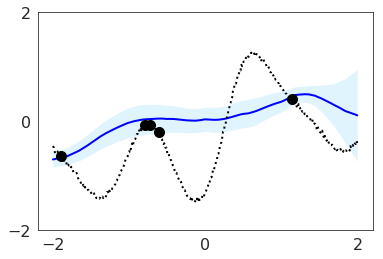

Test function: 3


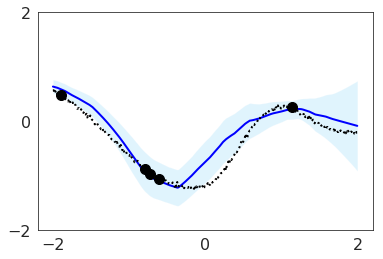

Iteration: 20000, train nll: 0.06024293974041939, mse: 0.1368192732334137, local kl: 0.0, global kl 0.002322850748896599
Test function: 1


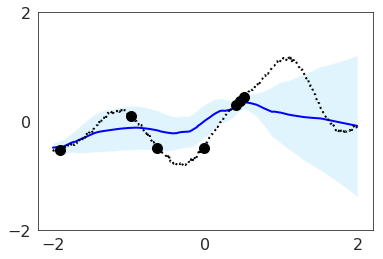

Test function: 2


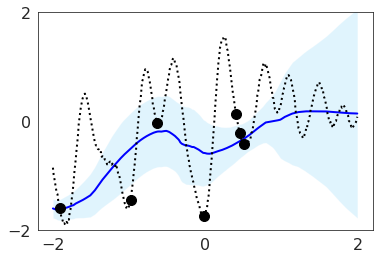

Test function: 3


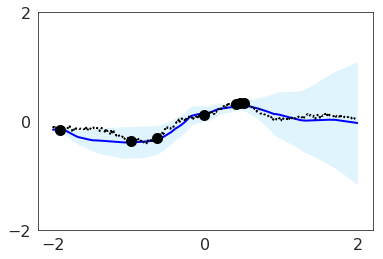

Iteration: 30000, train nll: -0.39971184730529785, mse: 0.08301012217998505, local kl: 0.0, global kl 0.0029842399526387453
Test function: 1


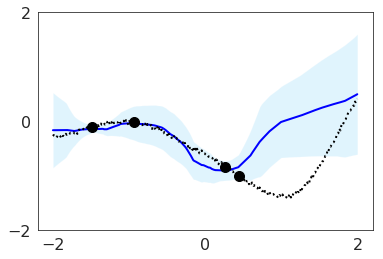

Test function: 2


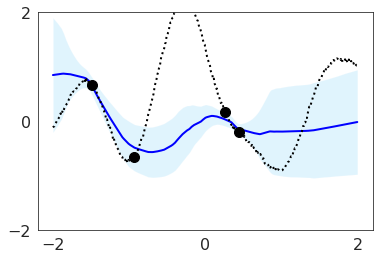

Test function: 3


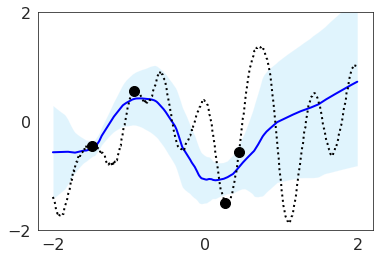

Iteration: 40000, train nll: -0.33136147260665894, mse: 0.14524324238300323, local kl: 0.0, global kl 0.005194646306335926
Test function: 1


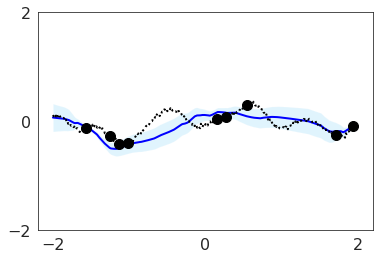

Test function: 2


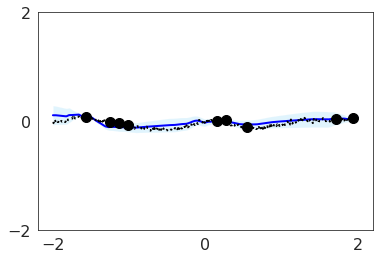

Test function: 3


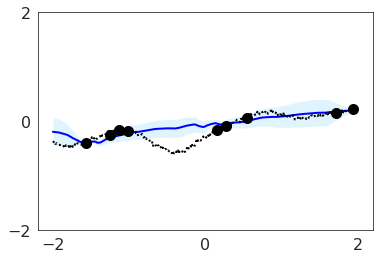

Iteration: 50000, train nll: -0.7381430864334106, mse: 0.04394034296274185, local kl: 0.0, global kl 0.0
Test function: 1


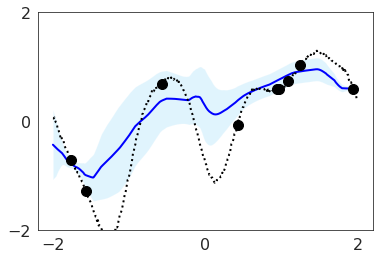

Test function: 2


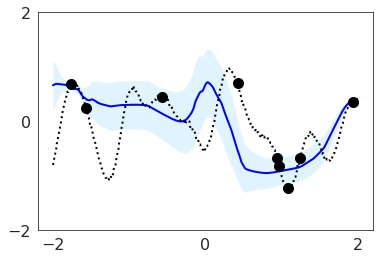

Test function: 3


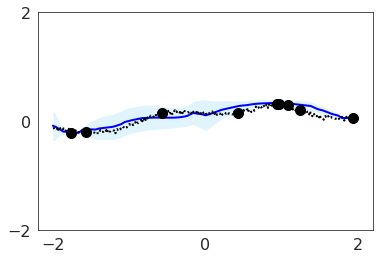

Iteration: 60000, train nll: -0.4146932363510132, mse: 0.09805948287248611, local kl: 0.0, global kl 0.001644838834181428
Test function: 1


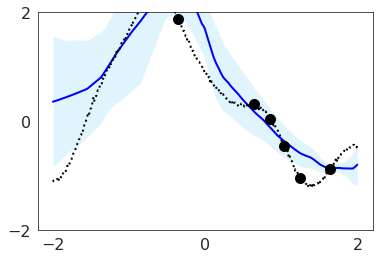

Test function: 2


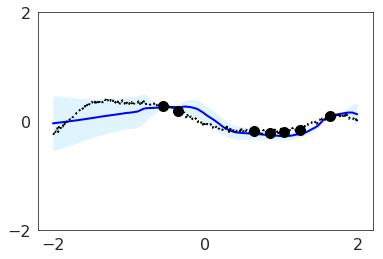

Test function: 3


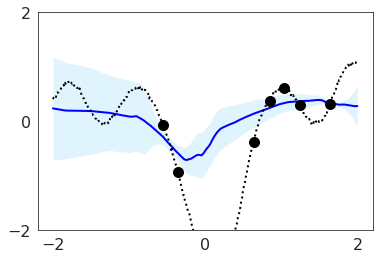

Iteration: 70000, train nll: -0.6037188172340393, mse: 0.06536020338535309, local kl: 0.0, global kl 0.0005259891040623188
Test function: 1


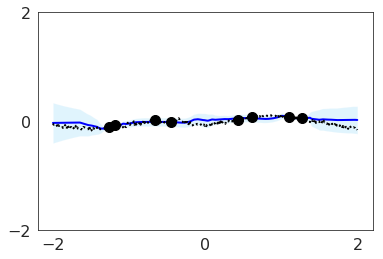

Test function: 2


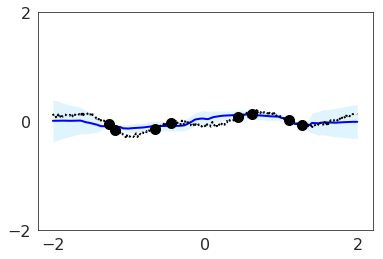

Test function: 3


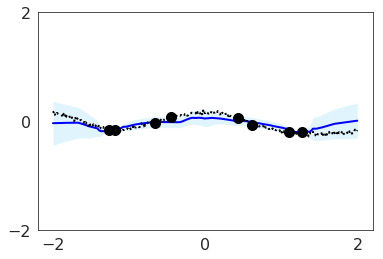

Iteration: 80000, train nll: -0.6329938769340515, mse: 0.07812149822711945, local kl: 0.0, global kl 0.0012668396811932325
Test function: 1


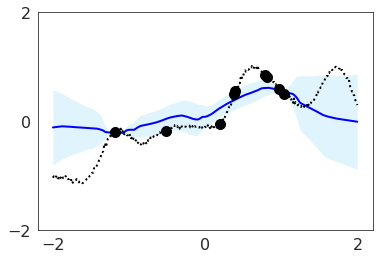

Test function: 2


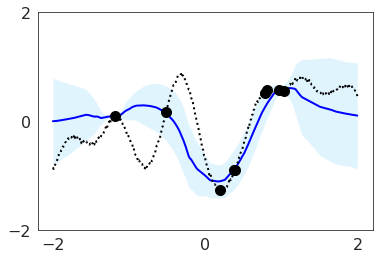

Test function: 3


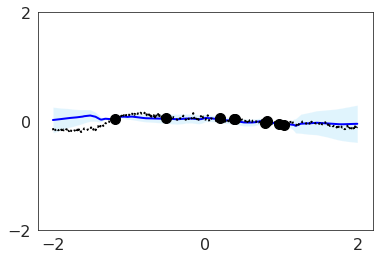

Iteration: 90000, train nll: -1.3889069557189941, mse: 0.014565514400601387, local kl: 0.0, global kl 0.0
Saving model...
beta 5.0 temperature 1000.0
Test function: 1


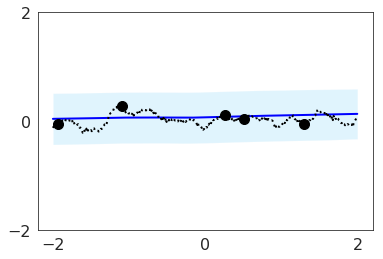

Test function: 2


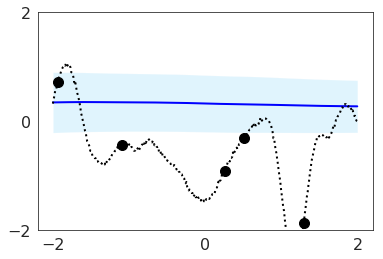

Test function: 3


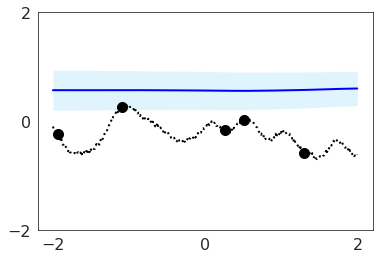

Iteration: 0, train nll: 1.8820492029190063, mse: 0.5689751505851746, local kl: 0.0, global kl 0.05328240990638733
Test function: 1


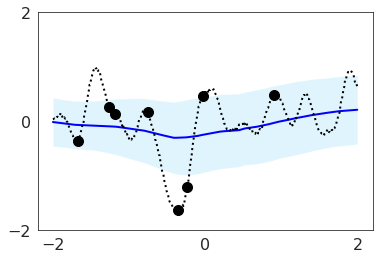

Test function: 2


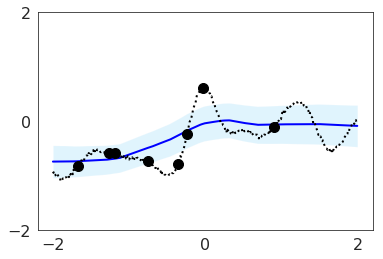

Test function: 3


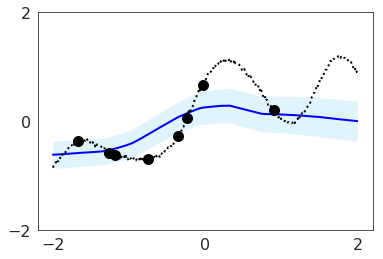

Iteration: 10000, train nll: 0.1310400664806366, mse: 0.14837978780269623, local kl: 0.0, global kl 0.0010572625324130058
Test function: 1


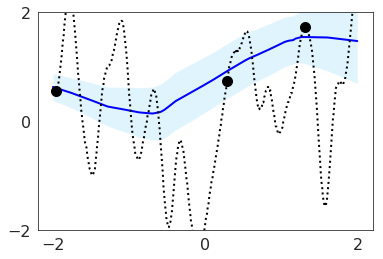

Test function: 2


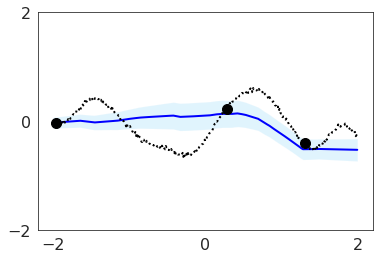

Test function: 3


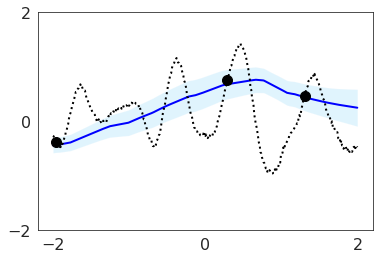

Iteration: 20000, train nll: -0.1828642338514328, mse: 0.09114518761634827, local kl: 0.0, global kl 0.0
Test function: 1


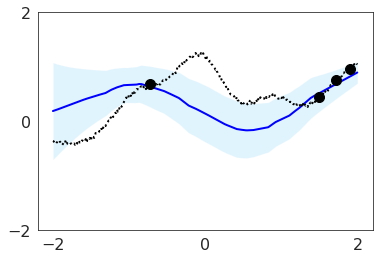

Test function: 2


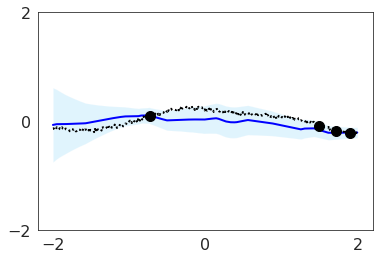

Test function: 3


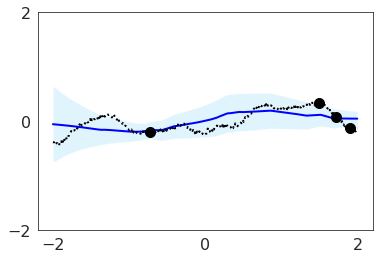

Iteration: 30000, train nll: -0.0986933559179306, mse: 0.10760287195444107, local kl: 0.0, global kl 0.00041303952457383275
Test function: 1


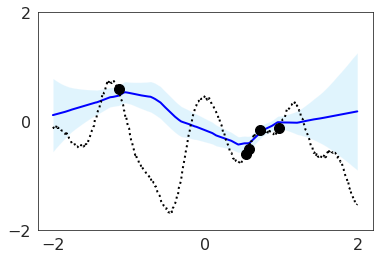

Test function: 2


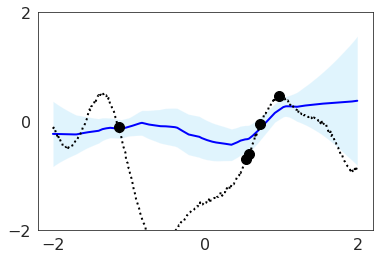

Test function: 3


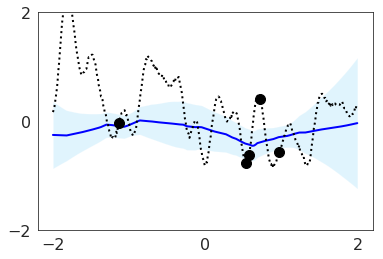

Iteration: 40000, train nll: -0.3104785680770874, mse: 0.05954727903008461, local kl: 0.0, global kl 0.00044459832133725286
Test function: 1


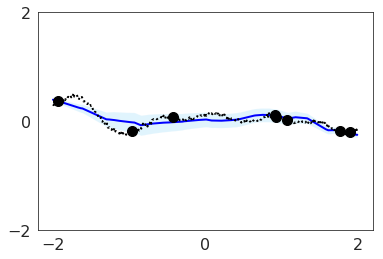

Test function: 2


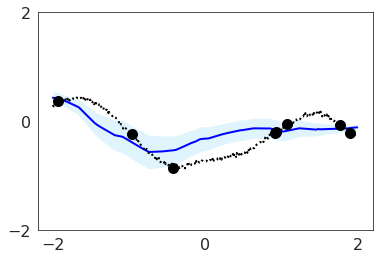

Test function: 3


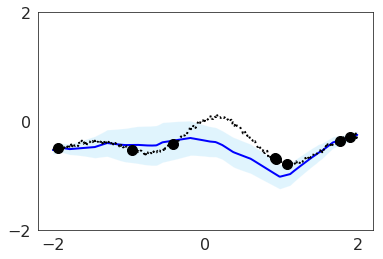

Iteration: 50000, train nll: -0.3933136761188507, mse: 0.07544345408678055, local kl: 0.0, global kl 0.0
Test function: 1


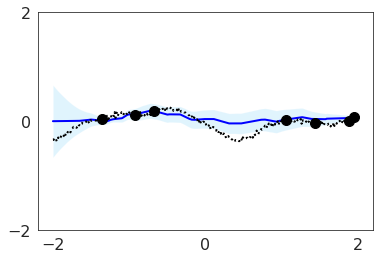

Test function: 2


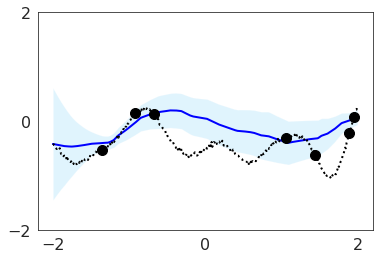

Test function: 3


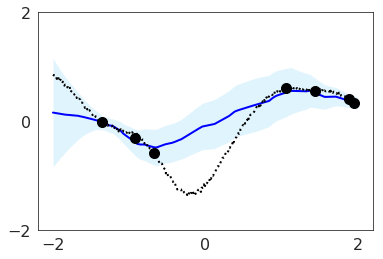

Iteration: 60000, train nll: 0.2522486448287964, mse: 0.11924772709608078, local kl: 0.0, global kl 0.0031639328226447105
Test function: 1


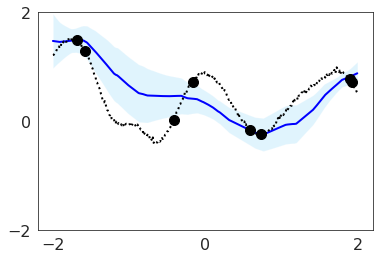

Test function: 2


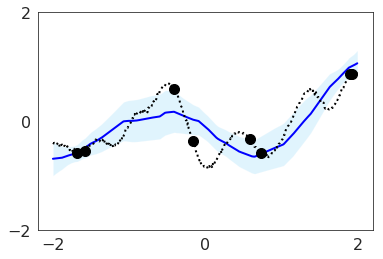

Test function: 3


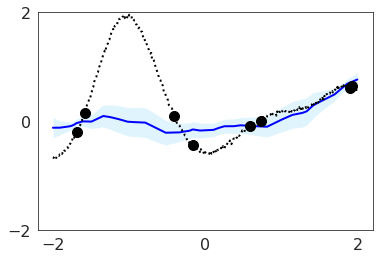

Iteration: 70000, train nll: -0.39302703738212585, mse: 0.054453592747449875, local kl: 0.0, global kl 0.0017564496956765652
Test function: 1


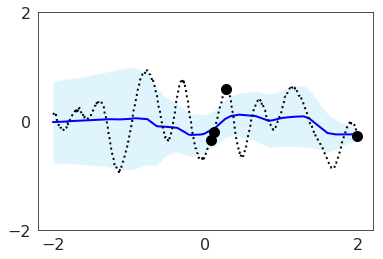

Test function: 2


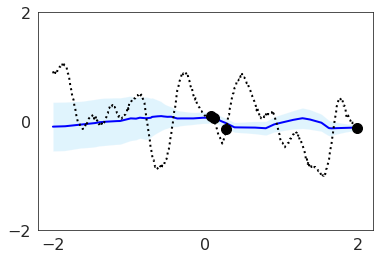

Test function: 3


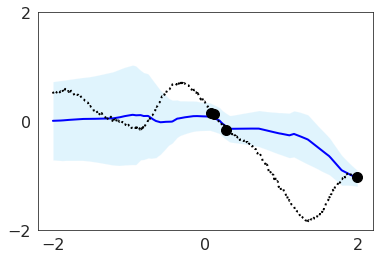

Iteration: 80000, train nll: -0.35609349608421326, mse: 0.06501667946577072, local kl: 0.0, global kl 0.0
Test function: 1


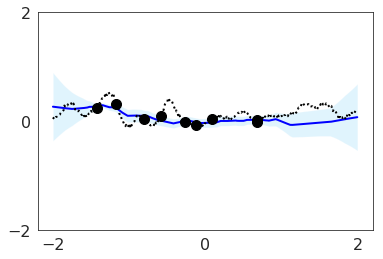

Test function: 2


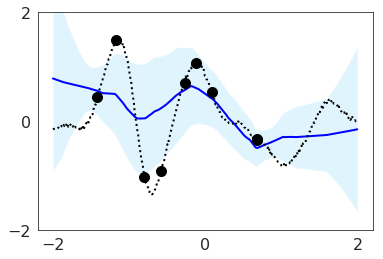

Test function: 3


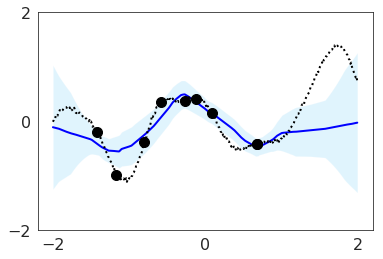

Iteration: 90000, train nll: 0.0025315508246421814, mse: 0.15123648941516876, local kl: 0.0, global kl 0.002306596376001835
Saving model...
beta 1000.0 temperature 0.001
Test function: 1


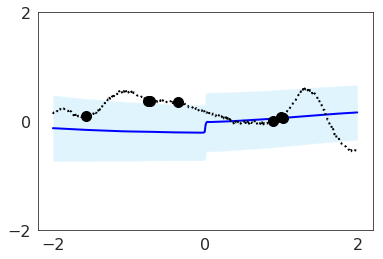

Test function: 2


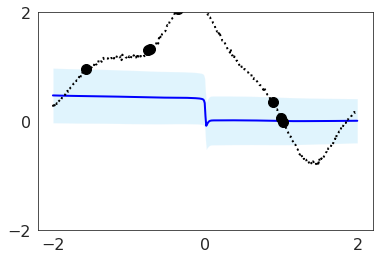

Test function: 3


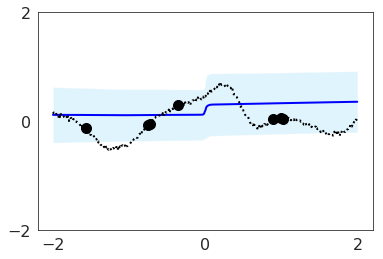

Iteration: 0, train nll: 1.3168712854385376, mse: 0.5883826017379761, local kl: 0.0, global kl 5.363875389099121
Test function: 1


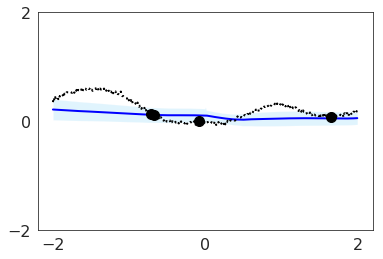

Test function: 2


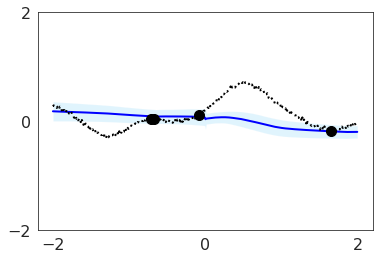

Test function: 3


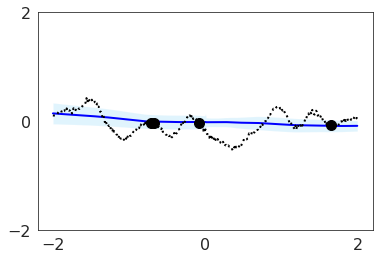

Iteration: 10000, train nll: 0.2369970977306366, mse: 0.15602999925613403, local kl: 0.0, global kl 0.021899478510022163
Test function: 1


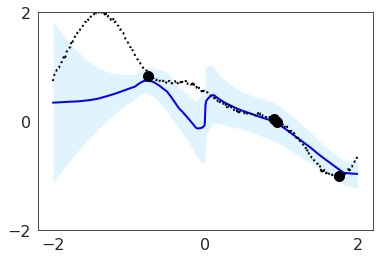

Test function: 2


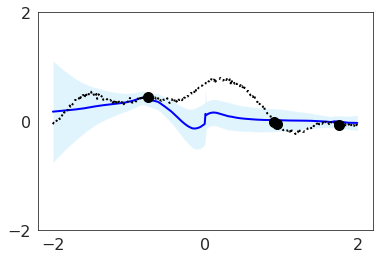

Test function: 3


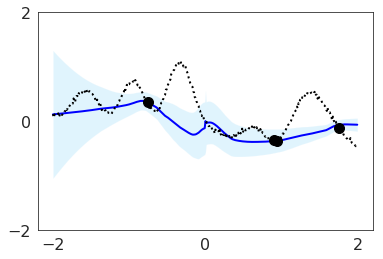

Iteration: 20000, train nll: -0.21647968888282776, mse: 0.13969548046588898, local kl: 0.0, global kl 0.007220545783638954
Test function: 1


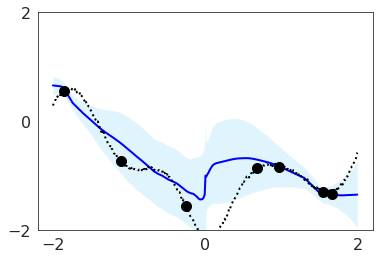

Test function: 2


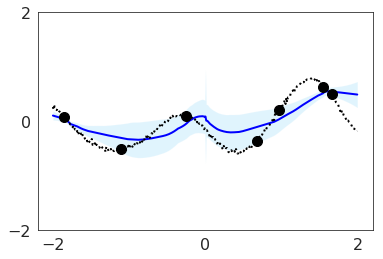

Test function: 3


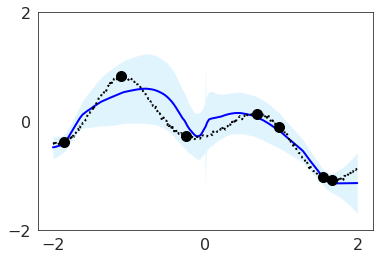

Iteration: 30000, train nll: -0.035143446177244186, mse: 0.22490741312503815, local kl: 0.0, global kl 0.019949495792388916
Test function: 1


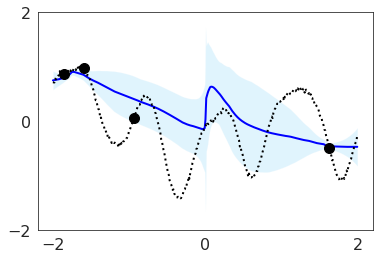

Test function: 2


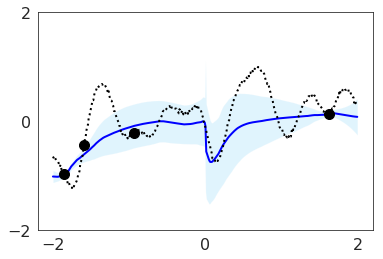

Test function: 3


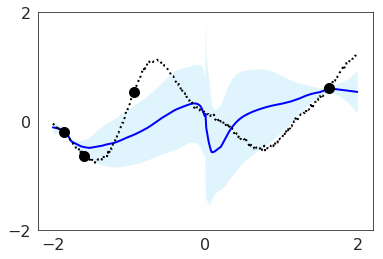

Iteration: 40000, train nll: -0.3368367850780487, mse: 0.12315762788057327, local kl: 0.0, global kl 0.004129121545702219
Test function: 1


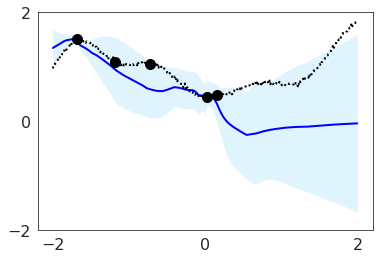

Test function: 2


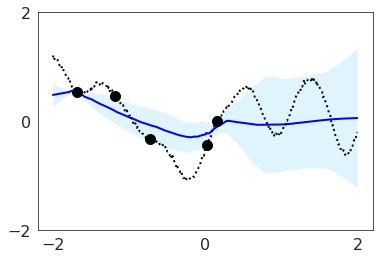

Test function: 3


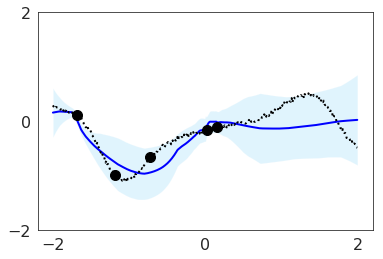

Iteration: 50000, train nll: -0.07704900950193405, mse: 0.194014772772789, local kl: 0.0, global kl 0.017816241830587387
Test function: 1


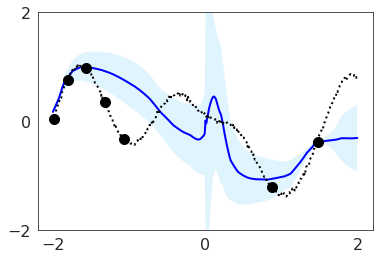

Test function: 2


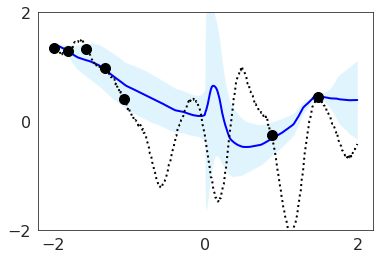

Test function: 3


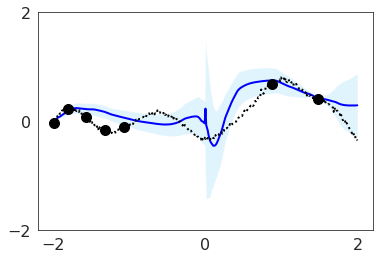

Iteration: 60000, train nll: -0.7443671822547913, mse: 0.08352543413639069, local kl: 0.0, global kl 0.0
Test function: 1


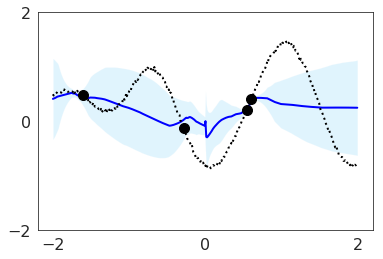

Test function: 2


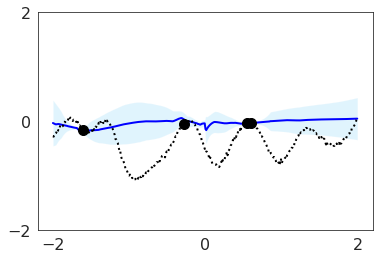

Test function: 3


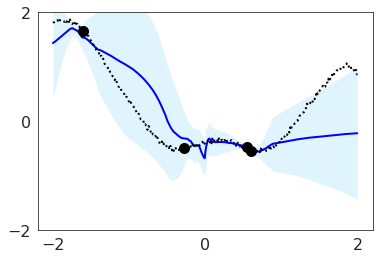

Iteration: 70000, train nll: -0.8658849596977234, mse: 0.05682871863245964, local kl: 0.0, global kl 0.0
Test function: 1


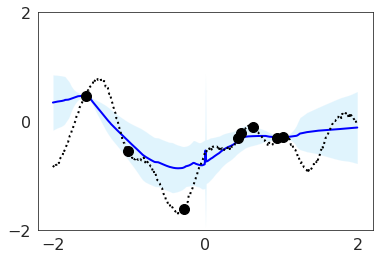

Test function: 2


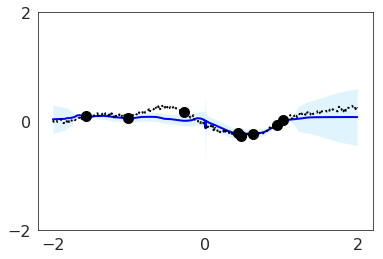

Test function: 3


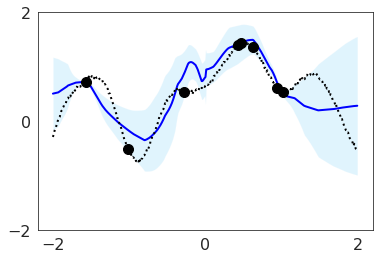

Iteration: 80000, train nll: -1.0749263763427734, mse: 0.03891778364777565, local kl: 0.0, global kl 0.0
Test function: 1


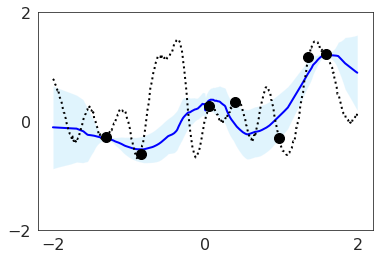

Test function: 2


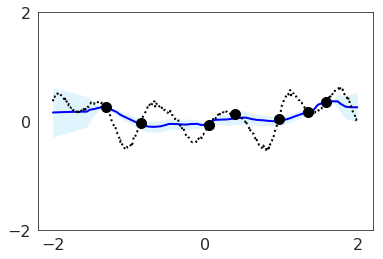

Test function: 3


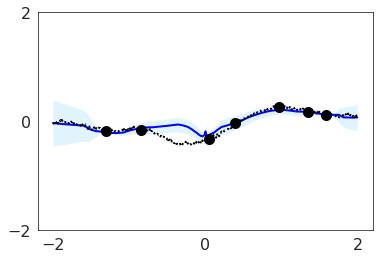

Iteration: 90000, train nll: -0.20077626407146454, mse: 0.16931797564029694, local kl: 0.0, global kl 0.011726120486855507
Saving model...
beta 1000.0 temperature 0.5
Test function: 1


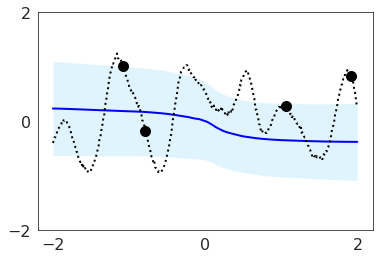

Test function: 2


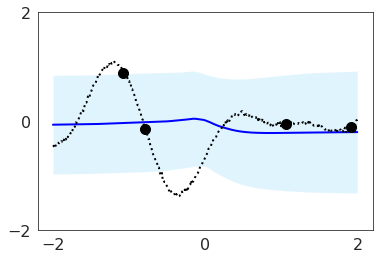

Test function: 3


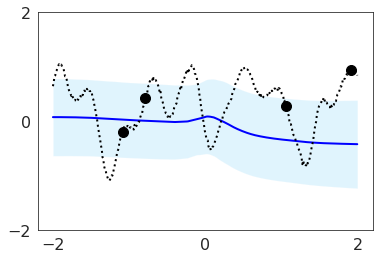

Iteration: 0, train nll: 1.2202788591384888, mse: 0.6413700580596924, local kl: 0.0, global kl 0.0
Test function: 1


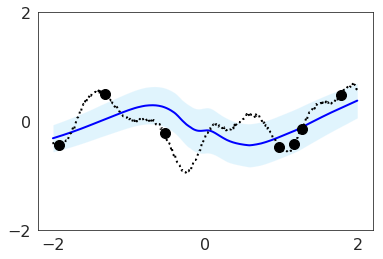

Test function: 2


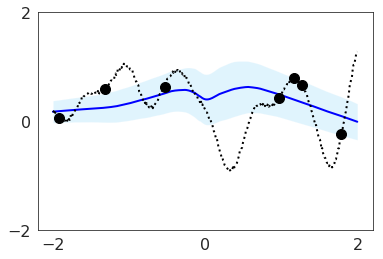

Test function: 3


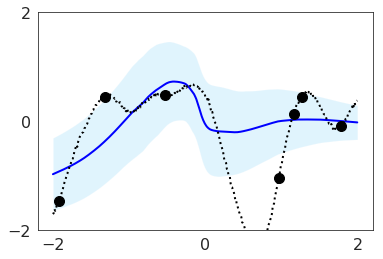

Iteration: 10000, train nll: -0.10775245726108551, mse: 0.08591646701097488, local kl: 0.0, global kl 0.0
Test function: 1


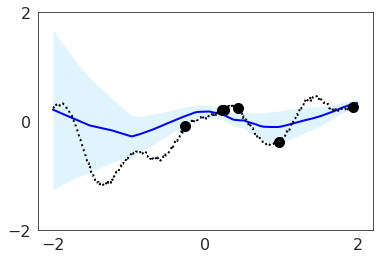

Test function: 2


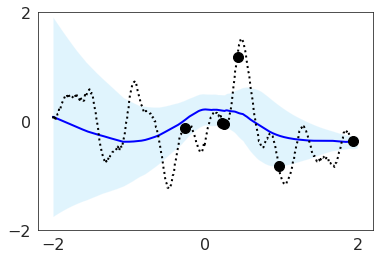

Test function: 3


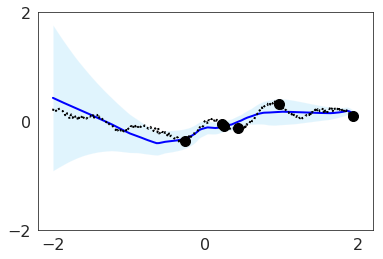

Iteration: 20000, train nll: 0.3867764472961426, mse: 0.2021692991256714, local kl: 0.0, global kl 0.029195193201303482
Test function: 1


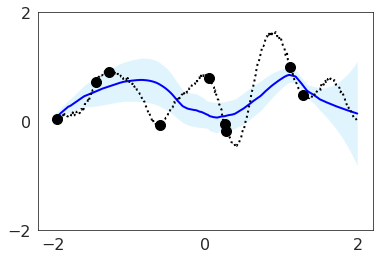

Test function: 2


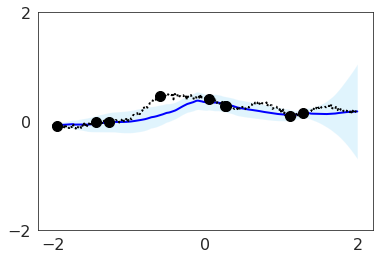

Test function: 3


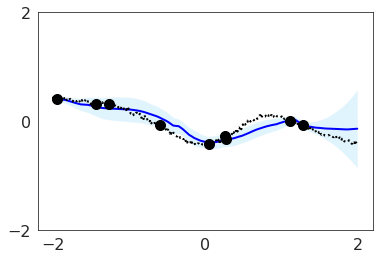

Iteration: 30000, train nll: -0.3999731242656708, mse: 0.06476825475692749, local kl: 0.0, global kl 0.0
Test function: 1


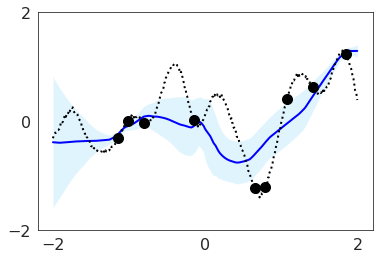

Test function: 2


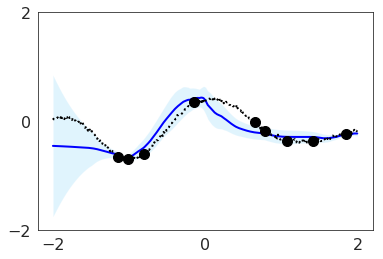

Test function: 3


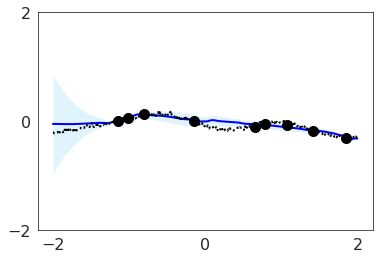

Iteration: 40000, train nll: -1.2960929870605469, mse: 0.028259029611945152, local kl: 0.0, global kl 0.0
Test function: 1


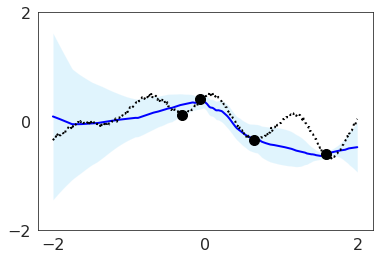

Test function: 2


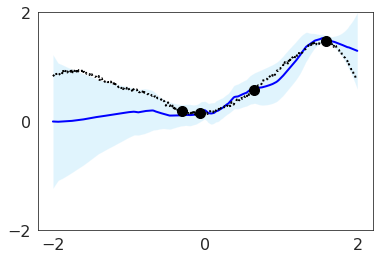

Test function: 3


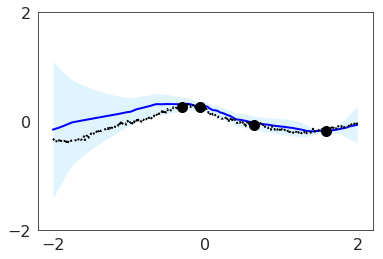

Iteration: 50000, train nll: -0.6397493481636047, mse: 0.09429769963026047, local kl: 0.0, global kl 0.0
Test function: 1


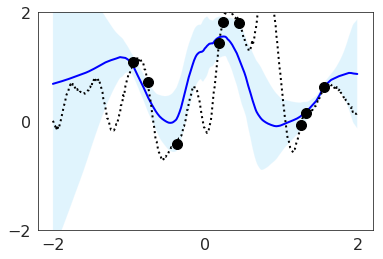

Test function: 2


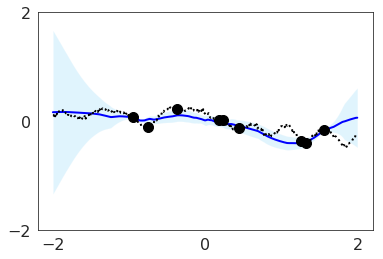

Test function: 3


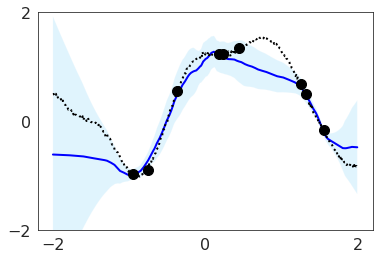

Iteration: 60000, train nll: -0.5311530828475952, mse: 0.12603949010372162, local kl: 0.0, global kl 0.00694363284856081
Test function: 1


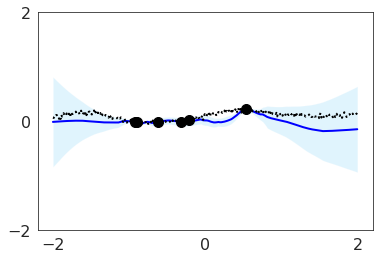

Test function: 2


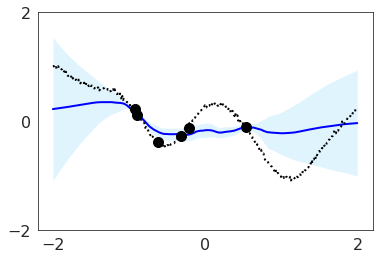

Test function: 3


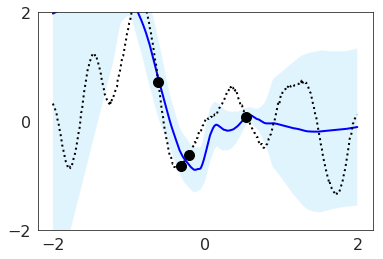

Iteration: 70000, train nll: -0.5111772418022156, mse: 0.09937413036823273, local kl: 0.0, global kl 0.004075462464243174
Test function: 1


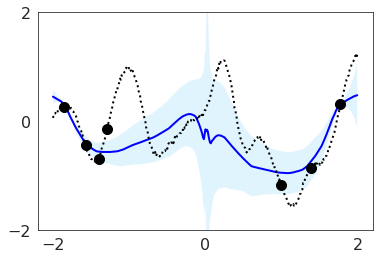

Test function: 2


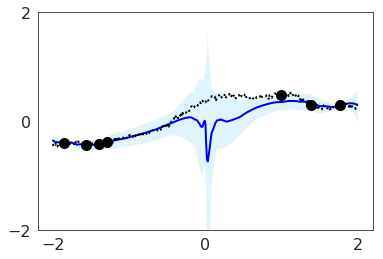

Test function: 3


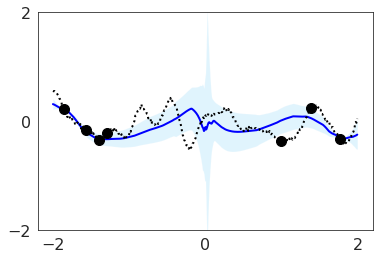

Iteration: 80000, train nll: -0.5882230401039124, mse: 0.08823195844888687, local kl: 0.0, global kl 0.005076416302472353
Test function: 1


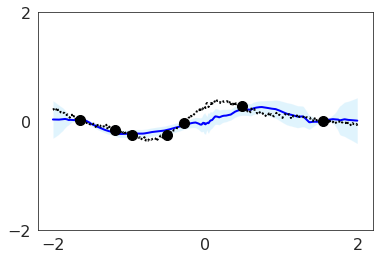

Test function: 2


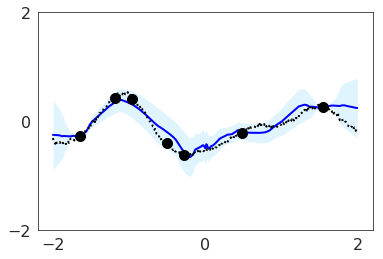

Test function: 3


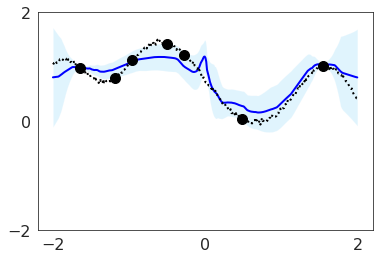

Iteration: 90000, train nll: -0.4122794270515442, mse: 0.17483435571193695, local kl: 0.0, global kl 0.013890113681554794
Saving model...
beta 1000.0 temperature 1.0
Test function: 1


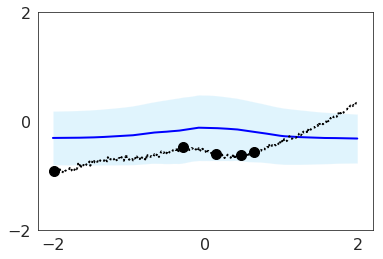

Test function: 2


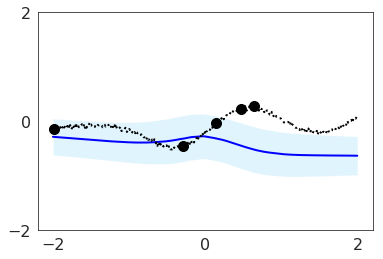

Test function: 3


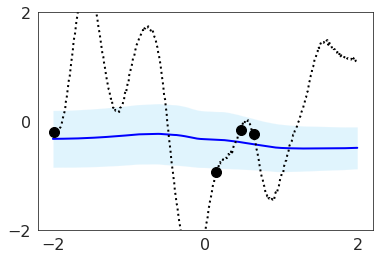

Iteration: 0, train nll: 1.4481416940689087, mse: 0.5400689840316772, local kl: 0.0, global kl 0.0
Test function: 1


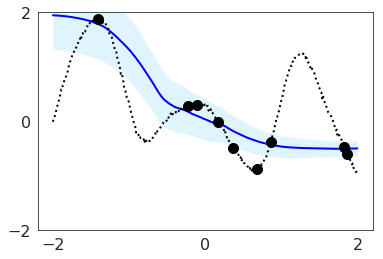

Test function: 2


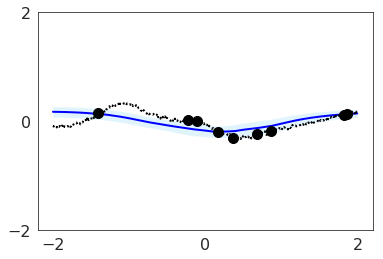

Test function: 3


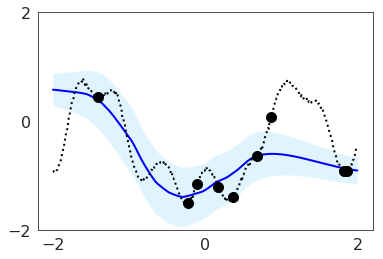

Iteration: 10000, train nll: 0.25477227568626404, mse: 0.14724084734916687, local kl: 0.0, global kl 0.01617632433772087
Test function: 1


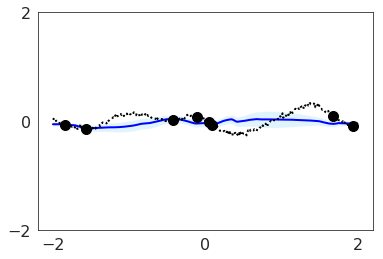

Test function: 2


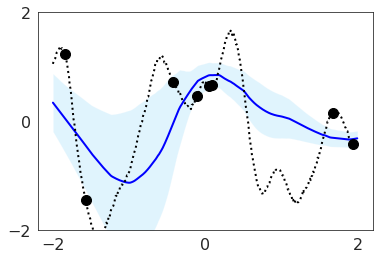

Test function: 3


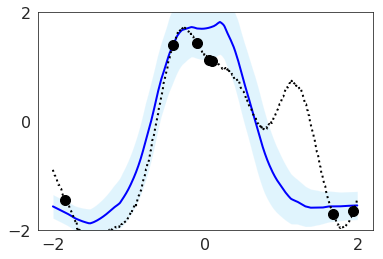

Iteration: 20000, train nll: -0.4192110300064087, mse: 0.052702274173498154, local kl: 0.0, global kl 0.0
Test function: 1


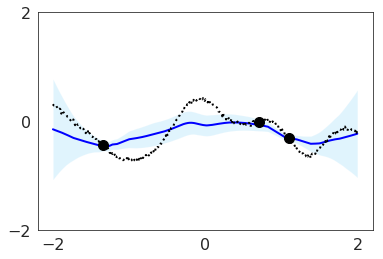

Test function: 2


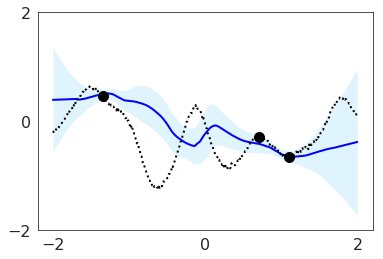

Test function: 3


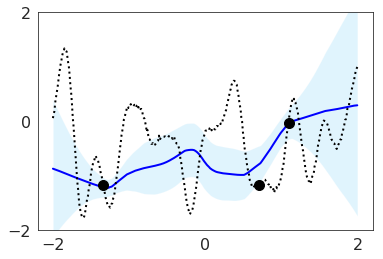

Iteration: 30000, train nll: -0.32891330122947693, mse: 0.08194590359926224, local kl: 0.0, global kl 0.011533207260072231
Test function: 1


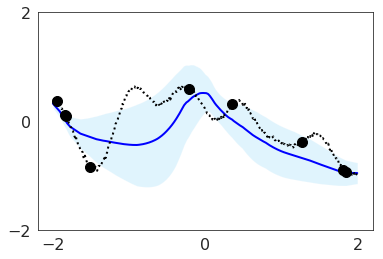

Test function: 2


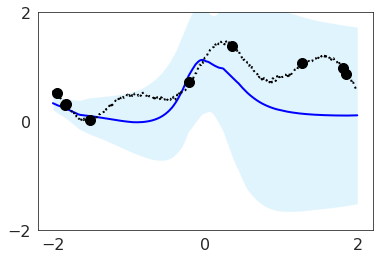

Test function: 3


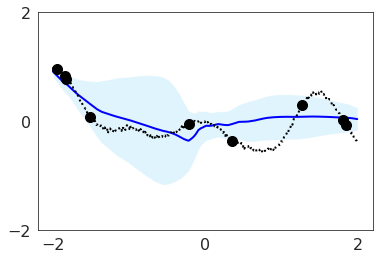

Iteration: 40000, train nll: 0.0038001779466867447, mse: 0.2460983842611313, local kl: 0.0, global kl 0.014885757118463516
Test function: 1


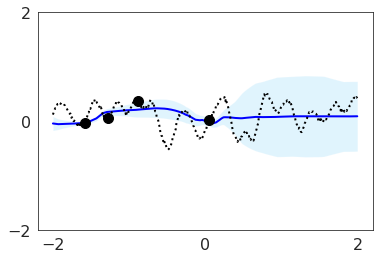

Test function: 2


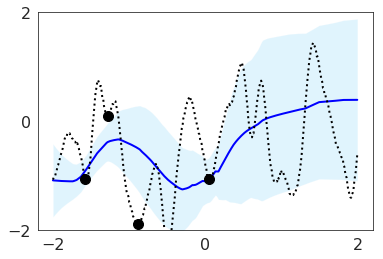

Test function: 3


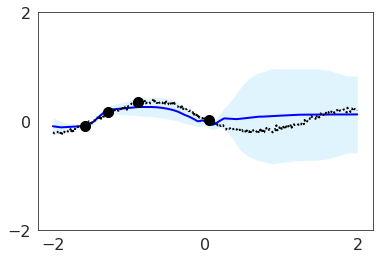

Iteration: 50000, train nll: -0.31774404644966125, mse: 0.10542969405651093, local kl: 0.0, global kl 0.013091247528791428
Test function: 1


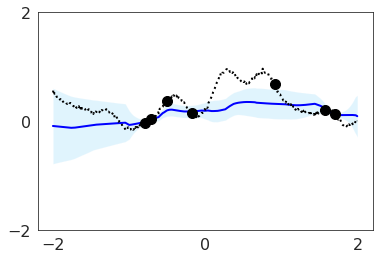

Test function: 2


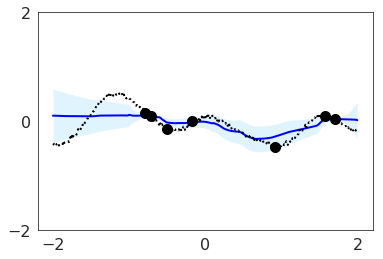

Test function: 3


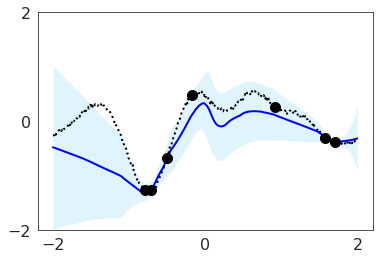

Iteration: 60000, train nll: -0.26913389563560486, mse: 0.12851837277412415, local kl: 0.0, global kl 0.004601753782480955
Test function: 1


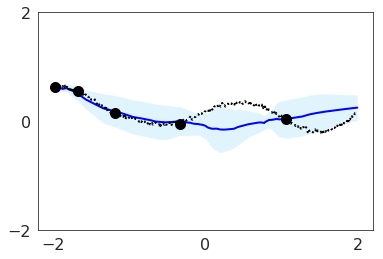

Test function: 2


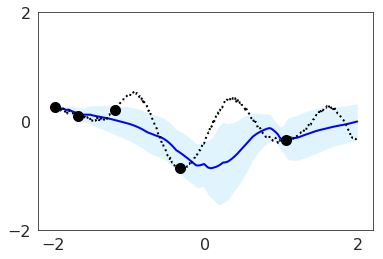

Test function: 3


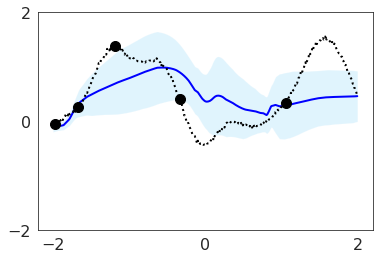

Iteration: 70000, train nll: -0.3053824007511139, mse: 0.07970573008060455, local kl: 0.0, global kl 0.0
Test function: 1


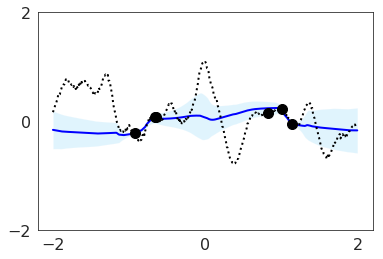

Test function: 2


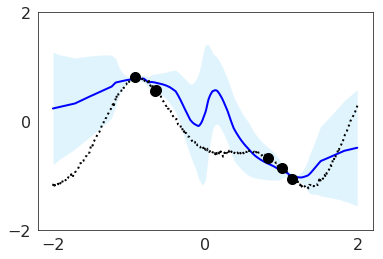

Test function: 3


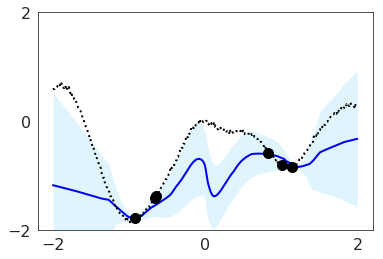

Iteration: 80000, train nll: -1.200730562210083, mse: 0.020961780101060867, local kl: 0.0, global kl 0.0
Test function: 1


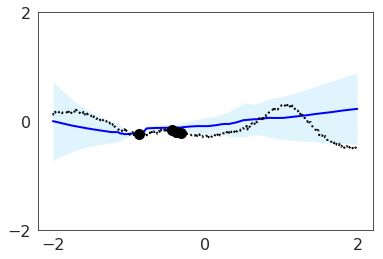

Test function: 2


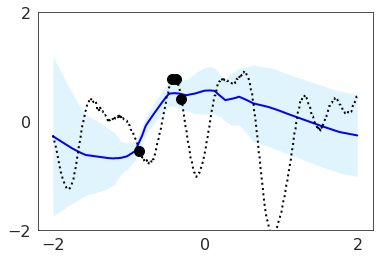

Test function: 3


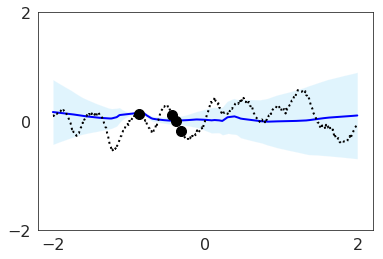

Iteration: 90000, train nll: -0.4606098532676697, mse: 0.13770218193531036, local kl: 0.0, global kl 0.003034074790775776
Saving model...
beta 1000.0 temperature 2.0
Test function: 1


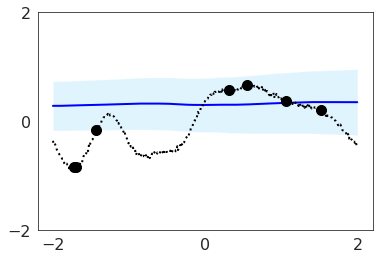

Test function: 2


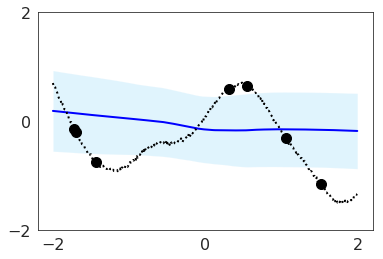

Test function: 3


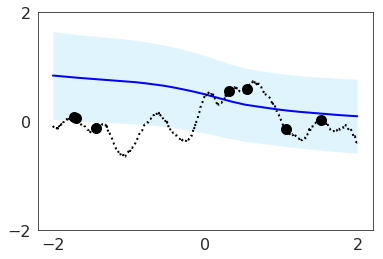

Iteration: 0, train nll: 1.0025864839553833, mse: 0.3837069272994995, local kl: 0.0, global kl 0.0
Test function: 1


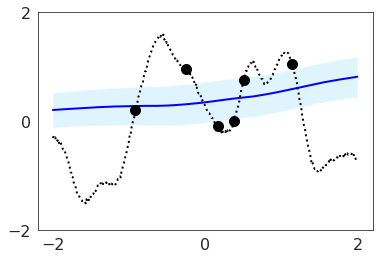

Test function: 2


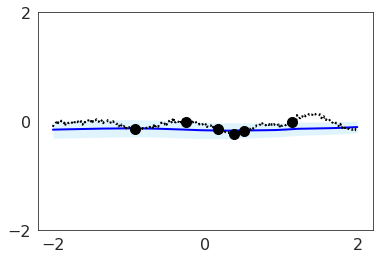

Test function: 3


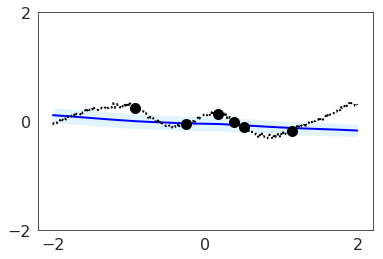

Iteration: 10000, train nll: -0.008089281618595123, mse: 0.1134694442152977, local kl: 0.0, global kl 0.0
Test function: 1


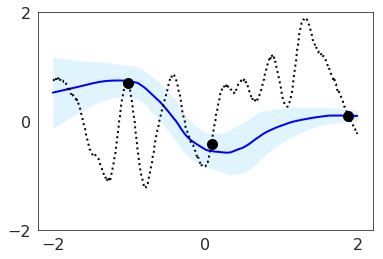

Test function: 2


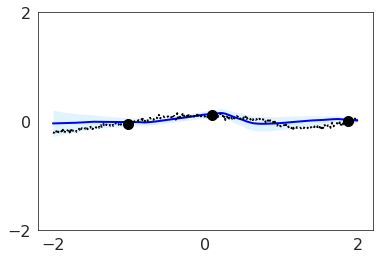

Test function: 3


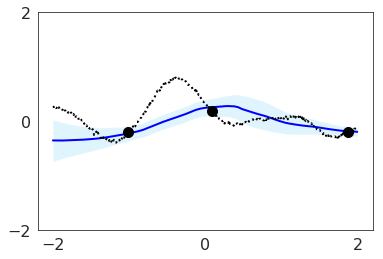

Iteration: 20000, train nll: 0.19339652359485626, mse: 0.1323351114988327, local kl: 0.0, global kl 0.007189313415437937
Test function: 1


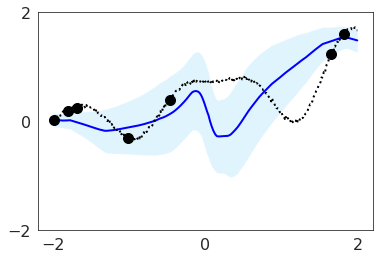

Test function: 2


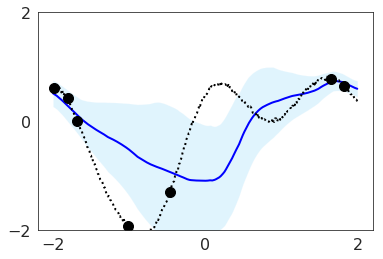

Test function: 3


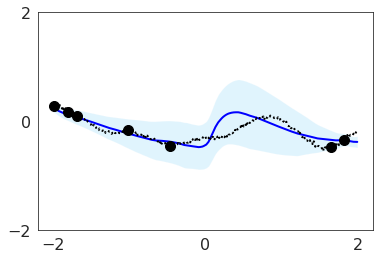

Iteration: 30000, train nll: -0.054950520396232605, mse: 0.11172222346067429, local kl: 0.0, global kl 0.008154664188623428
Test function: 1


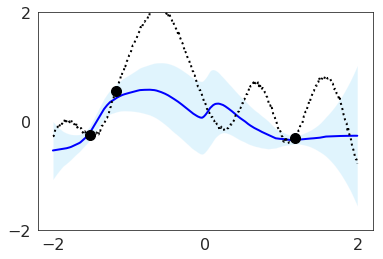

Test function: 2


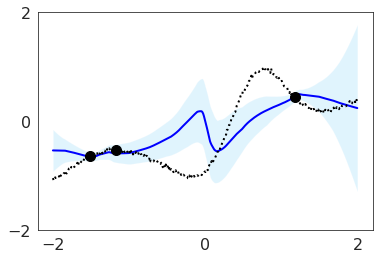

Test function: 3


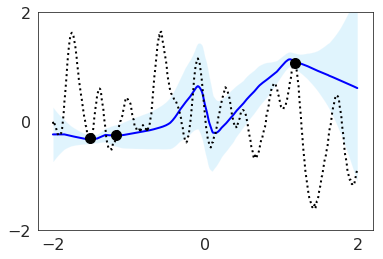

Iteration: 40000, train nll: -0.4400738477706909, mse: 0.0623774491250515, local kl: 0.0, global kl 0.0013556655030697584
Test function: 1


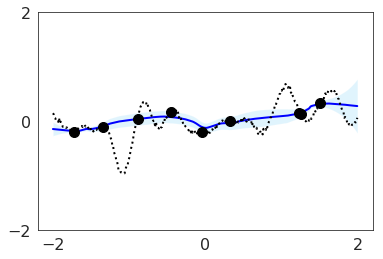

Test function: 2


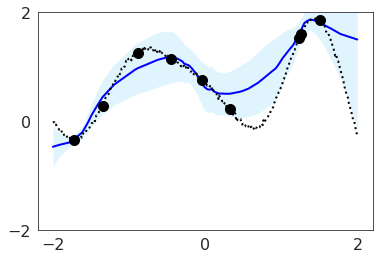

Test function: 3


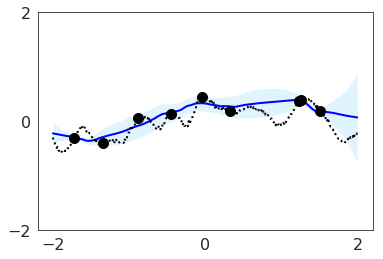

Iteration: 50000, train nll: -0.4977867007255554, mse: 0.06678235530853271, local kl: 0.0, global kl 0.0026883739046752453
Test function: 1


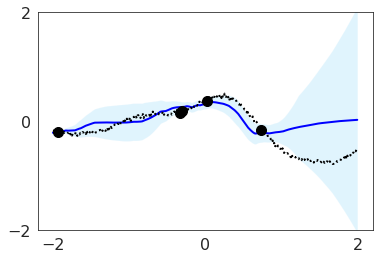

Test function: 2


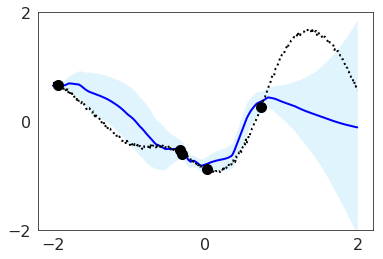

Test function: 3


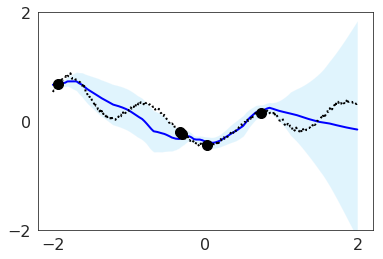

Iteration: 60000, train nll: -0.471694678068161, mse: 0.0836670771241188, local kl: 0.0, global kl 0.002545025432482362
Test function: 1


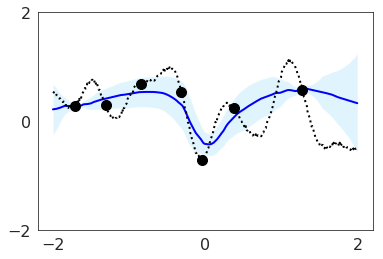

Test function: 2


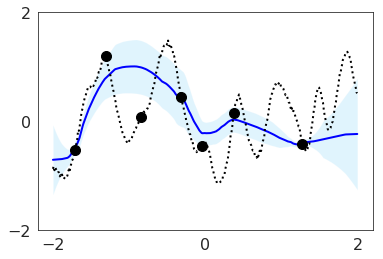

Test function: 3


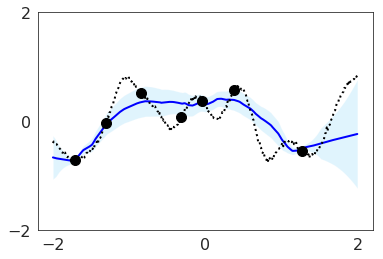

Iteration: 70000, train nll: -0.6723820567131042, mse: 0.07814662158489227, local kl: 0.0, global kl 0.0014491707552224398
Test function: 1


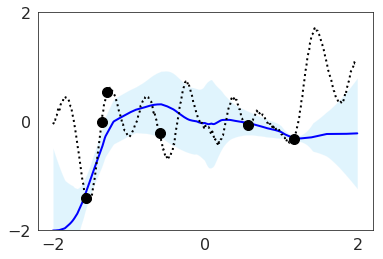

Test function: 2


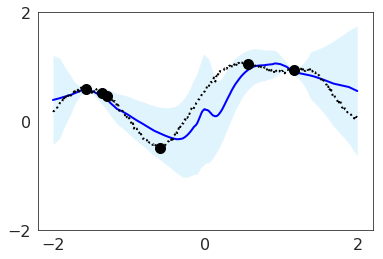

Test function: 3


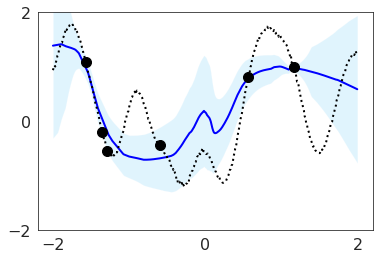

Iteration: 80000, train nll: -0.41459619998931885, mse: 0.08544552326202393, local kl: 0.0, global kl 0.002036132849752903
Test function: 1


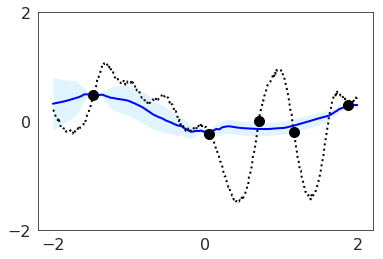

Test function: 2


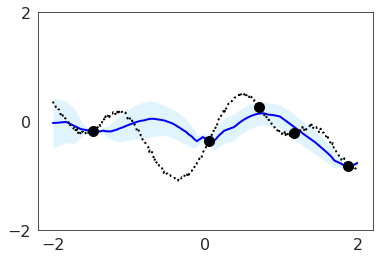

Test function: 3


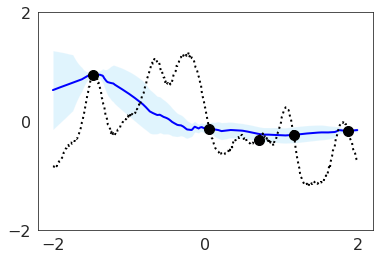

Iteration: 90000, train nll: -0.24317438900470734, mse: 0.14366935193538666, local kl: 0.0, global kl 0.0057847825810313225
Saving model...
beta 1000.0 temperature 5.0
Test function: 1


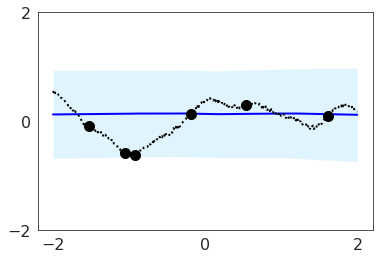

Test function: 2


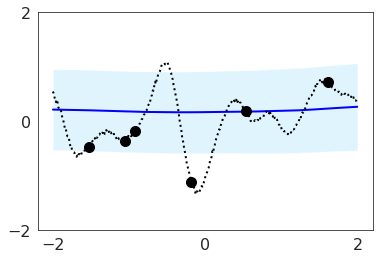

Test function: 3


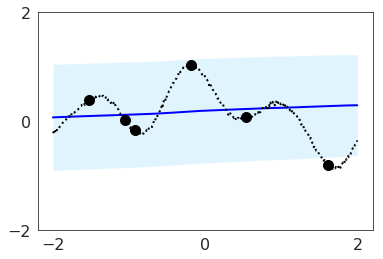

Iteration: 0, train nll: 1.1654086112976074, mse: 0.5471996068954468, local kl: 0.0, global kl 8.025385856628418
Test function: 1


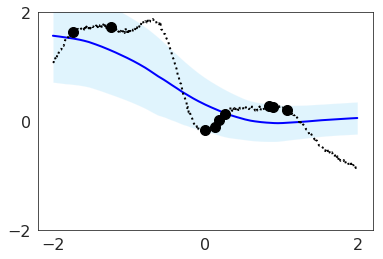

Test function: 2


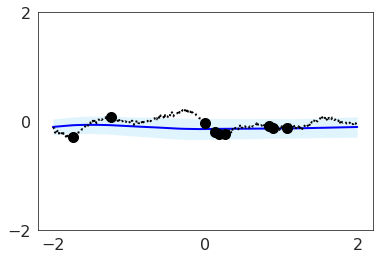

Test function: 3


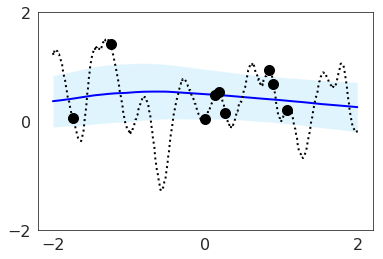

Iteration: 10000, train nll: 0.09235683083534241, mse: 0.11891242861747742, local kl: 0.0, global kl 0.0
Test function: 1


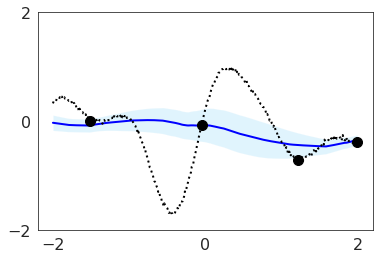

Test function: 2


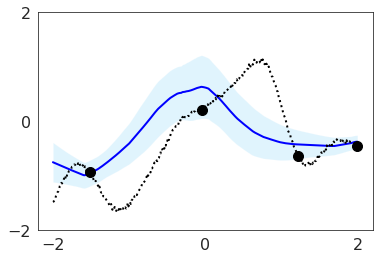

Test function: 3


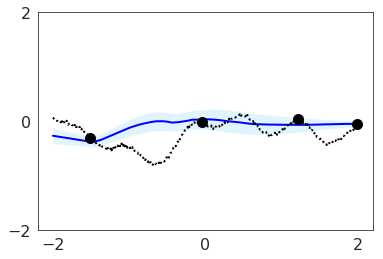

Iteration: 20000, train nll: -0.11987842619419098, mse: 0.10798779129981995, local kl: 0.0, global kl 0.0019524195231497288
Test function: 1


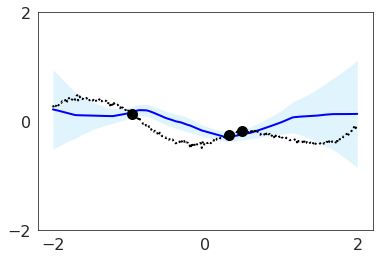

Test function: 2


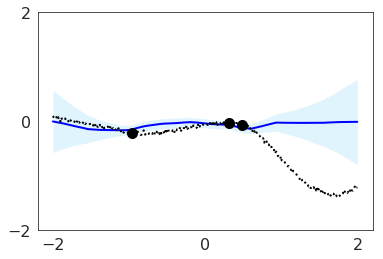

Test function: 3


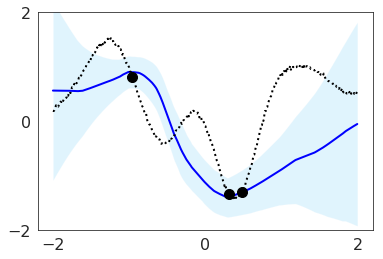

Iteration: 30000, train nll: -0.7050904035568237, mse: 0.0445898100733757, local kl: 0.0, global kl 0.0
Test function: 1


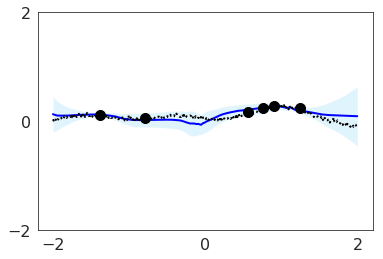

Test function: 2


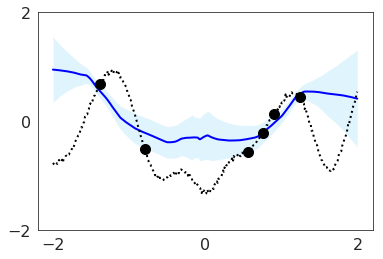

Test function: 3


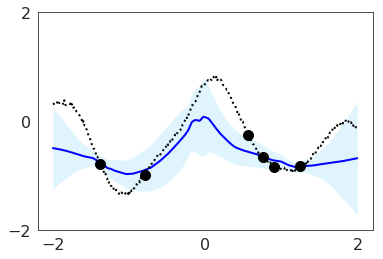

Iteration: 40000, train nll: -0.6170761585235596, mse: 0.059089720249176025, local kl: 0.0, global kl 0.0014197604032233357
Test function: 1


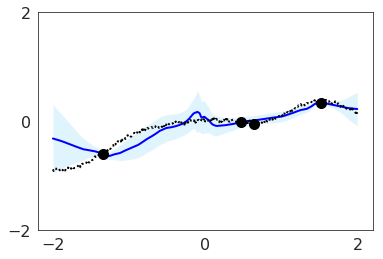

Test function: 2


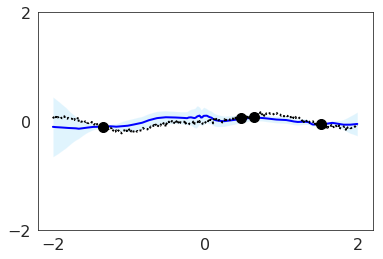

Test function: 3


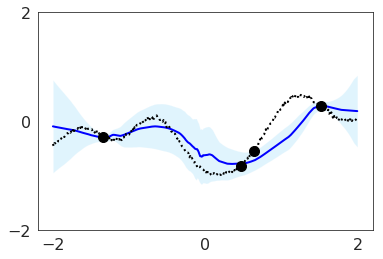

Iteration: 50000, train nll: -0.5623403787612915, mse: 0.10489886999130249, local kl: 0.0, global kl 0.003551097586750984
Test function: 1


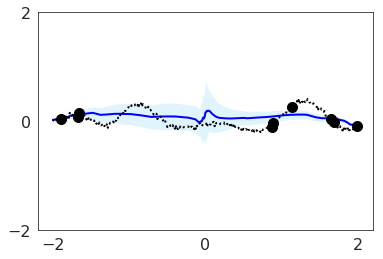

Test function: 2


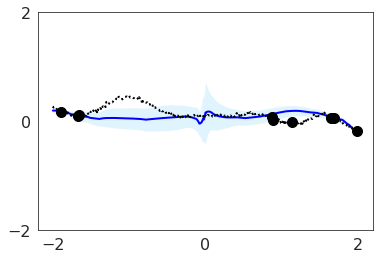

Test function: 3


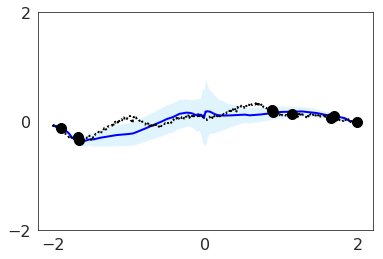

Iteration: 60000, train nll: -1.132491946220398, mse: 0.03069319762289524, local kl: 0.0, global kl 0.0
Test function: 1


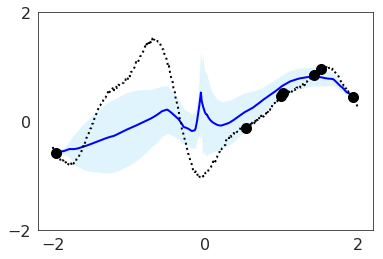

Test function: 2


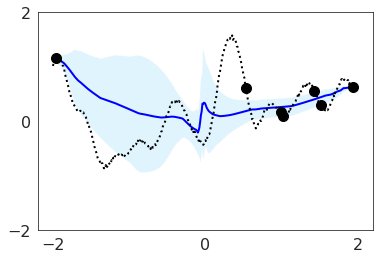

Test function: 3


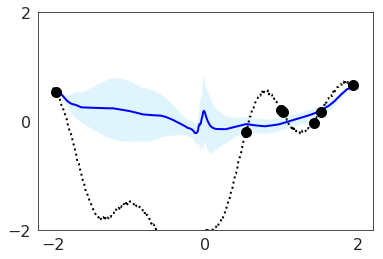

Iteration: 70000, train nll: -0.8373213410377502, mse: 0.045697495341300964, local kl: 0.0, global kl 0.0
Test function: 1


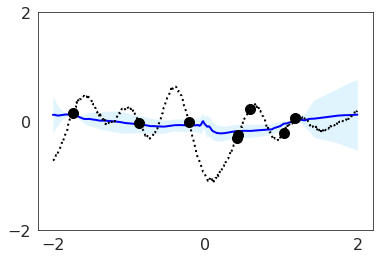

Test function: 2


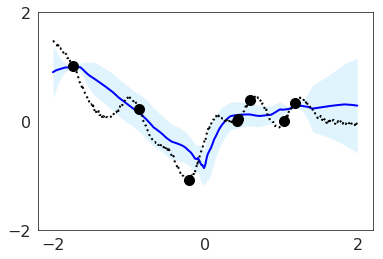

Test function: 3


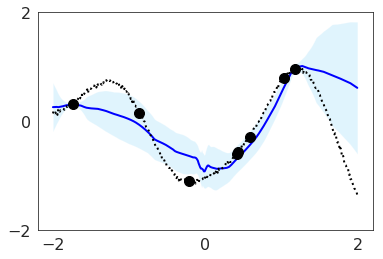

Iteration: 80000, train nll: -0.12459786981344223, mse: 0.18161503970623016, local kl: 0.0, global kl 0.011392923071980476
Test function: 1


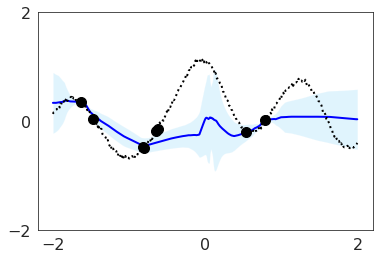

Test function: 2


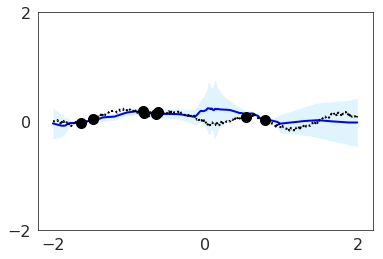

Test function: 3


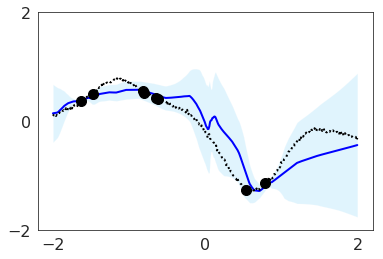

Iteration: 90000, train nll: -0.4125693440437317, mse: 0.09616950154304504, local kl: 0.0, global kl 0.0012126524234190583
Saving model...
beta 1000.0 temperature 1000.0
Test function: 1


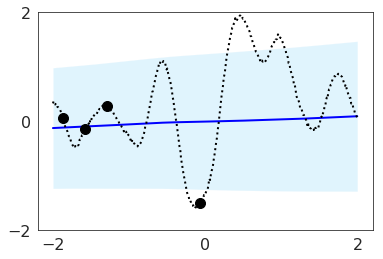

Test function: 2


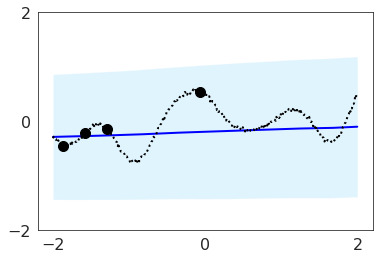

Test function: 3


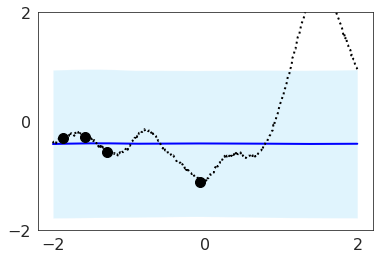

Iteration: 0, train nll: 1.2020294666290283, mse: 0.5542229413986206, local kl: 0.0, global kl 3.4936814308166504
Test function: 1


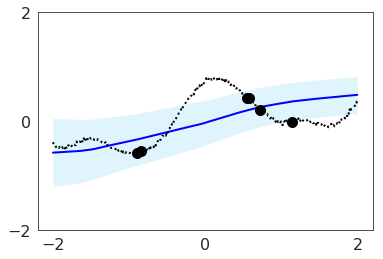

Test function: 2


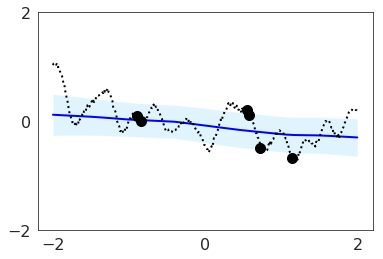

Test function: 3


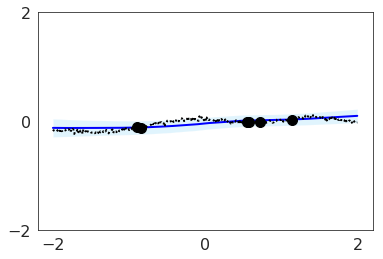

Iteration: 10000, train nll: 0.3249781131744385, mse: 0.2170124053955078, local kl: 0.0, global kl 0.0013618514640256763
Test function: 1


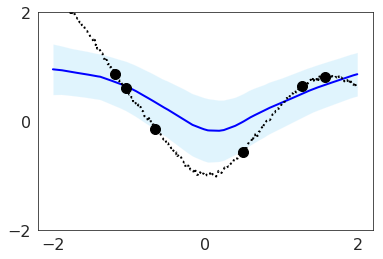

Test function: 2


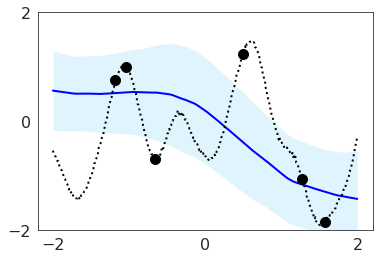

Test function: 3


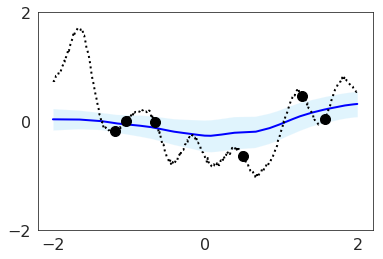

Iteration: 20000, train nll: 0.05196161940693855, mse: 0.1551603525876999, local kl: 0.0, global kl 0.001793240080587566
Test function: 1


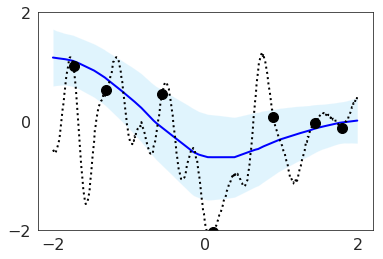

Test function: 2


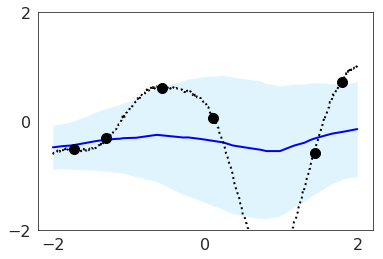

Test function: 3


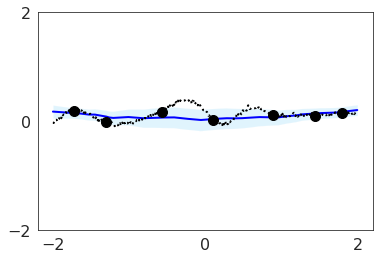

Iteration: 30000, train nll: 0.21802274882793427, mse: 0.1422731876373291, local kl: 0.0, global kl 0.012331075966358185
Test function: 1


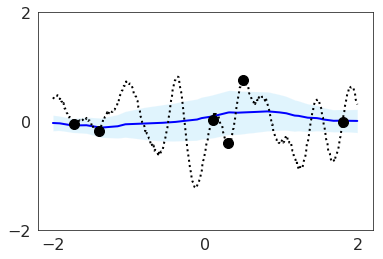

Test function: 2


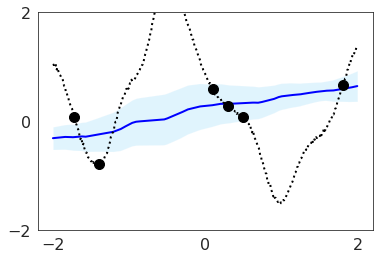

Test function: 3


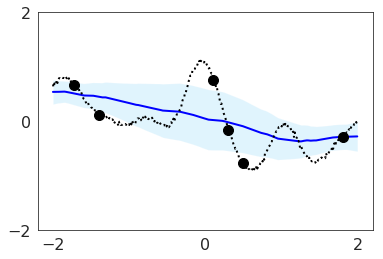

Iteration: 40000, train nll: -0.2755568325519562, mse: 0.08428730070590973, local kl: 0.0, global kl 0.0008741996134631336
Test function: 1


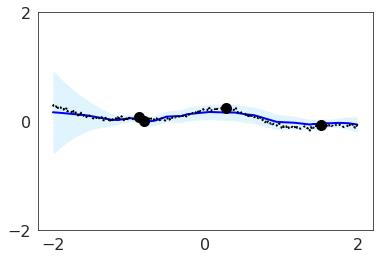

Test function: 2


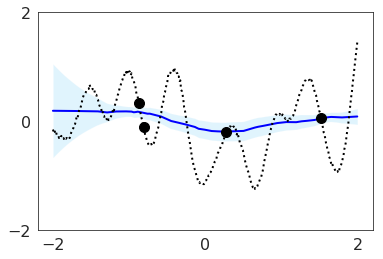

Test function: 3


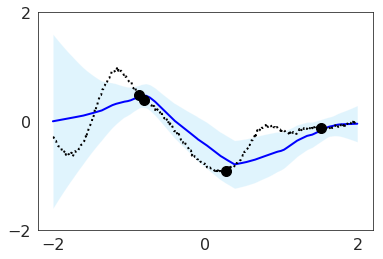

Iteration: 50000, train nll: 0.3156110942363739, mse: 0.1932133287191391, local kl: 0.0, global kl 0.005872389301657677
Test function: 1


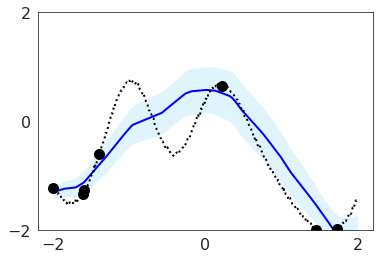

Test function: 2


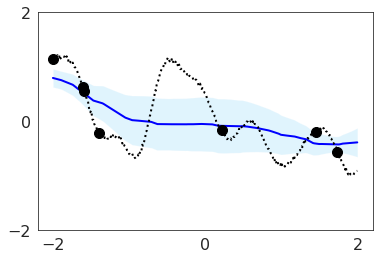

Test function: 3


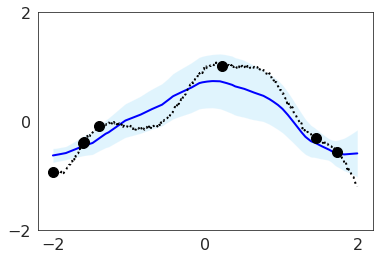

Iteration: 60000, train nll: -0.33655020594596863, mse: 0.08099144697189331, local kl: 0.0, global kl 0.0005489093018695712
Test function: 1


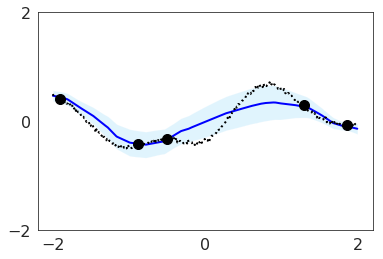

Test function: 2


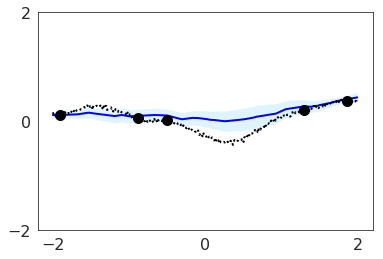

Test function: 3


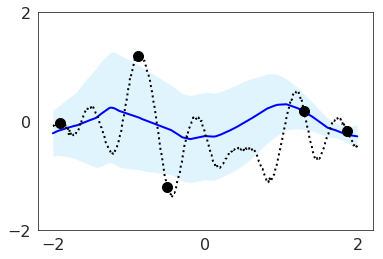

Iteration: 70000, train nll: 0.22609414160251617, mse: 0.15663811564445496, local kl: 0.0, global kl 0.005478475242853165
Test function: 1


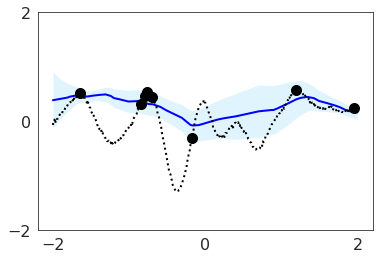

Test function: 2


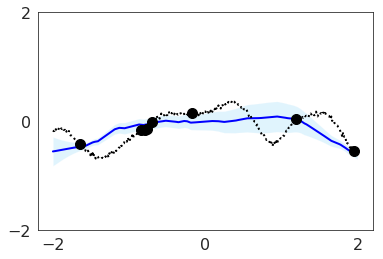

Test function: 3


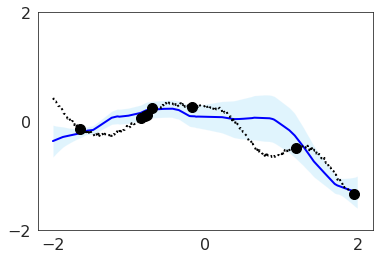

Iteration: 80000, train nll: -0.1270413100719452, mse: 0.11848574131727219, local kl: 0.0, global kl 0.0023347465321421623
Test function: 1


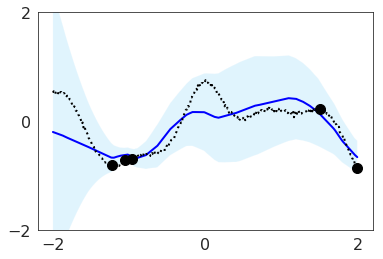

Test function: 2


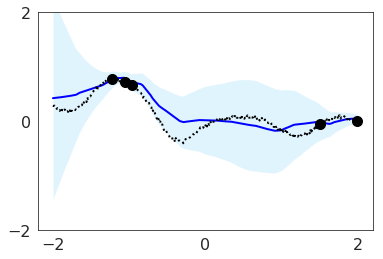

Test function: 3


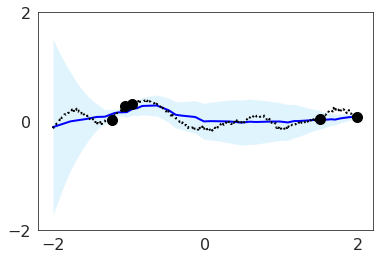

Iteration: 90000, train nll: 0.25133785605430603, mse: 0.13776427507400513, local kl: 0.0, global kl 0.0029317447915673256
Saving model...


In [0]:
for beta, temp in itertools.product(betas, temps):
  print('beta', beta, 'temperature', temp, flush=True)
  model = generalized_neural_process.Regressor(input_dim=input_dim,
                                              output_dim=output_dim,
                                              x_encoder_net_sizes=x_encoder_net_sizes,
                                              x_y_encoder_net_sizes=x_y_encoder_net_sizes,
                                              heteroskedastic_net_sizes=heteroskedastic_net_sizes,
                                              global_latent_net_sizes=global_latent_net_sizes,
                                              local_latent_net_sizes=local_latent_net_sizes,
                                              decoder_net_sizes=decoder_net_sizes,
                                              att_type=att_type,
                                              att_heads=att_heads,
                                              model_type=model_type,
                                              data_uncertainty=data_uncertainty,
                                              beta=beta,
                                              temperature=temp)

  training_loop(model,
                dataset_train,
                optimizer=optimizer,
                learning_rate=learning_rate,
                savepath=savepath)

# CNP

('Test function:', 1)


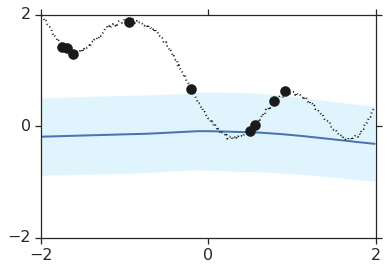

('Test function:', 2)


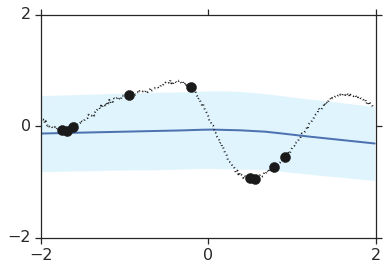

('Test function:', 3)


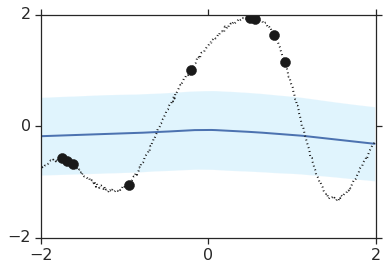

Iteration: 0, train nll: 1.02909708023, mse: 0.456724703312, local kl: 0.0, global kl 0.0
('Test function:', 1)


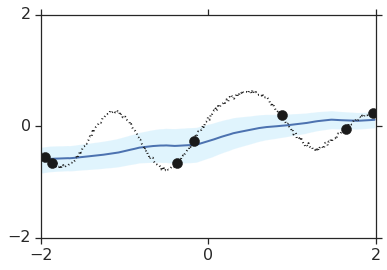

('Test function:', 2)


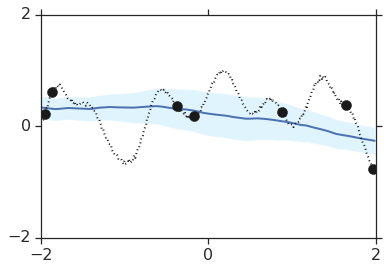

('Test function:', 3)


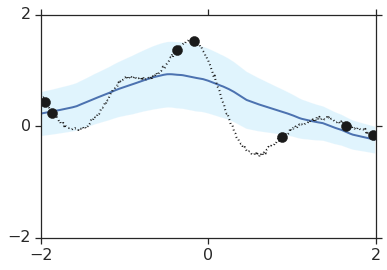

Iteration: 10000, train nll: 0.0541757717729, mse: 0.129633963108, local kl: 0.0, global kl 0.0
('Test function:', 1)


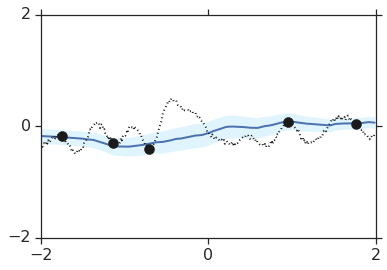

('Test function:', 2)


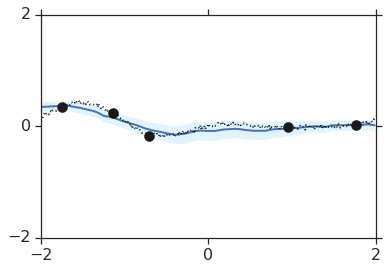

('Test function:', 3)


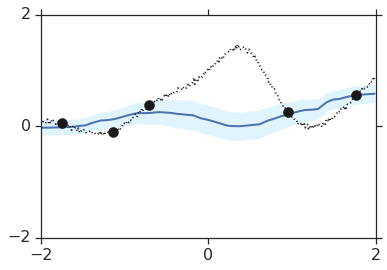

Iteration: 20000, train nll: -0.250882595778, mse: 0.0593498013914, local kl: 0.0, global kl 0.0
('Test function:', 1)


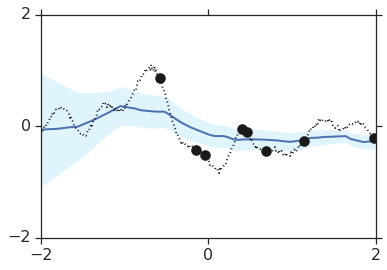

('Test function:', 2)


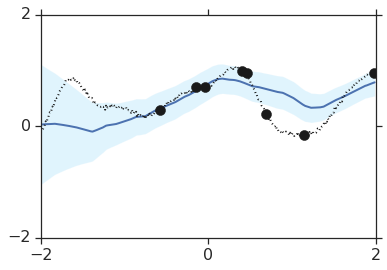

('Test function:', 3)


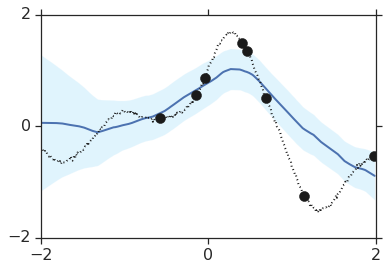

Iteration: 30000, train nll: -0.291861236095, mse: 0.0602967217565, local kl: 0.0, global kl 0.0
('Test function:', 1)


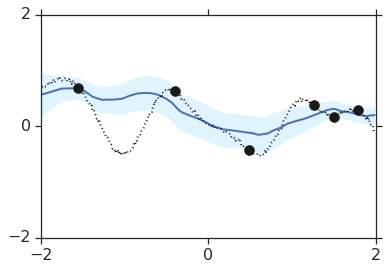

('Test function:', 2)


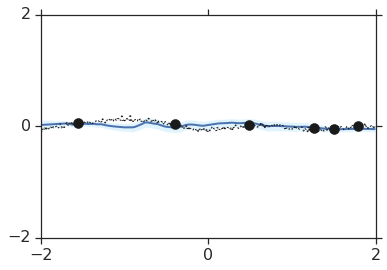

('Test function:', 3)


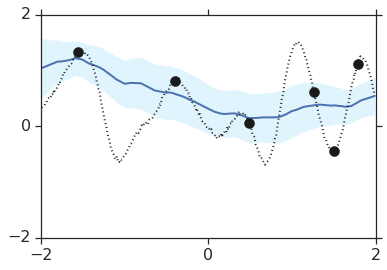

Iteration: 40000, train nll: 0.327156960964, mse: 0.151362225413, local kl: 0.0, global kl 0.0
('Test function:', 1)


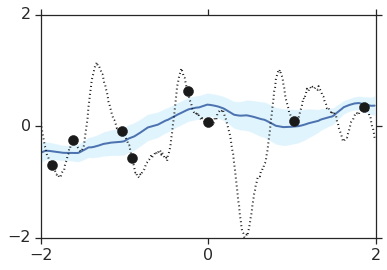

('Test function:', 2)


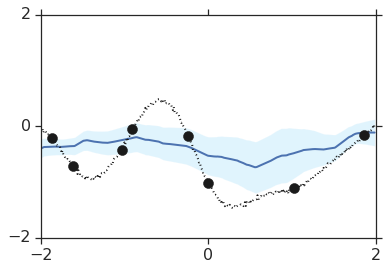

('Test function:', 3)


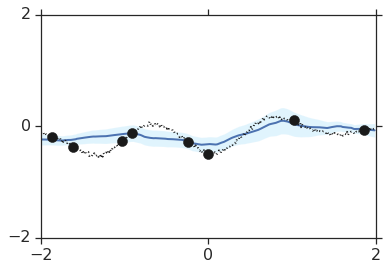

Iteration: 50000, train nll: -0.598948597908, mse: 0.0259270276874, local kl: 0.0, global kl 0.0
('Test function:', 1)


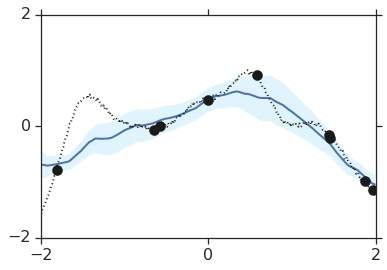

('Test function:', 2)


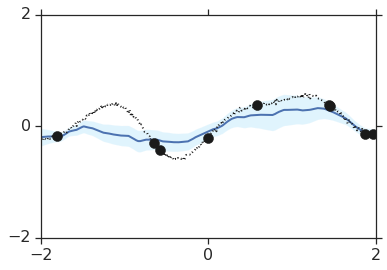

('Test function:', 3)


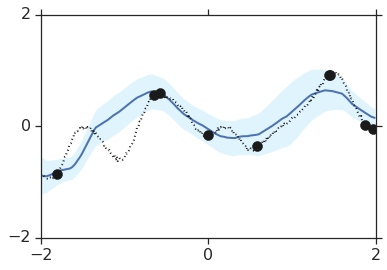

Iteration: 60000, train nll: -0.167687788606, mse: 0.0906064808369, local kl: 0.0, global kl 0.0
('Test function:', 1)


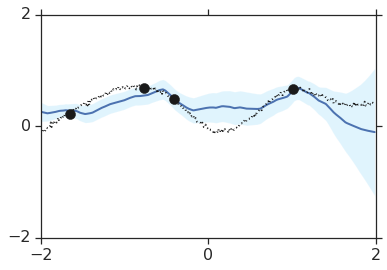

('Test function:', 2)


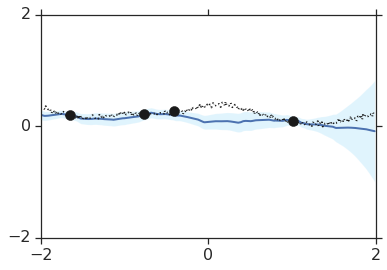

('Test function:', 3)


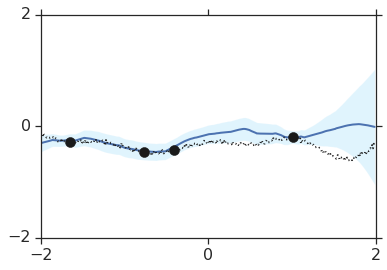

Iteration: 70000, train nll: 0.0941751599312, mse: 0.158162906766, local kl: 0.0, global kl 0.0
('Test function:', 1)


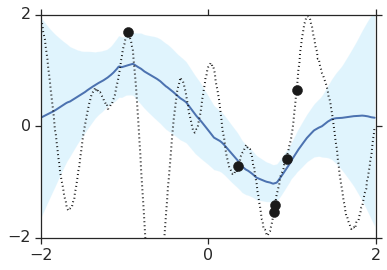

('Test function:', 2)


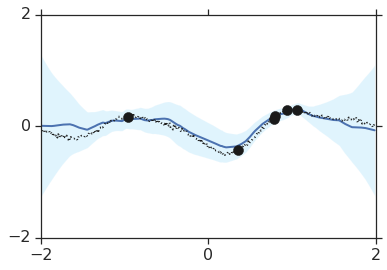

('Test function:', 3)


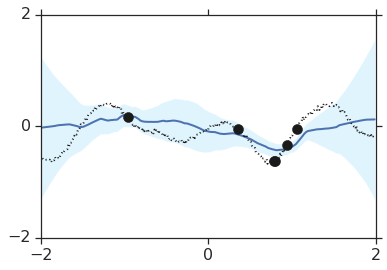

Iteration: 80000, train nll: -0.459115624428, mse: 0.0543706007302, local kl: 0.0, global kl 0.0
('Test function:', 1)


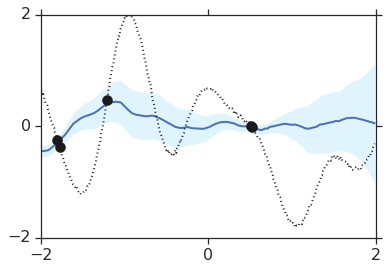

('Test function:', 2)


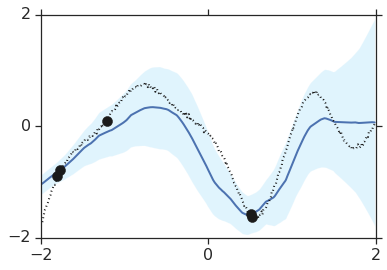

('Test function:', 3)


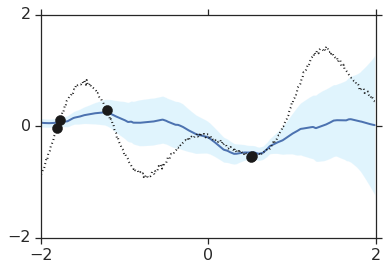

Iteration: 90000, train nll: 0.24279730022, mse: 0.172627523541, local kl: 0.0, global kl 0.0


NameError: ignored

In [0]:
global_latent_net_sizes = None
local_latent_net_sizes = None
decoder_net_sizes = [HIDDEN_SIZE]*2 + [2]
model_type = 'cnp'
model = generalized_neural_process.Regressor(input_dim=input_dim,
                                             output_dim=output_dim,
                                             x_encoder_net_sizes=x_encoder_net_sizes,
                                             x_y_encoder_net_sizes=x_y_encoder_net_sizes,
                                             heteroskedastic_net_sizes=heteroskedastic_net_sizes,
                                             global_latent_net_sizes=global_latent_net_sizes,
                                             local_latent_net_sizes=local_latent_net_sizes,
                                             decoder_net_sizes=decoder_net_sizes,
                                             att_type=att_type,
                                             att_heads=att_heads,
                                             model_type=model_type,
                                             data_uncertainty=data_uncertainty)

optimizer = tf.keras.optimizers.Adam
learning_rate = 1e-4
training_loop(model,
              dataset_train,
              optimizer=optimizer,
              learning_rate=learning_rate,
              savepath=savepath)

Test function: 1


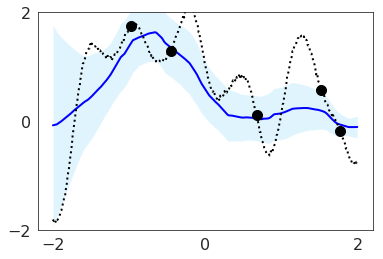

Test function: 2


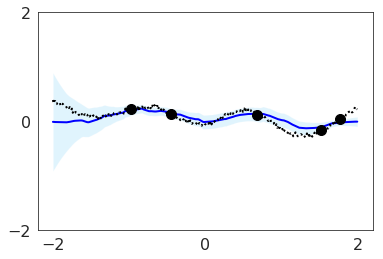

Test function: 3


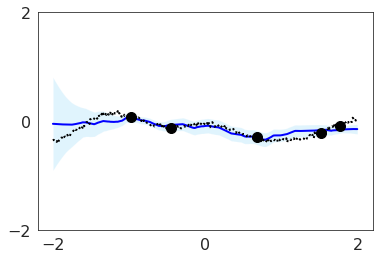

In [0]:
global_latent_net_sizes = None
local_latent_net_sizes = None
decoder_net_sizes = [HIDDEN_SIZE]*2 + [2]
model_type = 'cnp'
cnp_model = generalized_neural_process.Regressor(input_dim=input_dim,
                                             output_dim=output_dim,
                                             x_encoder_net_sizes=x_encoder_net_sizes,
                                             x_y_encoder_net_sizes=x_y_encoder_net_sizes,
                                             heteroskedastic_net_sizes=heteroskedastic_net_sizes,
                                             global_latent_net_sizes=global_latent_net_sizes,
                                             local_latent_net_sizes=local_latent_net_sizes,
                                             decoder_net_sizes=decoder_net_sizes,
                                             att_type=att_type,
                                             att_heads=att_heads,
                                             model_type=model_type,
                                             data_uncertainty=data_uncertainty)
cnp_model.load_weights(os.path.join(savepath, cnp_model.model_type + '_test.ckpt'))
data_test = dataset_test.generate_curves(num_context=test_context_size)
test_prediction = cnp_model(
    data_test.context_x, 
    data_test.context_y, 
    data_test.target_x)
display_plots(cnp_model, data_test, test_prediction)

# NP

Test function: 1


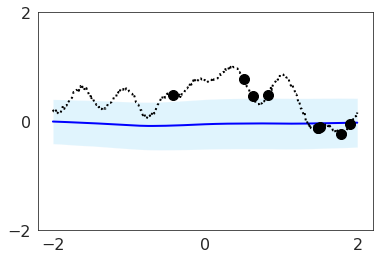

Test function: 2


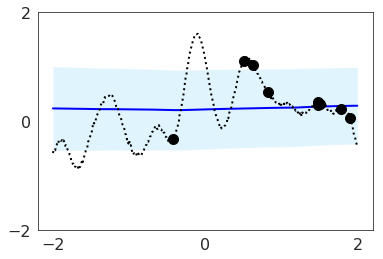

Test function: 3


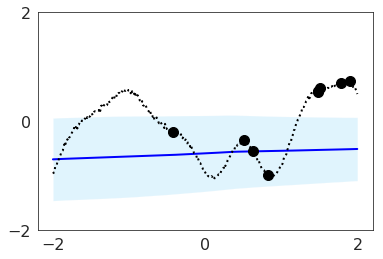

Iteration: 0, train nll: 1.0465874671936035, mse: 0.408805787563324, local kl: 0.0, global kl 0.0025026551447808743
Test function: 1


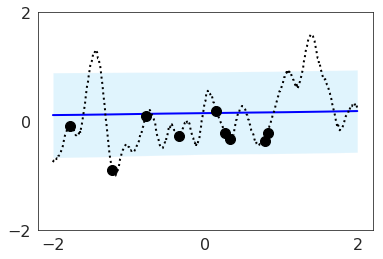

Test function: 2


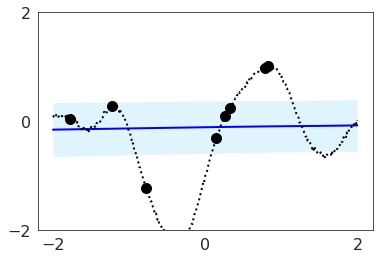

Test function: 3


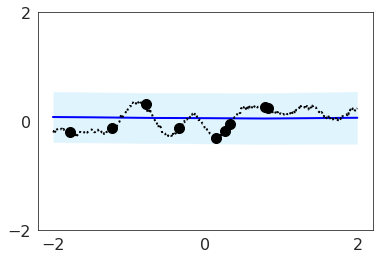

Iteration: 10000, train nll: 0.7964856624603271, mse: 0.44593948125839233, local kl: 0.0, global kl 0.0
Test function: 1


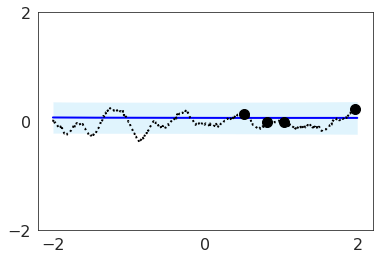

Test function: 2


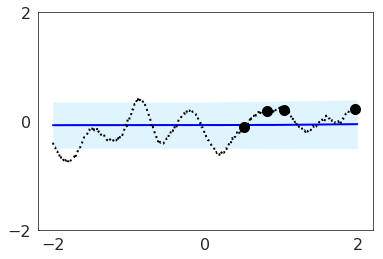

Test function: 3


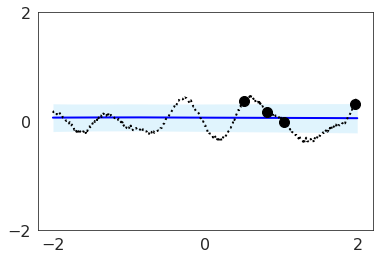

Iteration: 20000, train nll: 0.6953341364860535, mse: 0.34375134110450745, local kl: 0.0, global kl 0.0
Test function: 1


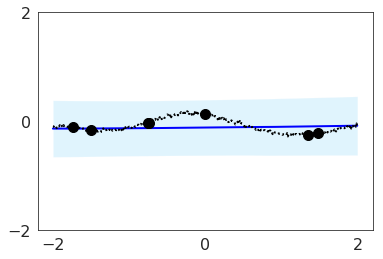

Test function: 2


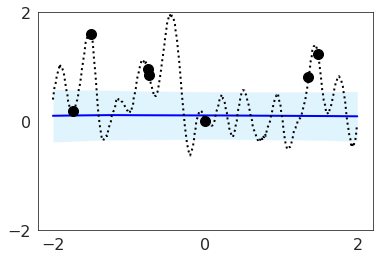

Test function: 3


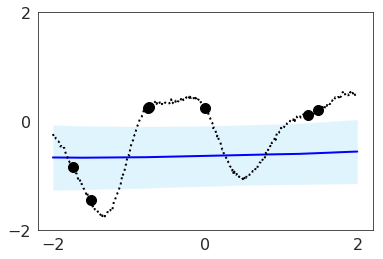

Iteration: 30000, train nll: 0.6510072350502014, mse: 0.32821011543273926, local kl: 0.0, global kl 0.1883632391691208
Test function: 1


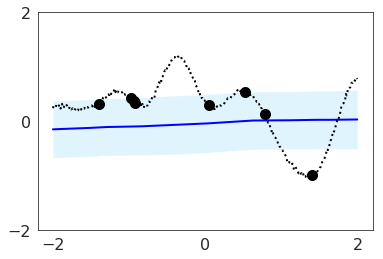

Test function: 2


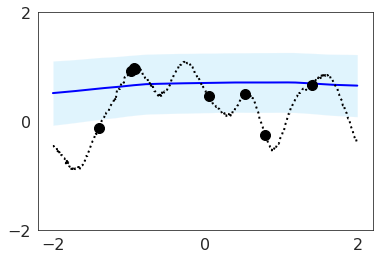

Test function: 3


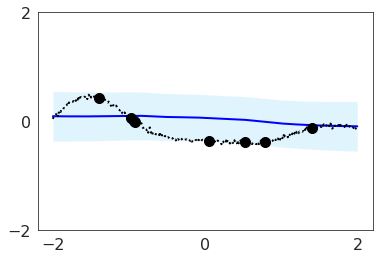

Iteration: 40000, train nll: 0.6111903190612793, mse: 0.2814881205558777, local kl: 0.0, global kl 0.028784986585378647
Test function: 1


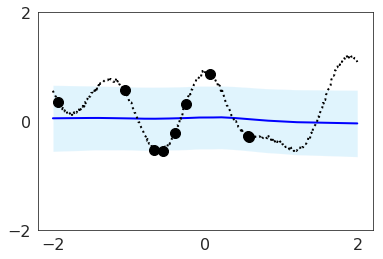

Test function: 2


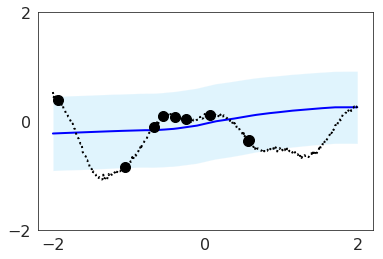

Test function: 3


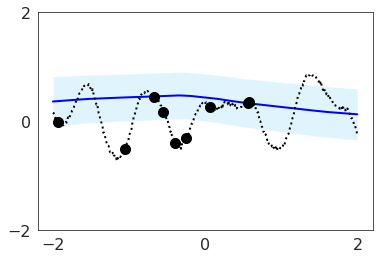

Iteration: 50000, train nll: 0.5478995442390442, mse: 0.22078470885753632, local kl: 0.0, global kl 0.0
Test function: 1


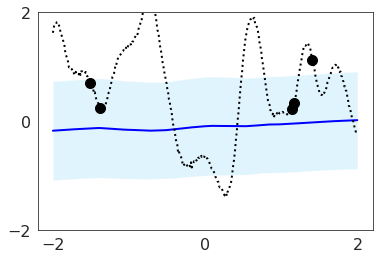

Test function: 2


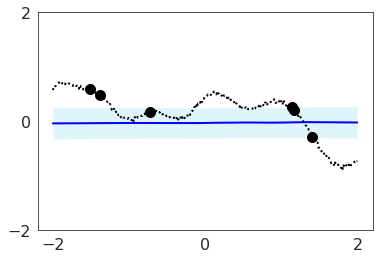

Test function: 3


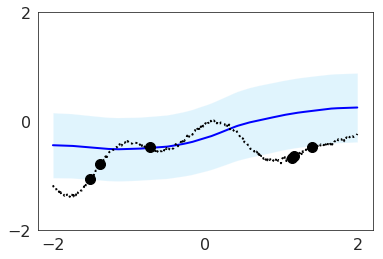

Iteration: 60000, train nll: 0.6286953091621399, mse: 0.2878704071044922, local kl: 0.0, global kl 0.0
Test function: 1


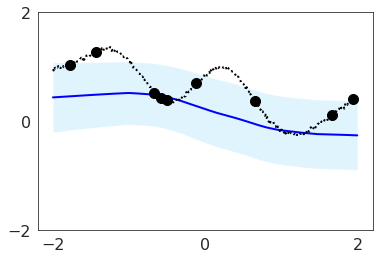

Test function: 2


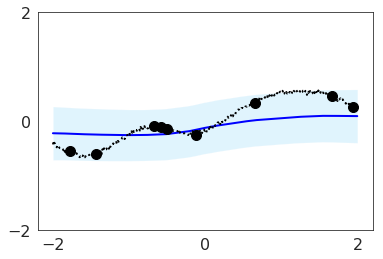

Test function: 3


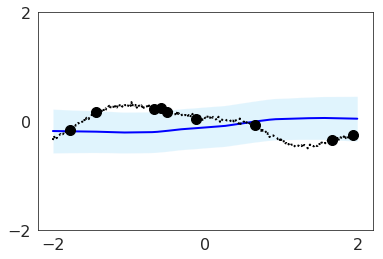

Iteration: 70000, train nll: 0.48370909690856934, mse: 0.20047783851623535, local kl: 0.0, global kl 0.3787853419780731
Test function: 1


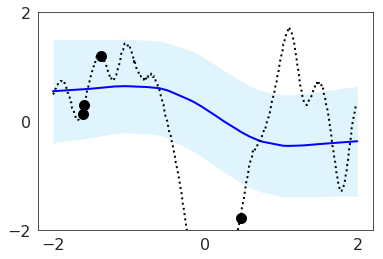

Test function: 2


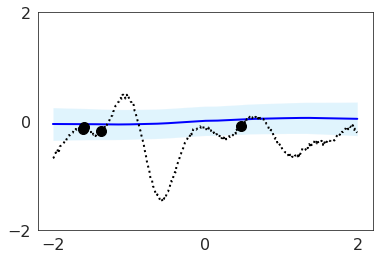

Test function: 3


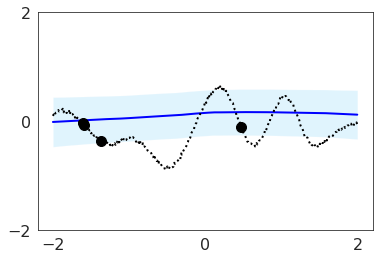

Iteration: 80000, train nll: 0.7269070148468018, mse: 0.32268592715263367, local kl: 0.0, global kl 0.0
Test function: 1


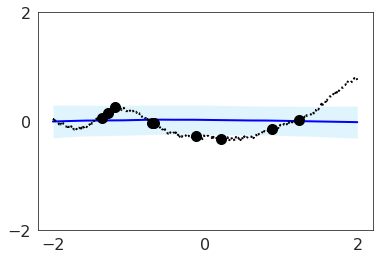

Test function: 2


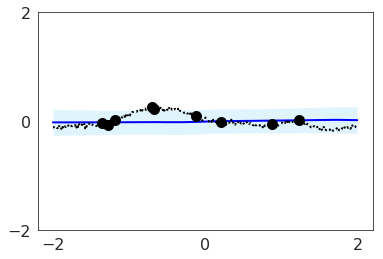

Test function: 3


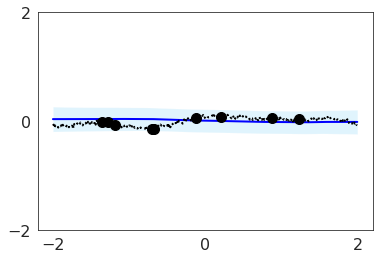

Iteration: 90000, train nll: 0.5519002079963684, mse: 0.2033129632472992, local kl: 0.0, global kl 0.02257264405488968


In [0]:
global_latent_net_sizes = [HIDDEN_SIZE]
local_latent_net_sizes = None
decoder_net_sizes = [HIDDEN_SIZE]*2 + [2]
model_type = 'np'
model = generalized_neural_process.Regressor(input_dim=input_dim,
                                             output_dim=output_dim,
                                             x_encoder_net_sizes=x_encoder_net_sizes,
                                             x_y_encoder_net_sizes=x_y_encoder_net_sizes,
                                             heteroskedastic_net_sizes=heteroskedastic_net_sizes,
                                             global_latent_net_sizes=global_latent_net_sizes,
                                             local_latent_net_sizes=local_latent_net_sizes,
                                             decoder_net_sizes=decoder_net_sizes,
                                             att_type=att_type,
                                             att_heads=att_heads,
                                             model_type=model_type,
                                             data_uncertainty=data_uncertainty)

optimizer = tf.keras.optimizers.Adam
learning_rate = 1e-4
training_loop(model,
              dataset_train,
              optimizer=optimizer,
              learning_rate=learning_rate,
              savepath=savepath)

# ANP

Test function: 1


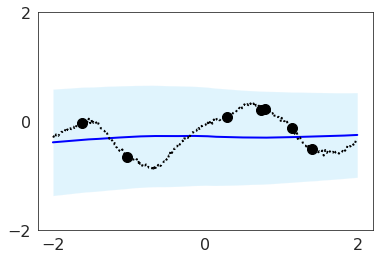

Test function: 2


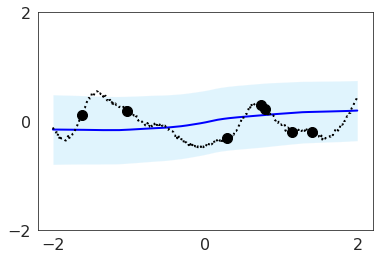

Test function: 3


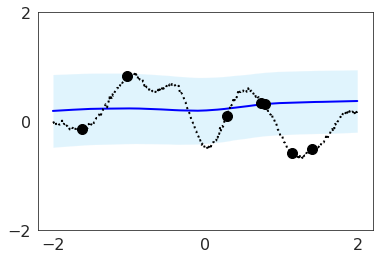

Iteration: 0, train nll: 1.0349353551864624, mse: 0.4016626179218292, local kl: 0.0, global kl 0.0
Test function: 1


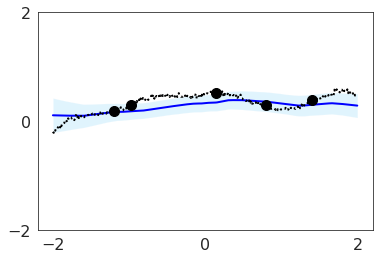

Test function: 2


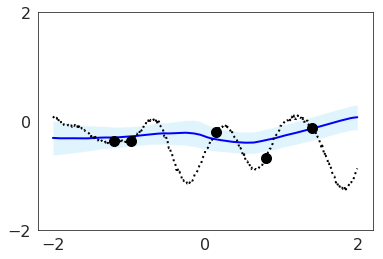

Test function: 3


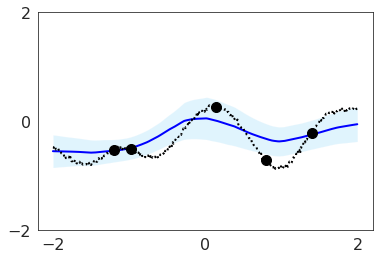

Iteration: 10000, train nll: -0.23279179632663727, mse: 0.0935426577925682, local kl: 0.0, global kl 0.0
Test function: 1


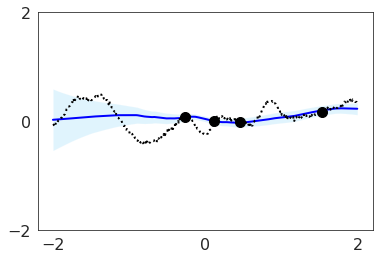

Test function: 2


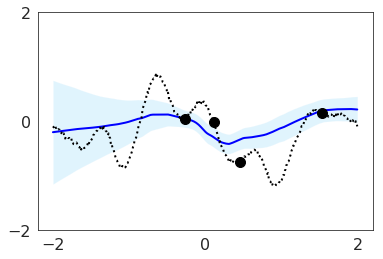

Test function: 3


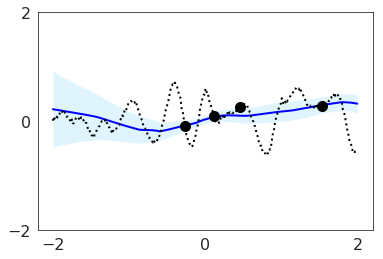

Iteration: 20000, train nll: -0.37482506036758423, mse: 0.08880405873060226, local kl: 0.0, global kl 0.0031506868544965982
Test function: 1


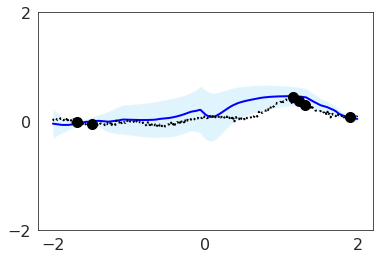

Test function: 2


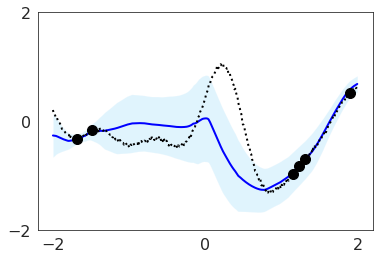

Test function: 3


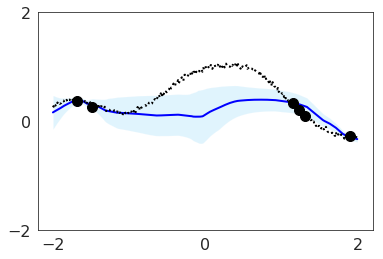

Iteration: 30000, train nll: -0.8696309328079224, mse: 0.026285480707883835, local kl: 0.0, global kl 0.0
Test function: 1


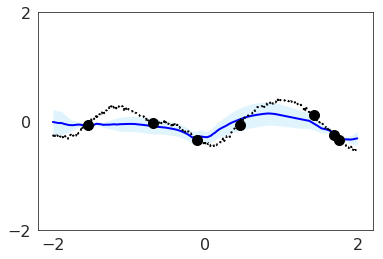

Test function: 2


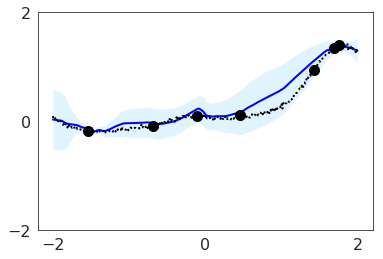

Test function: 3


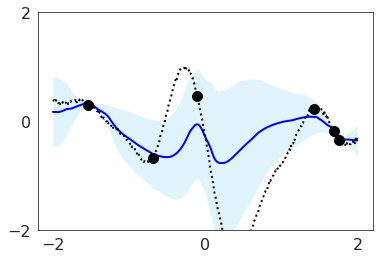

Iteration: 40000, train nll: -0.7587631940841675, mse: 0.04325554519891739, local kl: 0.0, global kl 0.0
Test function: 1


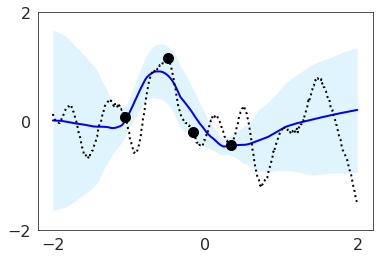

Test function: 2


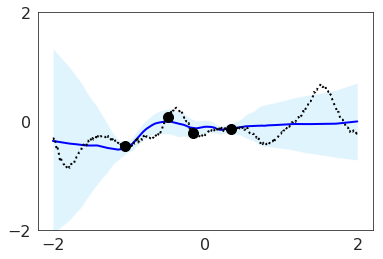

Test function: 3


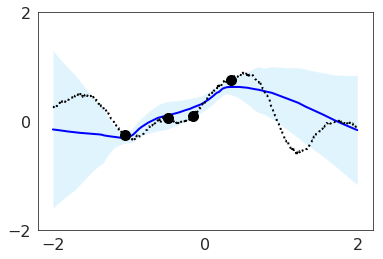

Iteration: 50000, train nll: -0.34624379873275757, mse: 0.0847630500793457, local kl: 0.0, global kl 0.002577593084424734
Test function: 1


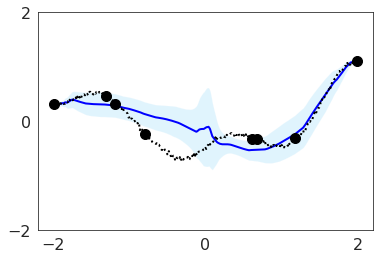

Test function: 2


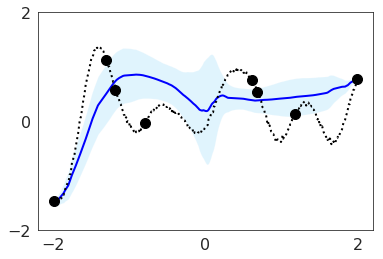

Test function: 3


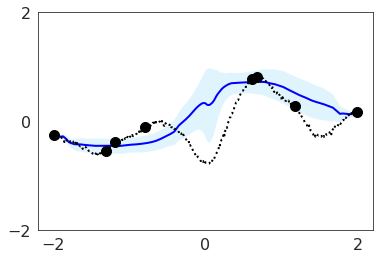

Iteration: 60000, train nll: -0.8439826369285583, mse: 0.02693217247724533, local kl: 0.0, global kl 0.0
Test function: 1


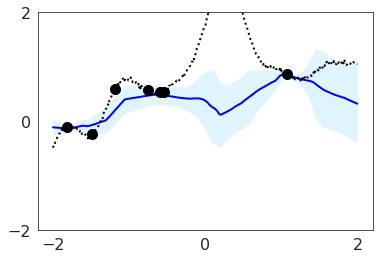

Test function: 2


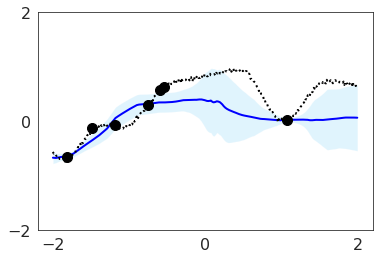

Test function: 3


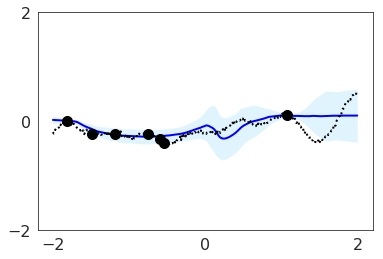

Iteration: 70000, train nll: -1.0160877704620361, mse: 0.036285191774368286, local kl: 0.0, global kl 0.0
Test function: 1


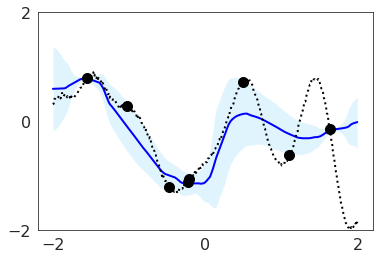

Test function: 2


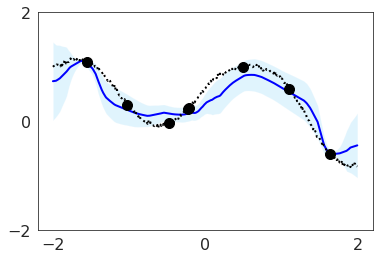

Test function: 3


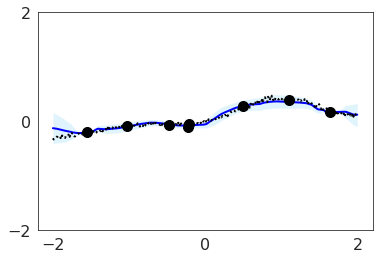

Iteration: 80000, train nll: -0.7605878710746765, mse: 0.0918167382478714, local kl: 0.0, global kl 0.0003997916355729103
Test function: 1


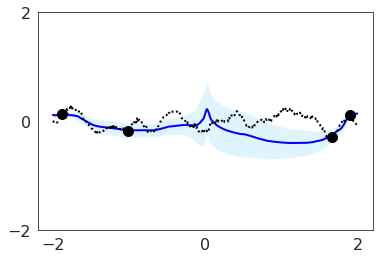

Test function: 2


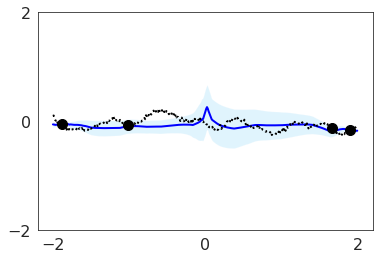

Test function: 3


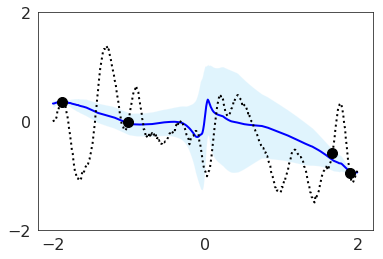

Iteration: 90000, train nll: -0.9163634777069092, mse: 0.057450126856565475, local kl: 0.0, global kl 0.0


In [0]:
global_latent_net_sizes = [HIDDEN_SIZE]
local_latent_net_sizes = None
decoder_net_sizes = [HIDDEN_SIZE]*2 + [2]
model_type = 'anp'
model = generalized_neural_process.Regressor(input_dim=input_dim,
                                             output_dim=output_dim,
                                             x_encoder_net_sizes=x_encoder_net_sizes,
                                             x_y_encoder_net_sizes=x_y_encoder_net_sizes,
                                             heteroskedastic_net_sizes=heteroskedastic_net_sizes,
                                             global_latent_net_sizes=global_latent_net_sizes,
                                             local_latent_net_sizes=local_latent_net_sizes,
                                             decoder_net_sizes=decoder_net_sizes,
                                             att_type=att_type,
                                             att_heads=att_heads,
                                             model_type=model_type,
                                             data_uncertainty=data_uncertainty)

optimizer = tf.keras.optimizers.Adam
learning_rate = 1e-4
training_loop(model,
              dataset_train,
              optimizer=optimizer,
              learning_rate=learning_rate,
              savepath=savepath)

# ACNP

Test function: 1


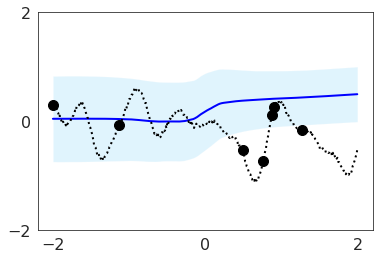

Test function: 2


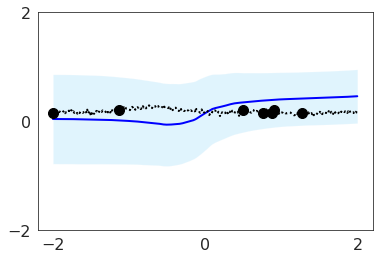

Test function: 3


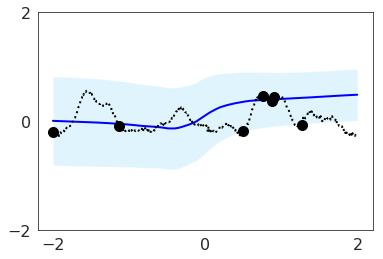

Iteration: 0, train nll: 1.6479586362838745, mse: 0.7562593817710876, local kl: 0.0, global kl 0.0
Test function: 1


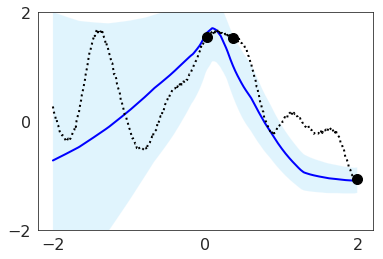

Test function: 2


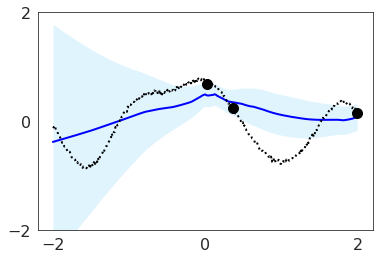

Test function: 3


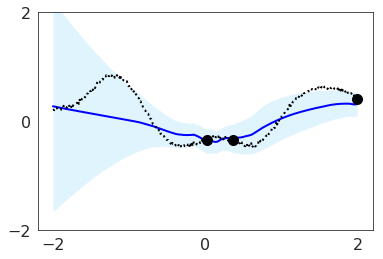

Iteration: 10000, train nll: -0.3380284905433655, mse: 0.06386613100767136, local kl: 0.0, global kl 0.0
Test function: 1


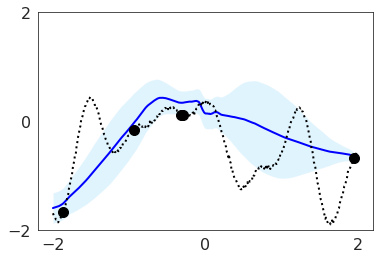

Test function: 2


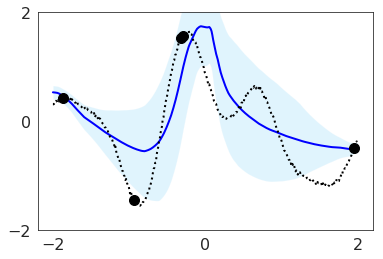

Test function: 3


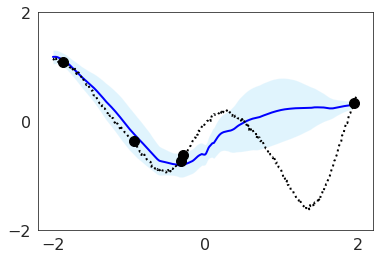

Iteration: 20000, train nll: -0.7464317679405212, mse: 0.045613888651132584, local kl: 0.0, global kl 0.0
Test function: 1


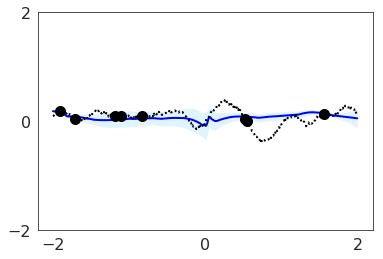

Test function: 2


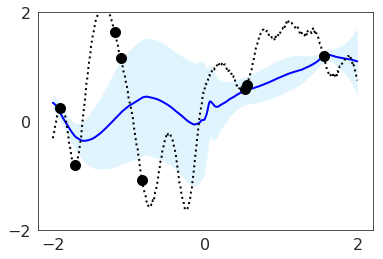

Test function: 3


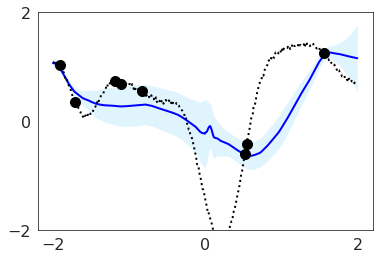

Iteration: 30000, train nll: -0.8105877637863159, mse: 0.04956802725791931, local kl: 0.0, global kl 0.0
Test function: 1


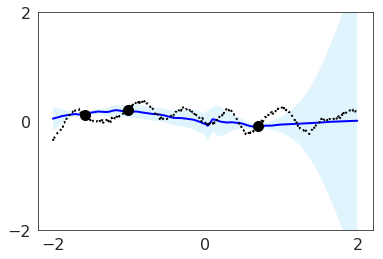

Test function: 2


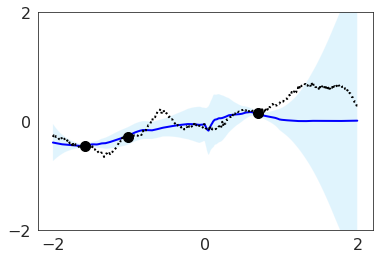

Test function: 3


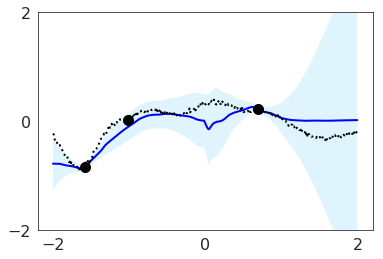

Iteration: 40000, train nll: -0.7389470338821411, mse: 0.05743451043963432, local kl: 0.0, global kl 0.0
Test function: 1


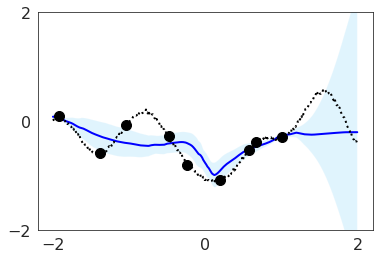

Test function: 2


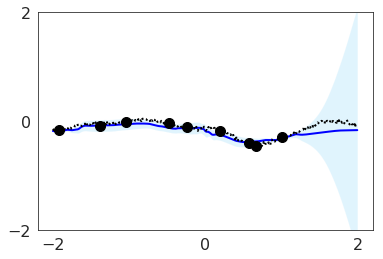

Test function: 3


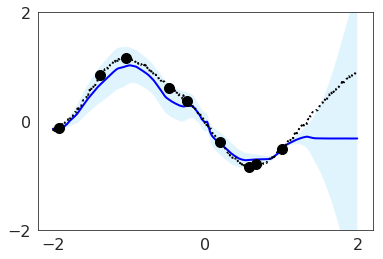

Iteration: 50000, train nll: -0.9864202737808228, mse: 0.05198337882757187, local kl: 0.0, global kl 0.0
Test function: 1


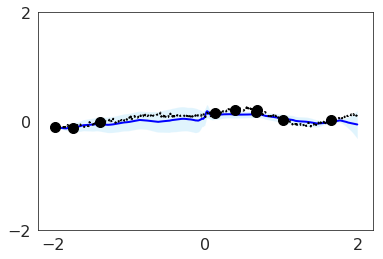

Test function: 2


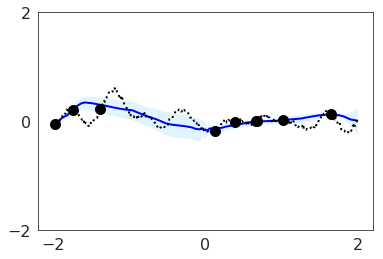

Test function: 3


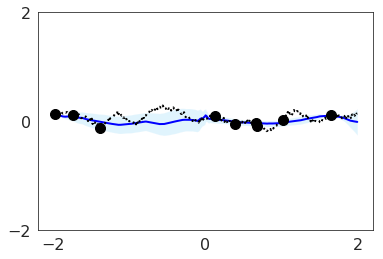

Iteration: 60000, train nll: -1.2668191194534302, mse: 0.019275186583399773, local kl: 0.0, global kl 0.0
Test function: 1


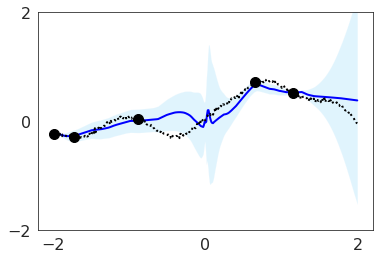

Test function: 2


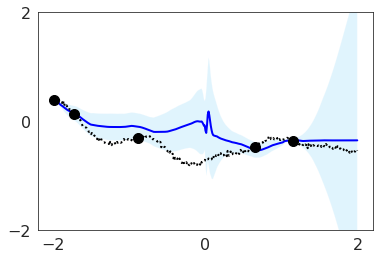

Test function: 3


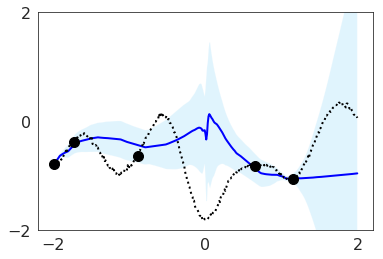

Iteration: 70000, train nll: -1.5709961652755737, mse: 0.014423512853682041, local kl: 0.0, global kl 0.0
Test function: 1


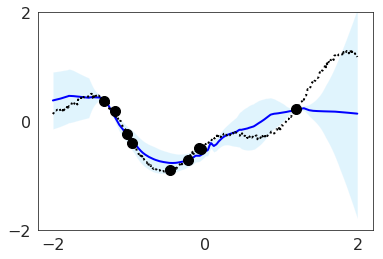

Test function: 2


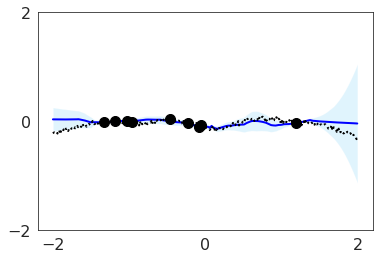

Test function: 3


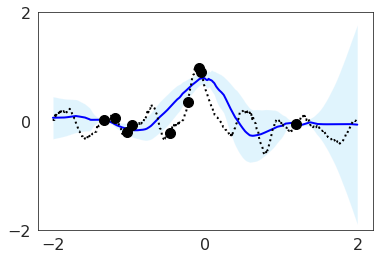

Iteration: 80000, train nll: -1.1798769235610962, mse: 0.03930824622511864, local kl: 0.0, global kl 0.0
Test function: 1


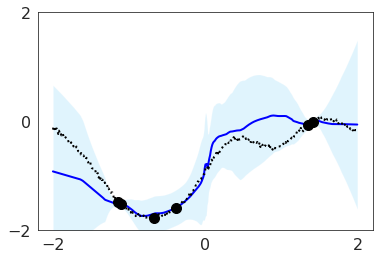

Test function: 2


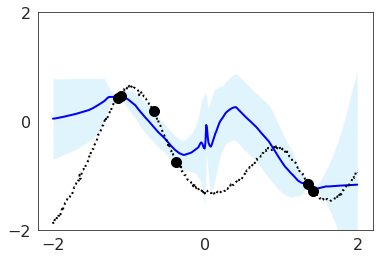

Test function: 3


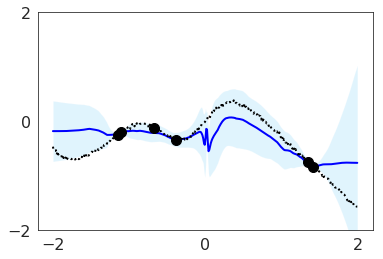

Iteration: 90000, train nll: 0.28609246015548706, mse: 0.2035687267780304, local kl: 0.0, global kl 0.0


In [0]:
global_latent_net_sizes = None
local_latent_net_sizes = None
decoder_net_sizes = [HIDDEN_SIZE]*2 + [2]
model_type = 'acnp'
model = generalized_neural_process.Regressor(input_dim=input_dim,
                                             output_dim=output_dim,
                                             x_encoder_net_sizes=x_encoder_net_sizes,
                                             x_y_encoder_net_sizes=x_y_encoder_net_sizes,
                                             heteroskedastic_net_sizes=heteroskedastic_net_sizes,
                                             global_latent_net_sizes=global_latent_net_sizes,
                                             local_latent_net_sizes=local_latent_net_sizes,
                                             decoder_net_sizes=decoder_net_sizes,
                                             att_type=att_type,
                                             att_heads=att_heads,
                                             model_type=model_type,
                                             data_uncertainty=data_uncertainty)

optimizer = tf.keras.optimizers.Adam
learning_rate = 1e-4
training_loop(model,
              dataset_train,
              optimizer=optimizer,
              learning_rate=learning_rate,
              savepath=savepath)

# ACNS

Test function: 1


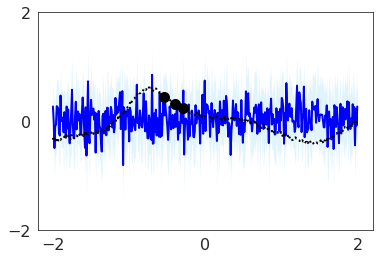

Test function: 2


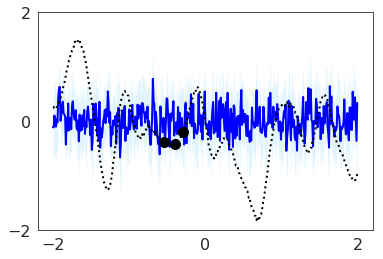

Test function: 3


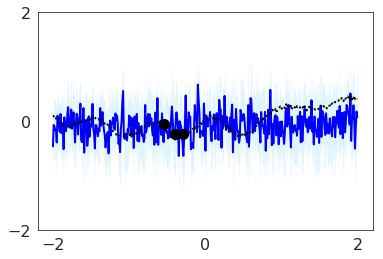

Iteration: 0, train nll: 1.340297818183899, mse: 0.4365028738975525, local kl: 290.09197998046875, global kl 0.006638252176344395
Test function: 1


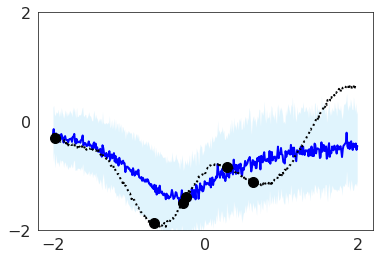

Test function: 2


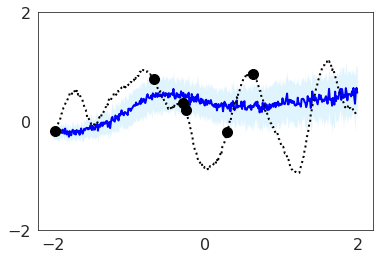

Test function: 3


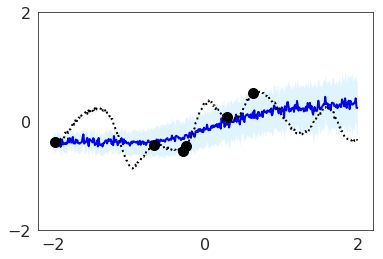

Iteration: 10000, train nll: 0.07689276337623596, mse: 0.16638928651809692, local kl: 2.9758600703644333e-06, global kl 0.0
Test function: 1


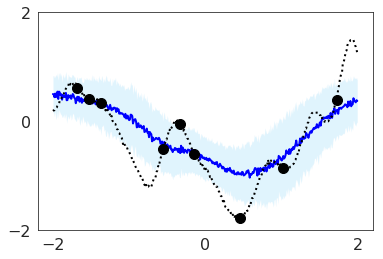

Test function: 2


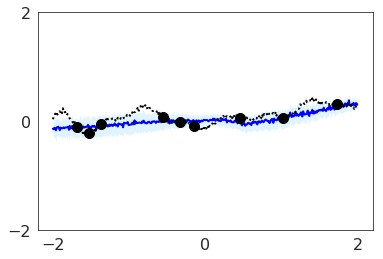

Test function: 3


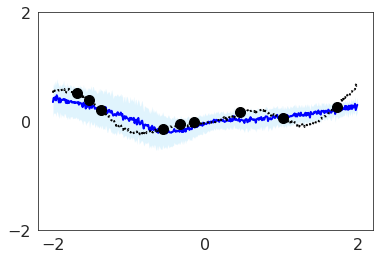

Iteration: 20000, train nll: 0.06408285349607468, mse: 0.10456341505050659, local kl: 6.820411726948805e-06, global kl 0.0006664752727374434
Test function: 1


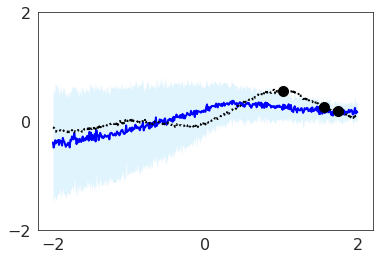

Test function: 2


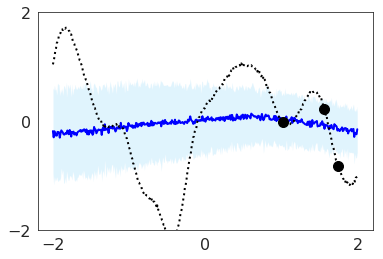

Test function: 3


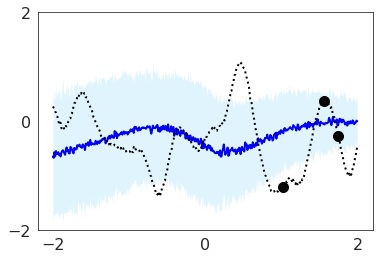

Iteration: 30000, train nll: -0.21172118186950684, mse: 0.09684814512729645, local kl: 2.7539135771803558e-06, global kl 0.0009750834433361888
Test function: 1


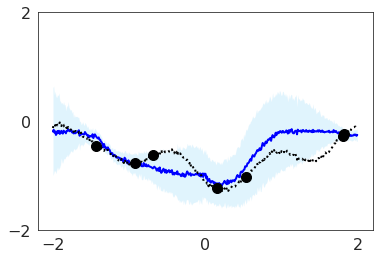

Test function: 2


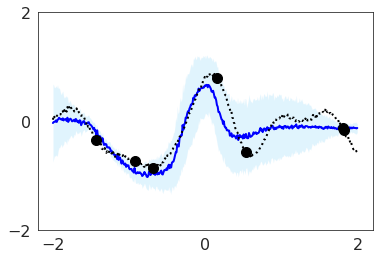

Test function: 3


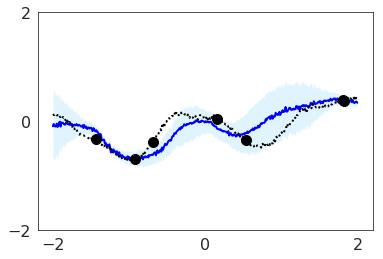

Iteration: 40000, train nll: -0.08852110058069229, mse: 0.10922432690858841, local kl: 4.597273346007569e-06, global kl 0.0014899391680955887
Test function: 1


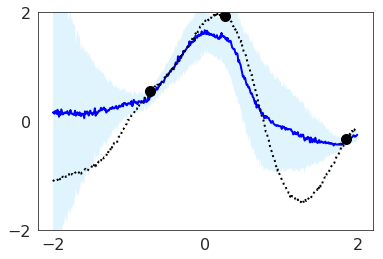

Test function: 2


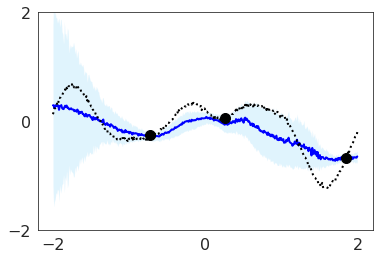

Test function: 3


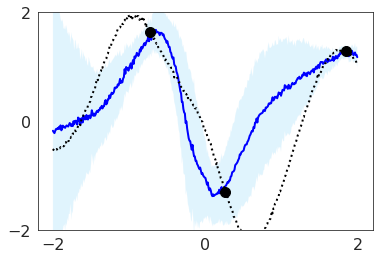

Iteration: 50000, train nll: -0.07461350411176682, mse: 0.11785169690847397, local kl: 2.90604543806694e-06, global kl 0.00044456031173467636
Test function: 1


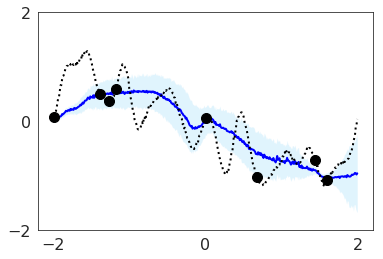

Test function: 2


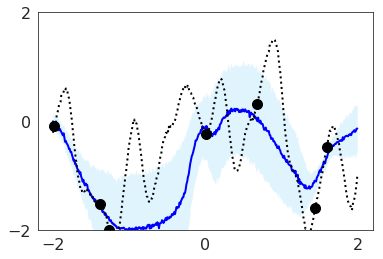

Test function: 3


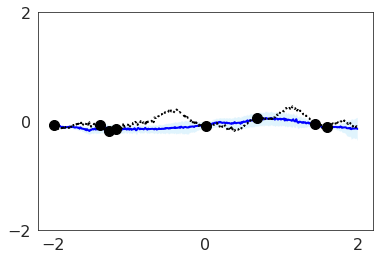

Iteration: 60000, train nll: -0.9205145239830017, mse: 0.027545372024178505, local kl: 4.4302769310888834e-06, global kl 0.0
Test function: 1


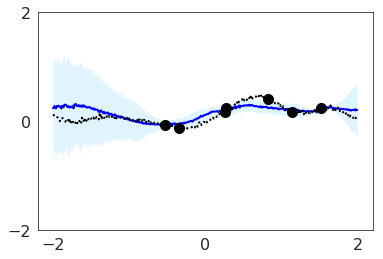

Test function: 2


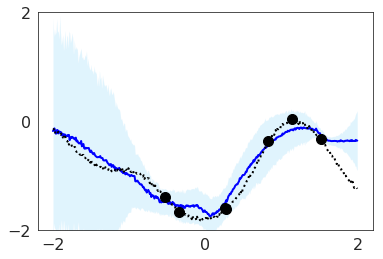

Test function: 3


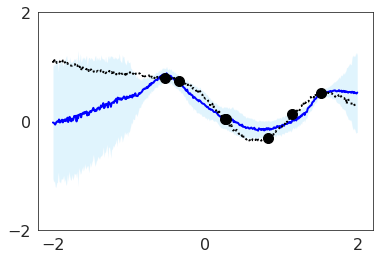

Iteration: 70000, train nll: -0.5720968842506409, mse: 0.0709504559636116, local kl: 4.79462141811382e-06, global kl 9.749754826771095e-05
Test function: 1


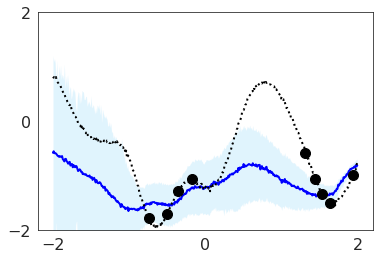

Test function: 2


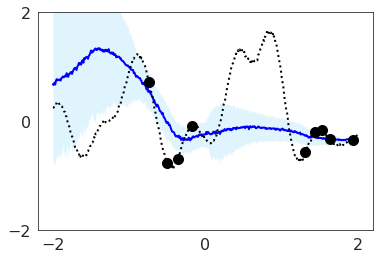

Test function: 3


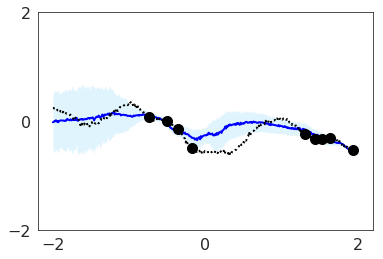

Iteration: 80000, train nll: -0.6666132807731628, mse: 0.0799277126789093, local kl: 1.5418752354889875e-06, global kl 0.00013389626110438257
Test function: 1


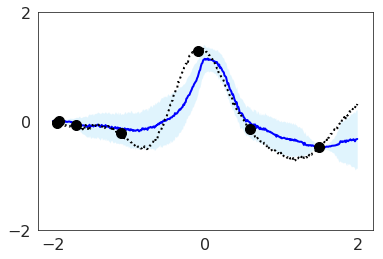

Test function: 2


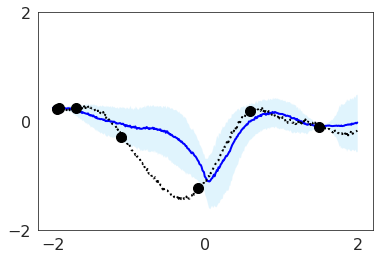

Test function: 3


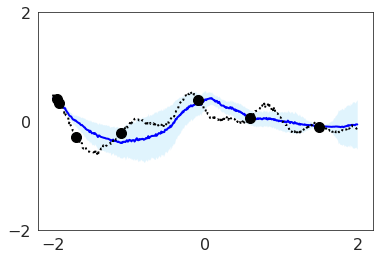

Iteration: 90000, train nll: -0.5859630107879639, mse: 0.12715117633342743, local kl: 1.1950194675591774e-05, global kl 0.00019741605501621962


In [0]:
global_latent_net_sizes = [HIDDEN_SIZE]
local_latent_net_sizes =  [HIDDEN_SIZE]*2
decoder_net_sizes = [HIDDEN_SIZE]*2 + [2]
model_type = 'acns'
model = generalized_neural_process.Regressor(input_dim=input_dim,
                                             output_dim=output_dim,
                                             x_encoder_net_sizes=x_encoder_net_sizes,
                                             x_y_encoder_net_sizes=x_y_encoder_net_sizes,
                                             heteroskedastic_net_sizes=heteroskedastic_net_sizes,
                                             global_latent_net_sizes=global_latent_net_sizes,
                                             local_latent_net_sizes=local_latent_net_sizes,
                                             decoder_net_sizes=decoder_net_sizes,
                                             att_type=att_type,
                                             att_heads=att_heads,
                                             model_type=model_type,
                                             data_uncertainty=data_uncertainty)

optimizer = tf.keras.optimizers.Adam
learning_rate = 1e-4
training_loop(model,
              dataset_train,
              optimizer=optimizer,
              learning_rate=learning_rate,
              savepath=savepath)